In [1]:
from load_modules import *
import copy



In [163]:
np.arange(0.1,1,0.05), np.concatenate((np.linspace(0.99,0.89,11), .98 - np.logspace(-1,-0.31876,10)))

(array([0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45, 0.5 , 0.55, 0.6 ,
        0.65, 0.7 , 0.75, 0.8 , 0.85, 0.9 , 0.95]),
 array([0.99      , 0.98      , 0.97      , 0.96      , 0.95      ,
        0.94      , 0.93      , 0.92      , 0.91      , 0.9       ,
        0.89      , 0.88      , 0.86095989, 0.83829451, 0.81131363,
        0.77919555, 0.74096215, 0.69544908, 0.64127026, 0.57677573,
        0.50000137]))

In [435]:
plt.rcParams['figure.figsize'] = (14.0, 3.0)
plt.rcParams['figure.dpi'] = 100
plt.rcParams['lines.linewidth'] = 1

def create_exp(x):
    return np.random.uniform(80,100)*np.exp(np.linspace(1,np.random.uniform(-1,-50),len(x))) 

def create_poly(x):
    max_power = np.random.randint(3,7)
    y = np.ones(x.shape) * np.random.uniform(20,40) + (max_power-1) * 30
    for power in range(1, max_power):
        y -= np.linspace(-1,1,len(x))**power * np.random.uniform(20,40)
    return y

def create_gaus(x):
    mu = np.random.uniform(600,800) * (end-start) / steps
    sigma = np.random.uniform(200,500)
    return np.exp(-0.5* ((x - mu)**2 / sigma**2)) * np.random.uniform(20,40)

def norm(e):
    return (e - np.min(e)) / (np.max(e) - np.min(e)) + 1

end = 2000
start = 80
steps = 1250
n = end-start
x = np.linspace(start, end, steps)


raw_lst = []
def create_dummy_spectra(expo=True, poly=True, gaus=True, raman=True):
    global raw_lst
    raw_lst = []
    for _ in range(100):
        photo  = np.zeros(x.shape)
        if expo:
            photo += create_exp(x)
        if poly:
            photo += create_poly(x)
        if gaus:
            photo += create_gaus(x)
        photo -= min(-5, np.min(photo))
        raw = copy.copy(photo)
                
        if raman:
#             for _ in range(25):
#                 FWHM_spike = np.random.uniform(7,40)
            for _ in range(40):
                FWHM_spike = np.random.uniform(7,80)
                raman_mu = int(n*np.random.uniform(0.1,0.9))
                raw +=  np.random.uniform(5,10) * LSQ.gaussian(x, np.array([raman_mu]), np.array([FWHM_spike / (2 * np.sqrt(2 * np.log(2)))])).reshape(-1)
            for _ in range(10):
                FWHM_spike = np.random.uniform(7,40)
                raman_mu = int(n*np.random.uniform(0.1,0.9))
                raw +=  np.random.uniform(10,20) * LSQ.gaussian(x, np.array([raman_mu]), np.array([FWHM_spike / (2 * np.sqrt(2 * np.log(2)))])).reshape(-1)
            for _ in range(3):
                FWHM_spike = np.random.uniform(7,40)
                raman_mu = int(n*np.random.uniform(0.1,0.9))
                raw +=  np.random.uniform(20,80) * LSQ.gaussian(x, np.array([raman_mu]), np.array([FWHM_spike / (2 * np.sqrt(2 * np.log(2)))])).reshape(-1)
        
        raw += np.random.random(x.shape) * 10
        raw_lst.append((raw, photo))
    raw_lst = np.array(raw_lst)

# create_dummy_spectra()
# for raw, p in raw_lst:
#     plt.plot(x, raw)
#     plt.plot(x,p)
#     plt.xlim(start,end)
#     plt.ylim(0)
#     plt.show()

In [436]:
create_dummy_spectra(expo=True, poly=True, gaus=True, raman=True)

299.84089371617875 54.323523177505564 1.7002523131682228 0.4168013786873727
FWHM: 50,	 width: 0.99,	 RBF shape: (1250, 320),	 error: 299.84089371617875, 	 smoothness: 1.7002523131682228


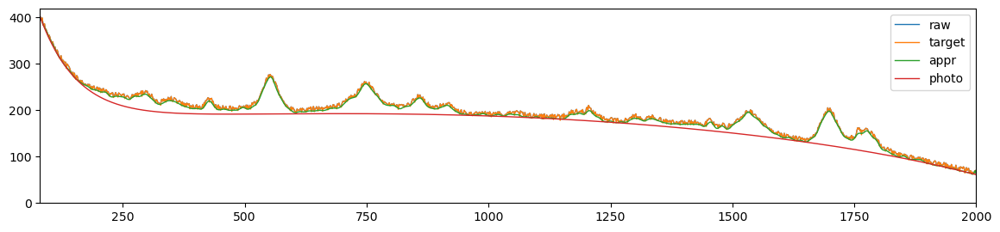

299.622103606149 54.33602308234794 1.6751868150423816 0.4125539743612294
FWHM: 50,	 width: 0.98,	 RBF shape: (1250, 226),	 error: 299.622103606149, 	 smoothness: 1.6751868150423816


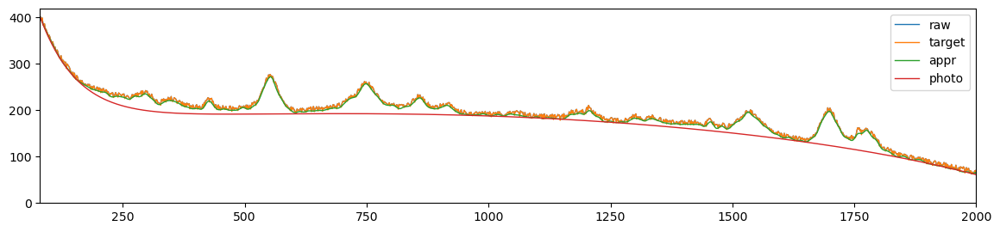

290.4819870533596 54.661600596375 1.4436333700628072 0.3732393150582458
FWHM: 50,	 width: 0.97,	 RBF shape: (1250, 185),	 error: 290.4819870533596, 	 smoothness: 1.4436333700628072


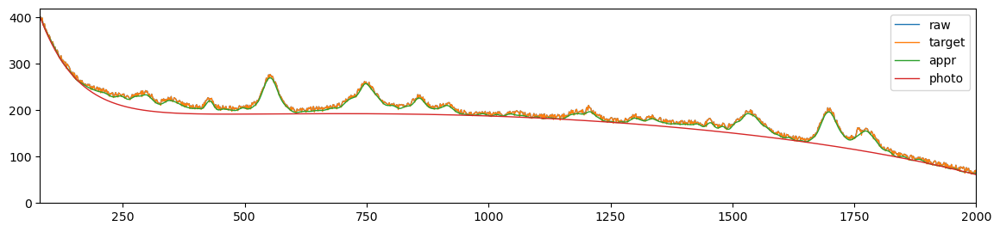

281.3756219012269 55.78898208177091 1.266796798781688 0.35145635538752595
FWHM: 50,	 width: 0.96,	 RBF shape: (1250, 160),	 error: 281.3756219012269, 	 smoothness: 1.266796798781688


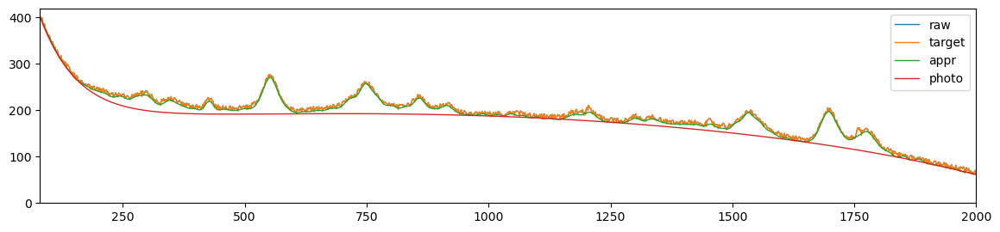

273.3973902604503 55.73892426326355 1.1412350929171378 0.3190536496154519
FWHM: 50,	 width: 0.95,	 RBF shape: (1250, 143),	 error: 273.3973902604503, 	 smoothness: 1.1412350929171378


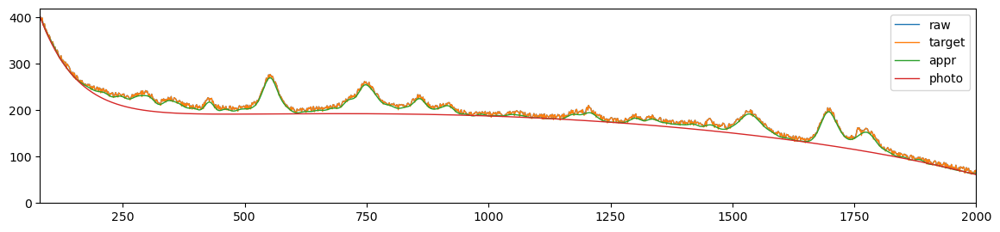

266.5951635439901 55.95115656060603 1.065418310837418 0.2906066976509736
FWHM: 50,	 width: 0.94,	 RBF shape: (1250, 130),	 error: 266.5951635439901, 	 smoothness: 1.065418310837418


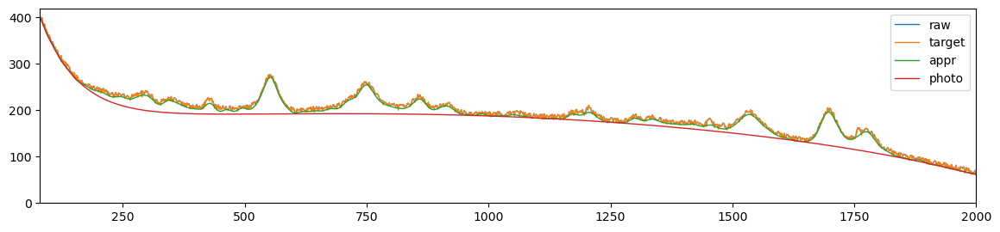

259.15507401918535 56.30430418082321 1.0118035929379752 0.2672425439270555
FWHM: 50,	 width: 0.93,	 RBF shape: (1250, 120),	 error: 259.15507401918535, 	 smoothness: 1.0118035929379752


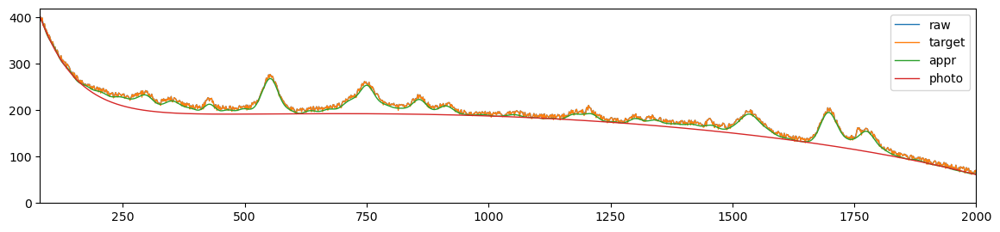

253.51729291135524 56.56502383125554 1.0088638780883499 0.2637294385548841
FWHM: 50,	 width: 0.92,	 RBF shape: (1250, 112),	 error: 253.51729291135524, 	 smoothness: 1.0088638780883499


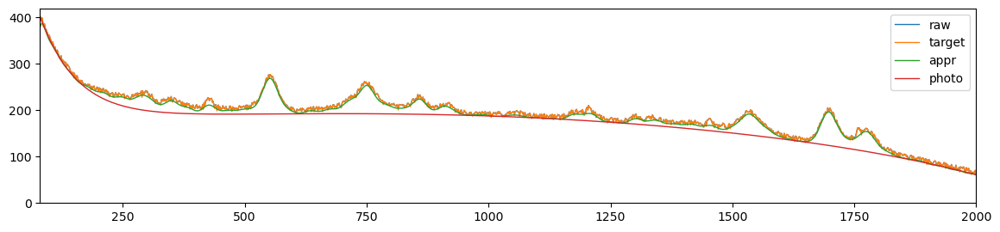

248.1960668308583 56.65837948174416 1.001676812384608 0.25609918580413565
FWHM: 50,	 width: 0.91,	 RBF shape: (1250, 106),	 error: 248.1960668308583, 	 smoothness: 1.001676812384608


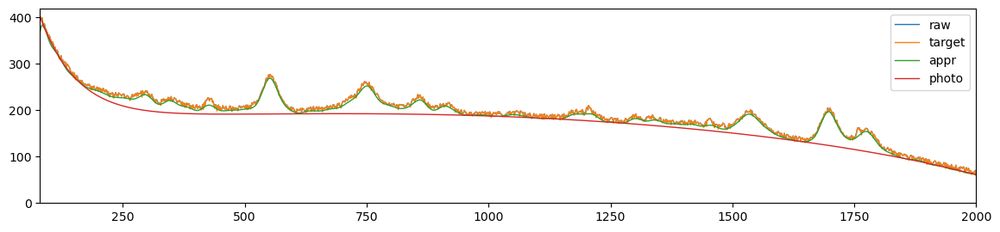

242.20559213522765 55.68709211665439 1.0100518869931525 0.23753308301051096
FWHM: 50,	 width: 0.9,	 RBF shape: (1250, 100),	 error: 242.20559213522765, 	 smoothness: 1.0100518869931525


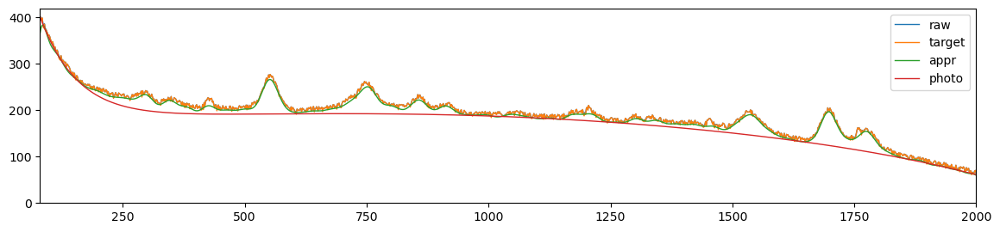

237.49736265395123 54.72343683254392 1.0129069217466675 0.22921107905873436
FWHM: 50,	 width: 0.89,	 RBF shape: (1250, 95),	 error: 237.49736265395123, 	 smoothness: 1.0129069217466675


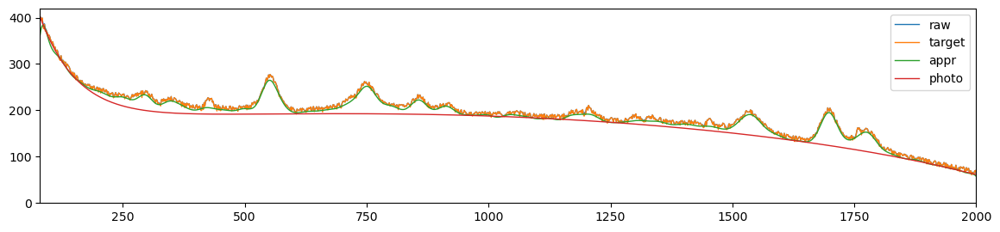

232.36917926953777 54.77376530347143 1.004768601949623 0.24048351902616472
FWHM: 50,	 width: 0.88,	 RBF shape: (1250, 91),	 error: 232.36917926953777, 	 smoothness: 1.004768601949623


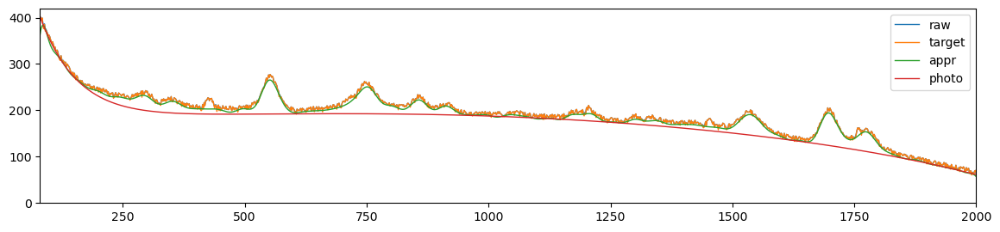

222.53831298876747 53.17468489899498 0.9855680800284232 0.22757537433426472
FWHM: 50,	 width: 0.8609598862125055,	 RBF shape: (1250, 84),	 error: 222.53831298876747, 	 smoothness: 0.9855680800284232


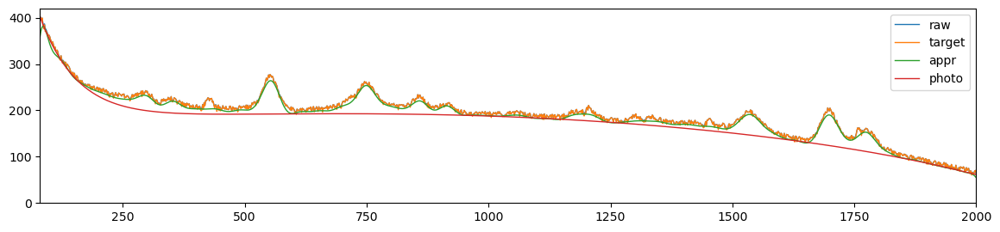

213.17964634083154 51.54912216247609 0.930779692934462 0.20772754102717236
FWHM: 50,	 width: 0.8382945130946038,	 RBF shape: (1250, 78),	 error: 213.17964634083154, 	 smoothness: 0.930779692934462


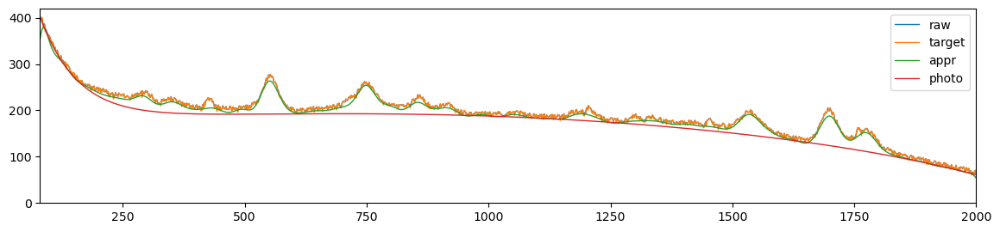

199.37085456549192 48.91854975692742 0.8408790260992618 0.18899724682708607
FWHM: 50,	 width: 0.8113136271446935,	 RBF shape: (1250, 71),	 error: 199.37085456549192, 	 smoothness: 0.8408790260992618


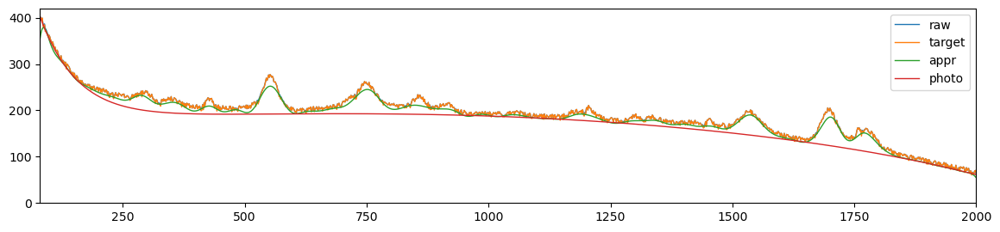

186.46261256217267 44.94641995266133 0.6976511980794432 0.16608034722546722
FWHM: 50,	 width: 0.7791955498090459,	 RBF shape: (1250, 66),	 error: 186.46261256217267, 	 smoothness: 0.6976511980794432


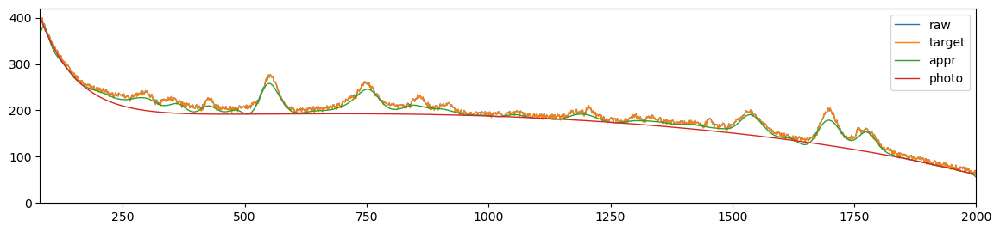

172.7046380782048 42.12914901520725 0.5443639050545543 0.13078101610226728
FWHM: 50,	 width: 0.7409621540023357,	 RBF shape: (1250, 60),	 error: 172.7046380782048, 	 smoothness: 0.5443639050545543


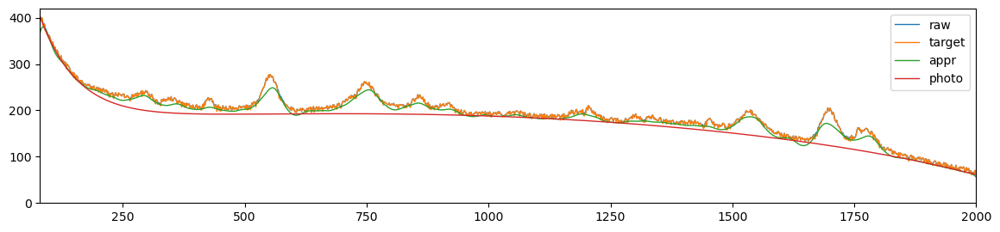

156.20414549739448 38.0057071644021 0.5324568221618191 0.14255237405078058
FWHM: 50,	 width: 0.6954490761292048,	 RBF shape: (1250, 55),	 error: 156.20414549739448, 	 smoothness: 0.5324568221618191


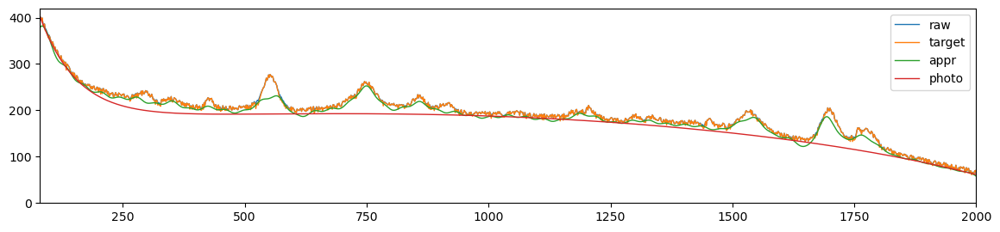

148.6996860310593 39.177653673098874 2.320661369792646 1.0430348111803998
FWHM: 50,	 width: 0.6412702564408389,	 RBF shape: (1250, 49),	 error: 148.6996860310593, 	 smoothness: 2.320661369792646


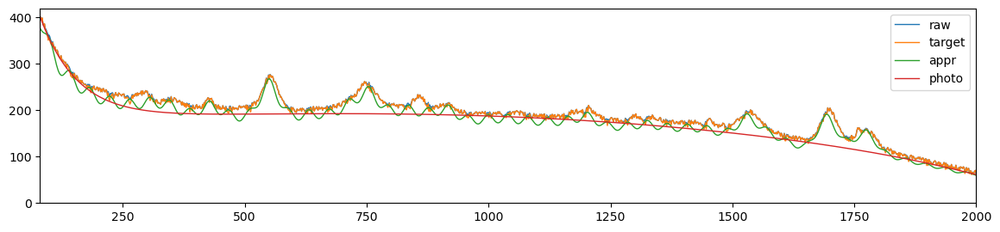

360.57828692021883 171.73227221145842 8.660281875419905 4.083928937637066
FWHM: 50,	 width: 0.5767757278350865,	 RBF shape: (1250, 45),	 error: 360.57828692021883, 	 smoothness: 8.660281875419905


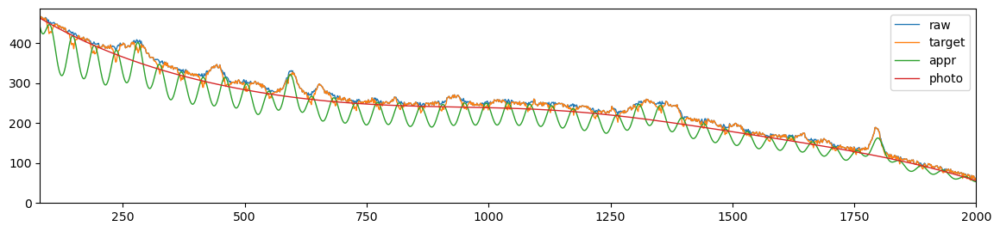

2002.4064091935516 1122.9180773157593 30.700953231665082 13.891891487281576
FWHM: 50,	 width: 0.5000013675960908,	 RBF shape: (1250, 40),	 error: 2002.4064091935516, 	 smoothness: 30.700953231665082


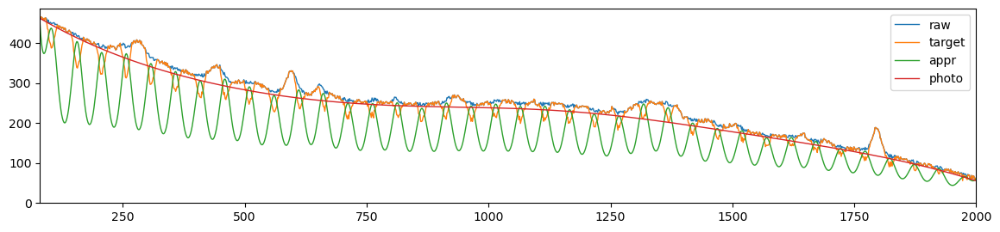

252.48080285782166 56.20626238779962 0.8863316152659456 0.2658323934418428
FWHM: 100,	 width: 0.99,	 RBF shape: (1250, 161),	 error: 252.48080285782166, 	 smoothness: 0.8863316152659456


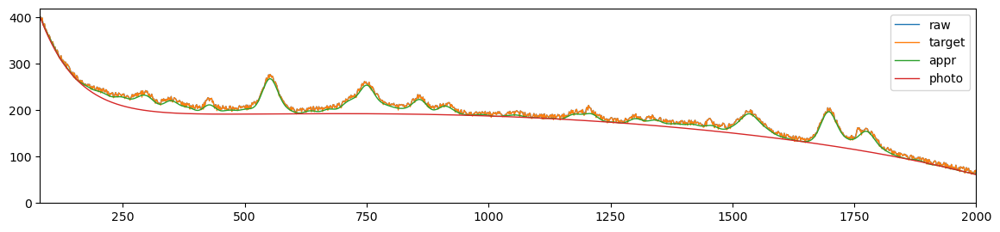

251.16630171723102 56.04149528281445 0.864290932858867 0.2546904983396475
FWHM: 100,	 width: 0.98,	 RBF shape: (1250, 114),	 error: 251.16630171723102, 	 smoothness: 0.864290932858867


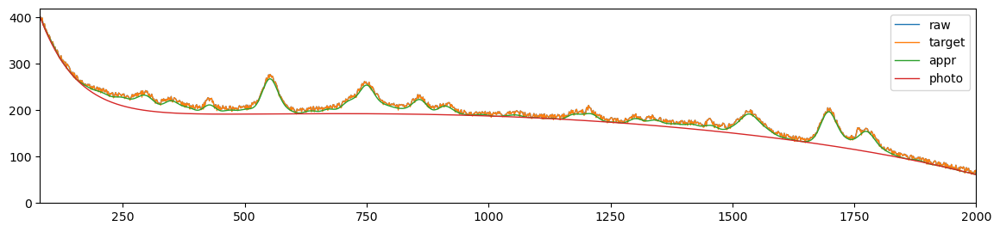

231.5704046763093 55.58262981206425 0.6876602581179202 0.2220621985544724
FWHM: 100,	 width: 0.97,	 RBF shape: (1250, 93),	 error: 231.5704046763093, 	 smoothness: 0.6876602581179202


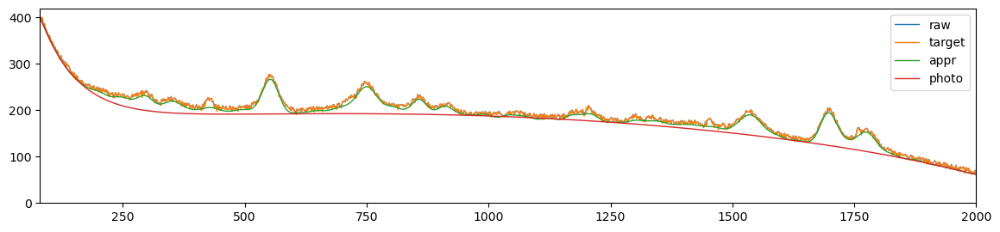

214.6273863939422 52.147847672937466 0.5657499119710698 0.1888260308226903
FWHM: 100,	 width: 0.96,	 RBF shape: (1250, 81),	 error: 214.6273863939422, 	 smoothness: 0.5657499119710698


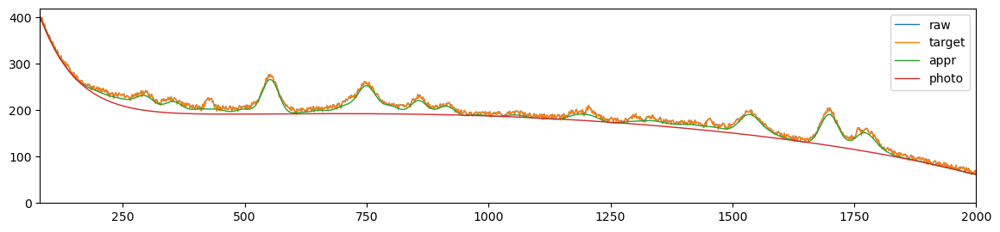

196.18637621137168 47.34586858402671 0.46348702763470895 0.14713437879727545
FWHM: 100,	 width: 0.95,	 RBF shape: (1250, 72),	 error: 196.18637621137168, 	 smoothness: 0.46348702763470895


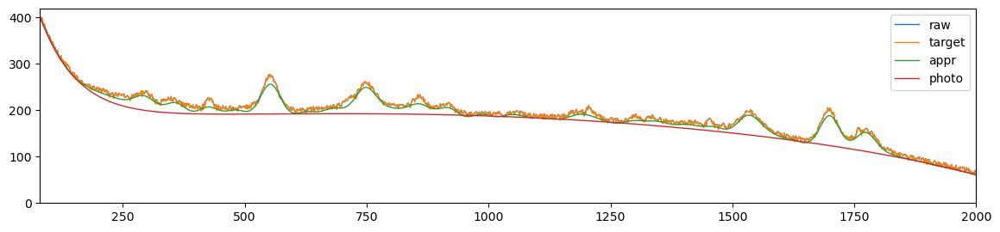

183.3746113580619 44.879929809744056 0.412767758792917 0.13416587315469866
FWHM: 100,	 width: 0.94,	 RBF shape: (1250, 66),	 error: 183.3746113580619, 	 smoothness: 0.412767758792917


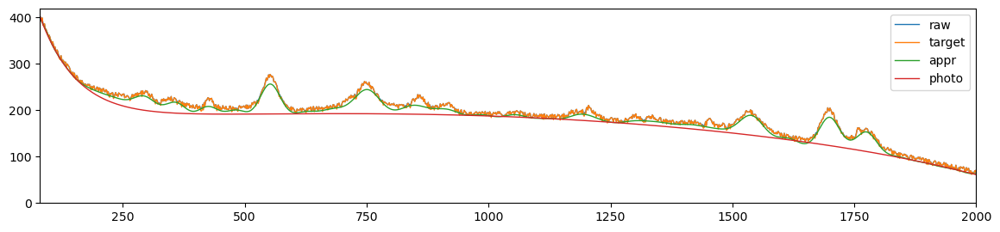

171.17035979227876 42.631853416800126 0.38479304876758563 0.11744852972052881
FWHM: 100,	 width: 0.93,	 RBF shape: (1250, 61),	 error: 171.17035979227876, 	 smoothness: 0.38479304876758563


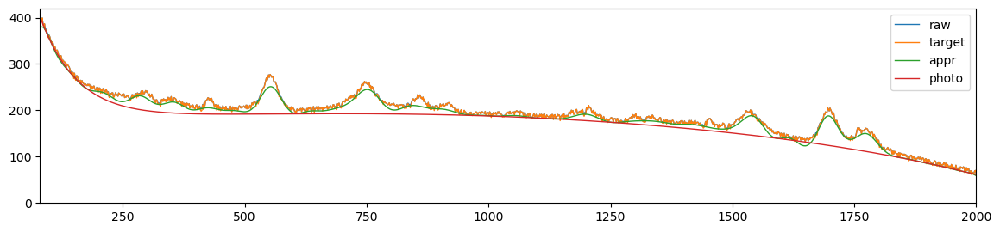

162.4344498284703 40.6377782014318 0.3667345653427225 0.10975010519901844
FWHM: 100,	 width: 0.92,	 RBF shape: (1250, 57),	 error: 162.4344498284703, 	 smoothness: 0.3667345653427225


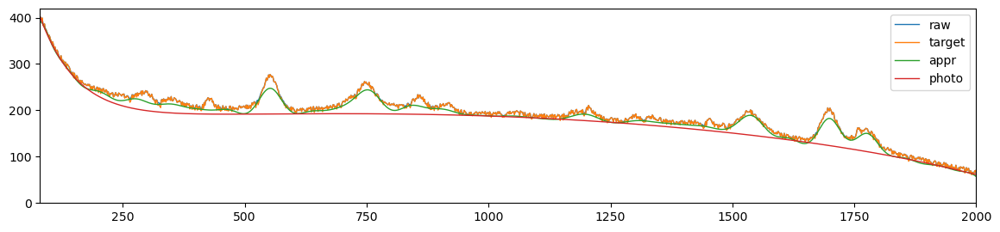

153.7759304211825 38.02131625575692 0.35558618686681986 0.10211478113779261
FWHM: 100,	 width: 0.91,	 RBF shape: (1250, 54),	 error: 153.7759304211825, 	 smoothness: 0.35558618686681986


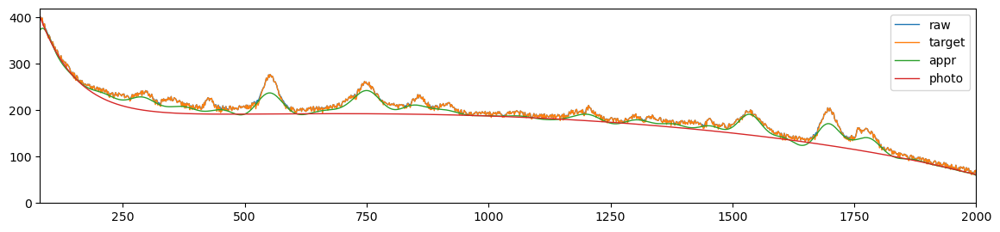

146.67503812369753 35.85365261442302 0.3634734338584038 0.10434998536766264
FWHM: 100,	 width: 0.9,	 RBF shape: (1250, 51),	 error: 146.67503812369753, 	 smoothness: 0.3634734338584038


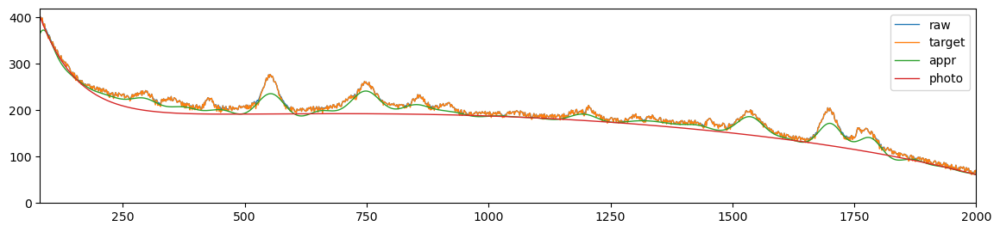

138.13630773472326 32.91329071011813 0.3823967559541763 0.10936528447740146
FWHM: 100,	 width: 0.89,	 RBF shape: (1250, 48),	 error: 138.13630773472326, 	 smoothness: 0.3823967559541763


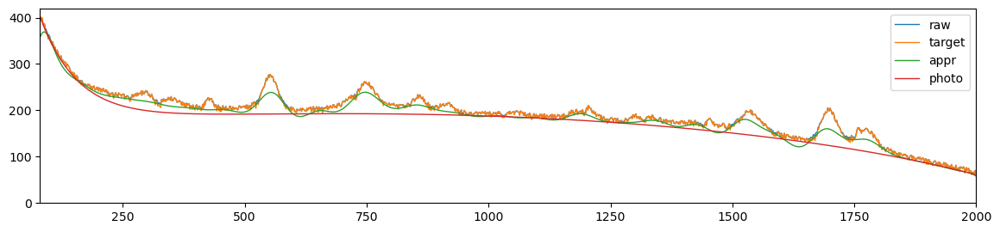

133.48985993760846 31.549456044540555 0.38993803262677273 0.09882273897281217
FWHM: 100,	 width: 0.88,	 RBF shape: (1250, 46),	 error: 133.48985993760846, 	 smoothness: 0.38993803262677273


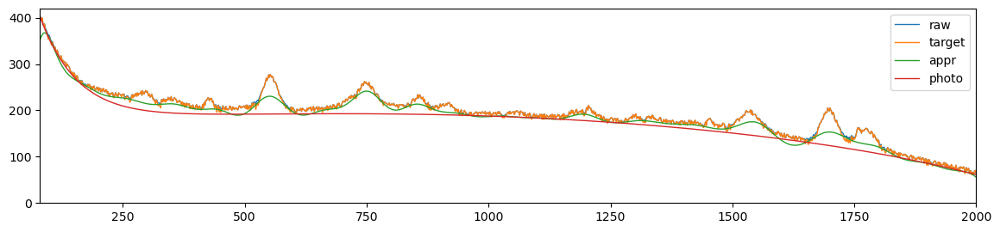

125.24337112665859 28.580584682684187 0.38573258375877045 0.08887777759645507
FWHM: 100,	 width: 0.8609598862125055,	 RBF shape: (1250, 43),	 error: 125.24337112665859, 	 smoothness: 0.38573258375877045


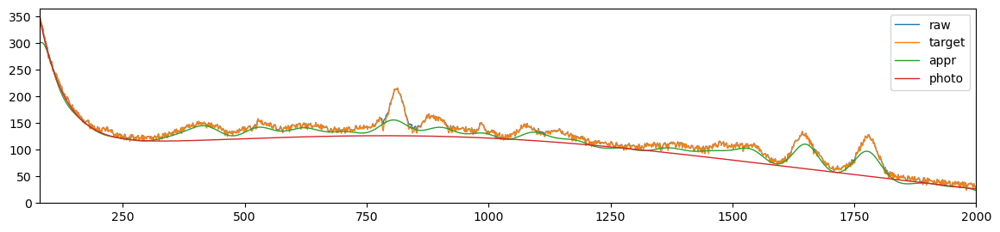

117.43536189174858 26.188412093041666 0.37251200749079233 0.09004031019272006
FWHM: 100,	 width: 0.8382945130946038,	 RBF shape: (1250, 40),	 error: 117.43536189174858, 	 smoothness: 0.37251200749079233


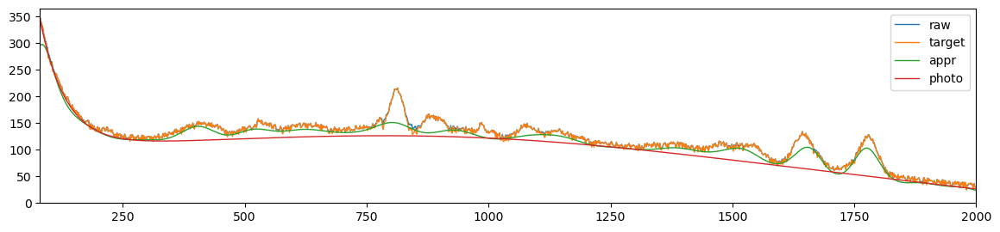

107.08829894321718 24.56250567960907 0.338399584039869 0.09645047538551575
FWHM: 100,	 width: 0.8113136271446935,	 RBF shape: (1250, 36),	 error: 107.08829894321718, 	 smoothness: 0.338399584039869


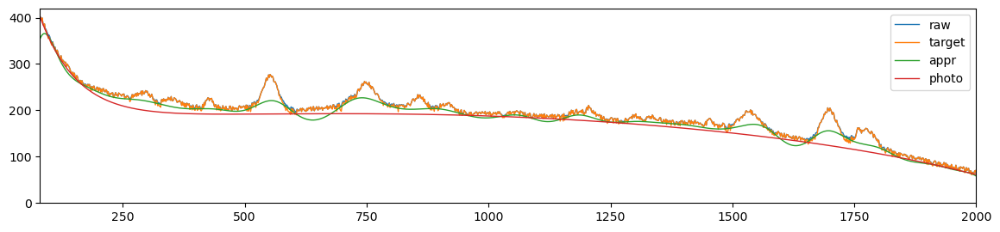

99.00279665606531 23.13031656036145 0.2742239883263951 0.07751508906669917
FWHM: 100,	 width: 0.7791955498090459,	 RBF shape: (1250, 34),	 error: 99.00279665606531, 	 smoothness: 0.2742239883263951


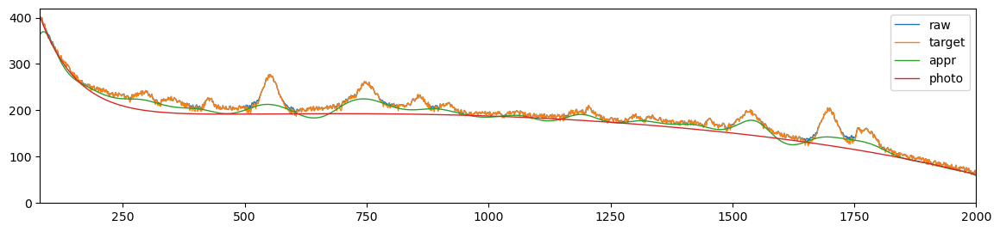

86.96459357208401 20.240807066564486 0.18808247319379578 0.052365442727022336
FWHM: 100,	 width: 0.7409621540023357,	 RBF shape: (1250, 31),	 error: 86.96459357208401, 	 smoothness: 0.18808247319379578


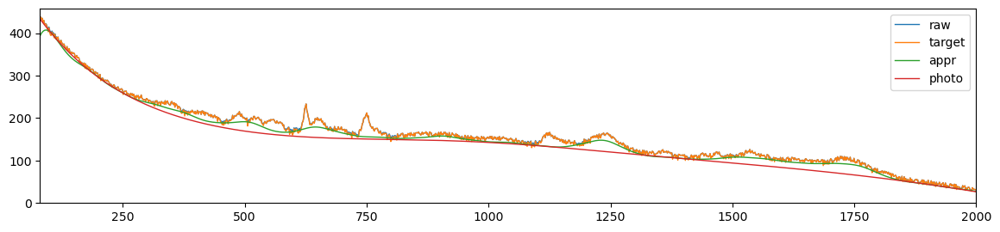

79.0597084571006 21.270036387805714 0.16053550087619659 0.0504406942586032
FWHM: 100,	 width: 0.6954490761292048,	 RBF shape: (1250, 28),	 error: 79.0597084571006, 	 smoothness: 0.16053550087619659


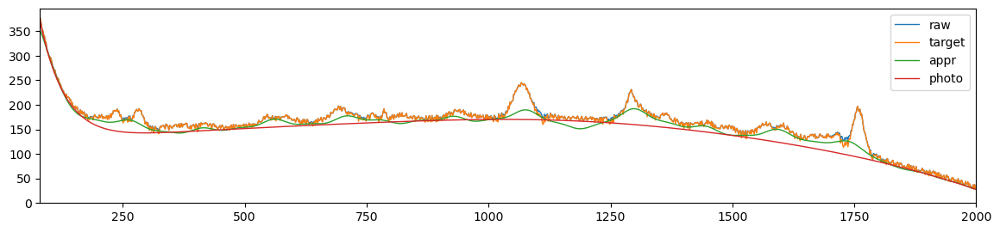

115.38027844891877 43.90403092526625 0.7358083886137389 0.3580767653241785
FWHM: 100,	 width: 0.6412702564408389,	 RBF shape: (1250, 25),	 error: 115.38027844891877, 	 smoothness: 0.7358083886137389


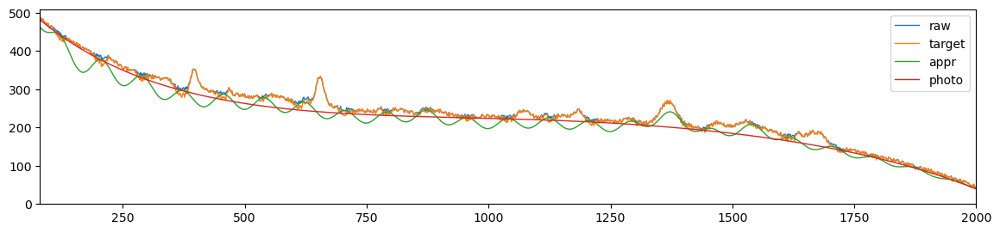

451.5611938215229 266.44128158810247 2.7227512680861823 1.3143568221934416
FWHM: 100,	 width: 0.5767757278350865,	 RBF shape: (1250, 23),	 error: 451.5611938215229, 	 smoothness: 2.7227512680861823


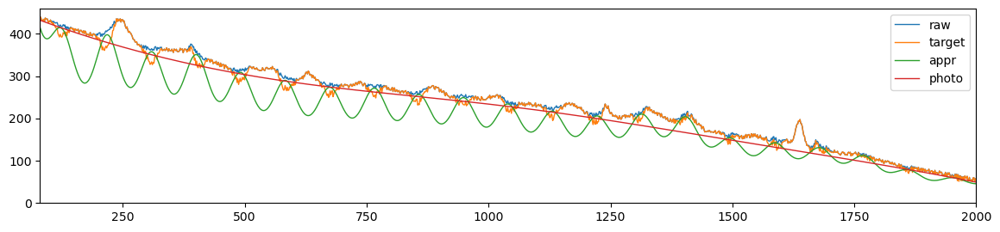

1866.2435602167097 1072.617759577565 7.535688551879948 3.468437814085268
FWHM: 100,	 width: 0.5000013675960908,	 RBF shape: (1250, 21),	 error: 1866.2435602167097, 	 smoothness: 7.535688551879948


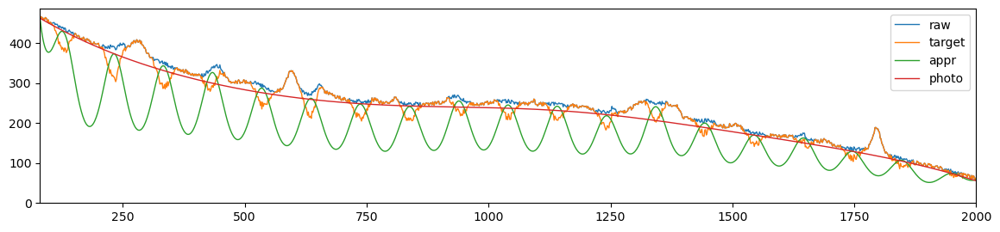

204.09238744038052 50.164742507567865 0.5338108807887736 0.1883110272000699
FWHM: 150,	 width: 0.99,	 RBF shape: (1250, 108),	 error: 204.09238744038052, 	 smoothness: 0.5338108807887736


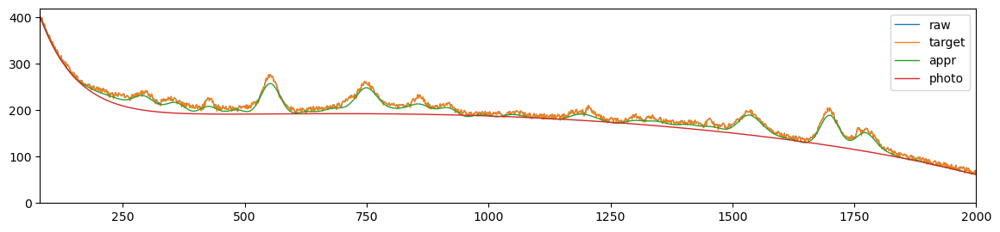

202.2061121352386 49.705817479357044 0.5065767218481578 0.17208604549549147
FWHM: 150,	 width: 0.98,	 RBF shape: (1250, 76),	 error: 202.2061121352386, 	 smoothness: 0.5065767218481578


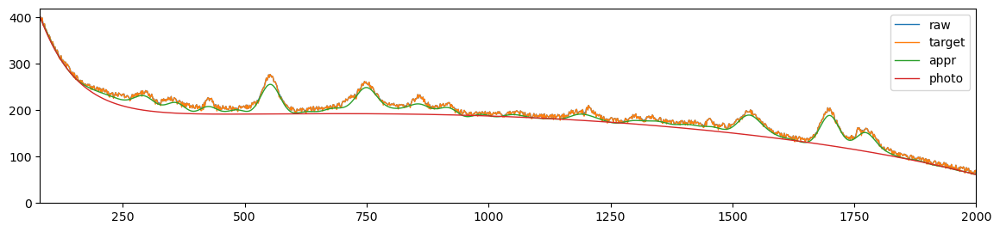

173.15151291106187 43.06596068093068 0.35569357752648956 0.12349658406253768
FWHM: 150,	 width: 0.97,	 RBF shape: (1250, 63),	 error: 173.15151291106187, 	 smoothness: 0.35569357752648956


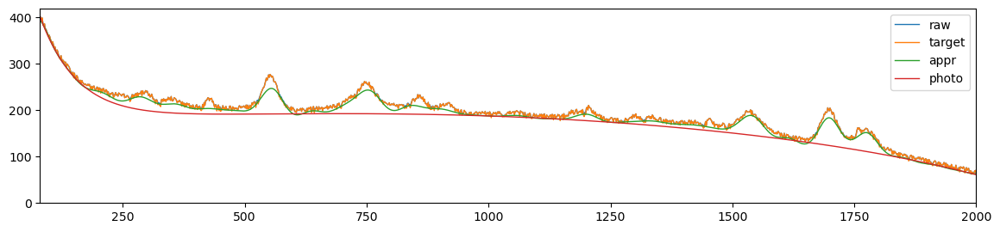

151.18352121464858 37.829123322269794 0.255812483616516 0.09620908154267475
FWHM: 150,	 width: 0.96,	 RBF shape: (1250, 54),	 error: 151.18352121464858, 	 smoothness: 0.255812483616516


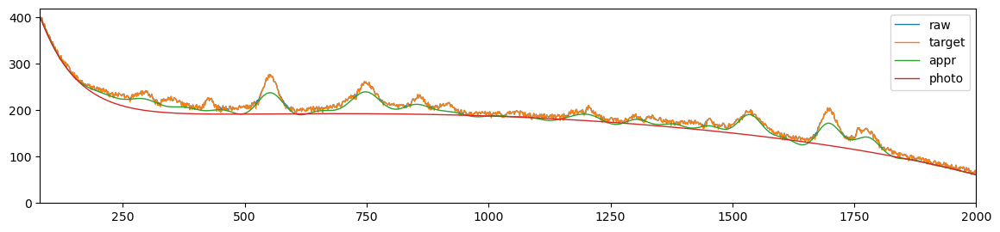

135.89574113591866 32.38736158119947 0.20448152708255354 0.0722213078204393
FWHM: 150,	 width: 0.95,	 RBF shape: (1250, 49),	 error: 135.89574113591866, 	 smoothness: 0.20448152708255354


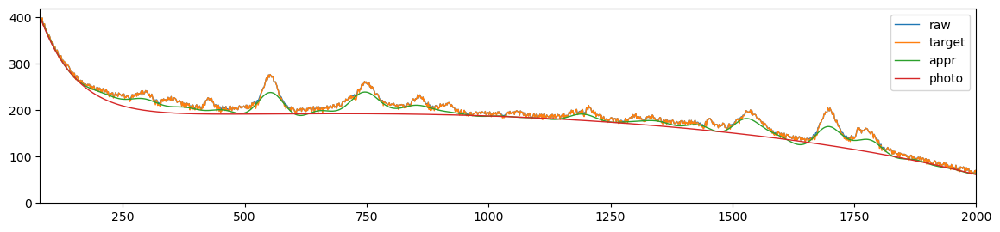

120.8386794760558 28.664775906559807 0.17605713556069394 0.060093474200724105
FWHM: 150,	 width: 0.94,	 RBF shape: (1250, 44),	 error: 120.8386794760558, 	 smoothness: 0.17605713556069394


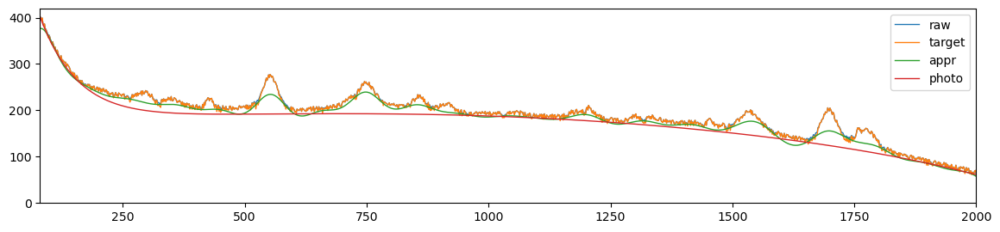

114.21987289098745 27.376428159521186 0.1768012243614341 0.061981178212387696
FWHM: 150,	 width: 0.93,	 RBF shape: (1250, 41),	 error: 114.21987289098745, 	 smoothness: 0.1768012243614341


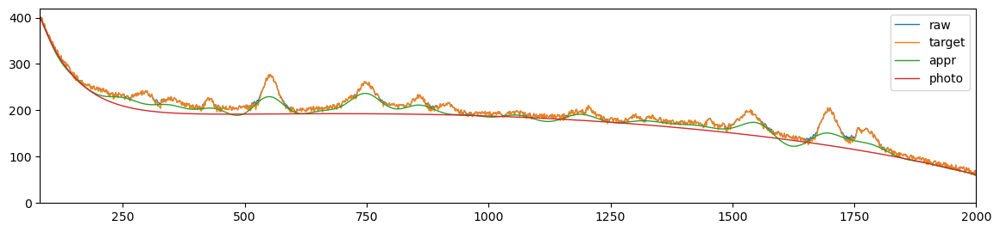

106.97437779075841 25.872976550730353 0.1954751238295599 0.08721902487030848
FWHM: 150,	 width: 0.92,	 RBF shape: (1250, 38),	 error: 106.97437779075841, 	 smoothness: 0.1954751238295599


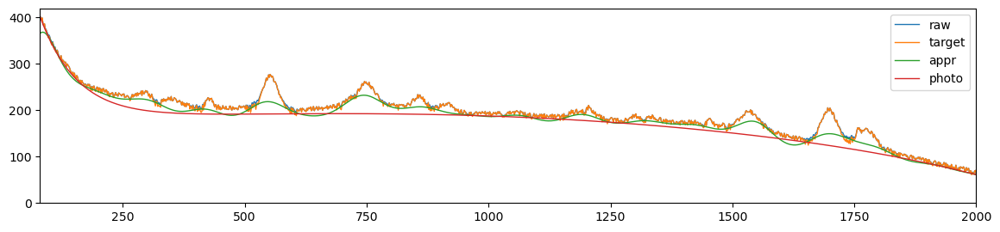

103.2248381745168 24.20577667675409 0.20409670393408408 0.08966412359732331
FWHM: 150,	 width: 0.91,	 RBF shape: (1250, 36),	 error: 103.2248381745168, 	 smoothness: 0.20409670393408408


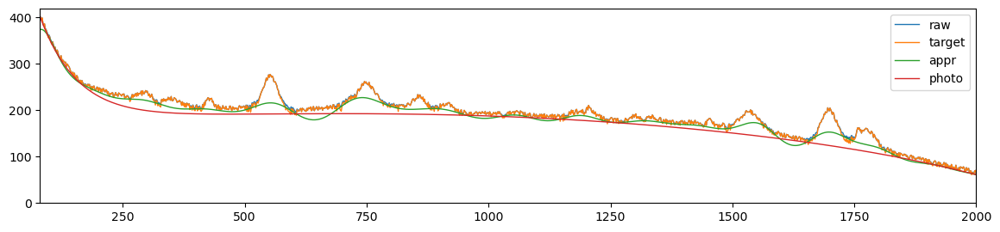

98.83637078239813 23.395028975279338 0.21556255934967175 0.07087204778750121
FWHM: 150,	 width: 0.9,	 RBF shape: (1250, 34),	 error: 98.83637078239813, 	 smoothness: 0.21556255934967175


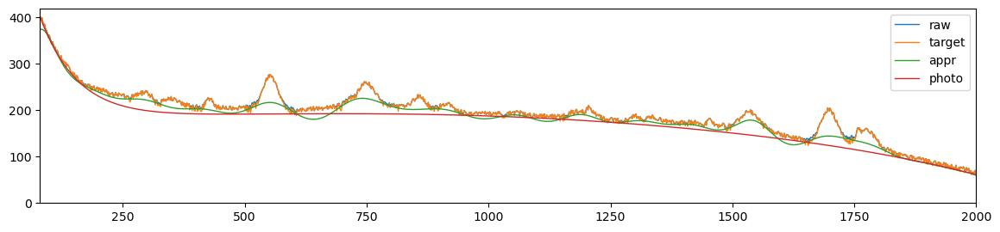

95.75458976615147 22.297740091391674 0.21768510062637503 0.0700132597437704
FWHM: 150,	 width: 0.89,	 RBF shape: (1250, 33),	 error: 95.75458976615147, 	 smoothness: 0.21768510062637503


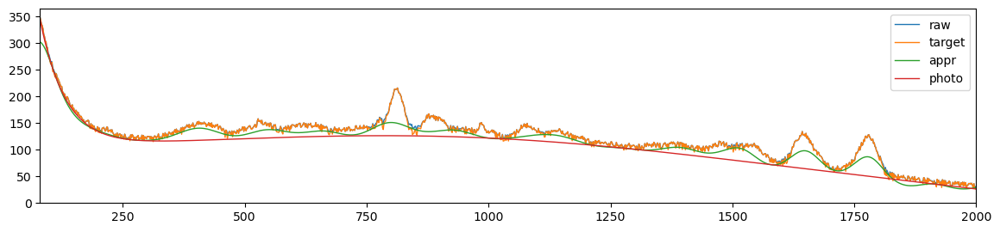

92.21060099017845 21.211985858230523 0.23916322172448357 0.08417306598847321
FWHM: 150,	 width: 0.88,	 RBF shape: (1250, 31),	 error: 92.21060099017845, 	 smoothness: 0.23916322172448357


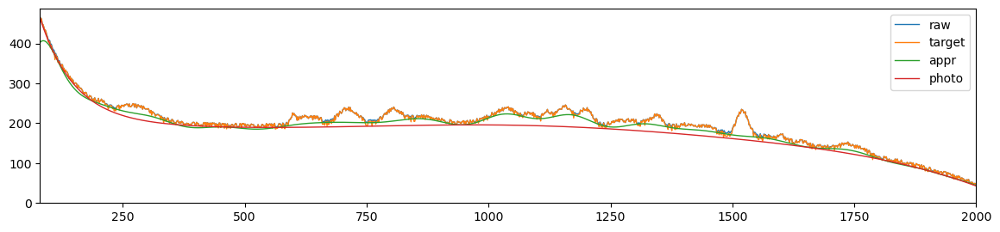

87.87265800087785 21.53881947023905 0.2404031911058078 0.08655210979135057
FWHM: 150,	 width: 0.8609598862125055,	 RBF shape: (1250, 29),	 error: 87.87265800087785, 	 smoothness: 0.2404031911058078


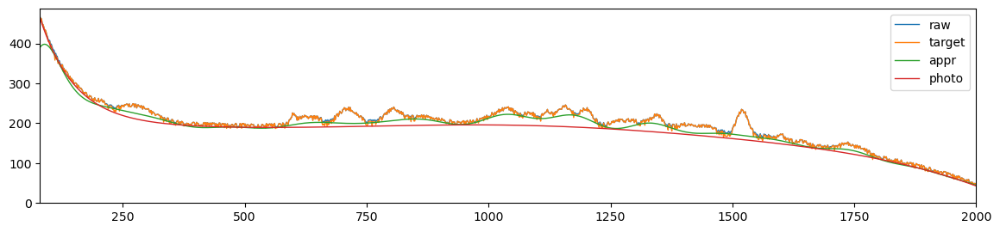

80.91863890907965 19.871761695837037 0.2265846721688759 0.07688987382570898
FWHM: 150,	 width: 0.8382945130946038,	 RBF shape: (1250, 27),	 error: 80.91863890907965, 	 smoothness: 0.2265846721688759


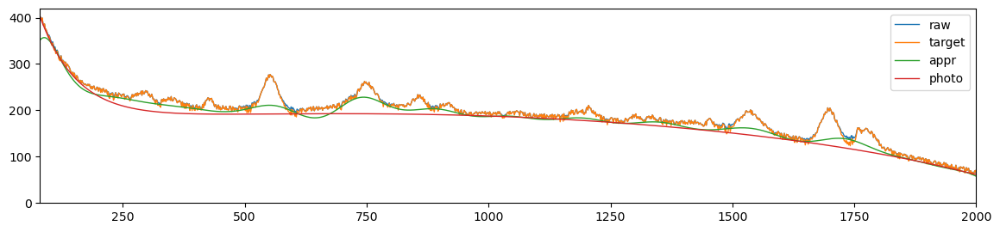

73.77636848380686 18.012161904573574 0.20191620269398097 0.07141257716830966
FWHM: 150,	 width: 0.8113136271446935,	 RBF shape: (1250, 25),	 error: 73.77636848380686, 	 smoothness: 0.20191620269398097


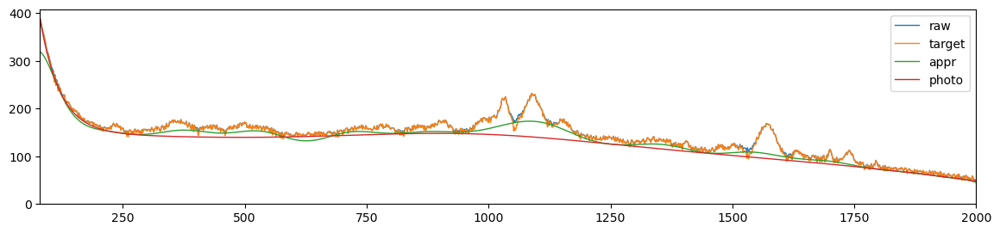

66.37165894887414 18.803890284480566 0.16364872252531953 0.06978774343121993
FWHM: 150,	 width: 0.7791955498090459,	 RBF shape: (1250, 23),	 error: 66.37165894887414, 	 smoothness: 0.16364872252531953


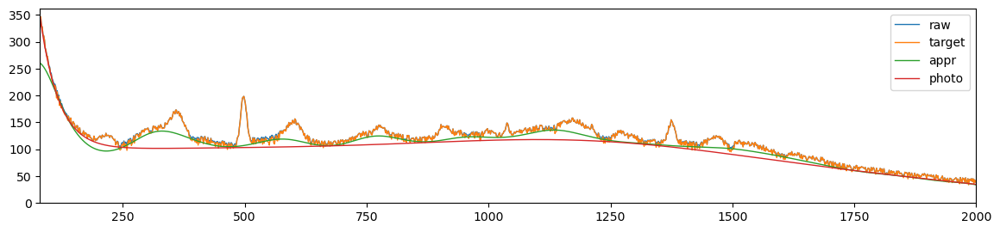

59.33702255966108 18.13468061304567 0.11911434935386728 0.053134490298062394
FWHM: 150,	 width: 0.7409621540023357,	 RBF shape: (1250, 21),	 error: 59.33702255966108, 	 smoothness: 0.11911434935386728


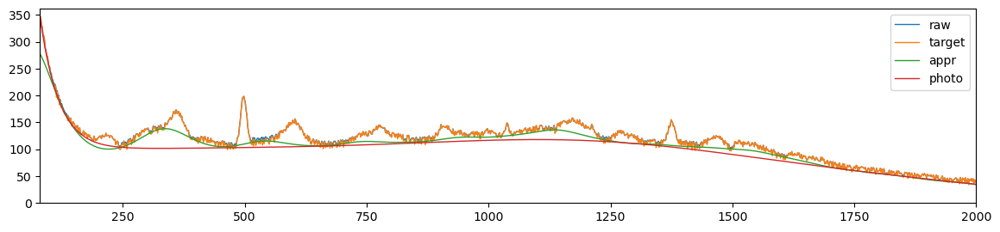

51.65984049344419 14.191283227005258 0.09657513872096221 0.041789920479022954
FWHM: 150,	 width: 0.6954490761292048,	 RBF shape: (1250, 19),	 error: 51.65984049344419, 	 smoothness: 0.09657513872096221


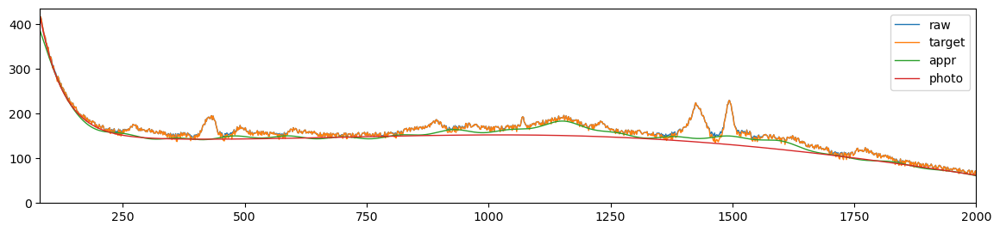

127.05900255262218 66.44749916365853 0.42239006632827125 0.21377363244032924
FWHM: 150,	 width: 0.6412702564408389,	 RBF shape: (1250, 17),	 error: 127.05900255262218, 	 smoothness: 0.42239006632827125


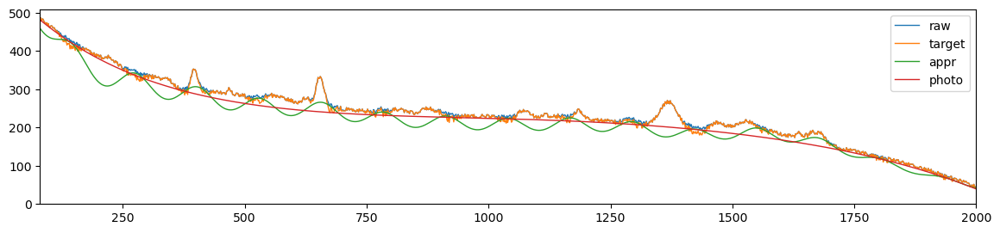

428.13750952769595 261.85051389223236 1.1440987807671315 0.5635729236323769
FWHM: 150,	 width: 0.5767757278350865,	 RBF shape: (1250, 16),	 error: 428.13750952769595, 	 smoothness: 1.1440987807671315


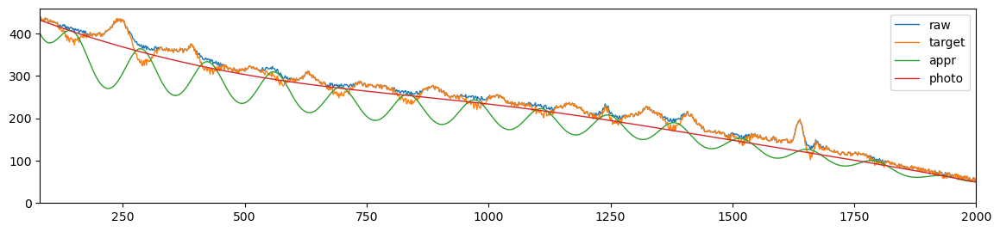

3072.2747268866933 1726.0735742676095 4.705338290913298 2.0464830299314505
FWHM: 150,	 width: 0.5000013675960908,	 RBF shape: (1250, 14),	 error: 3072.2747268866933, 	 smoothness: 4.705338290913298


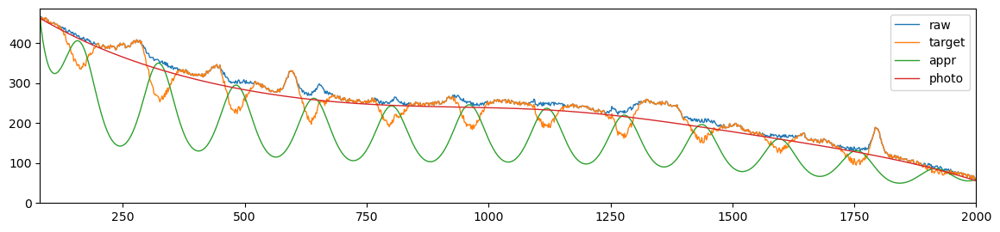

159.5300730904781 40.72249850054212 0.3254087804329843 0.1337366515507217
FWHM: 200,	 width: 0.99,	 RBF shape: (1250, 81),	 error: 159.5300730904781, 	 smoothness: 0.3254087804329843


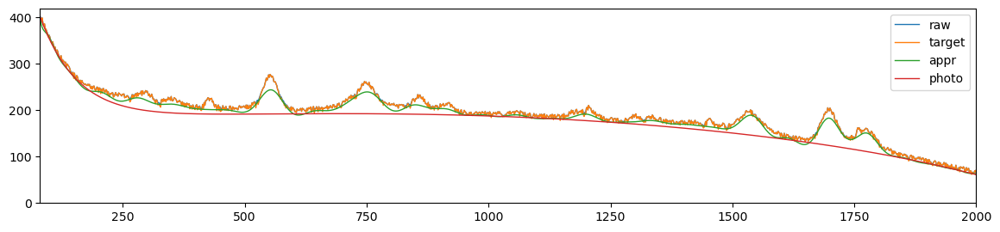

157.42618820534813 39.82599120182823 0.29373053761727447 0.11511088959115504
FWHM: 200,	 width: 0.98,	 RBF shape: (1250, 58),	 error: 157.42618820534813, 	 smoothness: 0.29373053761727447


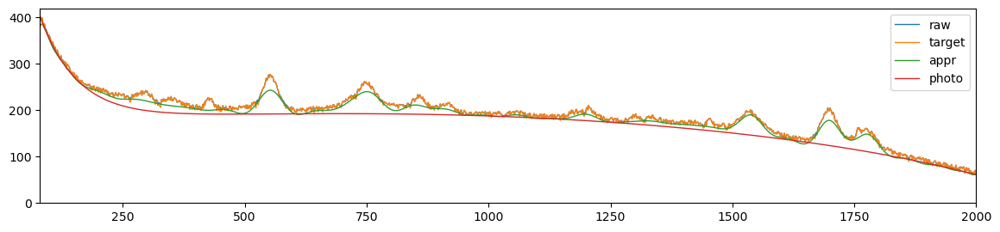

127.35662885641374 30.29168341780967 0.18151887296251717 0.07455507479867582
FWHM: 200,	 width: 0.97,	 RBF shape: (1250, 47),	 error: 127.35662885641374, 	 smoothness: 0.18151887296251717


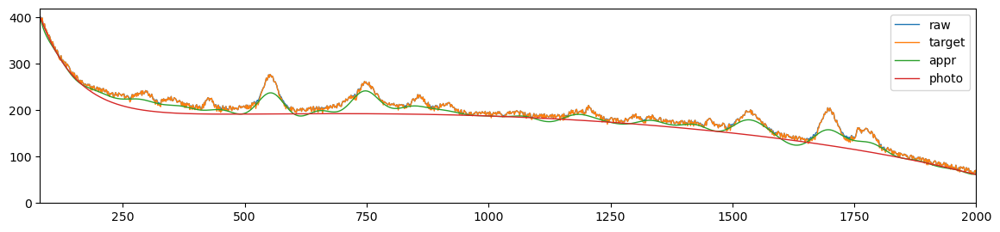

111.55017046599104 26.973223833215275 0.13448473552182405 0.056659026133392534
FWHM: 200,	 width: 0.96,	 RBF shape: (1250, 41),	 error: 111.55017046599104, 	 smoothness: 0.13448473552182405


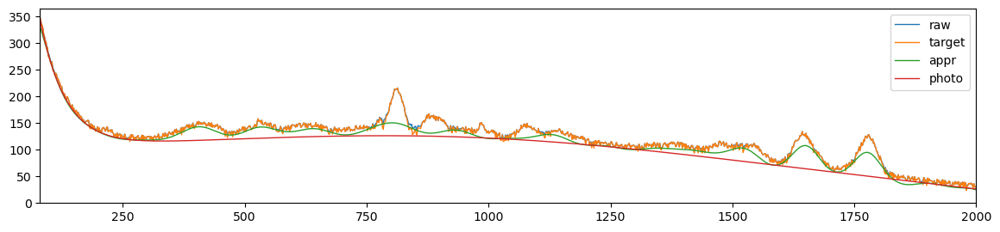

100.53204719025466 25.213176920204273 0.11781727187368082 0.06753623782219385
FWHM: 200,	 width: 0.95,	 RBF shape: (1250, 37),	 error: 100.53204719025466, 	 smoothness: 0.11781727187368082


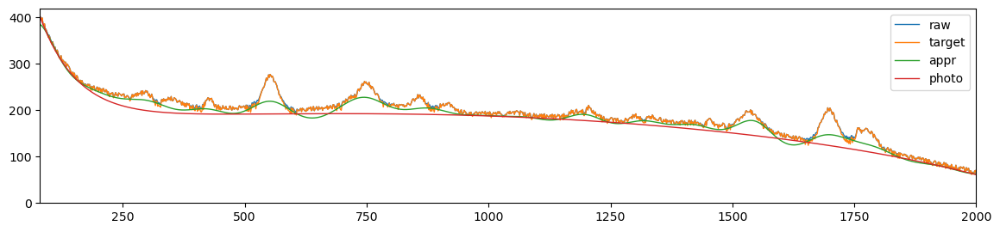

93.09938132942918 22.763021711922388 0.10353861267694003 0.048109905092256176
FWHM: 200,	 width: 0.94,	 RBF shape: (1250, 34),	 error: 93.09938132942918, 	 smoothness: 0.10353861267694003


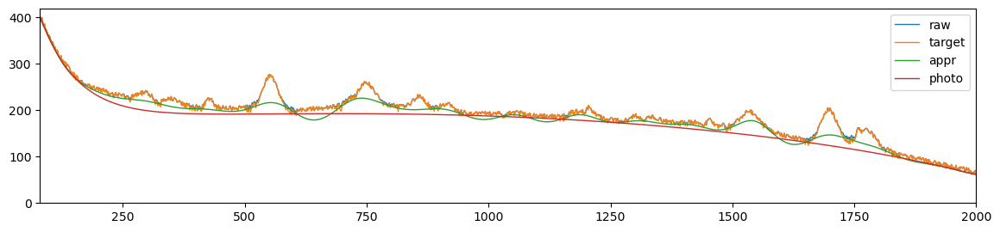

85.52665329565806 20.393685094443082 0.11373332237465862 0.05548735754064235
FWHM: 200,	 width: 0.93,	 RBF shape: (1250, 31),	 error: 85.52665329565806, 	 smoothness: 0.11373332237465862


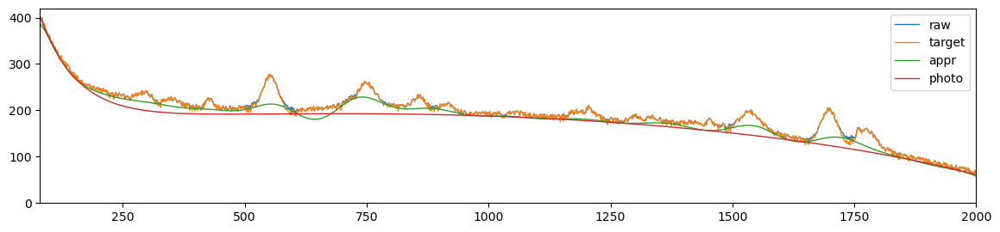

81.25280446595166 20.666670057602758 0.12017950211797848 0.057257847510754495
FWHM: 200,	 width: 0.92,	 RBF shape: (1250, 29),	 error: 81.25280446595166, 	 smoothness: 0.12017950211797848


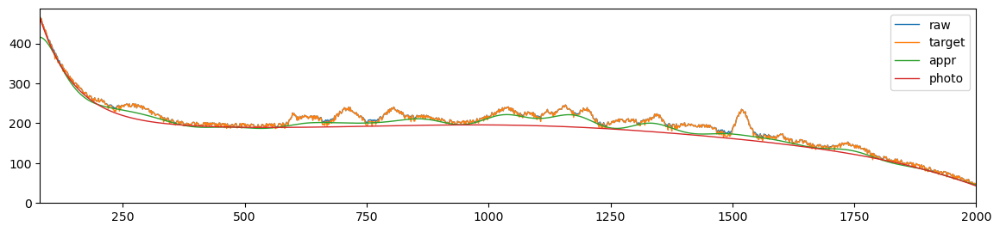

78.55545833145993 20.38853802979104 0.12428247950046523 0.05672437154838266
FWHM: 200,	 width: 0.91,	 RBF shape: (1250, 28),	 error: 78.55545833145993, 	 smoothness: 0.12428247950046523


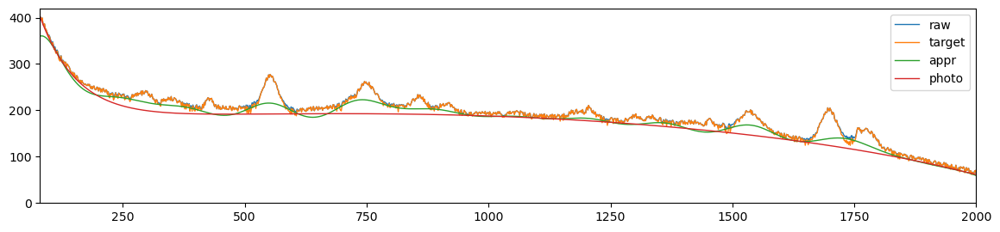

74.17909679052099 19.227357235132953 0.14427516216037958 0.06252757568000752
FWHM: 200,	 width: 0.9,	 RBF shape: (1250, 26),	 error: 74.17909679052099, 	 smoothness: 0.14427516216037958


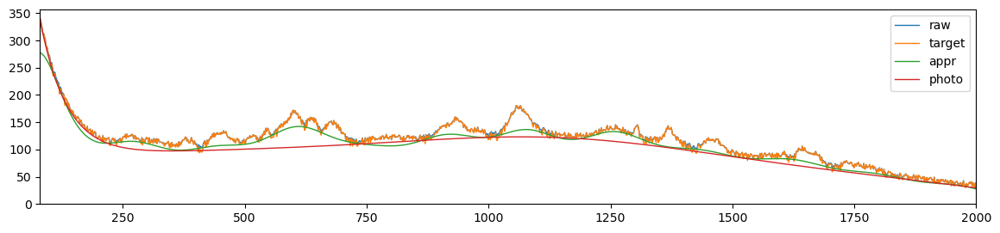

73.20654964357377 18.48186029983084 0.1554168490117097 0.06666255136346551
FWHM: 200,	 width: 0.89,	 RBF shape: (1250, 25),	 error: 73.20654964357377, 	 smoothness: 0.1554168490117097


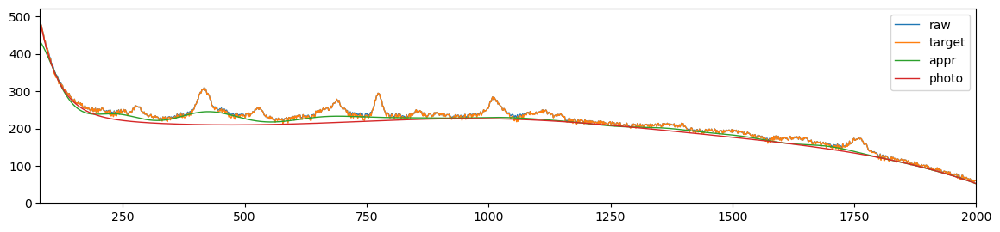

71.9123444699731 19.34694037321646 0.16664589716006722 0.07670221758249562
FWHM: 200,	 width: 0.88,	 RBF shape: (1250, 24),	 error: 71.9123444699731, 	 smoothness: 0.16664589716006722


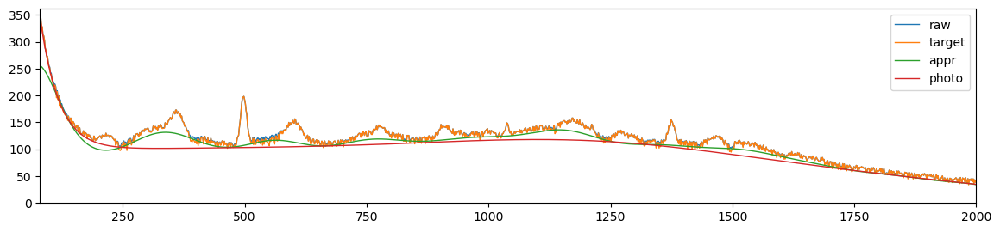

68.99112209067872 19.216783543890205 0.18897261643717325 0.08405628402138636
FWHM: 200,	 width: 0.8609598862125055,	 RBF shape: (1250, 22),	 error: 68.99112209067872, 	 smoothness: 0.18897261643717325


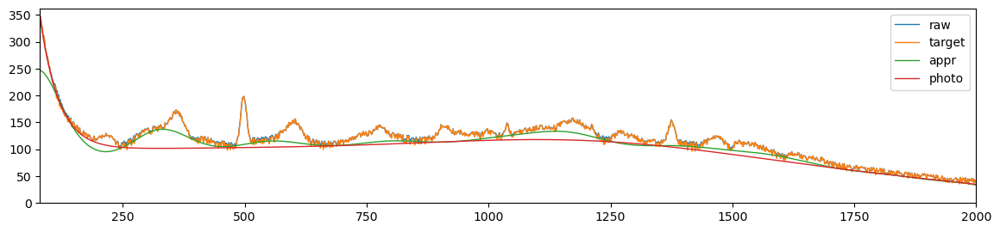

67.14479948366495 18.701404938508666 0.18468550145277318 0.08306514900568607
FWHM: 200,	 width: 0.8382945130946038,	 RBF shape: (1250, 21),	 error: 67.14479948366495, 	 smoothness: 0.18468550145277318


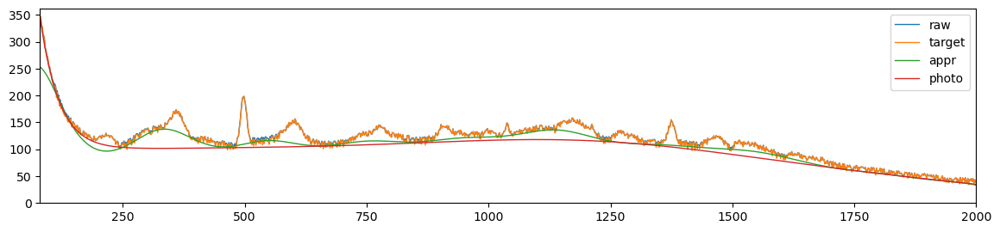

61.107199804988575 17.970532195252687 0.18831610386770264 0.09951183566606099
FWHM: 200,	 width: 0.8113136271446935,	 RBF shape: (1250, 19),	 error: 61.107199804988575, 	 smoothness: 0.18831610386770264


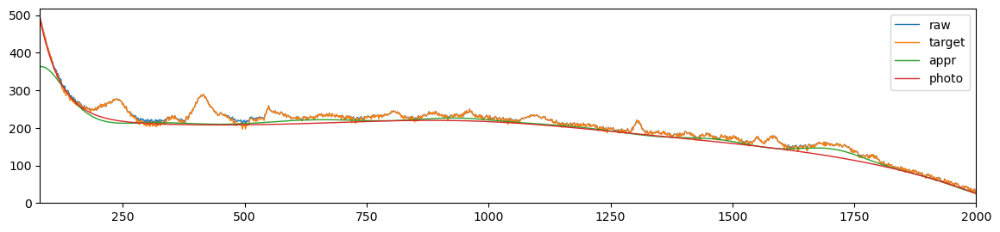

56.629630197299804 18.774640329367575 0.16298795715692818 0.09869116887456858
FWHM: 200,	 width: 0.7791955498090459,	 RBF shape: (1250, 18),	 error: 56.629630197299804, 	 smoothness: 0.16298795715692818


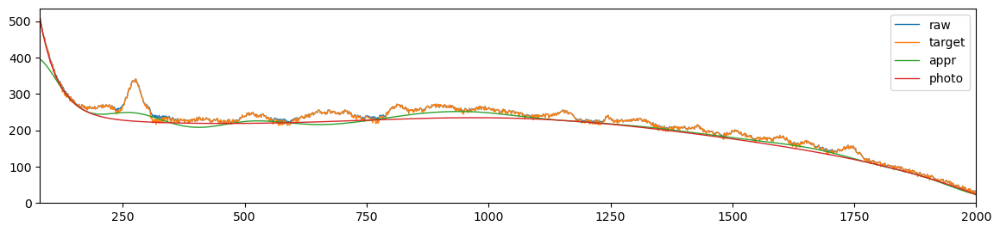

49.464077468738225 20.24119593642747 0.1287531655556076 0.09544696100208347
FWHM: 200,	 width: 0.7409621540023357,	 RBF shape: (1250, 16),	 error: 49.464077468738225, 	 smoothness: 0.1287531655556076


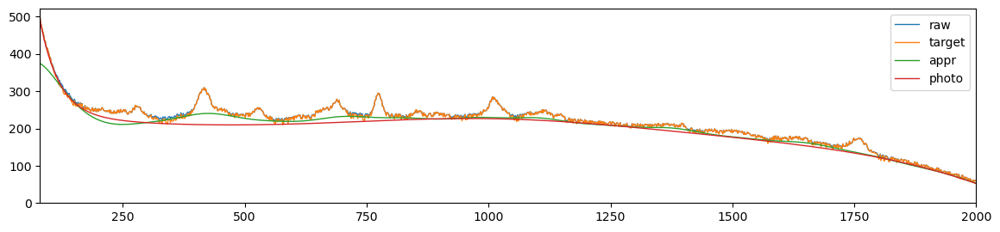

45.656759523807644 17.90149375431386 0.09950774012656138 0.07874902812948548
FWHM: 200,	 width: 0.6954490761292048,	 RBF shape: (1250, 15),	 error: 45.656759523807644, 	 smoothness: 0.09950774012656138


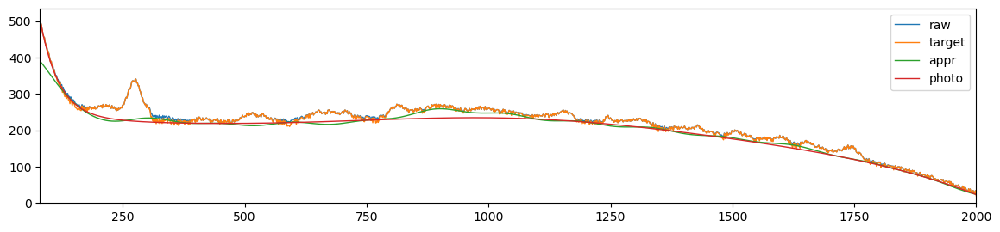

180.63266942280933 102.8838526488375 0.3231228062839637 0.15706609301647
FWHM: 200,	 width: 0.6412702564408389,	 RBF shape: (1250, 13),	 error: 180.63266942280933, 	 smoothness: 0.3231228062839637


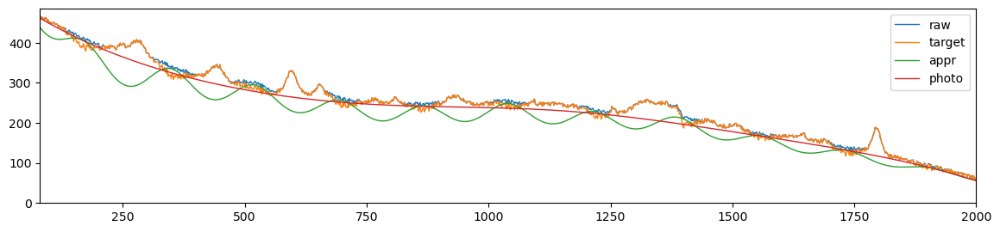

833.9976053844023 493.25566826857795 1.0523939618444325 0.5176145729682707
FWHM: 200,	 width: 0.5767757278350865,	 RBF shape: (1250, 12),	 error: 833.9976053844023, 	 smoothness: 1.0523939618444325


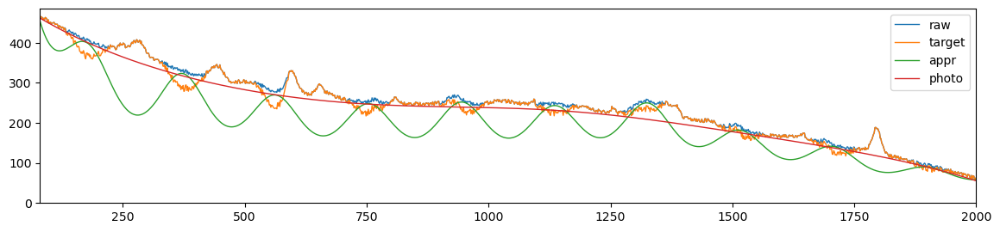

2951.1310773793934 1630.9230204675825 2.577175716747922 1.166053644207029
FWHM: 200,	 width: 0.5000013675960908,	 RBF shape: (1250, 11),	 error: 2951.1310773793934, 	 smoothness: 2.577175716747922


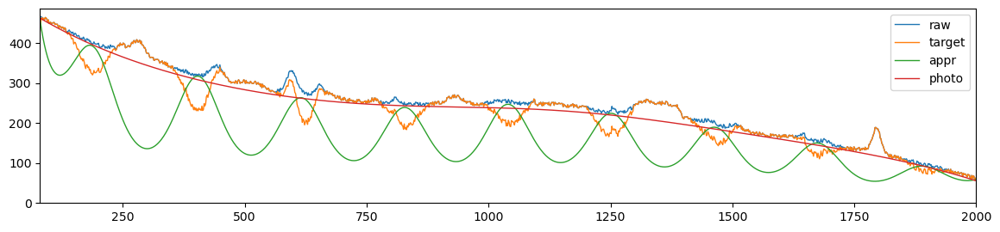

127.52163212526452 30.33221891297544 0.21882631406474523 0.11719740154234455
FWHM: 250,	 width: 0.99,	 RBF shape: (1250, 65),	 error: 127.52163212526452, 	 smoothness: 0.21882631406474523


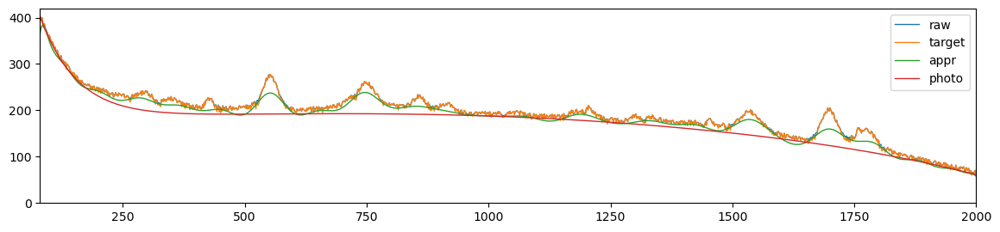

120.64638555039029 28.542198695451336 0.16975723362340742 0.06747985258227086
FWHM: 250,	 width: 0.98,	 RBF shape: (1250, 46),	 error: 120.64638555039029, 	 smoothness: 0.16975723362340742


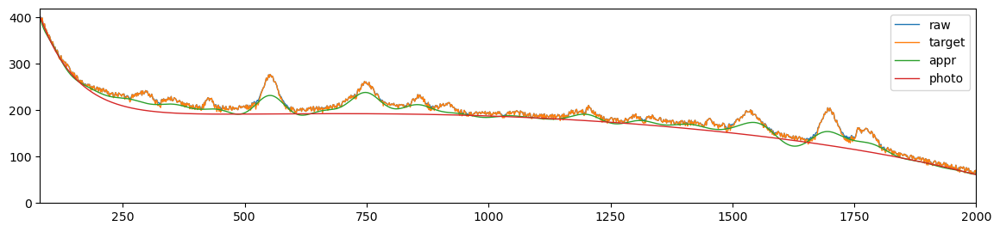

101.04698333717964 24.5189360723628 0.11999610685805236 0.0712065583756724
FWHM: 250,	 width: 0.97,	 RBF shape: (1250, 38),	 error: 101.04698333717964, 	 smoothness: 0.11999610685805236


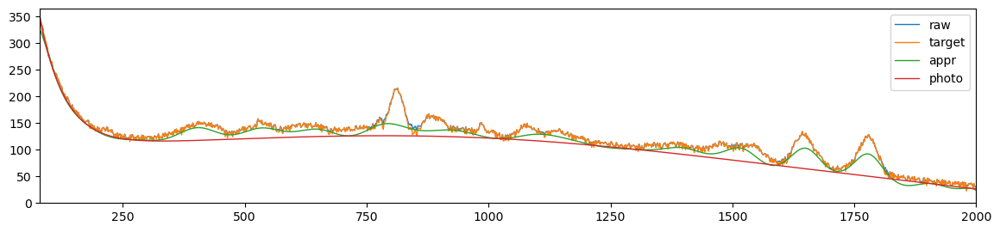

87.75691166260667 20.377192365000525 0.08397065384226565 0.044084840968861824
FWHM: 250,	 width: 0.96,	 RBF shape: (1250, 33),	 error: 87.75691166260667, 	 smoothness: 0.08397065384226565


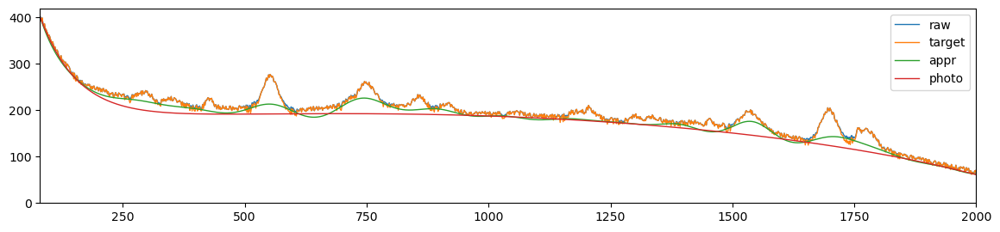

79.70126347080772 20.78910884398184 0.07497016336960094 0.04360798050596446
FWHM: 250,	 width: 0.95,	 RBF shape: (1250, 30),	 error: 79.70126347080772, 	 smoothness: 0.07497016336960094


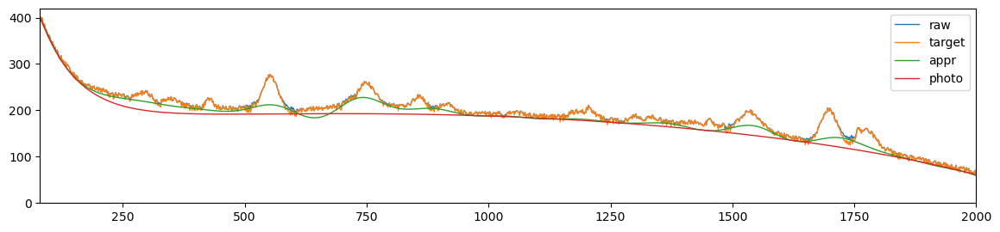

71.22643743219854 18.907490264692736 0.06431793694109818 0.03524748172892951
FWHM: 250,	 width: 0.94,	 RBF shape: (1250, 27),	 error: 71.22643743219854, 	 smoothness: 0.06431793694109818


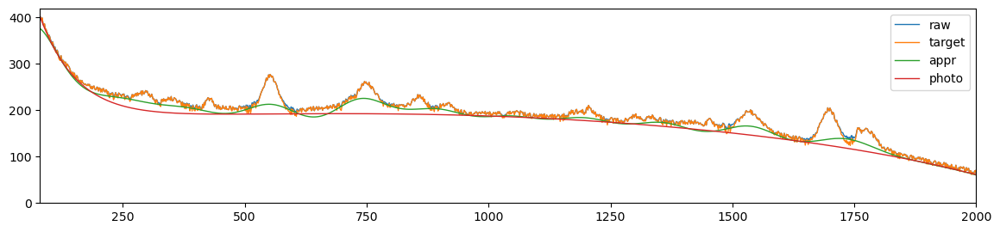

66.6818713553741 17.67057225390232 0.07478945790167288 0.040560314764356335
FWHM: 250,	 width: 0.93,	 RBF shape: (1250, 25),	 error: 66.6818713553741, 	 smoothness: 0.07478945790167288


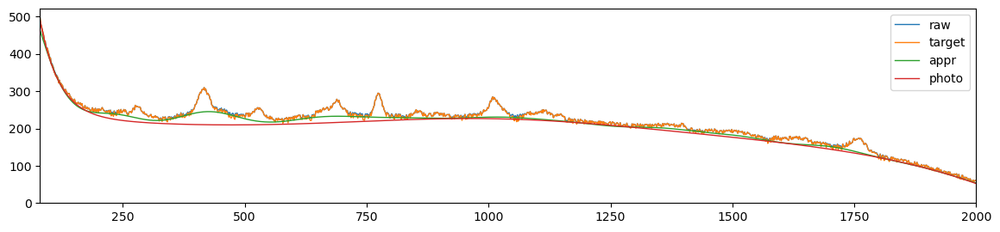

64.8171708536614 18.013645670998496 0.08302664575972685 0.04821805100322877
FWHM: 250,	 width: 0.92,	 RBF shape: (1250, 24),	 error: 64.8171708536614, 	 smoothness: 0.08302664575972685


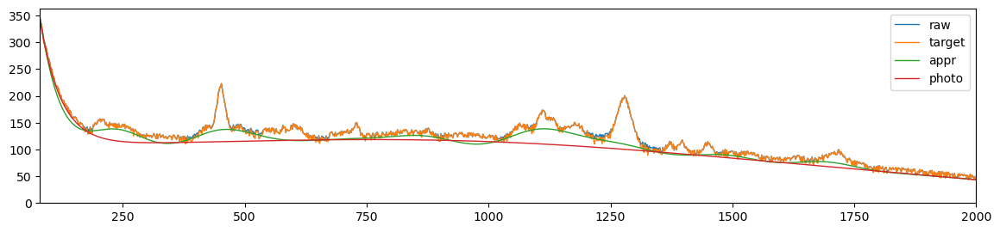

62.34238246103134 18.665230637485614 0.11041177364593403 0.06607169897511216
FWHM: 250,	 width: 0.91,	 RBF shape: (1250, 22),	 error: 62.34238246103134, 	 smoothness: 0.11041177364593403


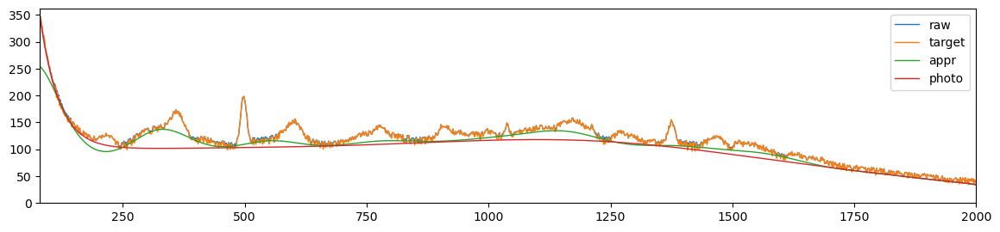

63.09823881328928 18.333026905386017 0.13206969223428094 0.06924720496081864
FWHM: 250,	 width: 0.9,	 RBF shape: (1250, 21),	 error: 63.09823881328928, 	 smoothness: 0.13206969223428094


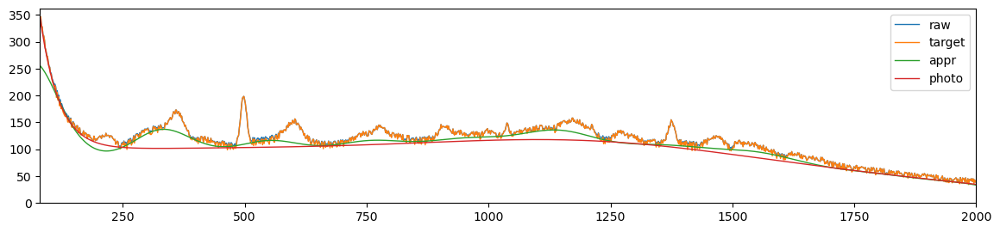

62.35897560575189 19.64799271372652 0.15105711326353224 0.08460490317135913
FWHM: 250,	 width: 0.89,	 RBF shape: (1250, 20),	 error: 62.35897560575189, 	 smoothness: 0.15105711326353224


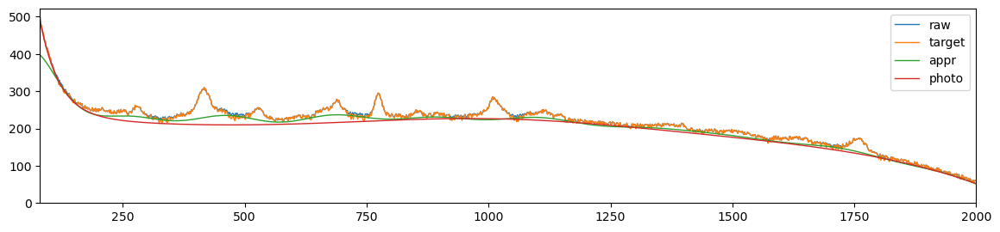

63.95274492353767 19.930261340051793 0.1820403546540811 0.10449650811937697
FWHM: 250,	 width: 0.88,	 RBF shape: (1250, 19),	 error: 63.95274492353767, 	 smoothness: 0.1820403546540811


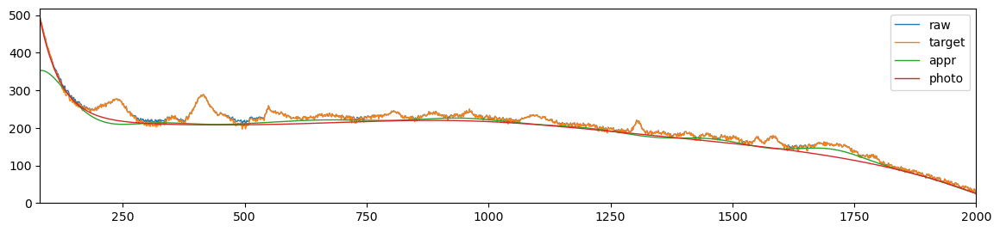

65.31163656580556 22.14697023030185 0.19545730272047984 0.11711595883573507
FWHM: 250,	 width: 0.8609598862125055,	 RBF shape: (1250, 18),	 error: 65.31163656580556, 	 smoothness: 0.19545730272047984


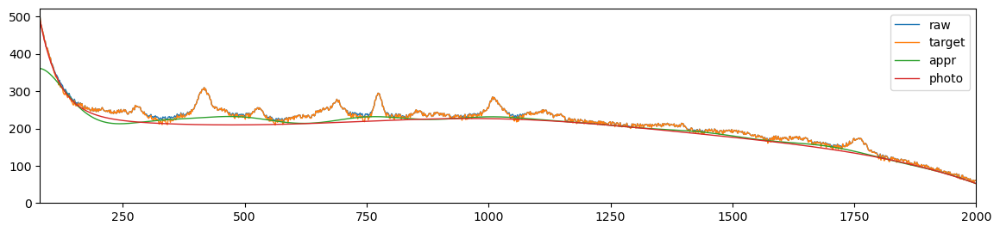

66.06616336273771 25.10362008315591 0.2004160282484779 0.1263507944243338
FWHM: 250,	 width: 0.8382945130946038,	 RBF shape: (1250, 17),	 error: 66.06616336273771, 	 smoothness: 0.2004160282484779


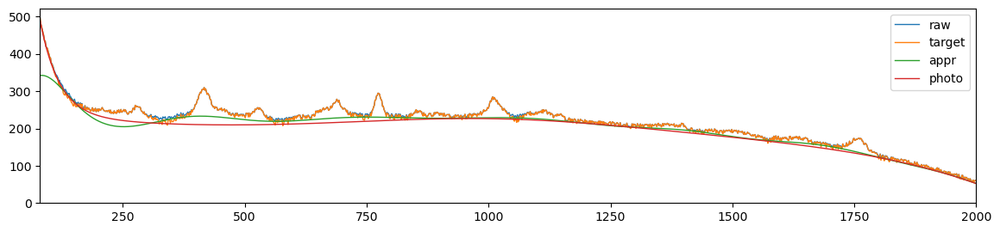

70.67943174921511 29.536584203958373 0.22741540257212534 0.1445728132131732
FWHM: 250,	 width: 0.8113136271446935,	 RBF shape: (1250, 15),	 error: 70.67943174921511, 	 smoothness: 0.22741540257212534


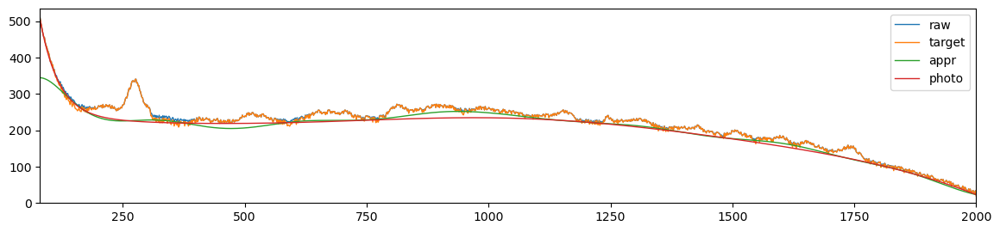

65.4582957724124 30.15803165267015 0.20405976297260975 0.1432343593984793
FWHM: 250,	 width: 0.7791955498090459,	 RBF shape: (1250, 14),	 error: 65.4582957724124, 	 smoothness: 0.20405976297260975


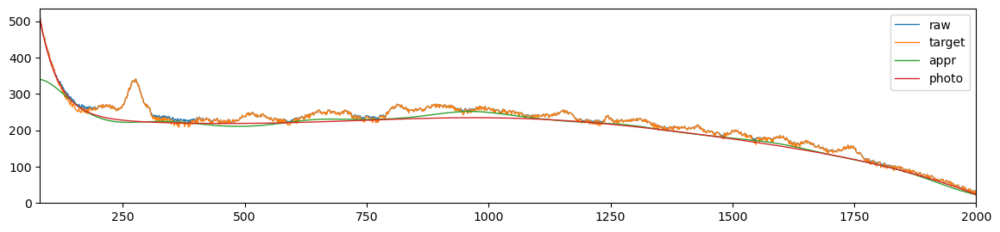

58.72245872325028 31.596007604642843 0.16829189519723706 0.13952504703625754
FWHM: 250,	 width: 0.7409621540023357,	 RBF shape: (1250, 13),	 error: 58.72245872325028, 	 smoothness: 0.16829189519723706


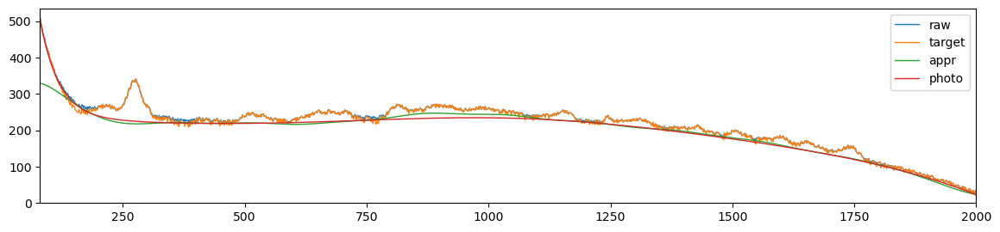

58.70765814941127 32.007567141002234 0.1405394091420778 0.12767863484589284
FWHM: 250,	 width: 0.6954490761292048,	 RBF shape: (1250, 12),	 error: 58.70765814941127, 	 smoothness: 0.1405394091420778


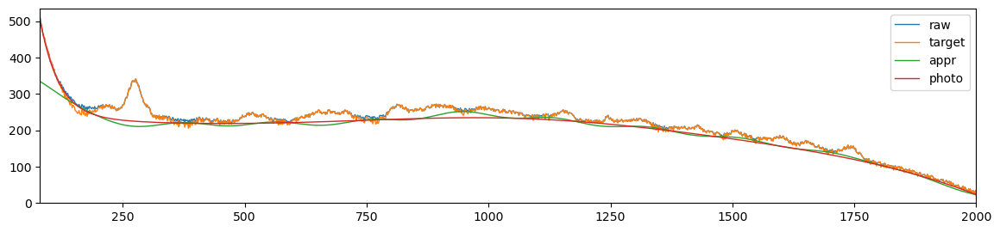

139.77392796638588 70.04787622052035 0.20257002620139303 0.11509761841873667
FWHM: 250,	 width: 0.6412702564408389,	 RBF shape: (1250, 11),	 error: 139.77392796638588, 	 smoothness: 0.20257002620139303


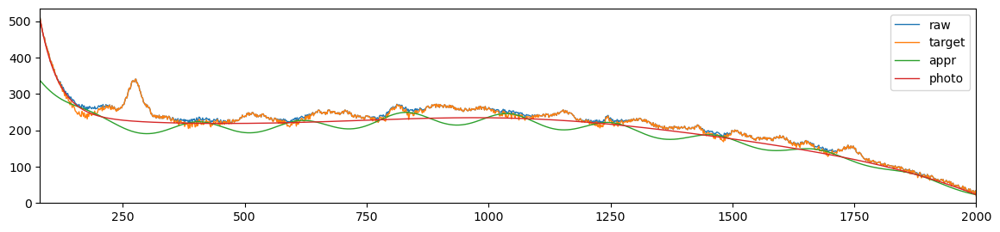

831.7319704856983 472.7216871365169 0.6621210989593267 0.3145384170138198
FWHM: 250,	 width: 0.5767757278350865,	 RBF shape: (1250, 10),	 error: 831.7319704856983, 	 smoothness: 0.6621210989593267


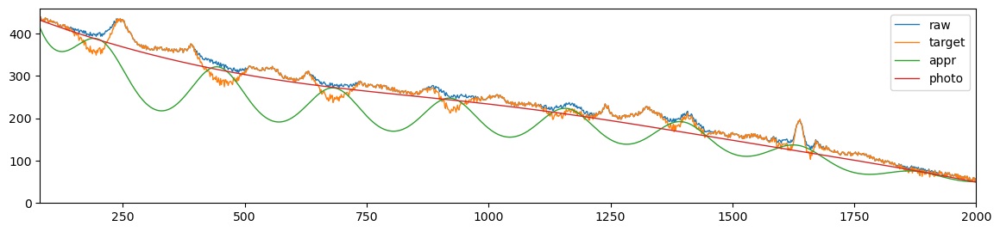

3508.454750787496 1881.2492536177917 1.9071982279842794 0.8901987398982979
FWHM: 250,	 width: 0.5000013675960908,	 RBF shape: (1250, 9),	 error: 3508.454750787496, 	 smoothness: 1.9071982279842794


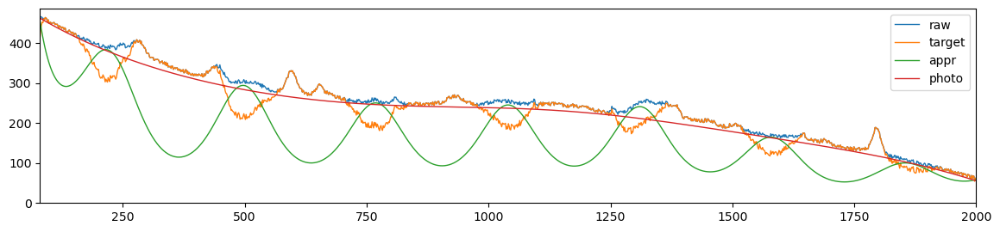

107.75448504554612 26.24910071210113 0.1569786353355581 0.09684225088486778
FWHM: 300,	 width: 0.99,	 RBF shape: (1250, 55),	 error: 107.75448504554612, 	 smoothness: 0.1569786353355581


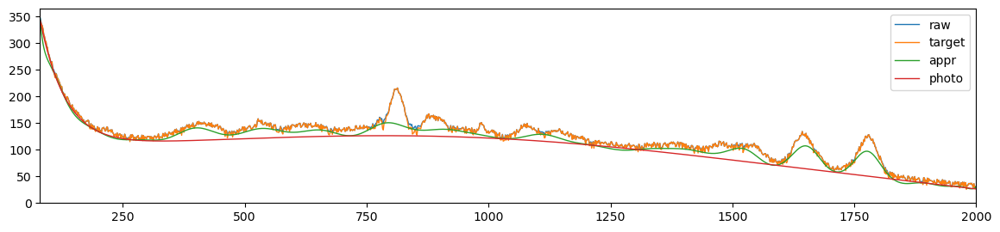

101.41846335435953 25.46422156884739 0.13333864768530643 0.08285263535131605
FWHM: 300,	 width: 0.98,	 RBF shape: (1250, 39),	 error: 101.41846335435953, 	 smoothness: 0.13333864768530643


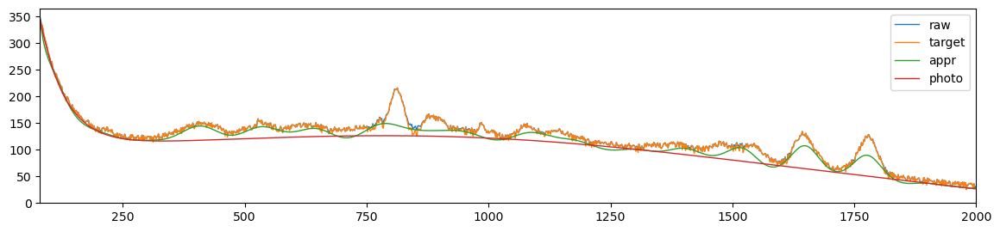

83.03908346834265 21.377277860644774 0.07867142974703366 0.04318866750246771
FWHM: 300,	 width: 0.97,	 RBF shape: (1250, 32),	 error: 83.03908346834265, 	 smoothness: 0.07867142974703366


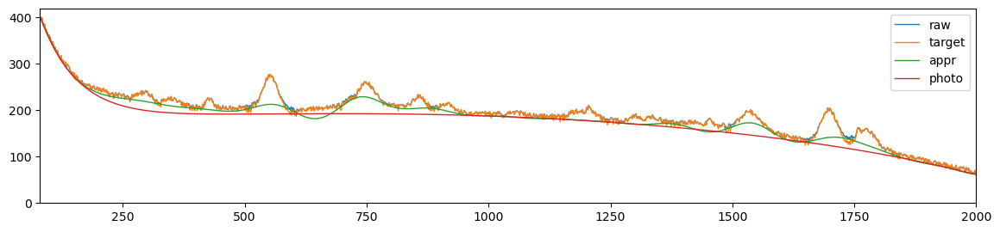

72.4831713169727 19.002908040708853 0.058659705265852645 0.03247289211670057
FWHM: 300,	 width: 0.96,	 RBF shape: (1250, 28),	 error: 72.4831713169727, 	 smoothness: 0.058659705265852645


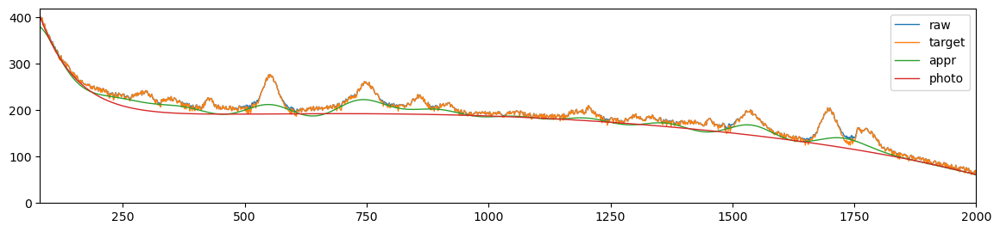

63.28210051745047 17.097704484987446 0.04574947763540927 0.025156093423324546
FWHM: 300,	 width: 0.95,	 RBF shape: (1250, 25),	 error: 63.28210051745047, 	 smoothness: 0.04574947763540927


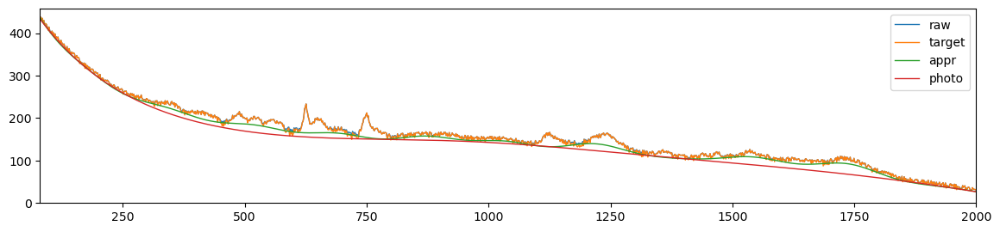

58.80110414921387 17.731263762629975 0.04967909443459464 0.03743079931732605
FWHM: 300,	 width: 0.94,	 RBF shape: (1250, 23),	 error: 58.80110414921387, 	 smoothness: 0.04967909443459464


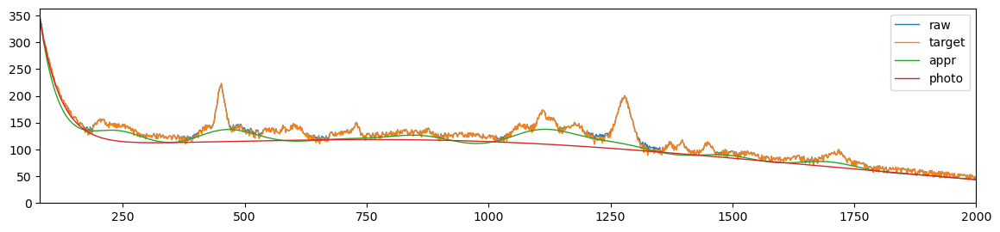

55.53187966580075 17.9476595027352 0.06510888797941325 0.04881366434867977
FWHM: 300,	 width: 0.93,	 RBF shape: (1250, 21),	 error: 55.53187966580075, 	 smoothness: 0.06510888797941325


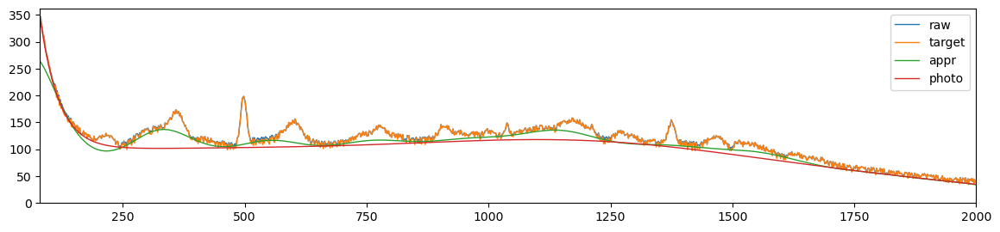

53.26502503924266 17.89240899700578 0.07275785194183368 0.053412119087988506
FWHM: 300,	 width: 0.92,	 RBF shape: (1250, 20),	 error: 53.26502503924266, 	 smoothness: 0.07275785194183368


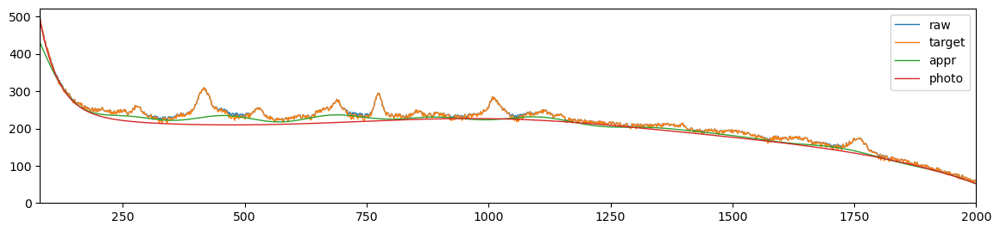

54.28402791694333 17.370993883361916 0.10532382107933619 0.0745378040756114
FWHM: 300,	 width: 0.91,	 RBF shape: (1250, 19),	 error: 54.28402791694333, 	 smoothness: 0.10532382107933619


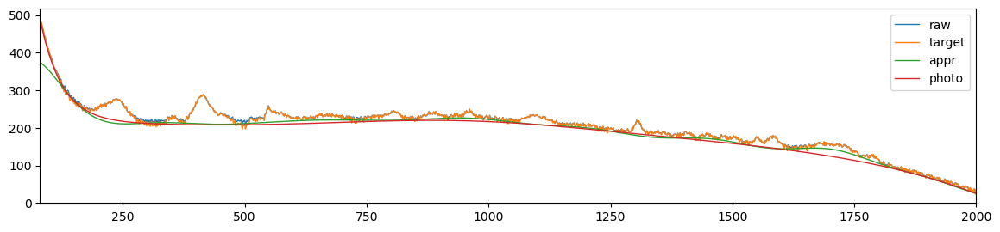

57.02450457278918 19.625328220859313 0.13167247768333054 0.09269121264941846
FWHM: 300,	 width: 0.9,	 RBF shape: (1250, 18),	 error: 57.02450457278918, 	 smoothness: 0.13167247768333054


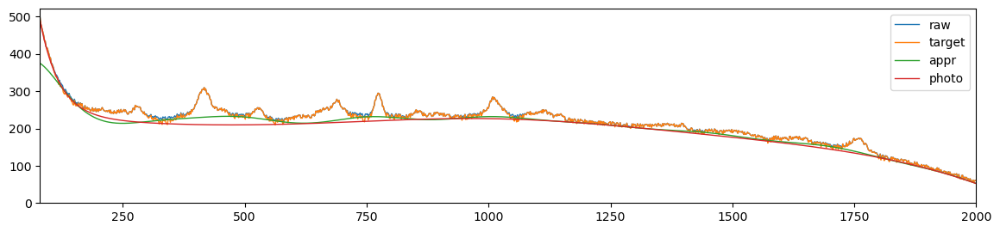

63.4520600584077 25.8067033137861 0.16678388358178467 0.11928441797341917
FWHM: 300,	 width: 0.89,	 RBF shape: (1250, 17),	 error: 63.4520600584077, 	 smoothness: 0.16678388358178467


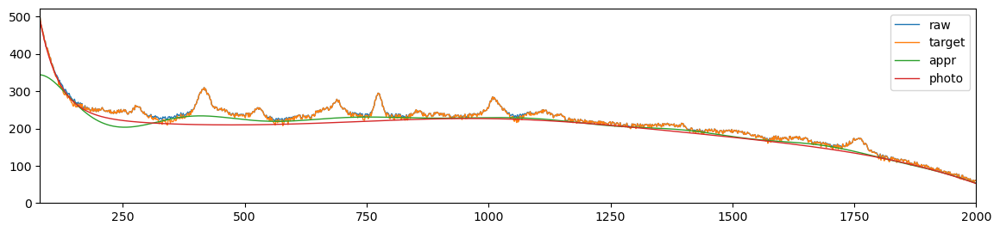

70.5405251393759 29.124952422232457 0.20258855514549912 0.13286265217440751
FWHM: 300,	 width: 0.88,	 RBF shape: (1250, 16),	 error: 70.5405251393759, 	 smoothness: 0.20258855514549912


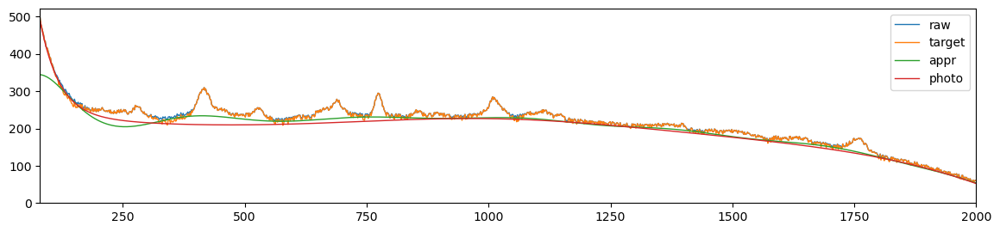

78.70014515444794 33.00140218271451 0.2363351717776631 0.1513882077435648
FWHM: 300,	 width: 0.8609598862125055,	 RBF shape: (1250, 15),	 error: 78.70014515444794, 	 smoothness: 0.2363351717776631


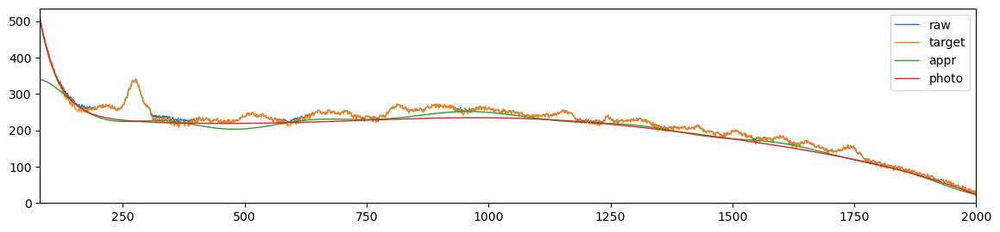

83.8288304059553 37.129046249158954 0.25318709491805375 0.16365916314687504
FWHM: 300,	 width: 0.8382945130946038,	 RBF shape: (1250, 14),	 error: 83.8288304059553, 	 smoothness: 0.25318709491805375


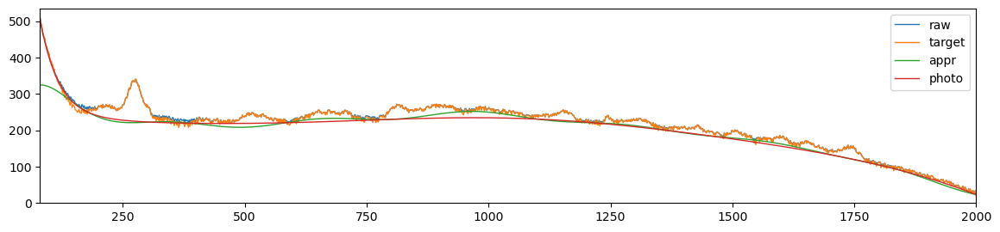

85.50084987933525 43.876109282699176 0.25267014854330705 0.17766046234905597
FWHM: 300,	 width: 0.8113136271446935,	 RBF shape: (1250, 13),	 error: 85.50084987933525, 	 smoothness: 0.25267014854330705


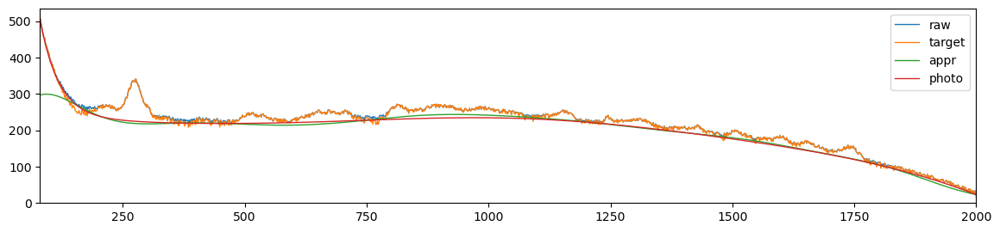

83.42852859328262 49.98916491714992 0.23905523325526432 0.18608199853233454
FWHM: 300,	 width: 0.7791955498090459,	 RBF shape: (1250, 12),	 error: 83.42852859328262, 	 smoothness: 0.23905523325526432


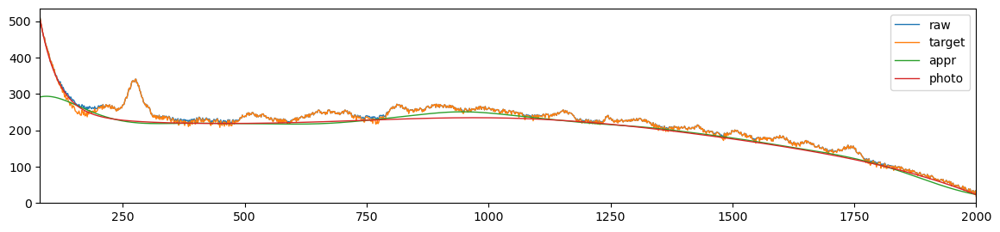

79.51505845993375 53.46753030822279 0.21431720639722987 0.19010643327031004
FWHM: 300,	 width: 0.7409621540023357,	 RBF shape: (1250, 11),	 error: 79.51505845993375, 	 smoothness: 0.21431720639722987


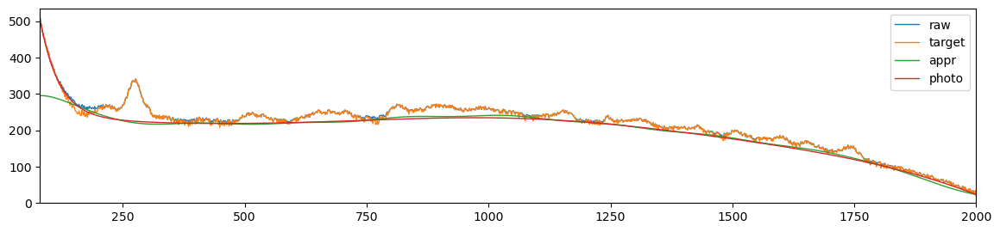

95.52519210706384 61.70416510677777 0.1959875633380445 0.187173693448575
FWHM: 300,	 width: 0.6954490761292048,	 RBF shape: (1250, 10),	 error: 95.52519210706384, 	 smoothness: 0.1959875633380445


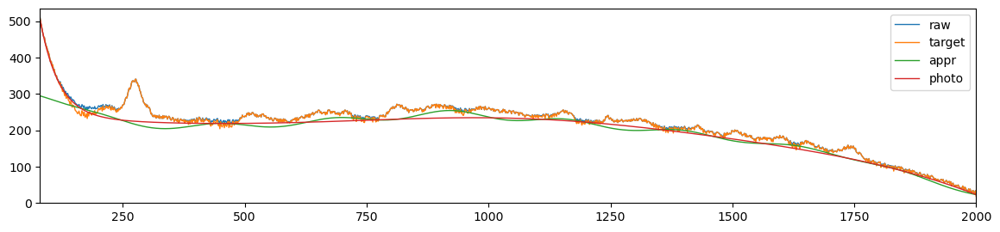

384.34724454939465 191.87819152655797 0.3240277439234736 0.16547962360152335
FWHM: 300,	 width: 0.6412702564408389,	 RBF shape: (1250, 9),	 error: 384.34724454939465, 	 smoothness: 0.3240277439234736


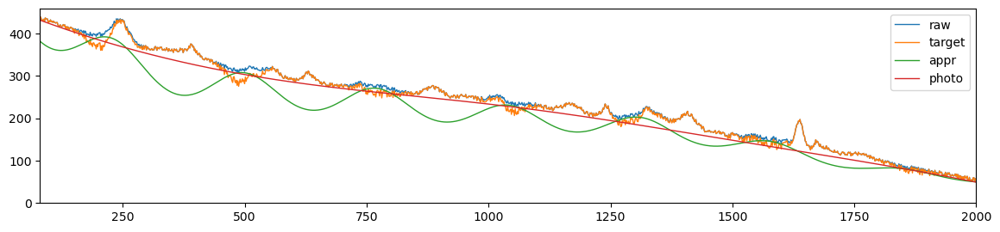

473.11487556410447 244.22888785742876 0.35984009189600275 0.17596178643501056
FWHM: 300,	 width: 0.5767757278350865,	 RBF shape: (1250, 9),	 error: 473.11487556410447, 	 smoothness: 0.35984009189600275


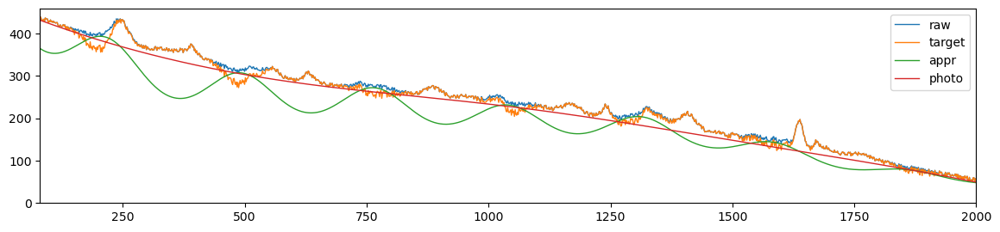

2722.583849256864 1447.1503572867798 1.0876725193284411 0.5276239738195091
FWHM: 300,	 width: 0.5000013675960908,	 RBF shape: (1250, 8),	 error: 2722.583849256864, 	 smoothness: 1.0876725193284411


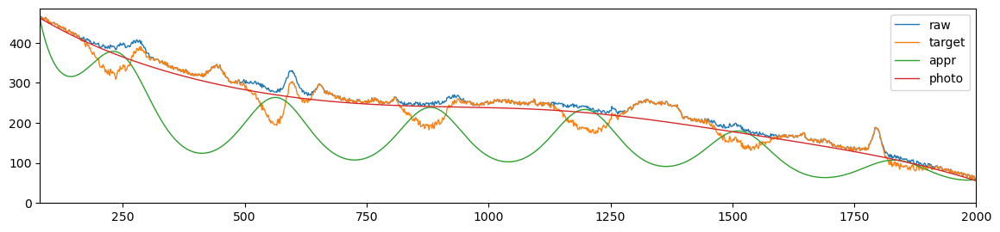

94.14747039721753 23.672740537207016 0.13021050963390593 0.09704954918524272
FWHM: 350,	 width: 0.99,	 RBF shape: (1250, 47),	 error: 94.14747039721753, 	 smoothness: 0.13021050963390593


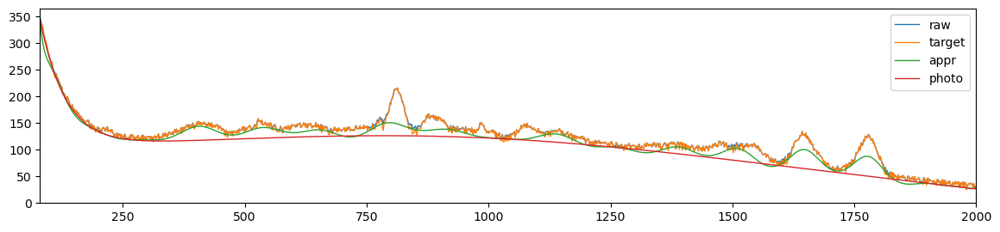

86.05158571943531 20.82675269413525 0.10059543571248053 0.09987284786147067
FWHM: 350,	 width: 0.98,	 RBF shape: (1250, 34),	 error: 86.05158571943531, 	 smoothness: 0.10059543571248053


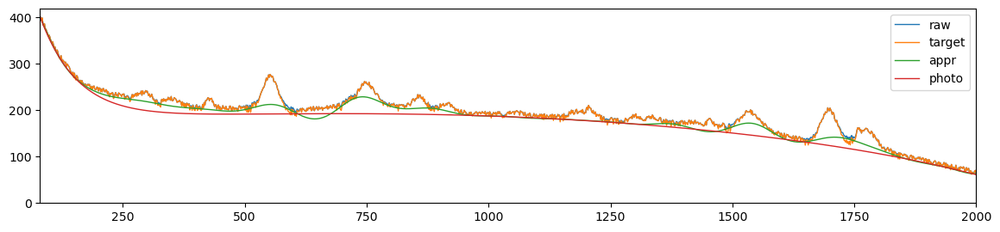

71.06794813924584 18.575294813717743 0.059895067927226577 0.03799447014286788
FWHM: 350,	 width: 0.97,	 RBF shape: (1250, 28),	 error: 71.06794813924584, 	 smoothness: 0.059895067927226577


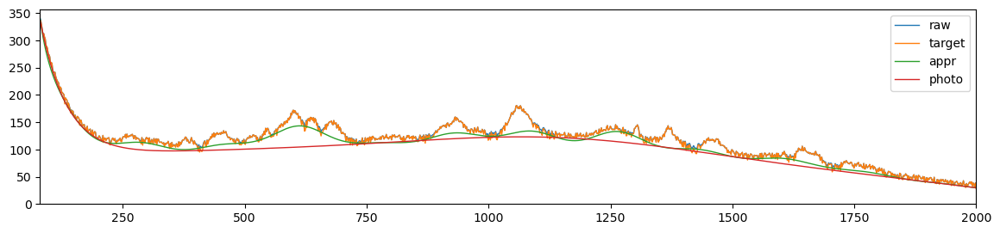

59.148527127222536 16.60518913602334 0.039860557433255527 0.024386353926042745
FWHM: 350,	 width: 0.96,	 RBF shape: (1250, 24),	 error: 59.148527127222536, 	 smoothness: 0.039860557433255527


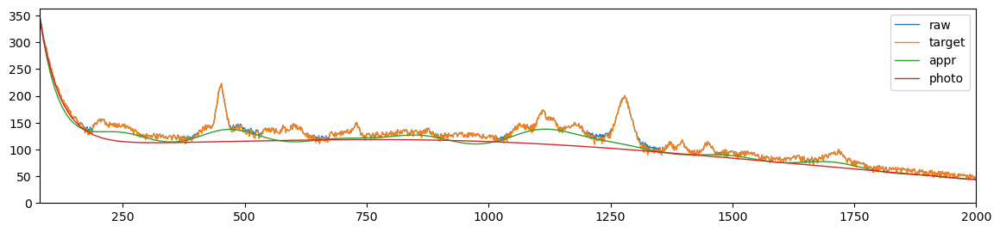

54.00747412432325 17.842366783081502 0.03817311768532346 0.047257676814428204
FWHM: 350,	 width: 0.95,	 RBF shape: (1250, 22),	 error: 54.00747412432325, 	 smoothness: 0.03817311768532346


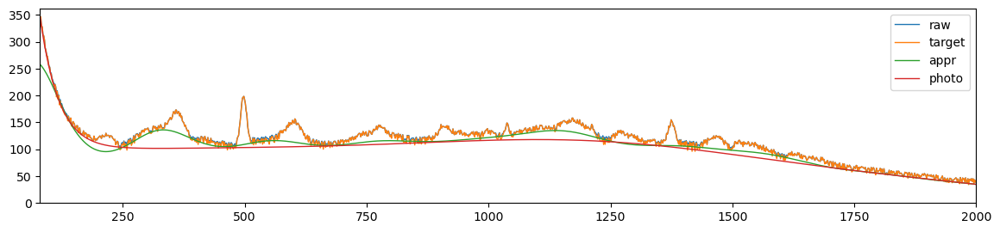

48.724420475096025 17.367284175095612 0.034471012726777946 0.03017893223795431
FWHM: 350,	 width: 0.94,	 RBF shape: (1250, 20),	 error: 48.724420475096025, 	 smoothness: 0.034471012726777946


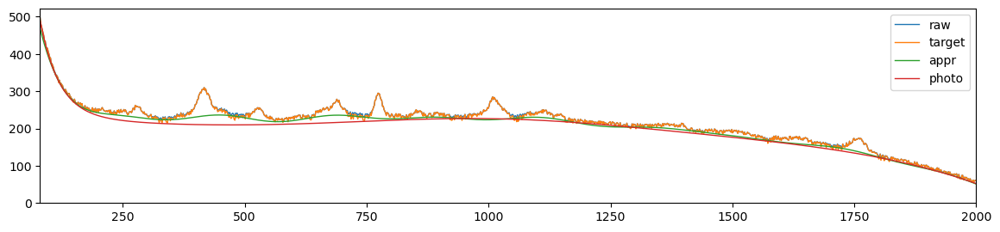

48.031993045023526 16.60704733320814 0.07165742413941649 0.060912212963559226
FWHM: 350,	 width: 0.93,	 RBF shape: (1250, 18),	 error: 48.031993045023526, 	 smoothness: 0.07165742413941649


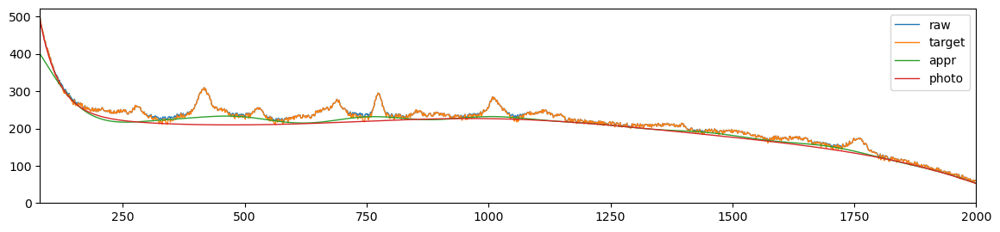

53.76911959116385 23.059519924951353 0.10621375598388008 0.09641216101163587
FWHM: 350,	 width: 0.92,	 RBF shape: (1250, 17),	 error: 53.76911959116385, 	 smoothness: 0.10621375598388008


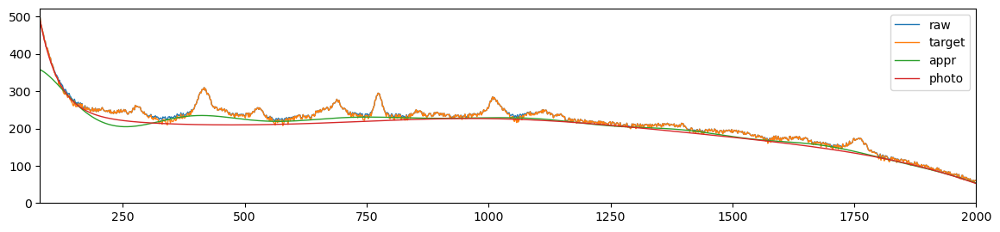

58.898194583678304 25.360879711779592 0.13942654939265206 0.10813546107749131
FWHM: 350,	 width: 0.91,	 RBF shape: (1250, 16),	 error: 58.898194583678304, 	 smoothness: 0.13942654939265206


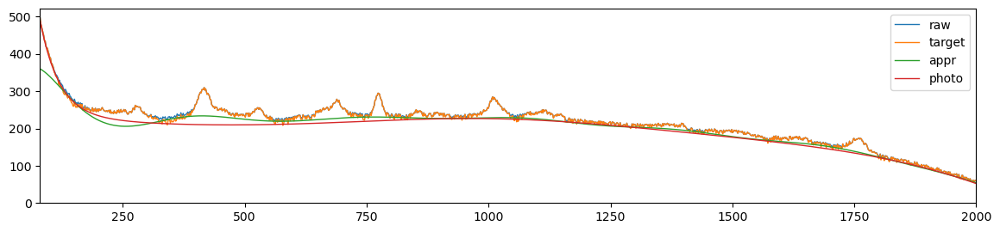

56.63860302853479 24.328786881996166 0.1294684868362951 0.10312953814818981
FWHM: 350,	 width: 0.9,	 RBF shape: (1250, 16),	 error: 56.63860302853479, 	 smoothness: 0.1294684868362951


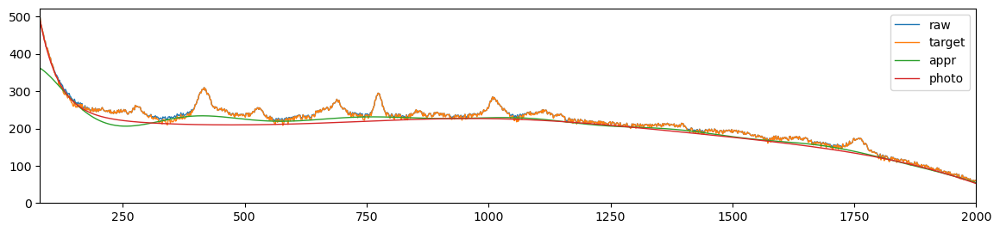

69.88595673692431 31.052146933155278 0.18659027283752289 0.13572950713276782
FWHM: 350,	 width: 0.89,	 RBF shape: (1250, 15),	 error: 69.88595673692431, 	 smoothness: 0.18659027283752289


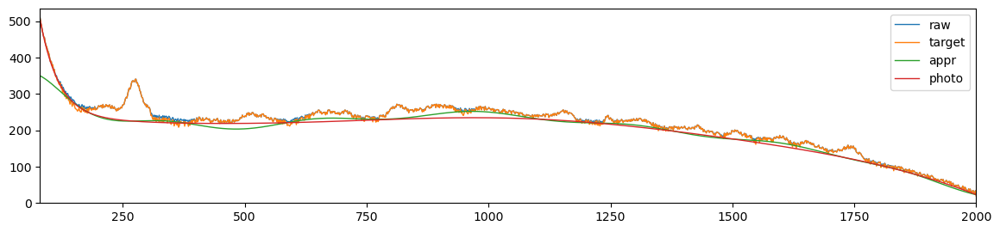

84.63178238170386 38.06472887387879 0.2367681459506459 0.15970554969888412
FWHM: 350,	 width: 0.88,	 RBF shape: (1250, 14),	 error: 84.63178238170386, 	 smoothness: 0.2367681459506459


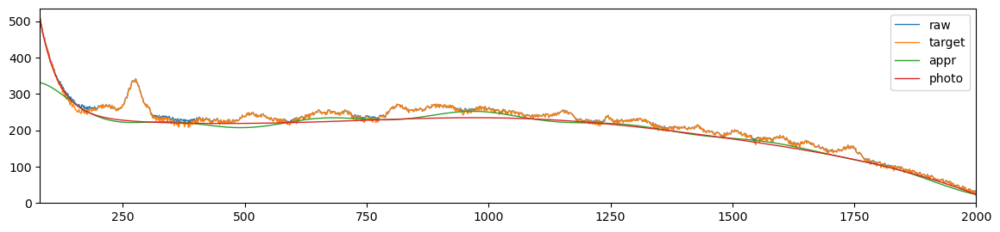

97.53806509346838 49.183393923955094 0.2686466995641244 0.18558542247436938
FWHM: 350,	 width: 0.8609598862125055,	 RBF shape: (1250, 13),	 error: 97.53806509346838, 	 smoothness: 0.2686466995641244


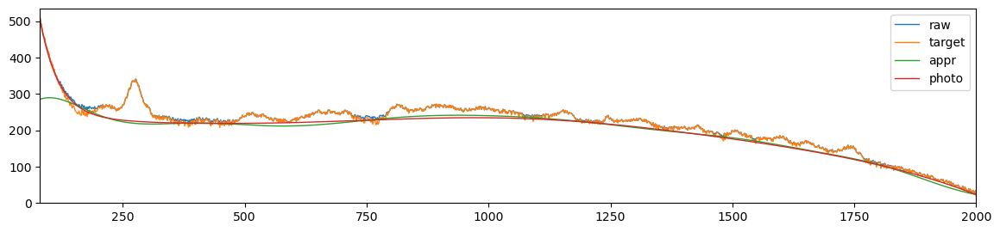

111.15052708965013 60.504003252037485 0.2962688250690517 0.20909740979442393
FWHM: 350,	 width: 0.8382945130946038,	 RBF shape: (1250, 12),	 error: 111.15052708965013, 	 smoothness: 0.2962688250690517


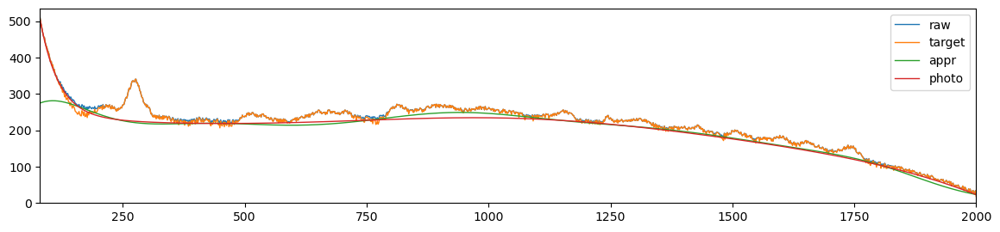

122.20790671555751 70.7497723075998 0.3099633509605244 0.23031694274571862
FWHM: 350,	 width: 0.8113136271446935,	 RBF shape: (1250, 11),	 error: 122.20790671555751, 	 smoothness: 0.3099633509605244


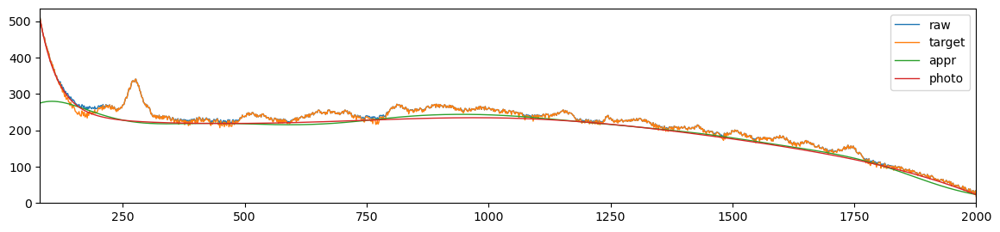

104.16468174964437 63.67602735984914 0.2696809563397343 0.21383466417132305
FWHM: 350,	 width: 0.7791955498090459,	 RBF shape: (1250, 11),	 error: 104.16468174964437, 	 smoothness: 0.2696809563397343


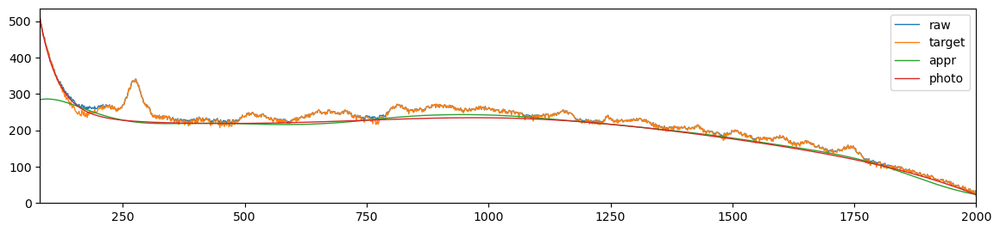

109.39719802257204 76.2835382575308 0.26414427226332987 0.23185016803311573
FWHM: 350,	 width: 0.7409621540023357,	 RBF shape: (1250, 10),	 error: 109.39719802257204, 	 smoothness: 0.26414427226332987


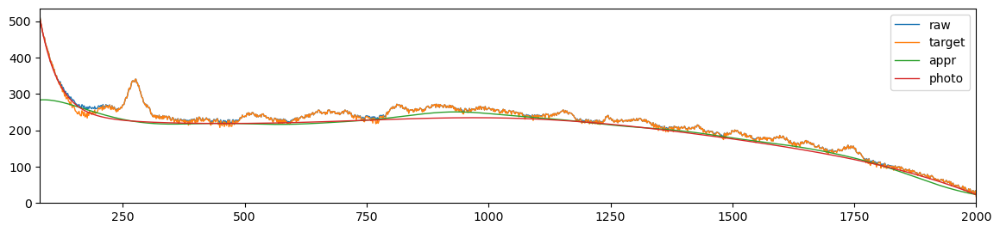

121.66595084954099 82.83151911060173 0.24343922430081275 0.22836791594445305
FWHM: 350,	 width: 0.6954490761292048,	 RBF shape: (1250, 9),	 error: 121.66595084954099, 	 smoothness: 0.24343922430081275


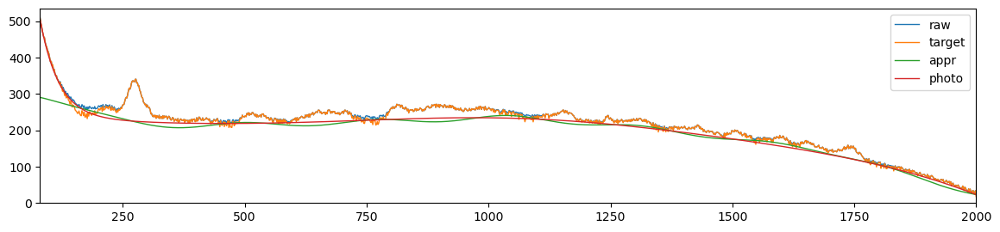

402.715409262379 182.79040663680914 0.30777461481646134 0.1927291724147712
FWHM: 350,	 width: 0.6412702564408389,	 RBF shape: (1250, 8),	 error: 402.715409262379, 	 smoothness: 0.30777461481646134


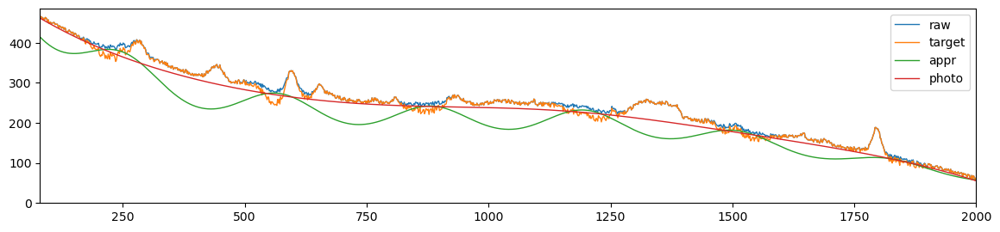

501.39035131946844 237.4656129233127 0.3406675516970906 0.20141912422974032
FWHM: 350,	 width: 0.5767757278350865,	 RBF shape: (1250, 8),	 error: 501.39035131946844, 	 smoothness: 0.3406675516970906


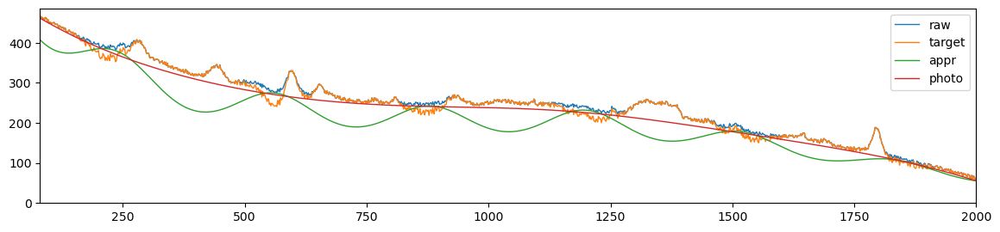

3247.654729117449 1709.375871955663 0.9122098684120374 0.4590578900003278
FWHM: 350,	 width: 0.5000013675960908,	 RBF shape: (1250, 7),	 error: 3247.654729117449, 	 smoothness: 0.9122098684120374


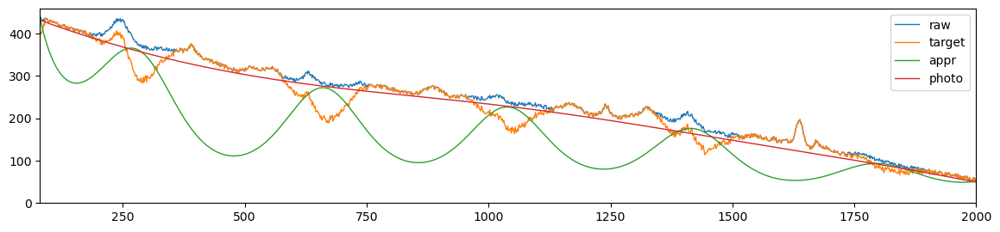

82.08114979877828 21.29174139678843 0.0987946747660674 0.07041726347996824
FWHM: 400,	 width: 0.99,	 RBF shape: (1250, 41),	 error: 82.08114979877828, 	 smoothness: 0.0987946747660674


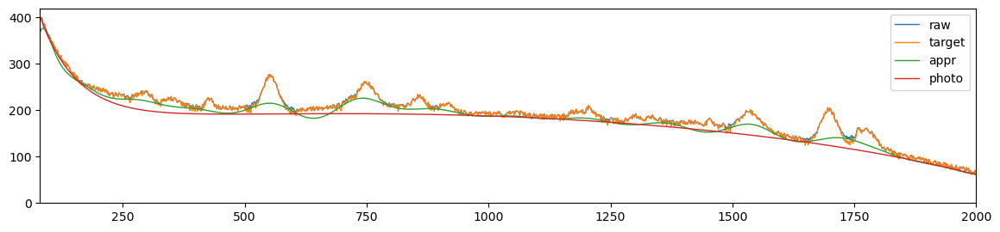

74.49055111673265 19.59721520925511 0.07038283832798352 0.04245301486658823
FWHM: 400,	 width: 0.98,	 RBF shape: (1250, 30),	 error: 74.49055111673265, 	 smoothness: 0.07038283832798352


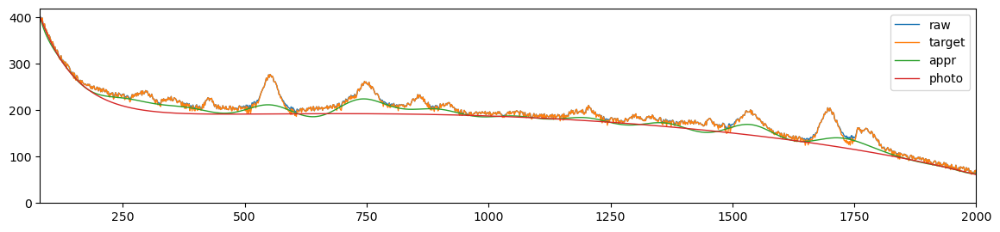

57.976869281066094 16.965029022142176 0.04028121284253219 0.029082539195148596
FWHM: 400,	 width: 0.97,	 RBF shape: (1250, 24),	 error: 57.976869281066094, 	 smoothness: 0.04028121284253219


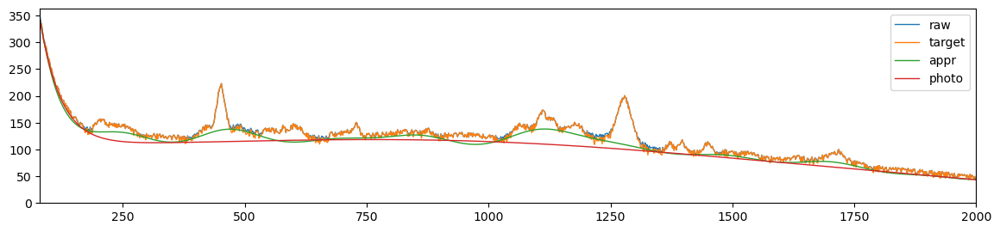

50.651050754206175 18.106957722038906 0.03459702318503253 0.047448075202131366
FWHM: 400,	 width: 0.96,	 RBF shape: (1250, 21),	 error: 50.651050754206175, 	 smoothness: 0.03459702318503253


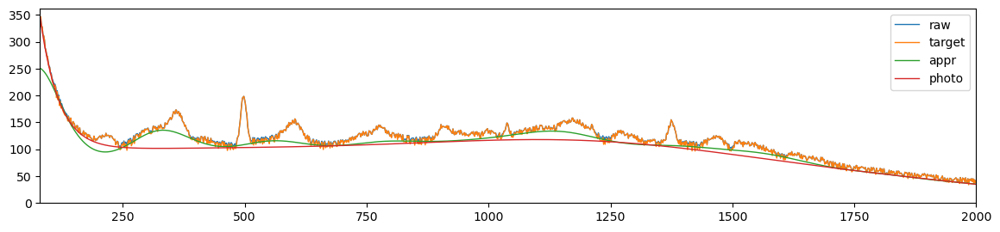

44.26916919209438 15.106193330962405 0.030848540511479436 0.027119036179754932
FWHM: 400,	 width: 0.95,	 RBF shape: (1250, 19),	 error: 44.26916919209438, 	 smoothness: 0.030848540511479436


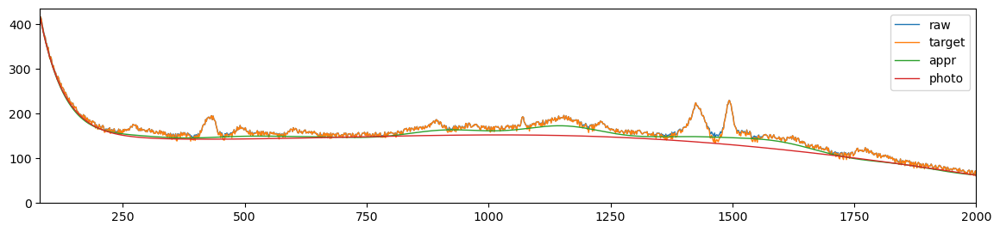

41.96217521826507 14.38663893972616 0.03166178202494034 0.027386160290303867
FWHM: 400,	 width: 0.94,	 RBF shape: (1250, 18),	 error: 41.96217521826507, 	 smoothness: 0.03166178202494034


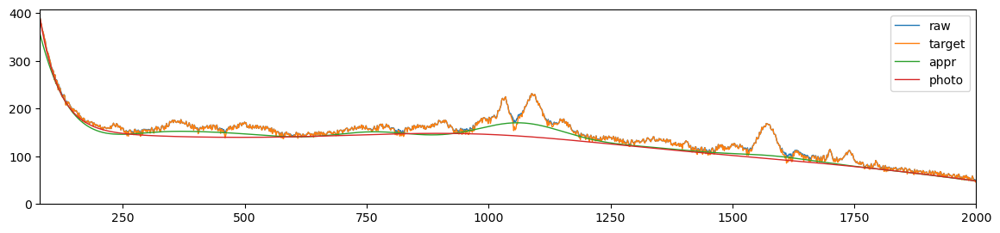

46.94744411109331 20.32512800796785 0.0788850486586858 0.07667339207593282
FWHM: 400,	 width: 0.93,	 RBF shape: (1250, 16),	 error: 46.94744411109331, 	 smoothness: 0.0788850486586858


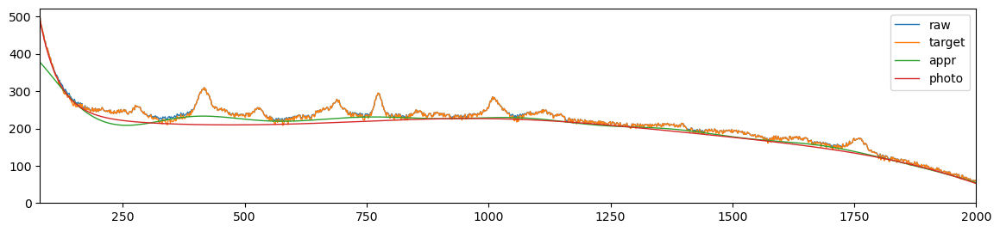

59.13279540335034 27.20796867558602 0.1366358910905226 0.11429778582077406
FWHM: 400,	 width: 0.92,	 RBF shape: (1250, 15),	 error: 59.13279540335034, 	 smoothness: 0.1366358910905226


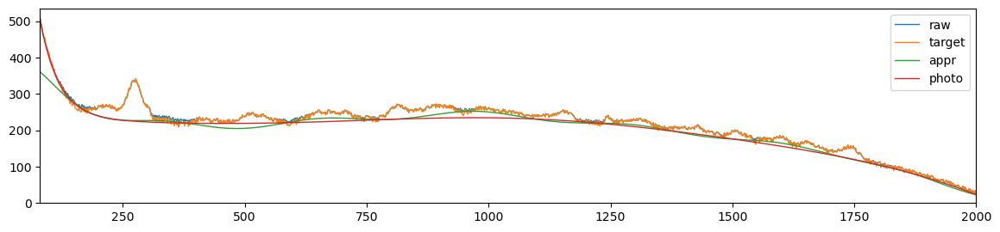

56.75623850560879 26.126533147670752 0.12809520218543102 0.10969974834192539
FWHM: 400,	 width: 0.91,	 RBF shape: (1250, 15),	 error: 56.75623850560879, 	 smoothness: 0.12809520218543102


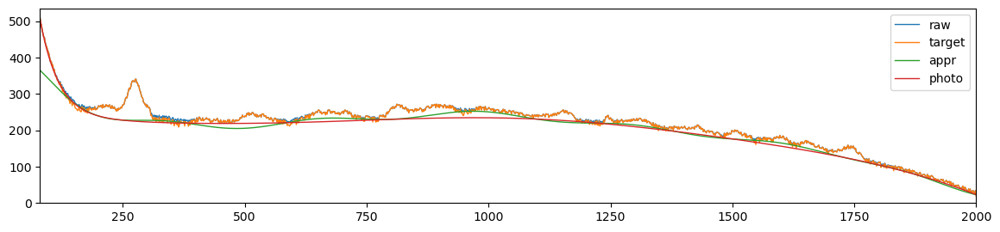

69.62171827454084 32.696649022952876 0.17779150375569233 0.13473413885364868
FWHM: 400,	 width: 0.9,	 RBF shape: (1250, 14),	 error: 69.62171827454084, 	 smoothness: 0.17779150375569233


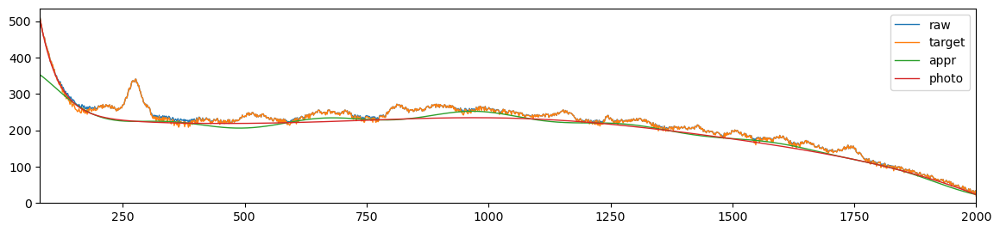

89.74970837071041 47.61358024123181 0.23249319296551804 0.17383880134188395
FWHM: 400,	 width: 0.89,	 RBF shape: (1250, 13),	 error: 89.74970837071041, 	 smoothness: 0.23249319296551804


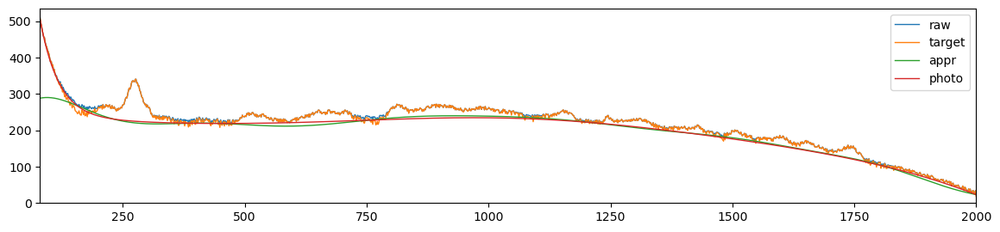

85.5035547852031 45.85612663474496 0.22099513313488317 0.1688785802261733
FWHM: 400,	 width: 0.88,	 RBF shape: (1250, 13),	 error: 85.5035547852031, 	 smoothness: 0.22099513313488317


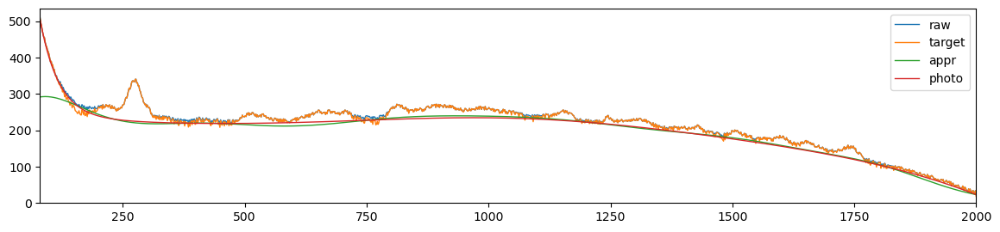

108.44035352230709 59.57032589613266 0.2738684282882015 0.2025285401750457
FWHM: 400,	 width: 0.8609598862125055,	 RBF shape: (1250, 12),	 error: 108.44035352230709, 	 smoothness: 0.2738684282882015


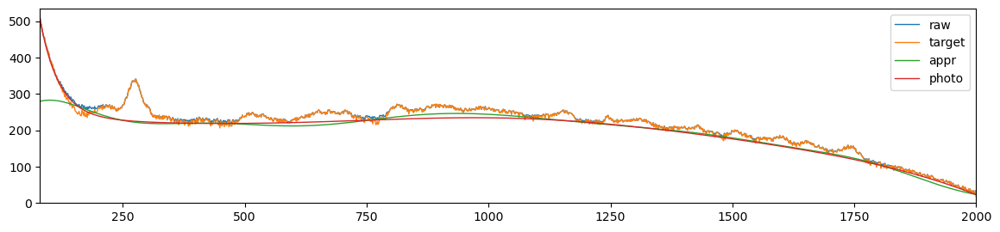

135.32593462251737 76.71945892353344 0.32112063262041174 0.23639871404627608
FWHM: 400,	 width: 0.8382945130946038,	 RBF shape: (1250, 11),	 error: 135.32593462251737, 	 smoothness: 0.32112063262041174


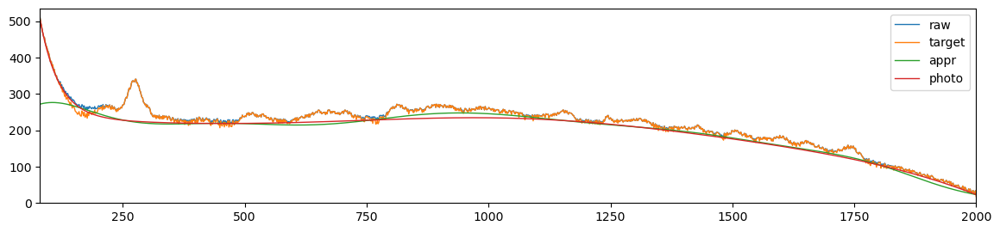

156.22703582729233 92.15883746199744 0.3465963921287711 0.26119149569745637
FWHM: 400,	 width: 0.8113136271446935,	 RBF shape: (1250, 10),	 error: 156.22703582729233, 	 smoothness: 0.3465963921287711


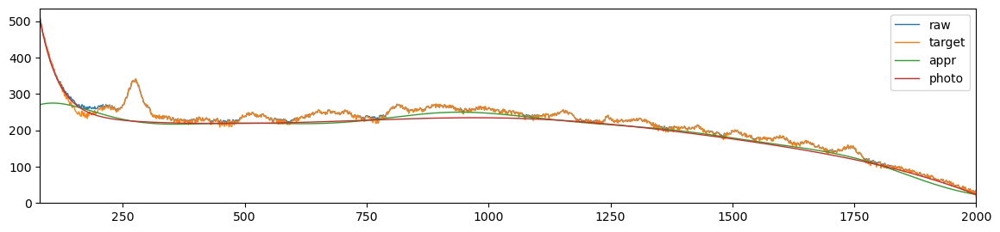

135.518132348965 85.45397561462033 0.3096721725885526 0.2484630578469922
FWHM: 400,	 width: 0.7791955498090459,	 RBF shape: (1250, 10),	 error: 135.518132348965, 	 smoothness: 0.3096721725885526


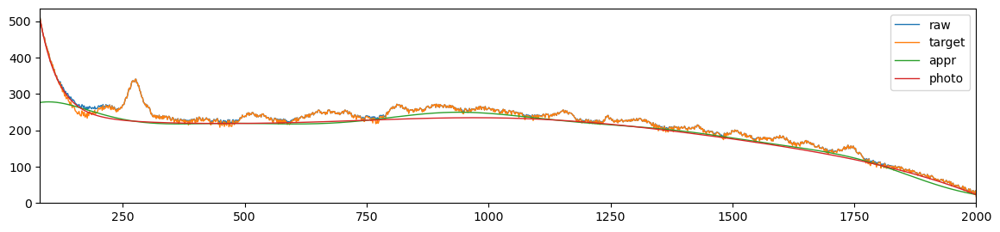

145.88306738300255 98.33617832460027 0.30768096787548704 0.2605567982931727
FWHM: 400,	 width: 0.7409621540023357,	 RBF shape: (1250, 9),	 error: 145.88306738300255, 	 smoothness: 0.30768096787548704


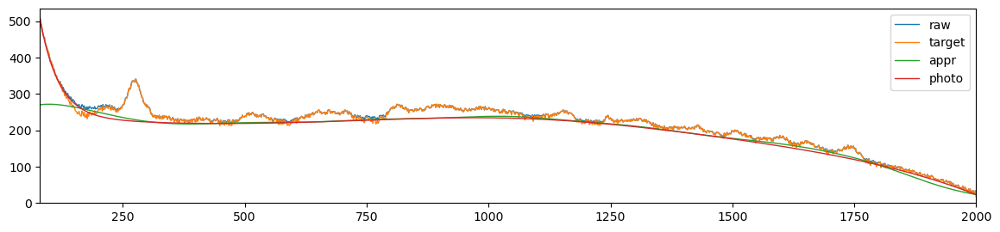

166.82031756869864 113.51735821310885 0.2868666312364017 0.2644686983712939
FWHM: 400,	 width: 0.6954490761292048,	 RBF shape: (1250, 8),	 error: 166.82031756869864, 	 smoothness: 0.2868666312364017


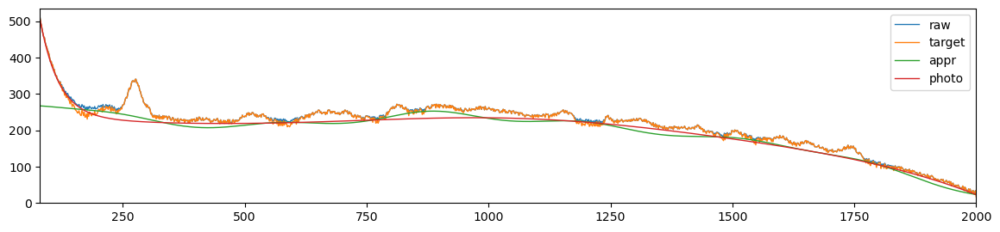

666.6779662737313 311.1016972279814 0.3244265568327839 0.17119956526273386
FWHM: 400,	 width: 0.6412702564408389,	 RBF shape: (1250, 7),	 error: 666.6779662737313, 	 smoothness: 0.3244265568327839


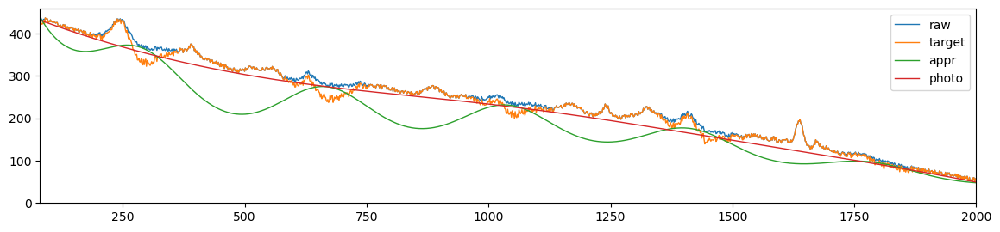

844.7950282957139 401.0335433119662 0.3647387306394695 0.18197456634156894
FWHM: 400,	 width: 0.5767757278350865,	 RBF shape: (1250, 7),	 error: 844.7950282957139, 	 smoothness: 0.3647387306394695


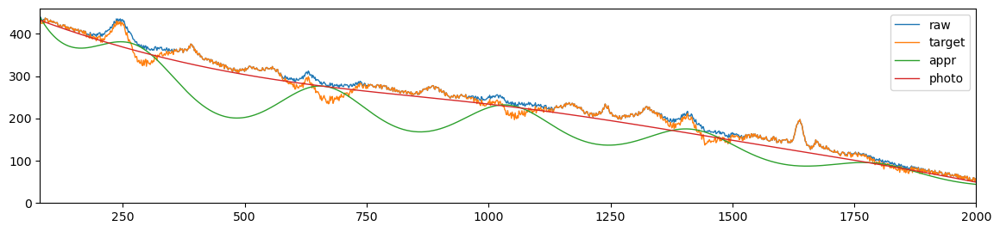

5241.508262510828 2715.161634457631 1.084502741601755 0.5707324278917973
FWHM: 400,	 width: 0.5000013675960908,	 RBF shape: (1250, 6),	 error: 5241.508262510828, 	 smoothness: 1.084502741601755


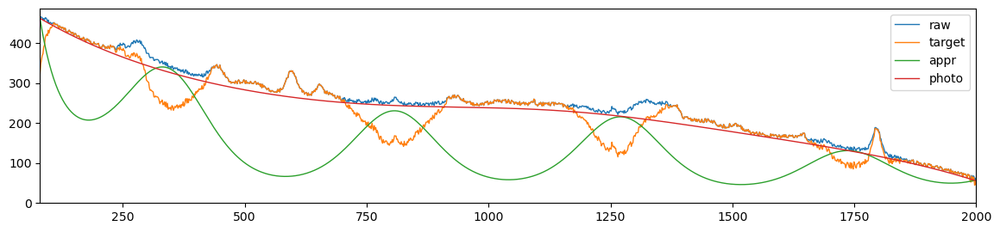

72.69868051171652 18.711213848298332 0.08096552142872458 0.05886795893782928
FWHM: 450,	 width: 0.99,	 RBF shape: (1250, 37),	 error: 72.69868051171652, 	 smoothness: 0.08096552142872458


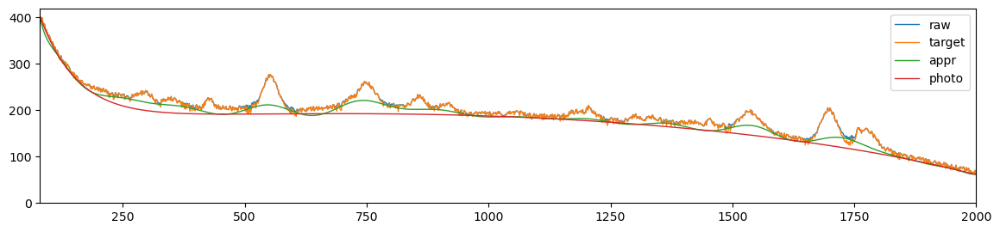

62.95077615832667 17.140248166171716 0.07060296274943378 0.06731975457672368
FWHM: 450,	 width: 0.98,	 RBF shape: (1250, 26),	 error: 62.95077615832667, 	 smoothness: 0.07060296274943378


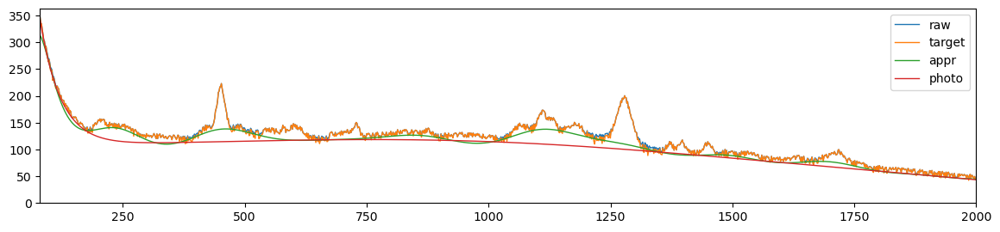

51.14360058374362 16.852567877295897 0.033393886180473065 0.03272674423047424
FWHM: 450,	 width: 0.97,	 RBF shape: (1250, 22),	 error: 51.14360058374362, 	 smoothness: 0.033393886180473065


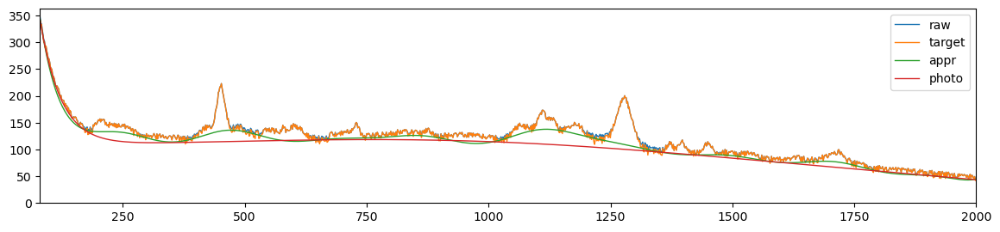

43.44237178929824 15.429366733964786 0.025152312345657006 0.021832697926554744
FWHM: 450,	 width: 0.96,	 RBF shape: (1250, 19),	 error: 43.44237178929824, 	 smoothness: 0.025152312345657006


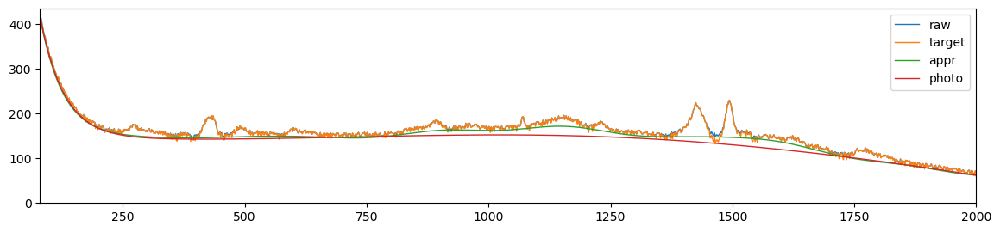

41.49676743328 16.771363995505336 0.03602157330614229 0.050877904285759085
FWHM: 450,	 width: 0.95,	 RBF shape: (1250, 17),	 error: 41.49676743328, 	 smoothness: 0.03602157330614229


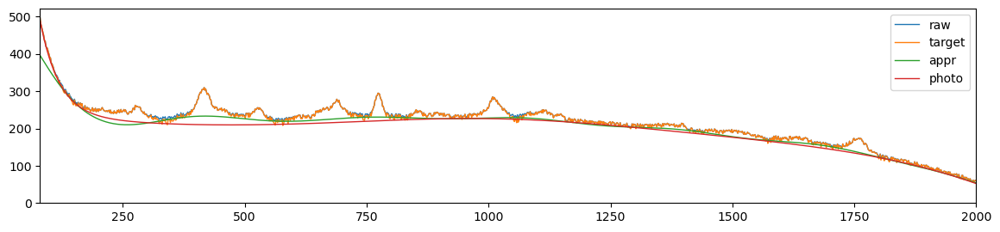

39.42711133386194 16.43378891260138 0.039294679021392845 0.04742425820698796
FWHM: 450,	 width: 0.94,	 RBF shape: (1250, 16),	 error: 39.42711133386194, 	 smoothness: 0.039294679021392845


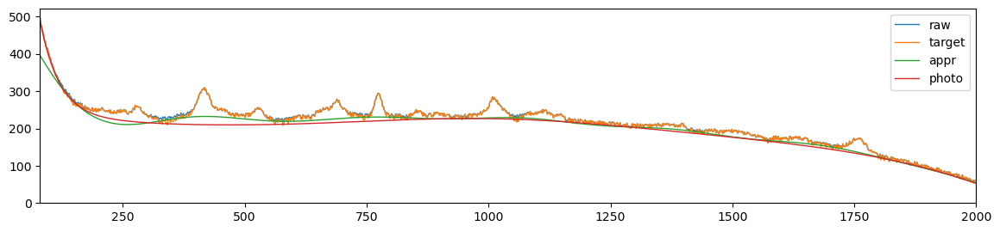

47.21452522777186 22.6459618780931 0.08567770662318455 0.08770219854615943
FWHM: 450,	 width: 0.93,	 RBF shape: (1250, 15),	 error: 47.21452522777186, 	 smoothness: 0.08567770662318455


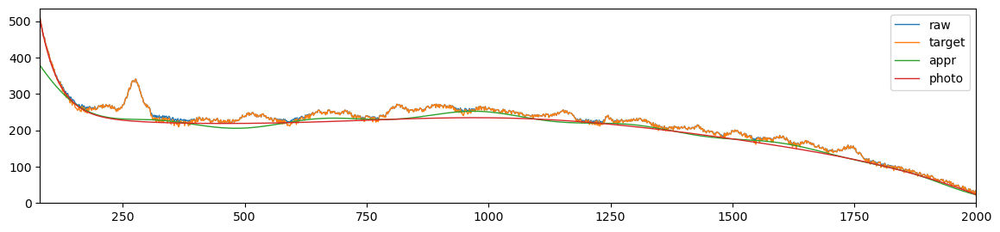

55.608919492716886 26.88410894867915 0.125064561035099 0.10865818975512419
FWHM: 450,	 width: 0.92,	 RBF shape: (1250, 14),	 error: 55.608919492716886, 	 smoothness: 0.125064561035099


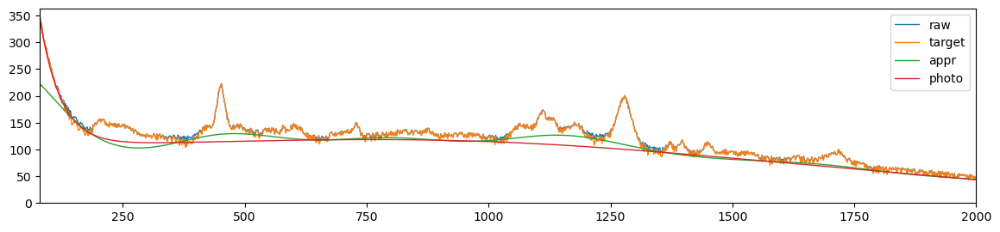

75.1737049340234 43.48175158279501 0.18265309519058245 0.15559069952640442
FWHM: 450,	 width: 0.91,	 RBF shape: (1250, 13),	 error: 75.1737049340234, 	 smoothness: 0.18265309519058245


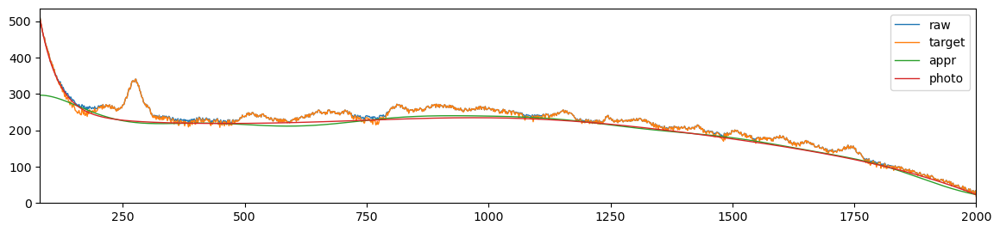

105.96160339877666 58.40053335068954 0.2565813231875568 0.19703046839143967
FWHM: 450,	 width: 0.9,	 RBF shape: (1250, 12),	 error: 105.96160339877666, 	 smoothness: 0.2565813231875568


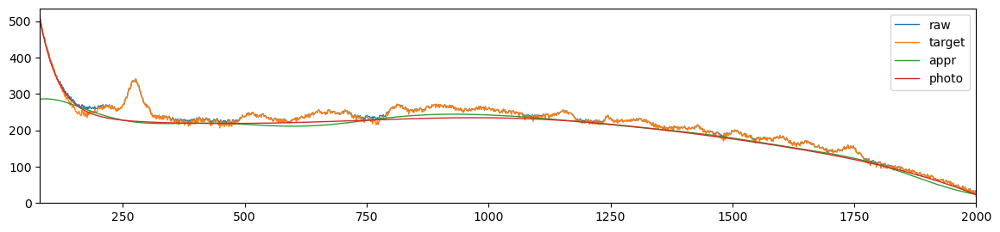

100.73963554538297 56.44517293167975 0.24484512280484508 0.19193008400387232
FWHM: 450,	 width: 0.89,	 RBF shape: (1250, 12),	 error: 100.73963554538297, 	 smoothness: 0.24484512280484508


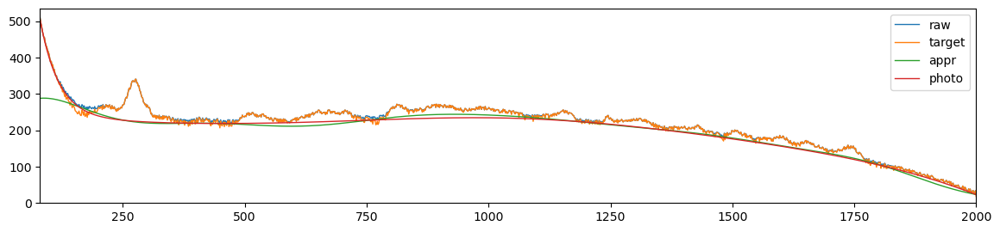

145.6405834509143 81.3631657195564 0.3272716827052017 0.24076245248777733
FWHM: 450,	 width: 0.88,	 RBF shape: (1250, 11),	 error: 145.6405834509143, 	 smoothness: 0.3272716827052017


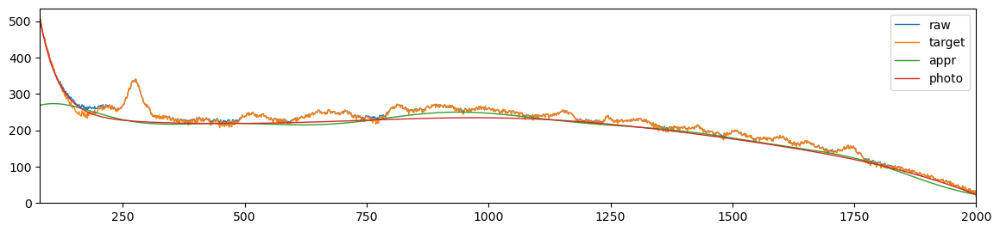

132.71831807541594 76.8131095531706 0.30338104665544036 0.23151864262810948
FWHM: 450,	 width: 0.8609598862125055,	 RBF shape: (1250, 11),	 error: 132.71831807541594, 	 smoothness: 0.30338104665544036


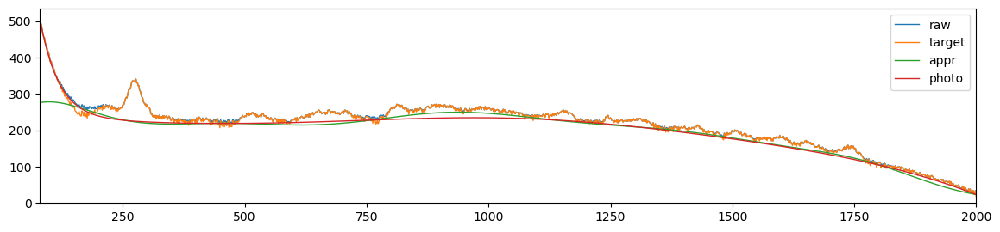

169.97946339168888 96.07523759468171 0.35660552134562457 0.26404862542665436
FWHM: 450,	 width: 0.8382945130946038,	 RBF shape: (1250, 10),	 error: 169.97946339168888, 	 smoothness: 0.35660552134562457


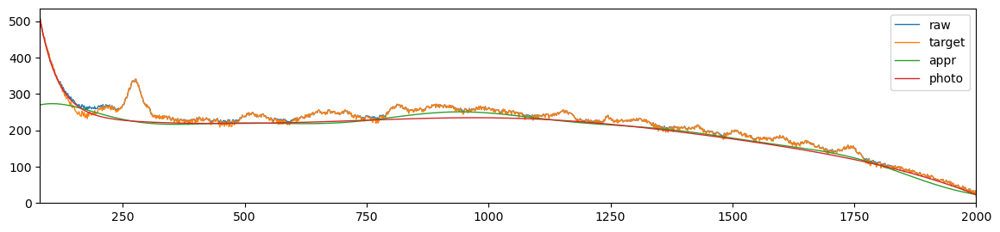

201.116362544041 117.53171460756111 0.38539448524782555 0.28774010671211503
FWHM: 450,	 width: 0.8113136271446935,	 RBF shape: (1250, 9),	 error: 201.116362544041, 	 smoothness: 0.38539448524782555


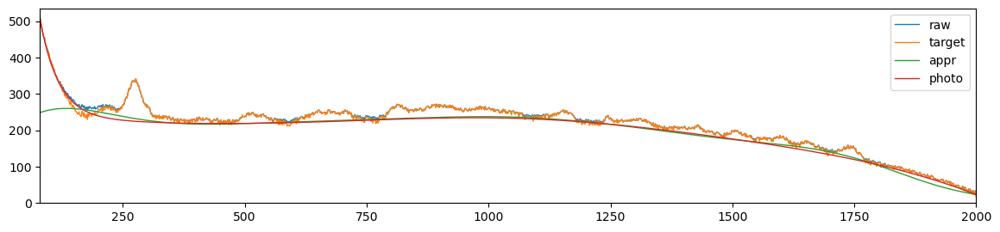

177.6229788186885 111.03811786957341 0.3514643906888728 0.2775145117642638
FWHM: 450,	 width: 0.7791955498090459,	 RBF shape: (1250, 9),	 error: 177.6229788186885, 	 smoothness: 0.3514643906888728


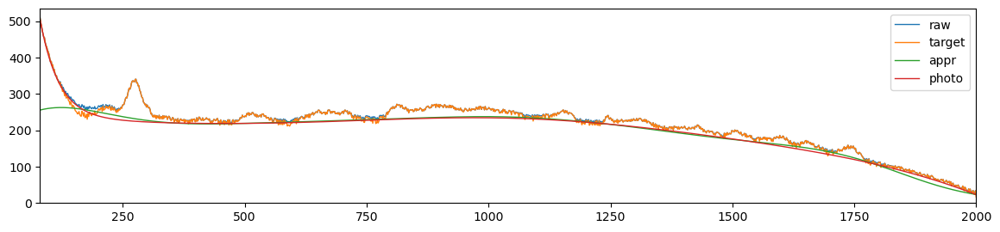

188.9977087267414 127.54502886532148 0.3453930551604869 0.29146726877415285
FWHM: 450,	 width: 0.7409621540023357,	 RBF shape: (1250, 8),	 error: 188.9977087267414, 	 smoothness: 0.3453930551604869


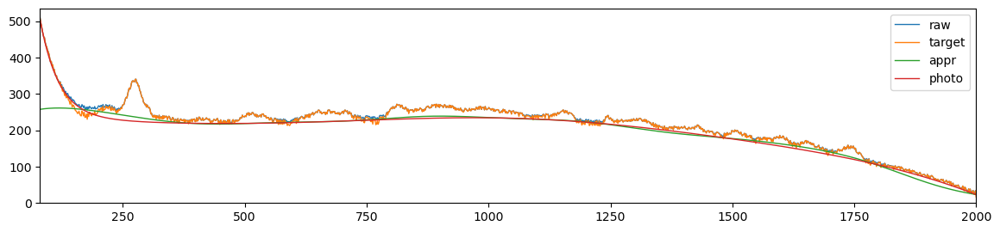

237.0669280398887 133.0164735417913 0.30630990771578304 0.2706528469685675
FWHM: 450,	 width: 0.6954490761292048,	 RBF shape: (1250, 7),	 error: 237.0669280398887, 	 smoothness: 0.30630990771578304


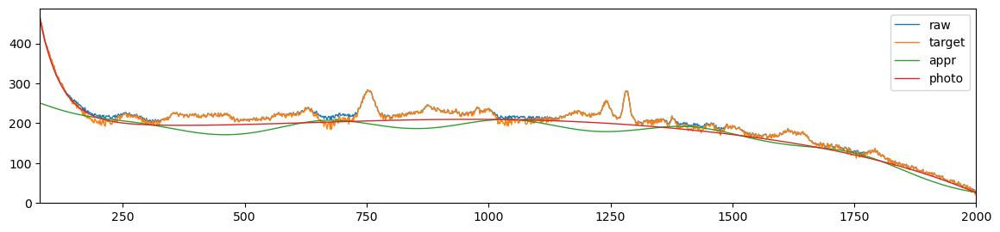

258.33210043084574 133.88429182570985 0.30064399782820994 0.2634098315517291
FWHM: 450,	 width: 0.6412702564408389,	 RBF shape: (1250, 7),	 error: 258.33210043084574, 	 smoothness: 0.30064399782820994


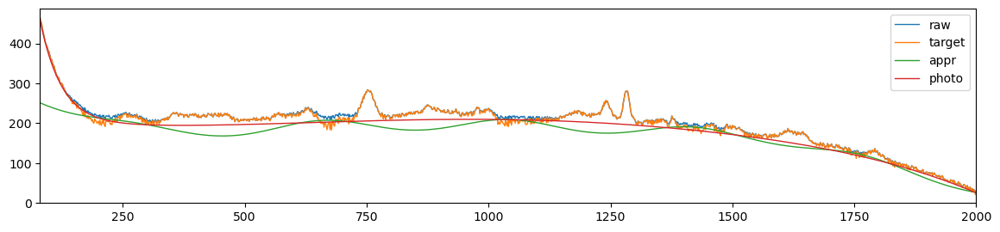

2051.2898986455352 1068.2297377578545 0.42661424735766734 0.1983488177575854
FWHM: 450,	 width: 0.5767757278350865,	 RBF shape: (1250, 6),	 error: 2051.2898986455352, 	 smoothness: 0.42661424735766734


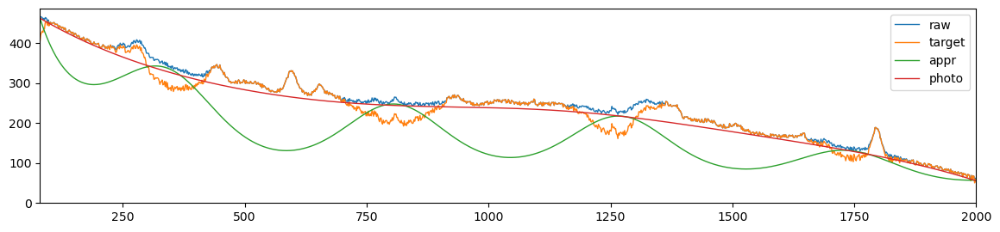

2524.082774805908 1286.4636452882253 0.4836499945696749 0.21501185962608868
FWHM: 450,	 width: 0.5000013675960908,	 RBF shape: (1250, 6),	 error: 2524.082774805908, 	 smoothness: 0.4836499945696749


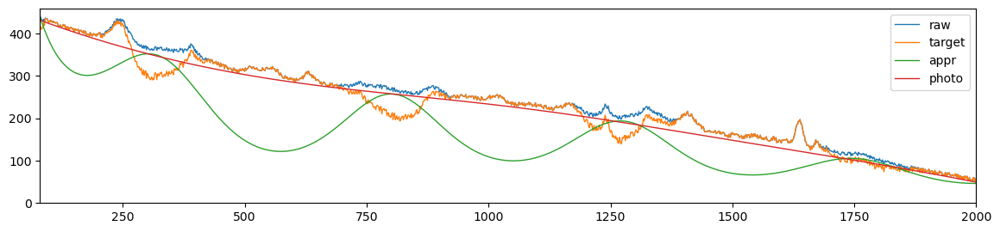

63.5797151603905 17.87828046821789 0.07813986676826518 0.08393625328944793
FWHM: 500,	 width: 0.99,	 RBF shape: (1250, 33),	 error: 63.5797151603905, 	 smoothness: 0.07813986676826518


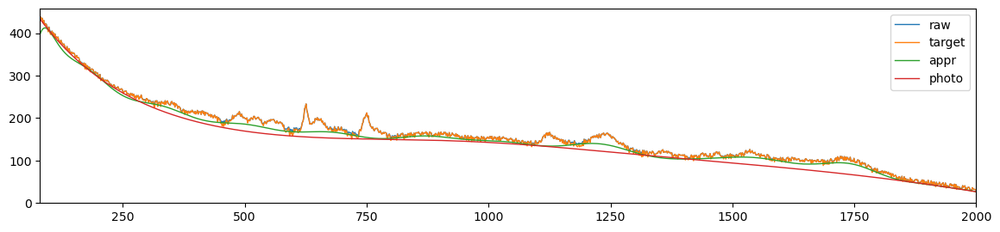

56.3386498347839 17.874611816303467 0.05366389723285188 0.049788564726037765
FWHM: 500,	 width: 0.98,	 RBF shape: (1250, 24),	 error: 56.3386498347839, 	 smoothness: 0.05366389723285188


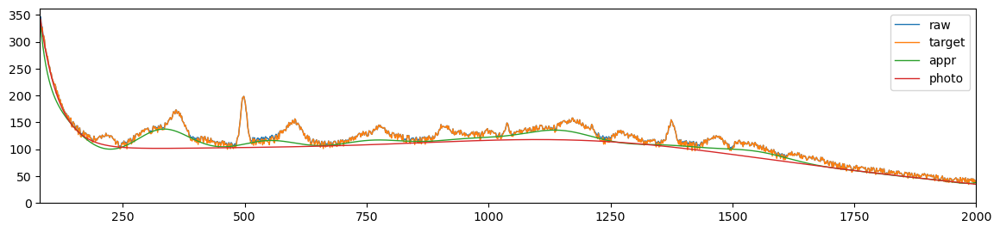

45.949156603668214 17.24124384754715 0.03040670100613008 0.04419494374639203
FWHM: 500,	 width: 0.97,	 RBF shape: (1250, 20),	 error: 45.949156603668214, 	 smoothness: 0.03040670100613008


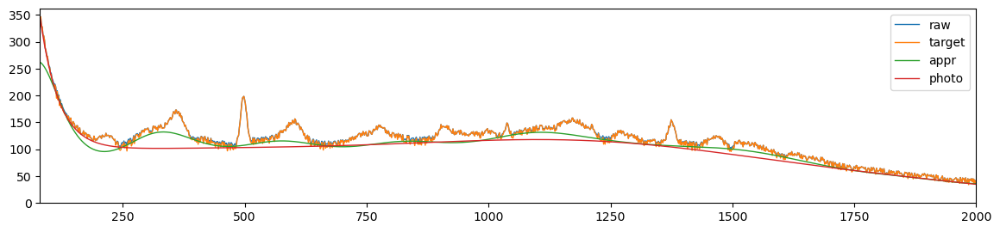

39.632597211435225 15.538805560463388 0.02714393171345469 0.036984423010872305
FWHM: 500,	 width: 0.96,	 RBF shape: (1250, 17),	 error: 39.632597211435225, 	 smoothness: 0.02714393171345469


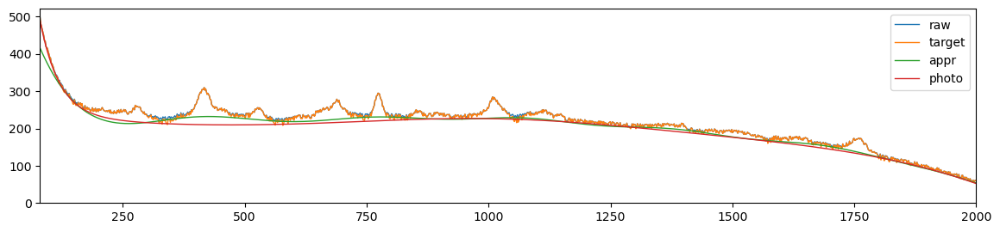

36.261914941537746 14.815620502529553 0.022728874531422652 0.029625592978393386
FWHM: 500,	 width: 0.95,	 RBF shape: (1250, 16),	 error: 36.261914941537746, 	 smoothness: 0.022728874531422652


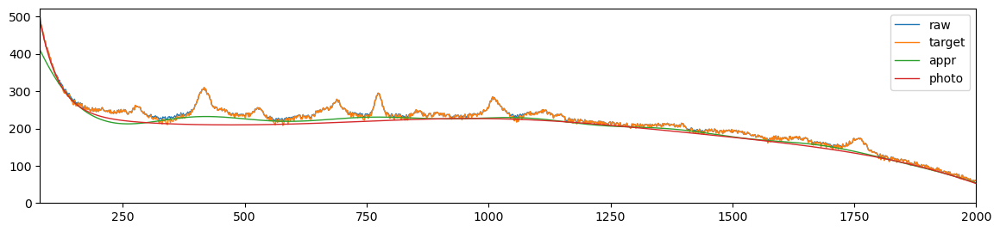

44.85077512001836 22.088957378039943 0.08328101882717968 0.08374059352359559
FWHM: 500,	 width: 0.94,	 RBF shape: (1250, 14),	 error: 44.85077512001836, 	 smoothness: 0.08328101882717968


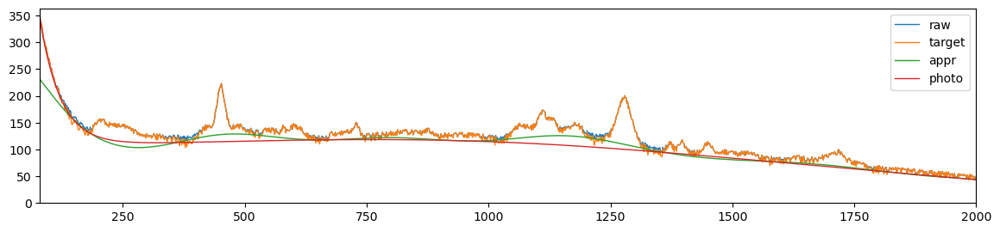

61.94599450616439 38.42288290813642 0.13892697302394955 0.13667296936480738
FWHM: 500,	 width: 0.93,	 RBF shape: (1250, 13),	 error: 61.94599450616439, 	 smoothness: 0.13892697302394955


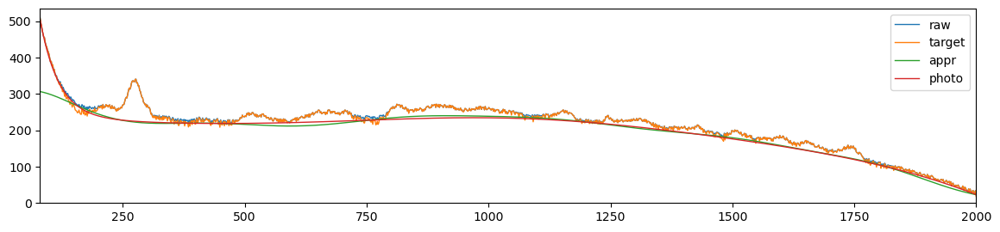

59.6825455074258 37.24104958215915 0.13227438172074918 0.1330185195421783
FWHM: 500,	 width: 0.92,	 RBF shape: (1250, 13),	 error: 59.6825455074258, 	 smoothness: 0.13227438172074918


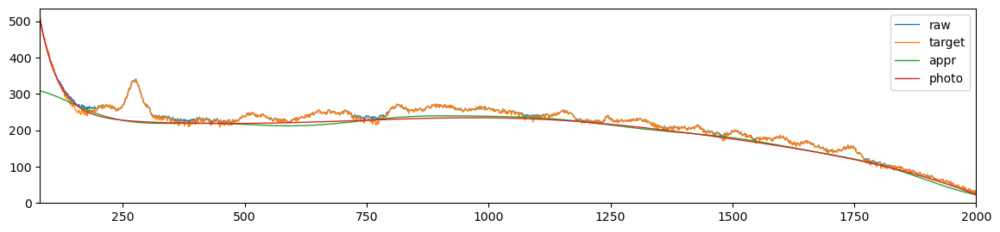

84.8808527878387 49.79970167262536 0.19999262045992583 0.1718988842561825
FWHM: 500,	 width: 0.91,	 RBF shape: (1250, 12),	 error: 84.8808527878387, 	 smoothness: 0.19999262045992583


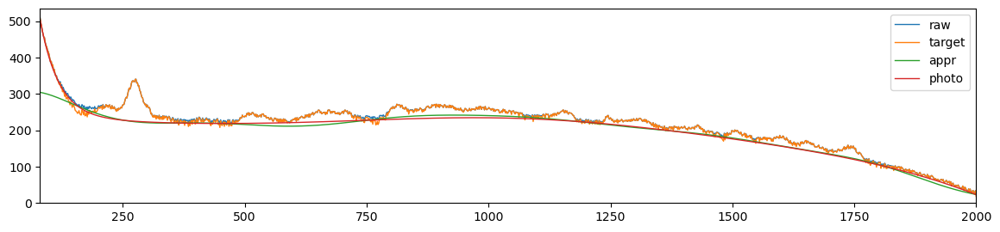

132.6332421252094 79.26601363433595 0.2932439799414346 0.23094651857365034
FWHM: 500,	 width: 0.9,	 RBF shape: (1250, 11),	 error: 132.6332421252094, 	 smoothness: 0.2932439799414346


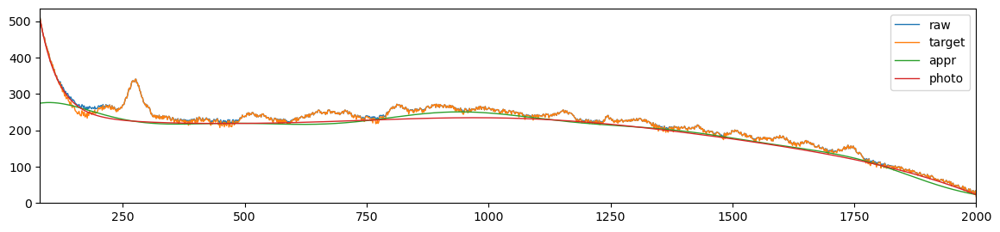

126.54165850981919 76.66173274634626 0.2819676756887699 0.22604805801935487
FWHM: 500,	 width: 0.89,	 RBF shape: (1250, 11),	 error: 126.54165850981919, 	 smoothness: 0.2819676756887699


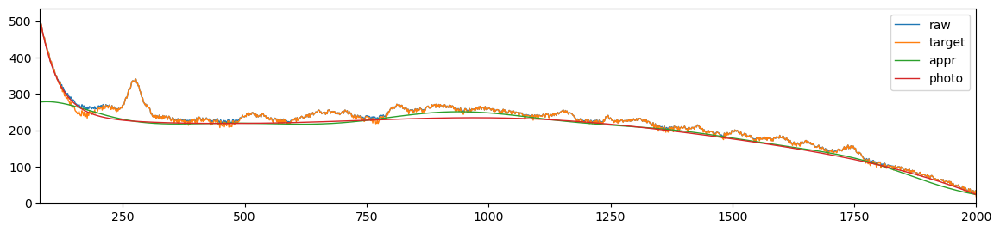

183.40891226352025 100.20315879109592 0.36642422948760467 0.2675990752959953
FWHM: 500,	 width: 0.88,	 RBF shape: (1250, 10),	 error: 183.40891226352025, 	 smoothness: 0.36642422948760467


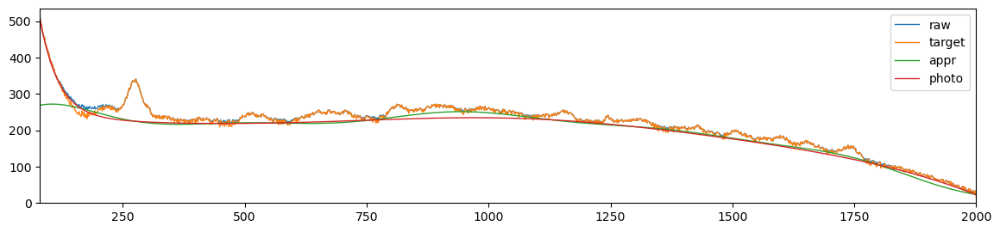

168.70270756187085 96.51769716501073 0.34427768082922433 0.2609469256462767
FWHM: 500,	 width: 0.8609598862125055,	 RBF shape: (1250, 10),	 error: 168.70270756187085, 	 smoothness: 0.34427768082922433


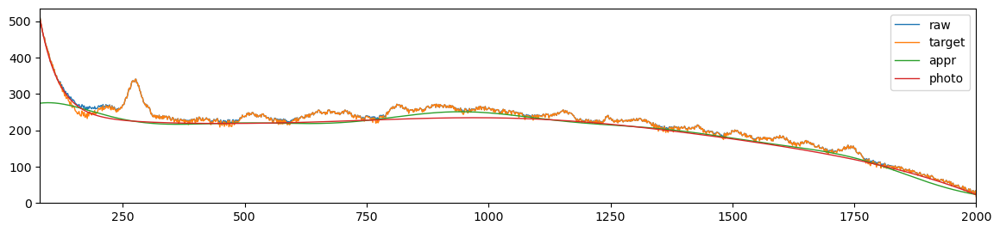

220.47341575637859 124.12668149368788 0.4003897012143937 0.2929970404722154
FWHM: 500,	 width: 0.8382945130946038,	 RBF shape: (1250, 9),	 error: 220.47341575637859, 	 smoothness: 0.4003897012143937


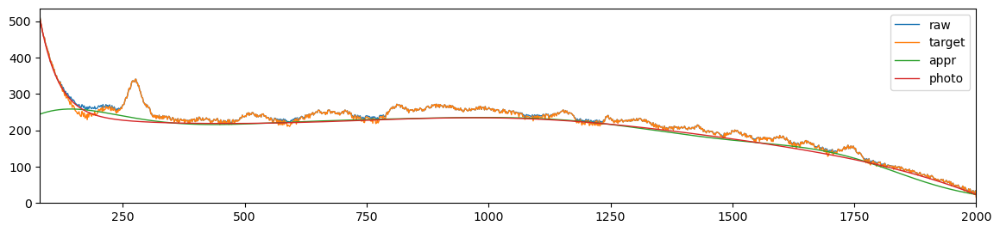

248.44774471939076 142.1867841453604 0.4178843813951141 0.3097661687242906
FWHM: 500,	 width: 0.8113136271446935,	 RBF shape: (1250, 8),	 error: 248.44774471939076, 	 smoothness: 0.4178843813951141


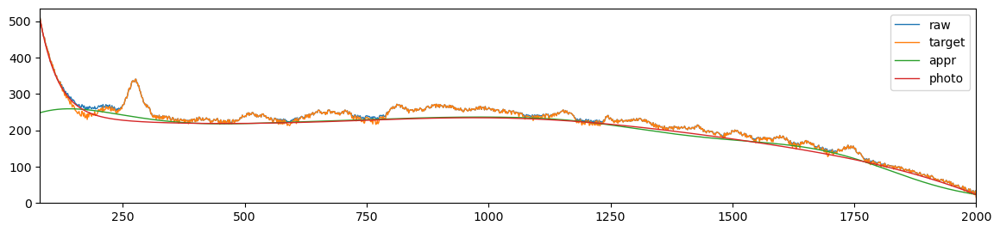

222.85560973754656 136.19497643313457 0.3874047760754861 0.30235022079856305
FWHM: 500,	 width: 0.7791955498090459,	 RBF shape: (1250, 8),	 error: 222.85560973754656, 	 smoothness: 0.3874047760754861


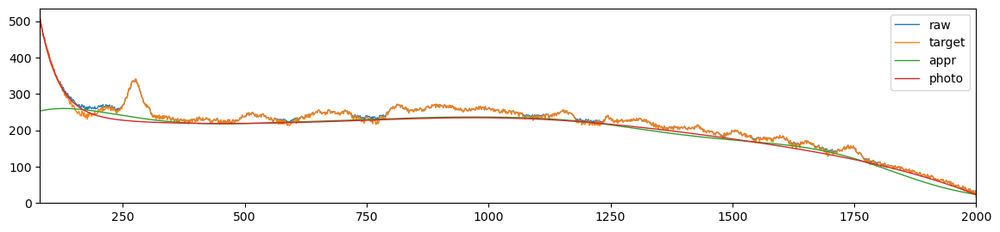

229.52677761947314 150.67332619205865 0.3626572721993503 0.3033800783224825
FWHM: 500,	 width: 0.7409621540023357,	 RBF shape: (1250, 7),	 error: 229.52677761947314, 	 smoothness: 0.3626572721993503


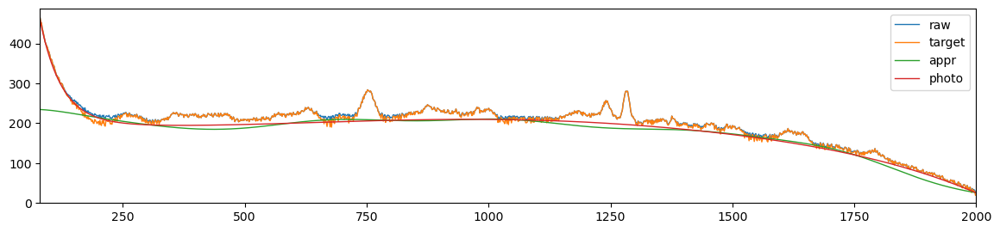

210.8911372842076 143.9996963735106 0.33769439657288636 0.29512803533928245
FWHM: 500,	 width: 0.6954490761292048,	 RBF shape: (1250, 7),	 error: 210.8911372842076, 	 smoothness: 0.33769439657288636


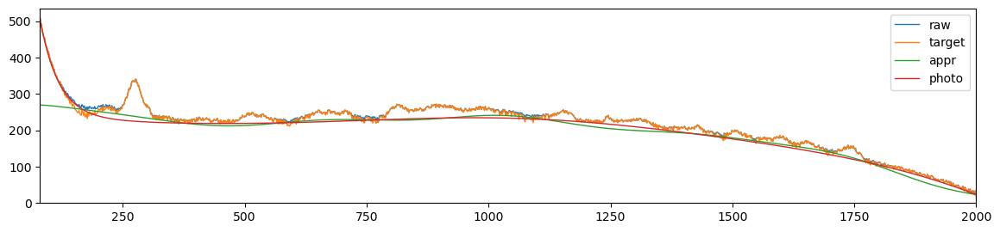

657.2865526648346 278.91434842144315 0.30087691233269886 0.20703059879623736
FWHM: 500,	 width: 0.6412702564408389,	 RBF shape: (1250, 6),	 error: 657.2865526648346, 	 smoothness: 0.30087691233269886


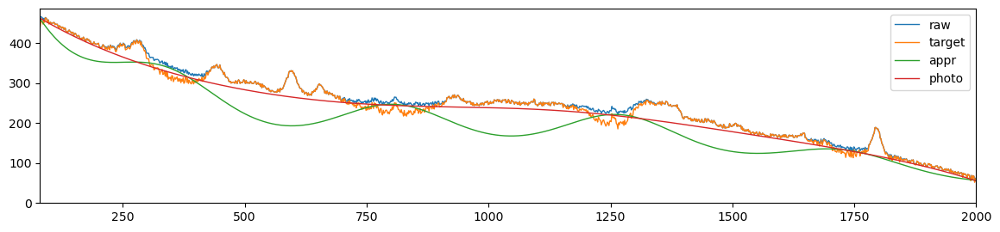

845.4866818798505 365.4980379203916 0.3227459554647865 0.20348435805033407
FWHM: 500,	 width: 0.5767757278350865,	 RBF shape: (1250, 6),	 error: 845.4866818798505, 	 smoothness: 0.3227459554647865


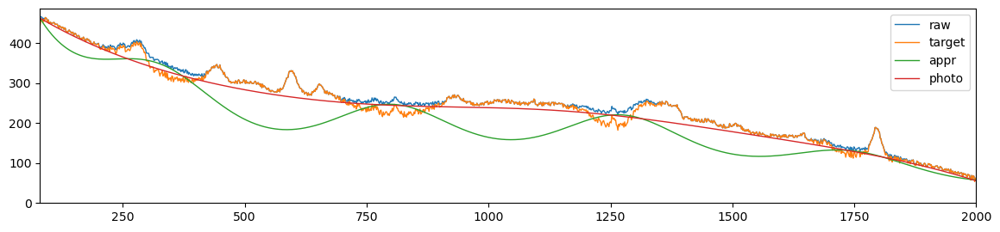

6439.064541505589 3343.5032527811627 0.825363352501668 0.49028444078997685
FWHM: 500,	 width: 0.5000013675960908,	 RBF shape: (1250, 5),	 error: 6439.064541505589, 	 smoothness: 0.825363352501668


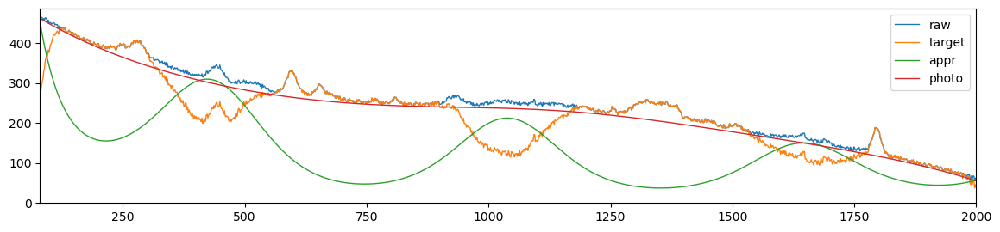

58.90268759887746 18.09711593328058 0.0859415672176952 0.09682812758292098
FWHM: 550,	 width: 0.99,	 RBF shape: (1250, 30),	 error: 58.90268759887746, 	 smoothness: 0.0859415672176952


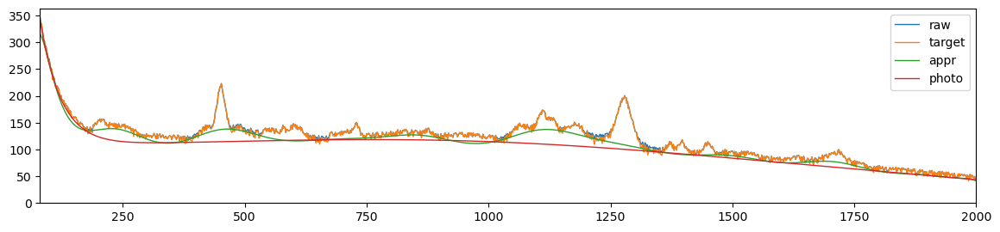

49.24822537070724 17.461782996501697 0.03661024680495077 0.032096118277913394
FWHM: 550,	 width: 0.98,	 RBF shape: (1250, 22),	 error: 49.24822537070724, 	 smoothness: 0.03661024680495077


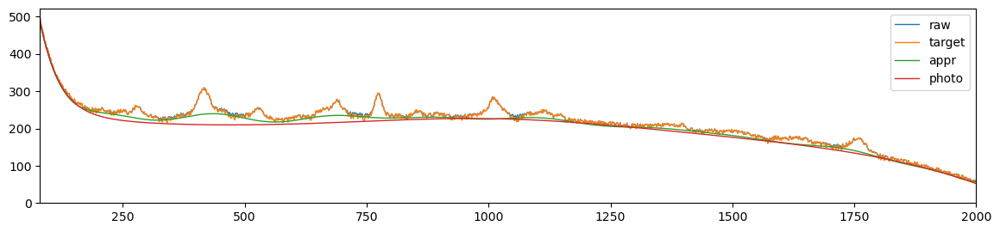

40.40105207712825 16.16447172475309 0.02324953581563337 0.027768584877973658
FWHM: 550,	 width: 0.97,	 RBF shape: (1250, 18),	 error: 40.40105207712825, 	 smoothness: 0.02324953581563337


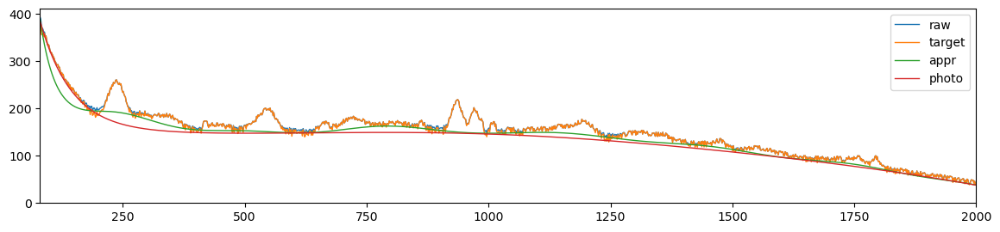

35.07611568578861 14.482310845263898 0.017420517456229398 0.021441437052974664
FWHM: 550,	 width: 0.96,	 RBF shape: (1250, 16),	 error: 35.07611568578861, 	 smoothness: 0.017420517456229398


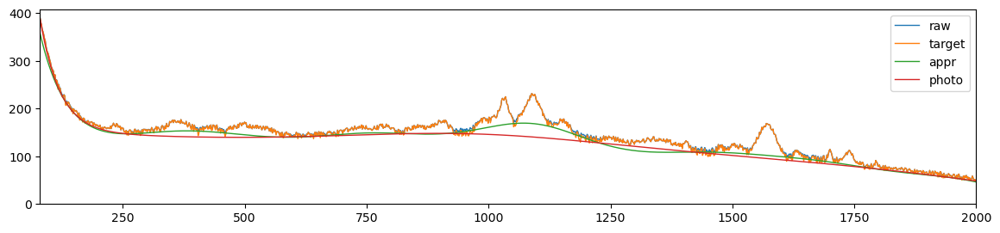

36.872722385091954 18.45625396863398 0.0513561996579107 0.061169984700298996
FWHM: 550,	 width: 0.95,	 RBF shape: (1250, 14),	 error: 36.872722385091954, 	 smoothness: 0.0513561996579107


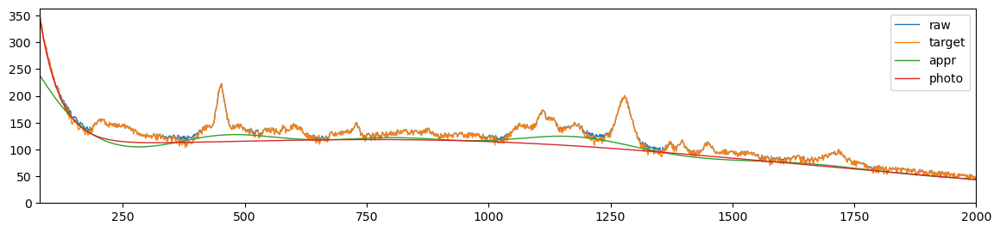

50.03265992921064 32.508814082696986 0.09927092689193459 0.11606298221879374
FWHM: 550,	 width: 0.94,	 RBF shape: (1250, 13),	 error: 50.03265992921064, 	 smoothness: 0.09927092689193459


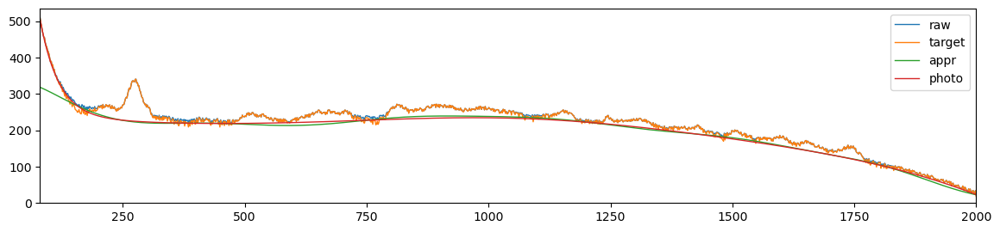

69.75468616903626 42.171903510391076 0.15832747601090322 0.148697959028611
FWHM: 550,	 width: 0.93,	 RBF shape: (1250, 12),	 error: 69.75468616903626, 	 smoothness: 0.15832747601090322


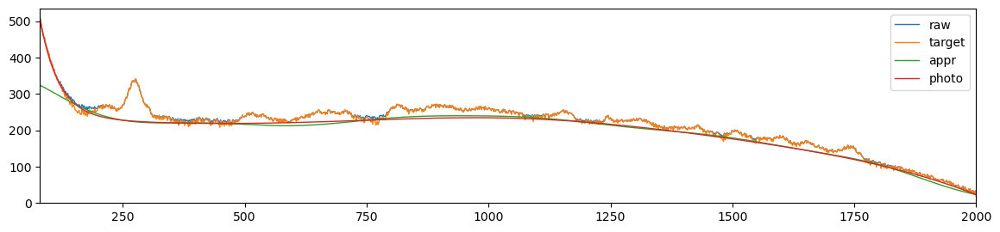

67.14849081489434 40.85793971373495 0.1516309608094876 0.1446887953713386
FWHM: 550,	 width: 0.92,	 RBF shape: (1250, 12),	 error: 67.14849081489434, 	 smoothness: 0.1516309608094876


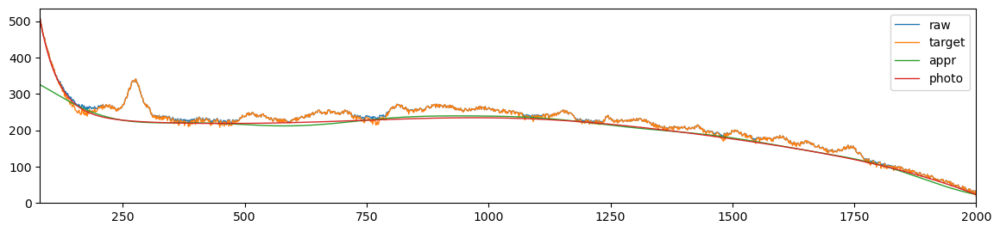

111.39837791605284 71.86922185169833 0.24602823730494713 0.212650409195781
FWHM: 550,	 width: 0.91,	 RBF shape: (1250, 11),	 error: 111.39837791605284, 	 smoothness: 0.24602823730494713


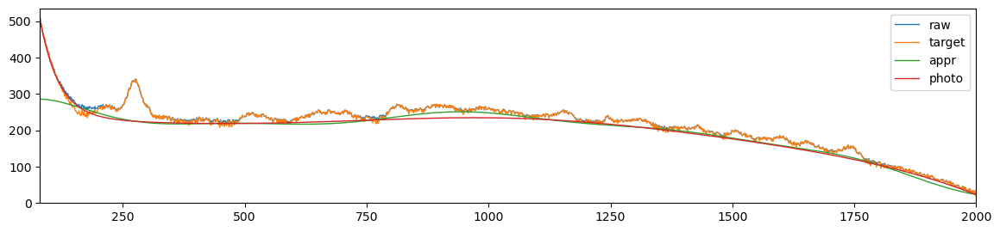

170.81937200594157 97.0052808110236 0.3392221970716767 0.25930343619486923
FWHM: 550,	 width: 0.9,	 RBF shape: (1250, 10),	 error: 170.81937200594157, 	 smoothness: 0.3392221970716767


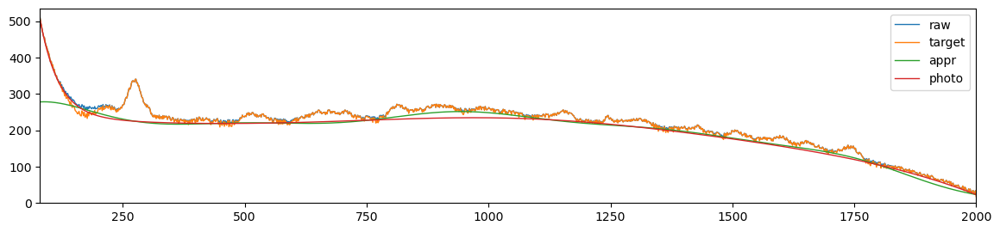

163.81341928017972 95.37975272603546 0.3286184967088468 0.25595808066847453
FWHM: 550,	 width: 0.89,	 RBF shape: (1250, 10),	 error: 163.81341928017972, 	 smoothness: 0.3286184967088468


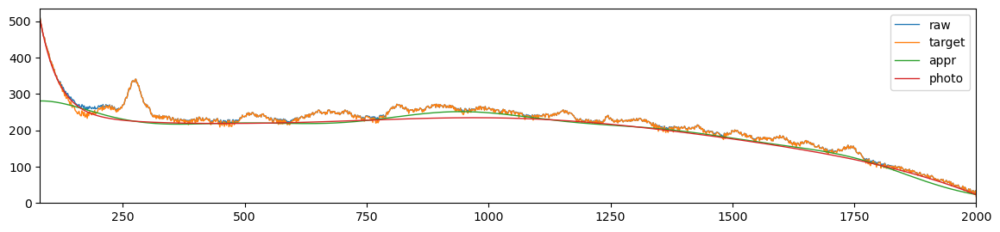

157.3548424966414 93.7271503185843 0.3188341461240095 0.25281063534176856
FWHM: 550,	 width: 0.88,	 RBF shape: (1250, 10),	 error: 157.3548424966414, 	 smoothness: 0.3188341461240095


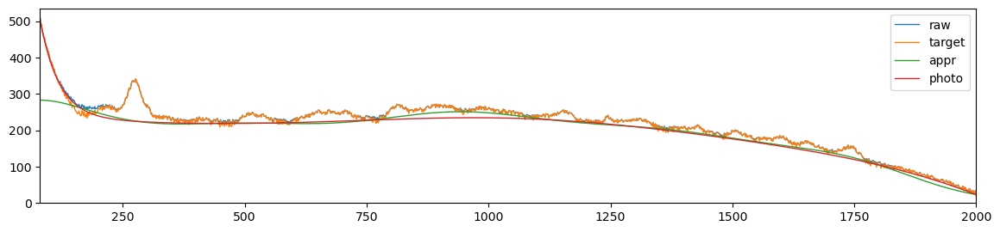

226.05648896950126 127.7673326224083 0.39763504061880206 0.2934870924422518
FWHM: 550,	 width: 0.8609598862125055,	 RBF shape: (1250, 9),	 error: 226.05648896950126, 	 smoothness: 0.39763504061880206


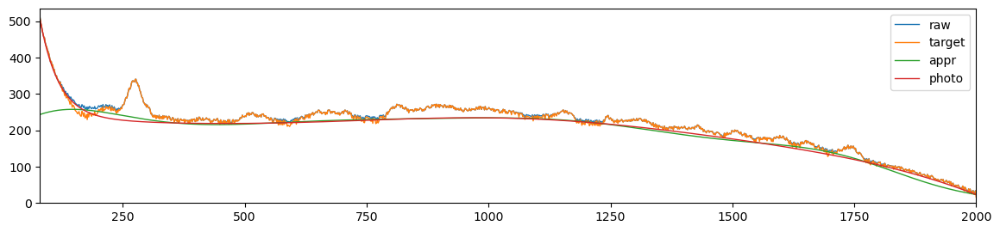

270.28729505583834 145.14303038742162 0.435074840333227 0.31197371826221837
FWHM: 550,	 width: 0.8382945130946038,	 RBF shape: (1250, 8),	 error: 270.28729505583834, 	 smoothness: 0.435074840333227


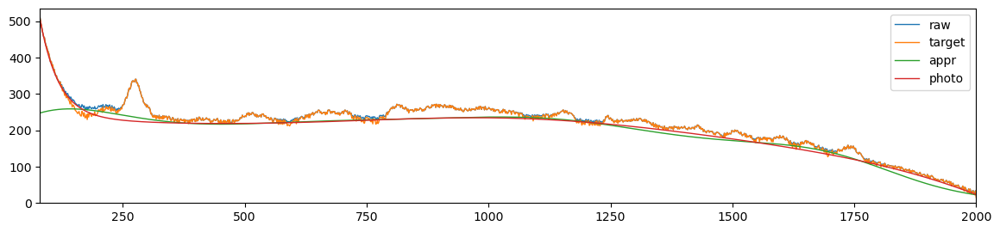

246.42660658420832 140.7748946240088 0.4089270051844367 0.306332138288997
FWHM: 550,	 width: 0.8113136271446935,	 RBF shape: (1250, 8),	 error: 246.42660658420832, 	 smoothness: 0.4089270051844367


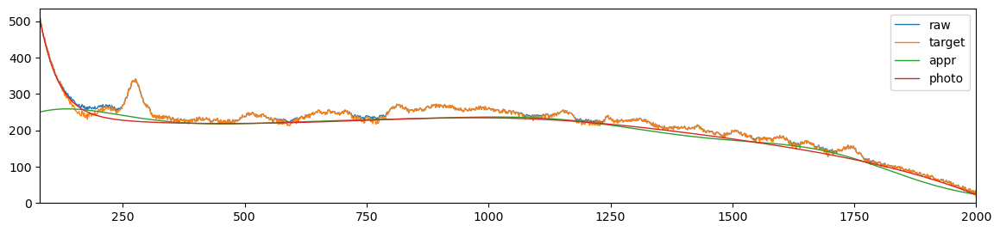

279.1605263326673 162.65538551770655 0.4163221544326141 0.3165499550317567
FWHM: 550,	 width: 0.7791955498090459,	 RBF shape: (1250, 7),	 error: 279.1605263326673, 	 smoothness: 0.4163221544326141


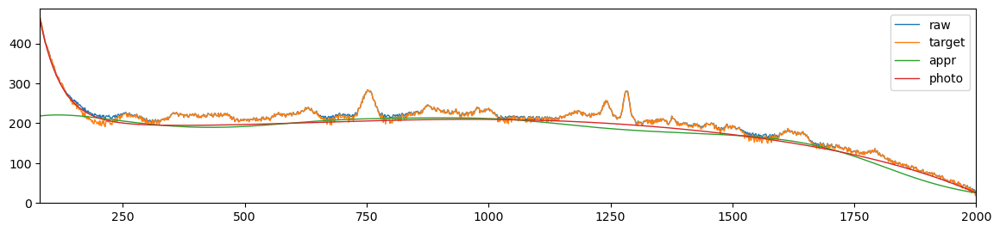

251.73022789242847 157.17540382273538 0.38812982969200893 0.31051839655058866
FWHM: 550,	 width: 0.7409621540023357,	 RBF shape: (1250, 7),	 error: 251.73022789242847, 	 smoothness: 0.38812982969200893


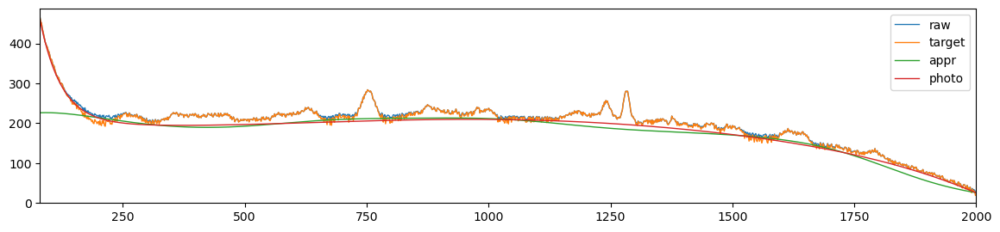

306.71123752599857 158.0219069933332 0.33060320250381403 0.2842001756745481
FWHM: 550,	 width: 0.6954490761292048,	 RBF shape: (1250, 6),	 error: 306.71123752599857, 	 smoothness: 0.33060320250381403


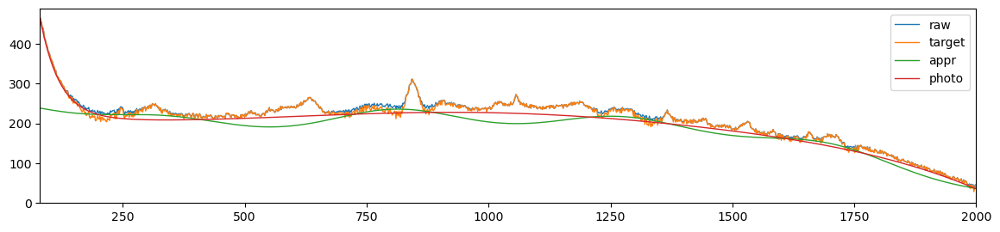

339.9878660261519 160.335515999248 0.3233154358451597 0.2768740120821326
FWHM: 550,	 width: 0.6412702564408389,	 RBF shape: (1250, 6),	 error: 339.9878660261519, 	 smoothness: 0.3233154358451597


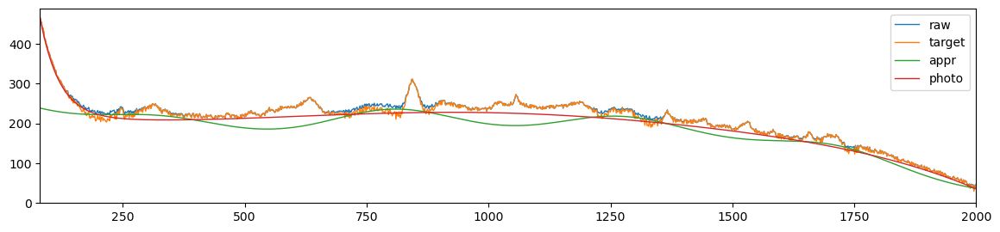

3359.511885283002 1738.1048597187212 0.40473093880003075 0.23186338779805915
FWHM: 550,	 width: 0.5767757278350865,	 RBF shape: (1250, 5),	 error: 3359.511885283002, 	 smoothness: 0.40473093880003075


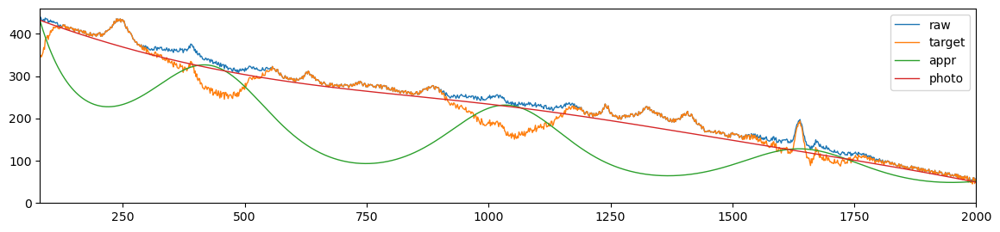

3963.960826296831 1994.6937754977819 0.44942141321235823 0.25856343608061166
FWHM: 550,	 width: 0.5000013675960908,	 RBF shape: (1250, 5),	 error: 3963.960826296831, 	 smoothness: 0.44942141321235823


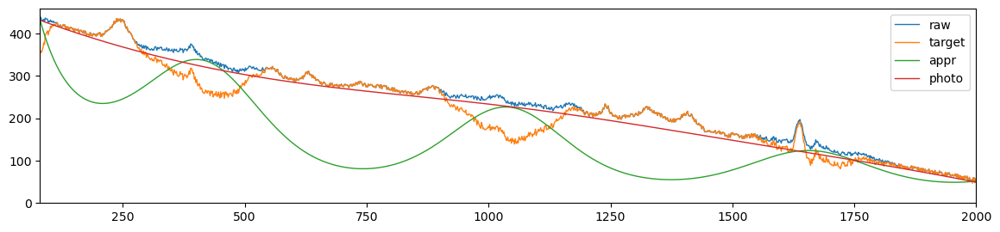

54.25368087877575 17.59668031425058 0.06050289445174161 0.06568598611663871
FWHM: 600,	 width: 0.99,	 RBF shape: (1250, 28),	 error: 54.25368087877575, 	 smoothness: 0.06050289445174161


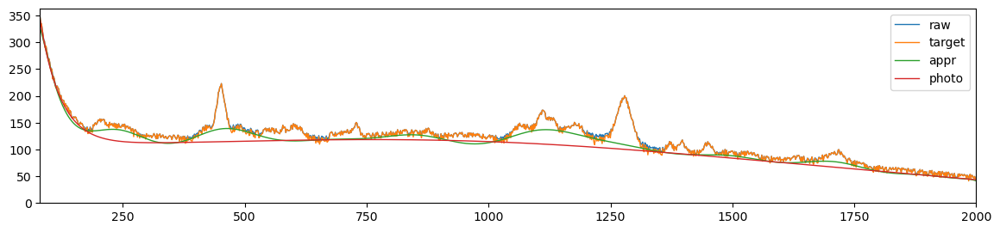

43.63929173004007 15.973832688422338 0.03195809134644798 0.046366139360659336
FWHM: 600,	 width: 0.98,	 RBF shape: (1250, 20),	 error: 43.63929173004007, 	 smoothness: 0.03195809134644798


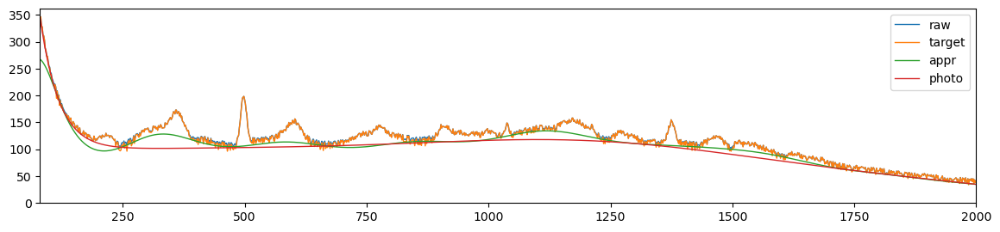

38.300207176894936 15.750158675055049 0.025338640497644244 0.028057719751980653
FWHM: 600,	 width: 0.97,	 RBF shape: (1250, 17),	 error: 38.300207176894936, 	 smoothness: 0.025338640497644244


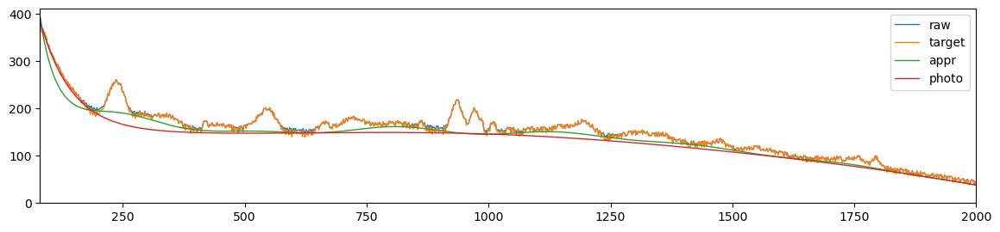

33.42541858995315 15.00188581470974 0.027346964087037455 0.03675979929468185
FWHM: 600,	 width: 0.96,	 RBF shape: (1250, 15),	 error: 33.42541858995315, 	 smoothness: 0.027346964087037455


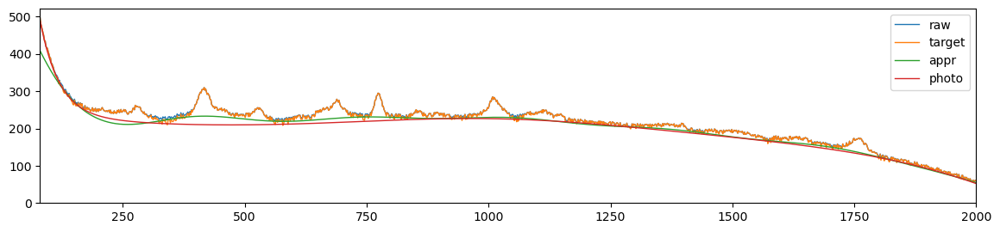

42.086227161439176 27.707249954714605 0.07181842633586877 0.09877337574509298
FWHM: 600,	 width: 0.95,	 RBF shape: (1250, 13),	 error: 42.086227161439176, 	 smoothness: 0.07181842633586877


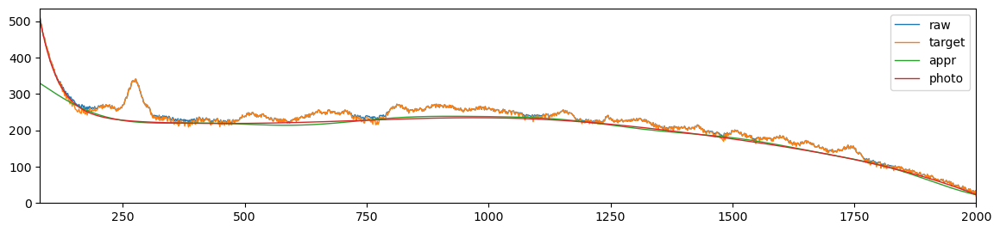

55.121444278840585 33.897593754608735 0.11754899931693563 0.12253421399551384
FWHM: 600,	 width: 0.94,	 RBF shape: (1250, 12),	 error: 55.121444278840585, 	 smoothness: 0.11754899931693563


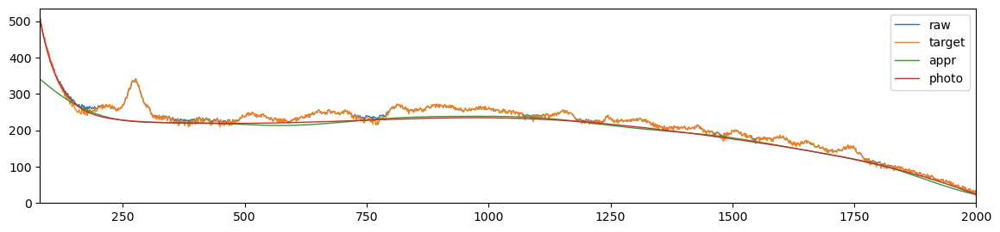

95.9302521523621 65.8413666292664 0.21100815597383138 0.19695398797051353
FWHM: 600,	 width: 0.93,	 RBF shape: (1250, 11),	 error: 95.9302521523621, 	 smoothness: 0.21100815597383138


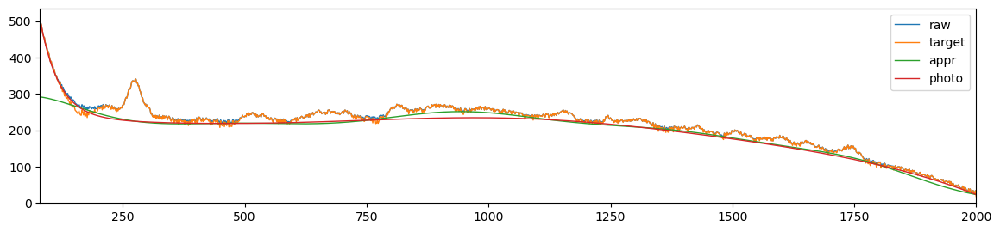

92.44338011806803 64.10404000194387 0.20374069868003164 0.19294194383548066
FWHM: 600,	 width: 0.92,	 RBF shape: (1250, 11),	 error: 92.44338011806803, 	 smoothness: 0.20374069868003164


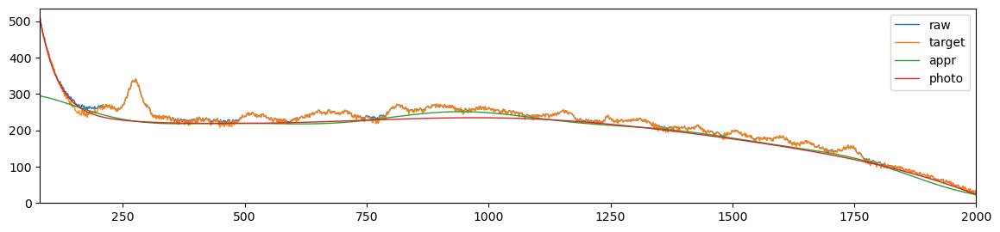

147.69838322396964 90.9915985406675 0.2981038378101011 0.2454957043157459
FWHM: 600,	 width: 0.91,	 RBF shape: (1250, 10),	 error: 147.69838322396964, 	 smoothness: 0.2981038378101011


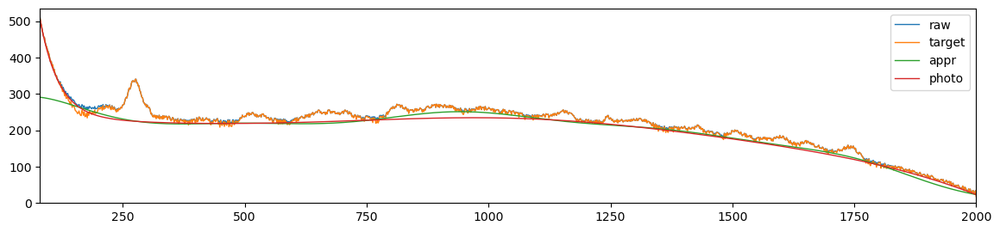

142.0942425290823 89.28625762035865 0.28907626303091677 0.2422831953208987
FWHM: 600,	 width: 0.9,	 RBF shape: (1250, 10),	 error: 142.0942425290823, 	 smoothness: 0.28907626303091677


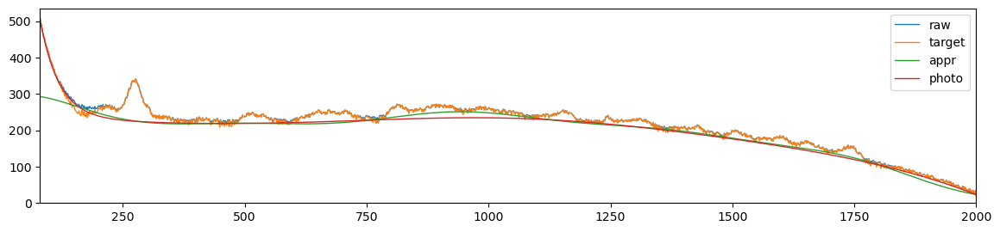

228.12646748087928 131.4686804468236 0.39257960096294225 0.2945380361506194
FWHM: 600,	 width: 0.89,	 RBF shape: (1250, 9),	 error: 228.12646748087928, 	 smoothness: 0.39257960096294225


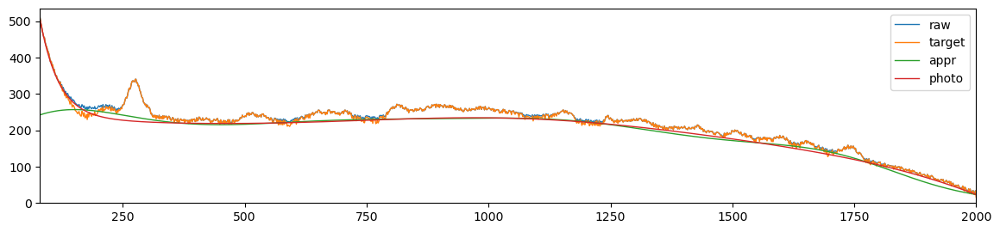

220.3099719437692 129.17754919645327 0.3828508224803495 0.29145972911160484
FWHM: 600,	 width: 0.88,	 RBF shape: (1250, 9),	 error: 220.3099719437692, 	 smoothness: 0.3828508224803495


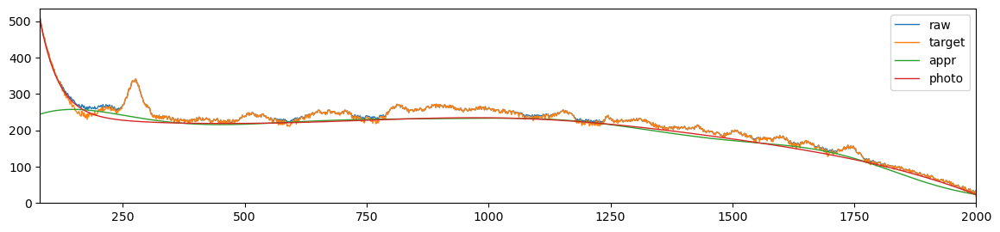

277.2345319075083 145.84984129645844 0.4356941515508309 0.31123511340708576
FWHM: 600,	 width: 0.8609598862125055,	 RBF shape: (1250, 8),	 error: 277.2345319075083, 	 smoothness: 0.4356941515508309


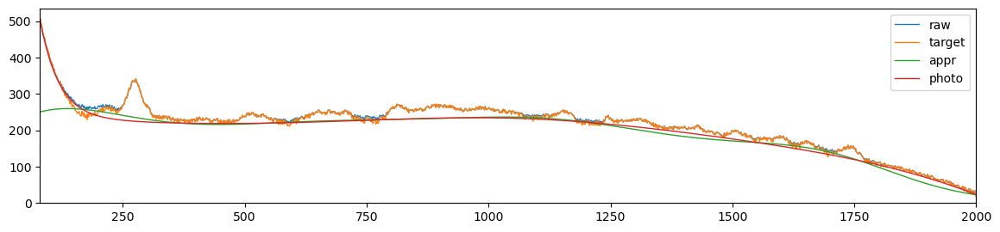

257.70985265758964 142.4247306465801 0.41495267299098243 0.30676886624444794
FWHM: 600,	 width: 0.8382945130946038,	 RBF shape: (1250, 8),	 error: 257.70985265758964, 	 smoothness: 0.41495267299098243


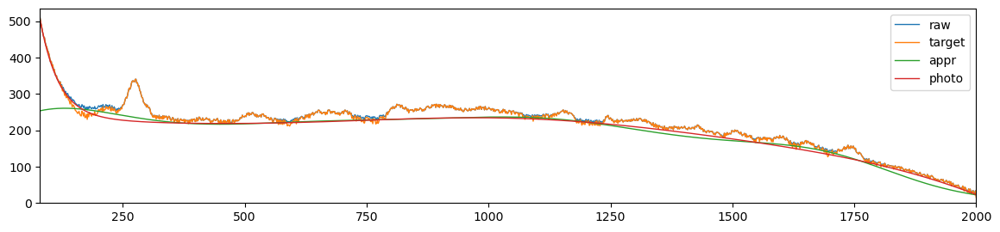

324.0831710080673 169.55491193756689 0.4508577416064739 0.32135169592660834
FWHM: 600,	 width: 0.8113136271446935,	 RBF shape: (1250, 7),	 error: 324.0831710080673, 	 smoothness: 0.4508577416064739


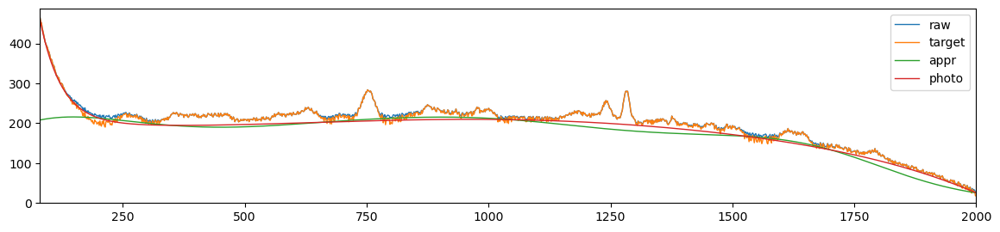

295.49847223464053 165.56571157111762 0.4254732019660256 0.31744899553082107
FWHM: 600,	 width: 0.7791955498090459,	 RBF shape: (1250, 7),	 error: 295.49847223464053, 	 smoothness: 0.4254732019660256


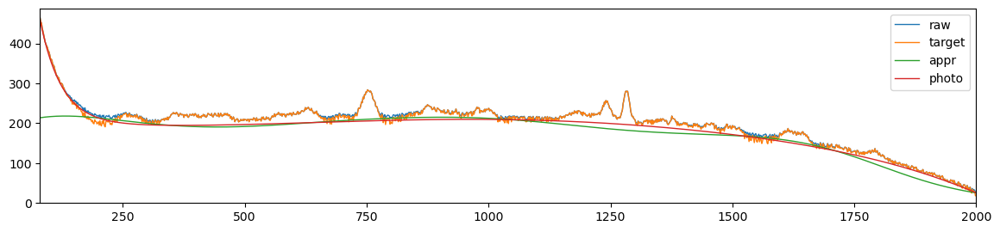

284.77012566867126 171.98620267069853 0.38078083809537466 0.31078950732867816
FWHM: 600,	 width: 0.7409621540023357,	 RBF shape: (1250, 6),	 error: 284.77012566867126, 	 smoothness: 0.38078083809537466


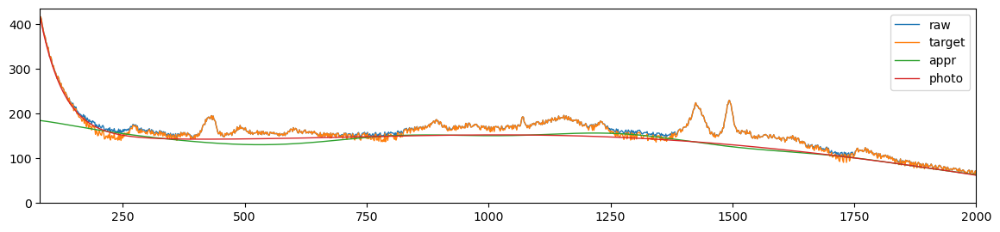

270.14850316490595 166.1562798071345 0.3603143449654762 0.3041511372176591
FWHM: 600,	 width: 0.6954490761292048,	 RBF shape: (1250, 6),	 error: 270.14850316490595, 	 smoothness: 0.3603143449654762


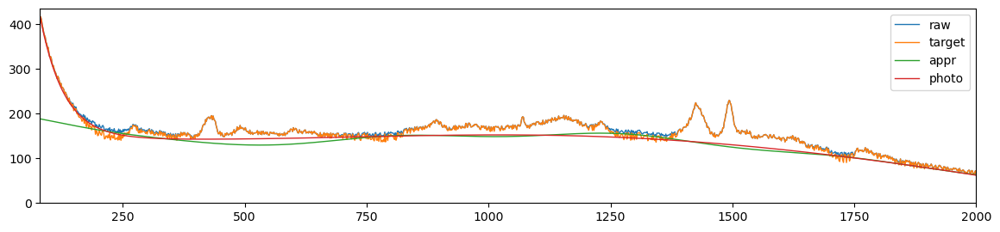

1480.7193506996948 686.5085597922559 0.282384618066901 0.15770941337797834
FWHM: 600,	 width: 0.6412702564408389,	 RBF shape: (1250, 5),	 error: 1480.7193506996948, 	 smoothness: 0.282384618066901


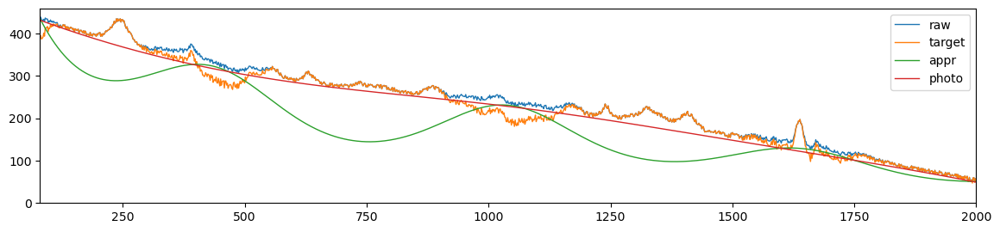

1869.449846589701 870.7136065060158 0.2998265855414333 0.15325797671827596
FWHM: 600,	 width: 0.5767757278350865,	 RBF shape: (1250, 5),	 error: 1869.449846589701, 	 smoothness: 0.2998265855414333


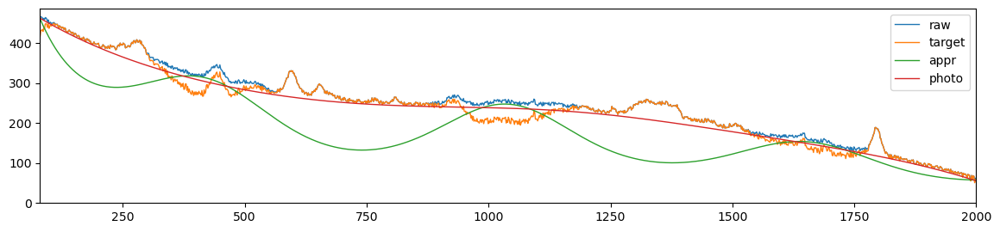

2410.7042736398985 1124.3710370095546 0.3323984317376781 0.15737663850692593
FWHM: 600,	 width: 0.5000013675960908,	 RBF shape: (1250, 5),	 error: 2410.7042736398985, 	 smoothness: 0.3323984317376781


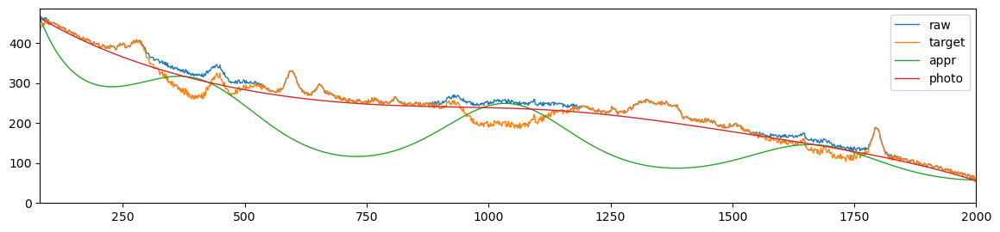

48.62526826919731 17.925907790959517 0.05348484250662705 0.06696681373428555
FWHM: 650,	 width: 0.99,	 RBF shape: (1250, 26),	 error: 48.62526826919731, 	 smoothness: 0.05348484250662705


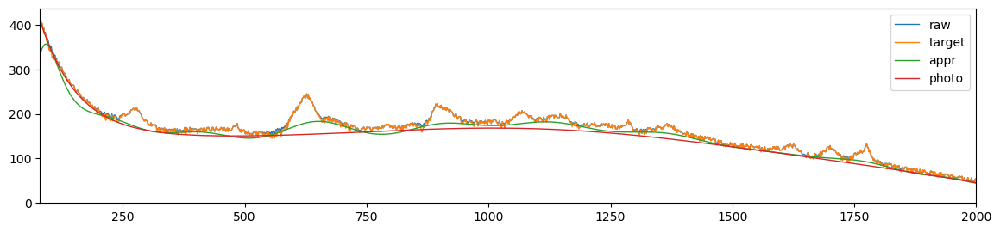

42.614796384025965 17.353715666876482 0.03771486461294937 0.06850975571758769
FWHM: 650,	 width: 0.98,	 RBF shape: (1250, 19),	 error: 42.614796384025965, 	 smoothness: 0.03771486461294937


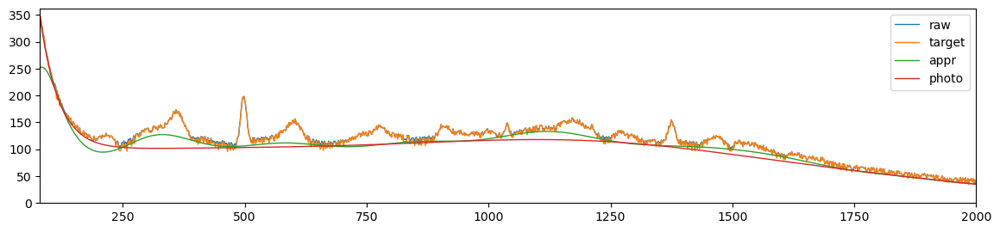

34.311711881657246 15.219518970560754 0.01954649330134961 0.02197504174810253
FWHM: 650,	 width: 0.97,	 RBF shape: (1250, 16),	 error: 34.311711881657246, 	 smoothness: 0.01954649330134961


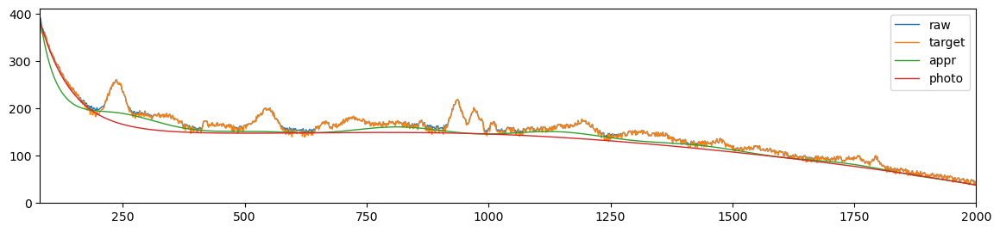

29.988906673338473 14.772779492995854 0.02264659442599533 0.03334872605746435
FWHM: 650,	 width: 0.96,	 RBF shape: (1250, 14),	 error: 29.988906673338473, 	 smoothness: 0.02264659442599533


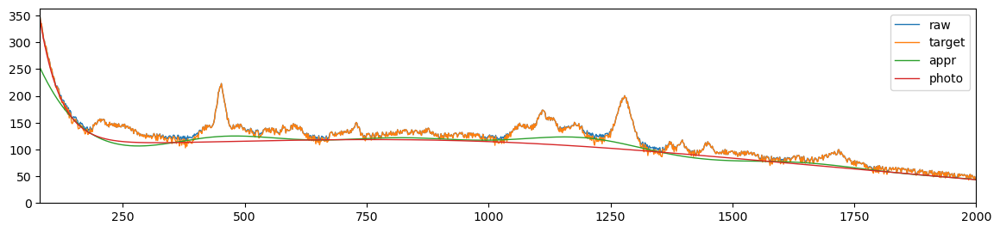

44.69265416796085 27.333033139746572 0.08661490708159444 0.09939052044578851
FWHM: 650,	 width: 0.95,	 RBF shape: (1250, 12),	 error: 44.69265416796085, 	 smoothness: 0.08661490708159444


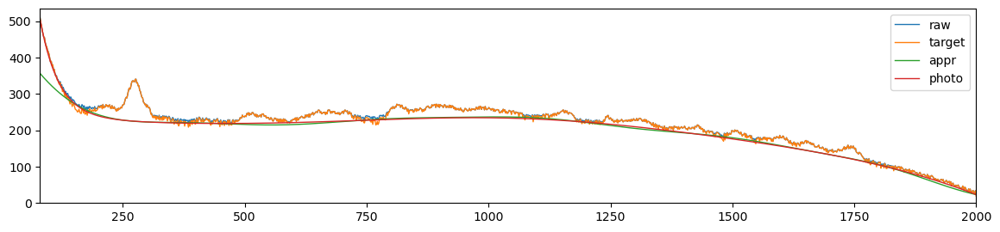

79.53875447625755 58.039390968535514 0.17339558790722687 0.17673746783164493
FWHM: 650,	 width: 0.94,	 RBF shape: (1250, 11),	 error: 79.53875447625755, 	 smoothness: 0.17339558790722687


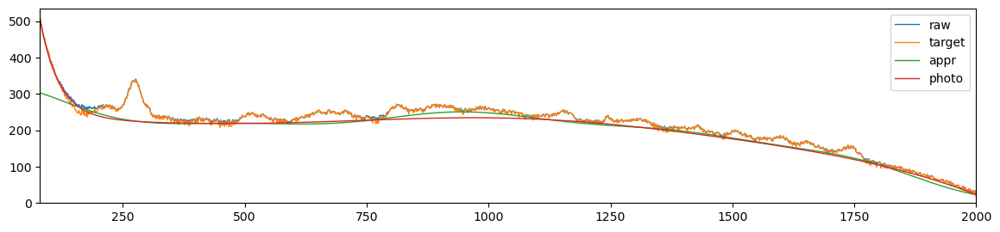

77.0437982047437 56.67794428315614 0.16799752835286813 0.1736676680656034
FWHM: 650,	 width: 0.93,	 RBF shape: (1250, 11),	 error: 77.0437982047437, 	 smoothness: 0.16799752835286813


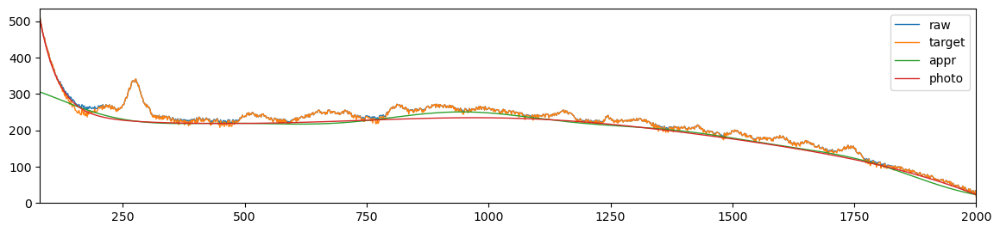

125.79877987043959 83.81128044735546 0.25843470137634544 0.22968194543744877
FWHM: 650,	 width: 0.92,	 RBF shape: (1250, 10),	 error: 125.79877987043959, 	 smoothness: 0.25843470137634544


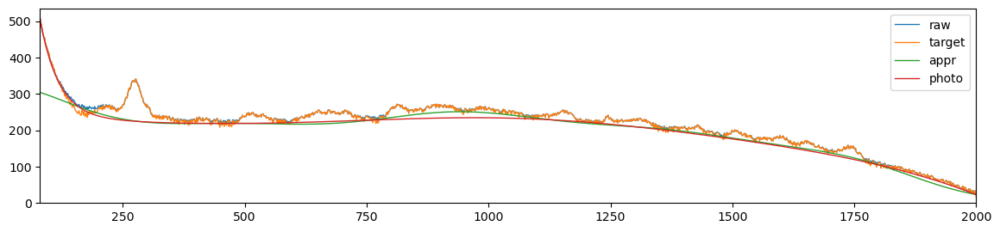

121.53542637100696 82.44455205491296 0.25108624662194 0.22678263910069232
FWHM: 650,	 width: 0.91,	 RBF shape: (1250, 10),	 error: 121.53542637100696, 	 smoothness: 0.25108624662194


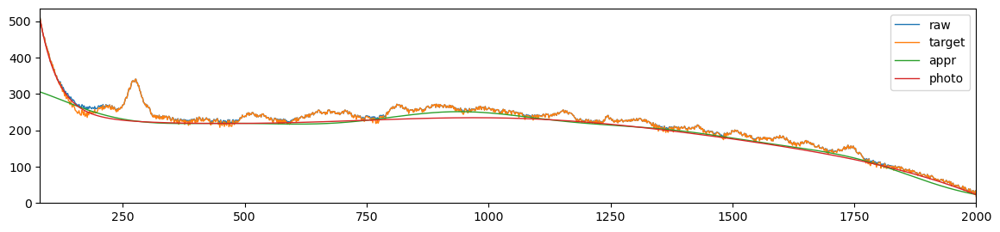

210.05381263535324 128.44518075445515 0.3644655012861992 0.2876563913536351
FWHM: 650,	 width: 0.9,	 RBF shape: (1250, 9),	 error: 210.05381263535324, 	 smoothness: 0.3644655012861992


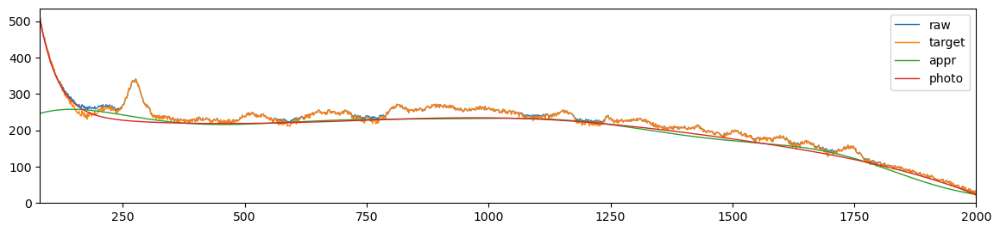

203.97769524068983 126.82397949490083 0.3567444124287583 0.2852710379065557
FWHM: 650,	 width: 0.89,	 RBF shape: (1250, 9),	 error: 203.97769524068983, 	 smoothness: 0.3567444124287583


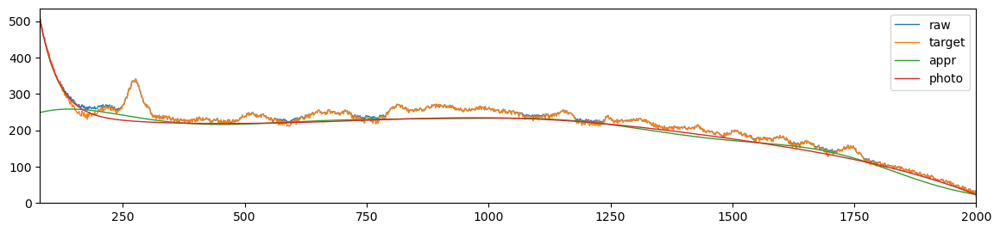

272.69481191308455 145.04664092430468 0.42523704507587995 0.3082701559653432
FWHM: 650,	 width: 0.88,	 RBF shape: (1250, 8),	 error: 272.69481191308455, 	 smoothness: 0.42523704507587995


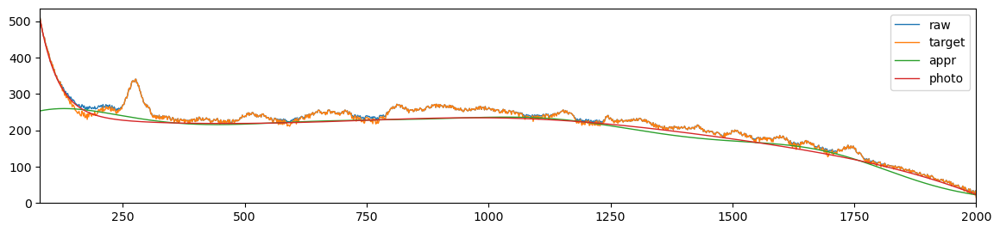

256.1565792489081 141.606741782595 0.408187987185184 0.3042663284483937
FWHM: 650,	 width: 0.8609598862125055,	 RBF shape: (1250, 8),	 error: 256.1565792489081, 	 smoothness: 0.408187987185184


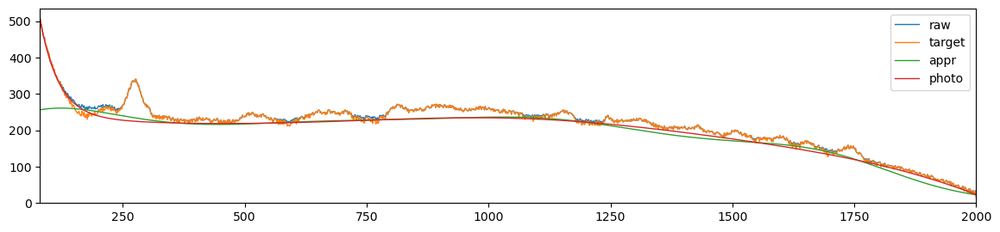

357.59082136770695 174.0479613852615 0.4703619795842549 0.3232470844890918
FWHM: 650,	 width: 0.8382945130946038,	 RBF shape: (1250, 7),	 error: 357.59082136770695, 	 smoothness: 0.4703619795842549


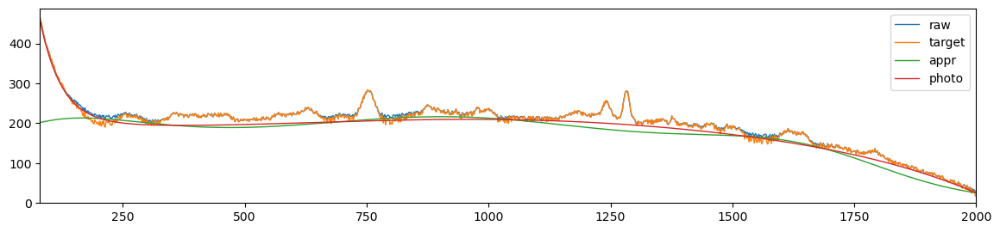

330.6818450394692 170.46799011050294 0.44876181859152886 0.32029937910935374
FWHM: 650,	 width: 0.8113136271446935,	 RBF shape: (1250, 7),	 error: 330.6818450394692, 	 smoothness: 0.44876181859152886


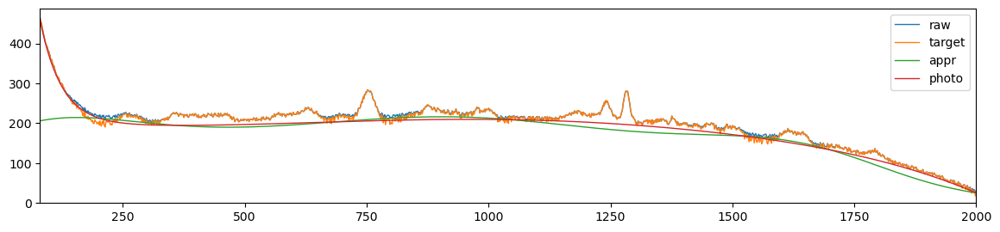

320.1467431213439 181.80050992948952 0.42077132867360645 0.3212841142395831
FWHM: 650,	 width: 0.7791955498090459,	 RBF shape: (1250, 6),	 error: 320.1467431213439, 	 smoothness: 0.42077132867360645


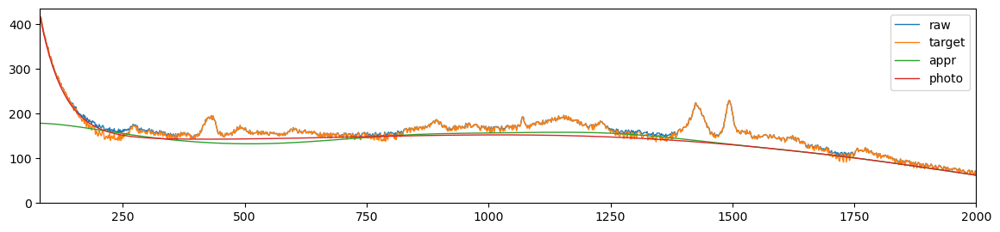

293.6012246346774 176.20161682047083 0.3975445881647973 0.316623702669043
FWHM: 650,	 width: 0.7409621540023357,	 RBF shape: (1250, 6),	 error: 293.6012246346774, 	 smoothness: 0.3975445881647973


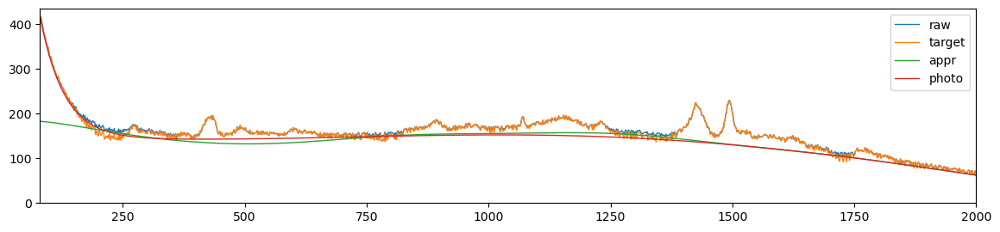

269.7747890050783 170.06029859694897 0.374973235852376 0.31105169985898207
FWHM: 650,	 width: 0.6954490761292048,	 RBF shape: (1250, 6),	 error: 269.7747890050783, 	 smoothness: 0.374973235852376


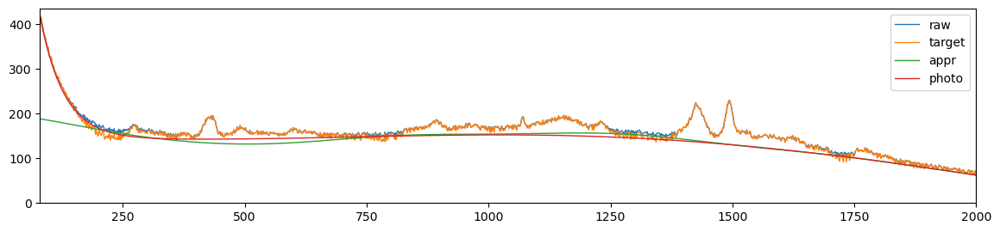

820.5017457309967 313.49393850935957 0.3104119137851756 0.2411492690663278
FWHM: 650,	 width: 0.6412702564408389,	 RBF shape: (1250, 5),	 error: 820.5017457309967, 	 smoothness: 0.3104119137851756


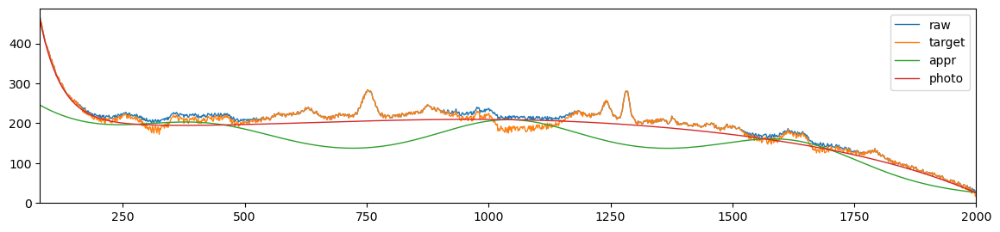

1071.3737705697727 427.6258993146133 0.31802079367641556 0.23207157164904776
FWHM: 650,	 width: 0.5767757278350865,	 RBF shape: (1250, 5),	 error: 1071.3737705697727, 	 smoothness: 0.31802079367641556


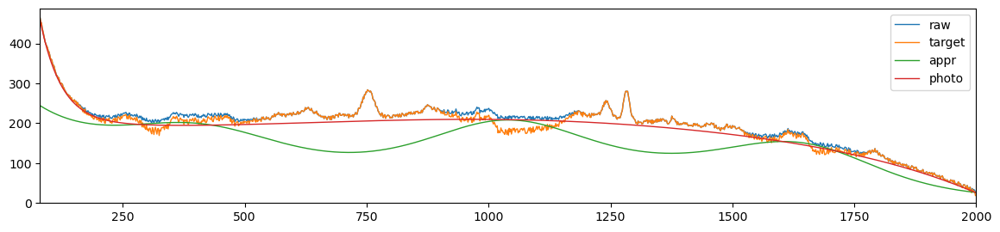

9145.345783546818 4951.026169662294 0.6621740549700149 0.38757541049989475
FWHM: 650,	 width: 0.5000013675960908,	 RBF shape: (1250, 4),	 error: 9145.345783546818, 	 smoothness: 0.6621740549700149


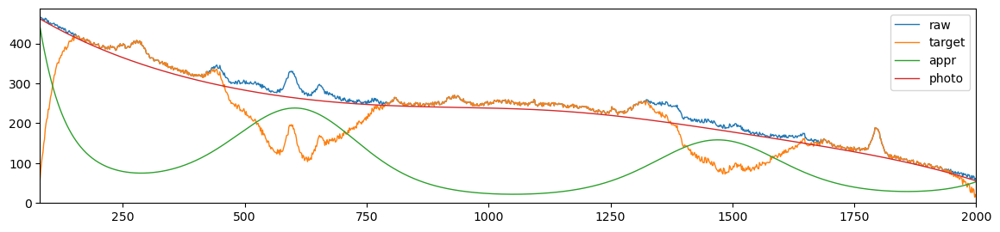

44.352450858667126 15.421045910769651 0.03421836106493025 0.03552888759754846
FWHM: 700,	 width: 0.99,	 RBF shape: (1250, 24),	 error: 44.352450858667126, 	 smoothness: 0.03421836106493025


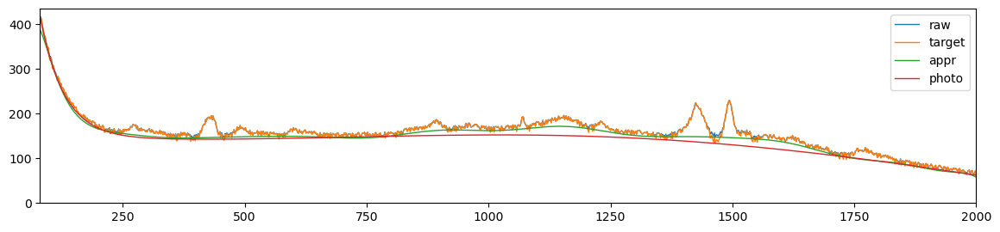

39.330119626870754 16.48709868183253 0.030487841089379016 0.04733873956300067
FWHM: 700,	 width: 0.98,	 RBF shape: (1250, 18),	 error: 39.330119626870754, 	 smoothness: 0.030487841089379016


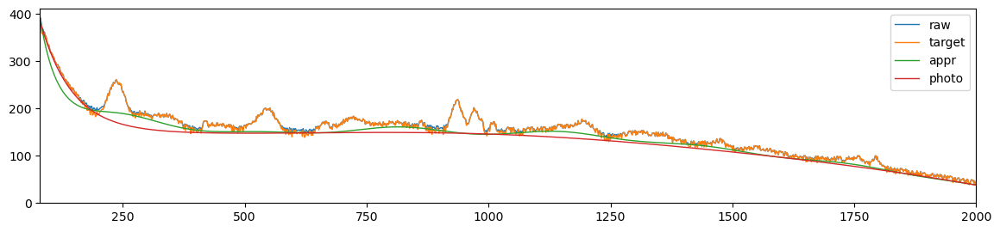

30.93009835208164 14.085255681417344 0.020144872309256302 0.029562988592559923
FWHM: 700,	 width: 0.97,	 RBF shape: (1250, 15),	 error: 30.93009835208164, 	 smoothness: 0.020144872309256302


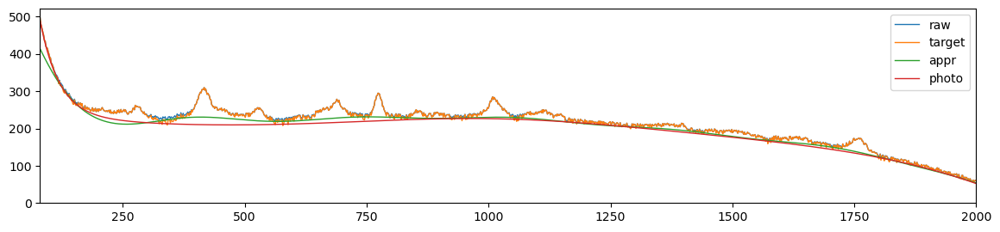

33.155097698570195 20.634693582886236 0.04136838187116199 0.07143098321093051
FWHM: 700,	 width: 0.96,	 RBF shape: (1250, 13),	 error: 33.155097698570195, 	 smoothness: 0.04136838187116199


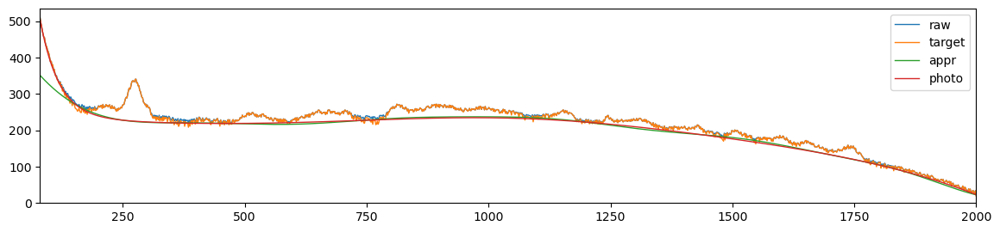

36.68893193088626 21.744501692296982 0.06142307206059882 0.07815678626642895
FWHM: 700,	 width: 0.95,	 RBF shape: (1250, 12),	 error: 36.68893193088626, 	 smoothness: 0.06142307206059882


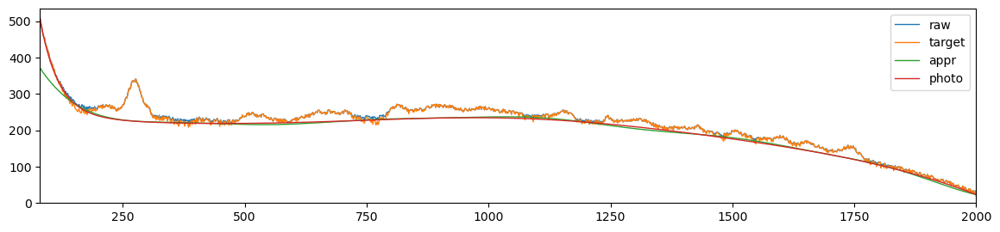

64.89905676328948 49.90256177231581 0.13891927068306414 0.15591048782768557
FWHM: 700,	 width: 0.94,	 RBF shape: (1250, 11),	 error: 64.89905676328948, 	 smoothness: 0.13891927068306414


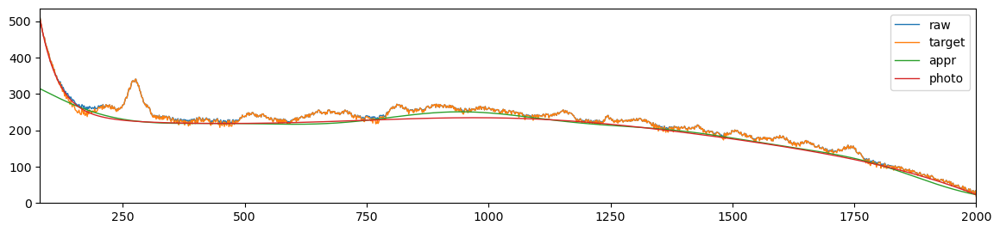

106.5629195953824 76.02867861147514 0.2225890627465785 0.21294519339661327
FWHM: 700,	 width: 0.93,	 RBF shape: (1250, 10),	 error: 106.5629195953824, 	 smoothness: 0.2225890627465785


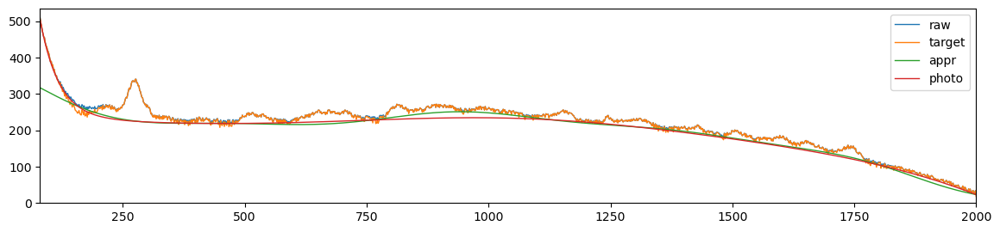

197.71310259217745 126.90115691931679 0.34467833470796494 0.2827967890365026
FWHM: 700,	 width: 0.92,	 RBF shape: (1250, 9),	 error: 197.71310259217745, 	 smoothness: 0.34467833470796494


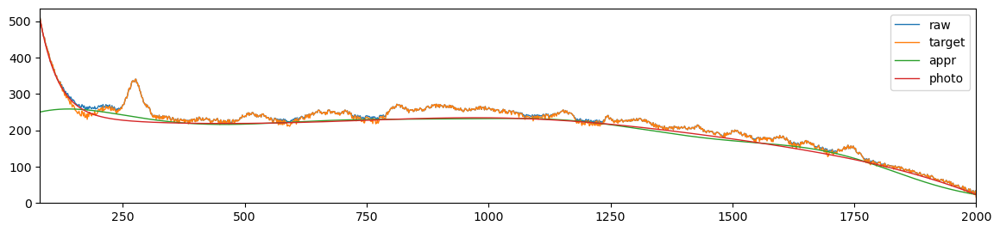

192.1440959121142 124.92938465493435 0.3374167966830607 0.28009342076884447
FWHM: 700,	 width: 0.91,	 RBF shape: (1250, 9),	 error: 192.1440959121142, 	 smoothness: 0.3374167966830607


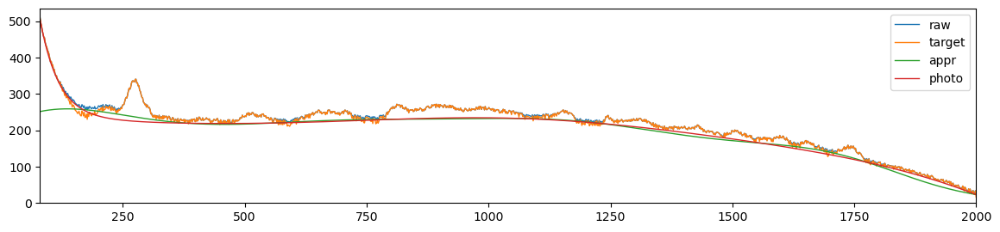

186.80504191517855 123.08927126008858 0.3304178523289285 0.27765167723264017
FWHM: 700,	 width: 0.9,	 RBF shape: (1250, 9),	 error: 186.80504191517855, 	 smoothness: 0.3304178523289285


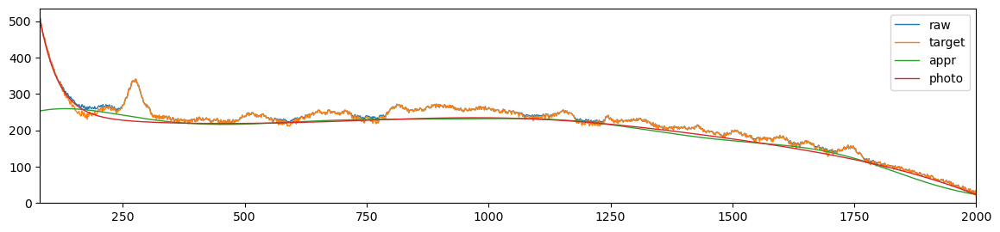

253.7948047580382 141.00791337130593 0.40125217162474824 0.3018576020337868
FWHM: 700,	 width: 0.89,	 RBF shape: (1250, 8),	 error: 253.7948047580382, 	 smoothness: 0.40125217162474824


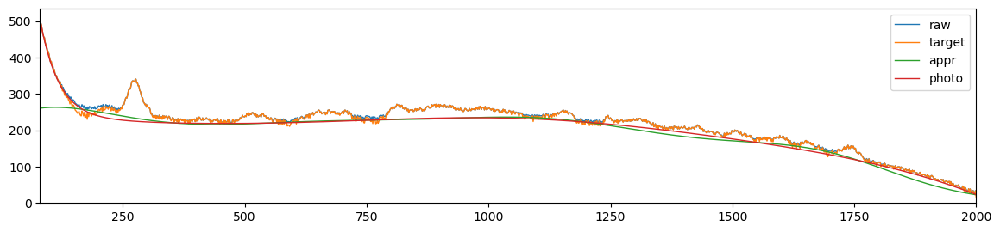

246.25930167164833 139.4913295252121 0.39348098855442915 0.300229260839726
FWHM: 700,	 width: 0.88,	 RBF shape: (1250, 8),	 error: 246.25930167164833, 	 smoothness: 0.39348098855442915


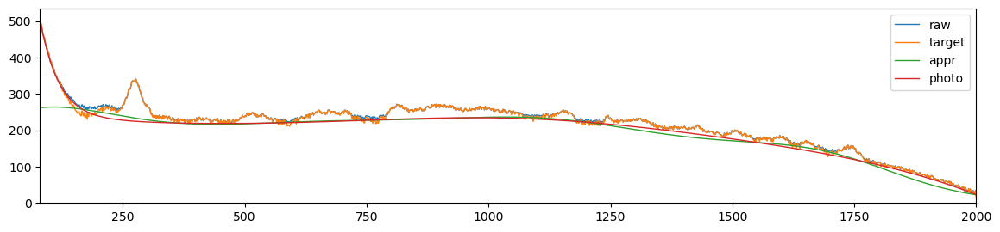

379.0604403383579 178.89217199475382 0.4788309086400135 0.3240429938035621
FWHM: 700,	 width: 0.8609598862125055,	 RBF shape: (1250, 7),	 error: 379.0604403383579, 	 smoothness: 0.4788309086400135


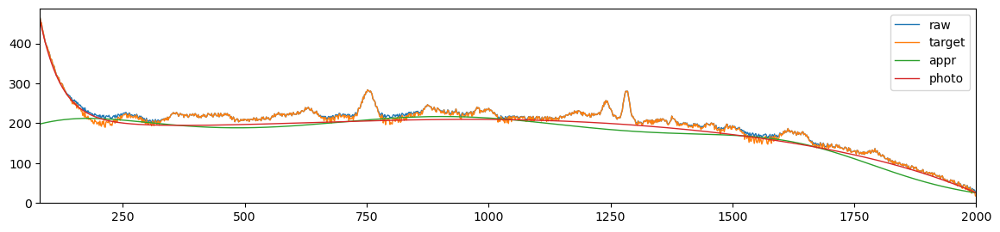

355.31527735211785 174.7392196307539 0.46115125826394837 0.3215471687612179
FWHM: 700,	 width: 0.8382945130946038,	 RBF shape: (1250, 7),	 error: 355.31527735211785, 	 smoothness: 0.46115125826394837


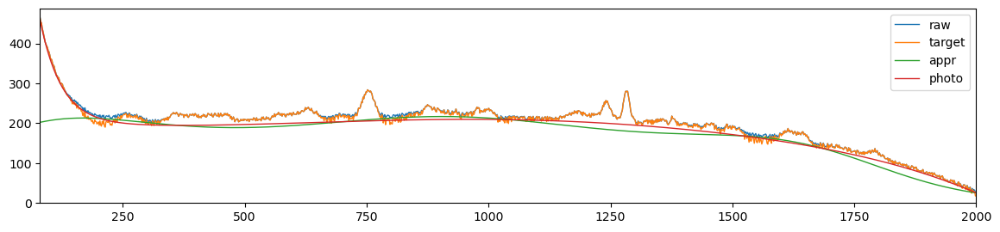

356.4474565830362 186.707765838001 0.44761843342782376 0.3245281579197271
FWHM: 700,	 width: 0.8113136271446935,	 RBF shape: (1250, 6),	 error: 356.4474565830362, 	 smoothness: 0.44761843342782376


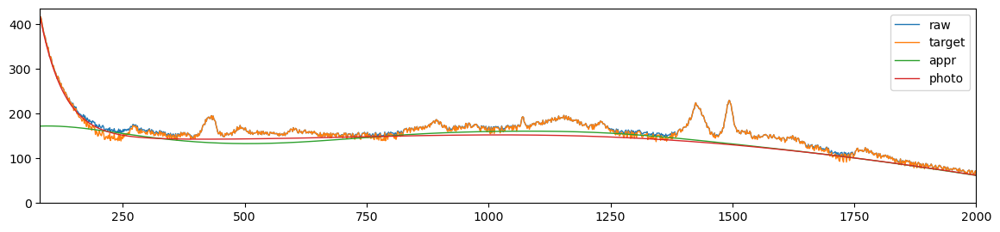

327.06826309838164 182.3229692386756 0.42523218846496347 0.3215303329146509
FWHM: 700,	 width: 0.7791955498090459,	 RBF shape: (1250, 6),	 error: 327.06826309838164, 	 smoothness: 0.42523218846496347


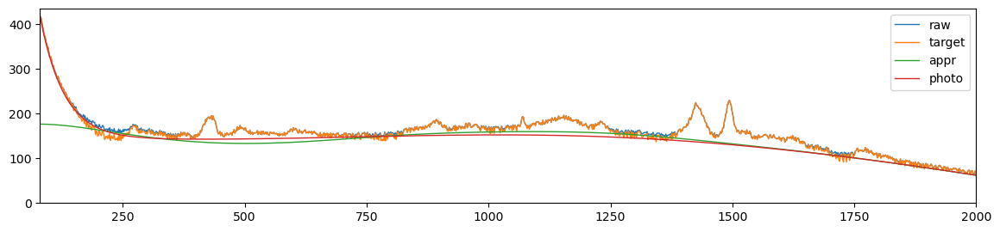

299.03080212336454 177.15761000019378 0.40239423504892735 0.31752414255359973
FWHM: 700,	 width: 0.7409621540023357,	 RBF shape: (1250, 6),	 error: 299.03080212336454, 	 smoothness: 0.40239423504892735


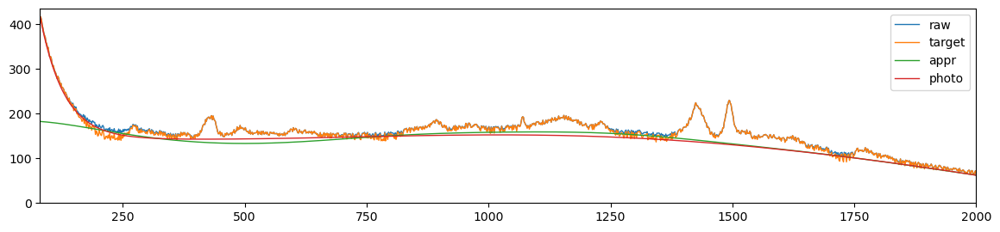

464.744313234809 203.0068290203113 0.35959703394497444 0.29405237068528645
FWHM: 700,	 width: 0.6954490761292048,	 RBF shape: (1250, 5),	 error: 464.744313234809, 	 smoothness: 0.35959703394497444


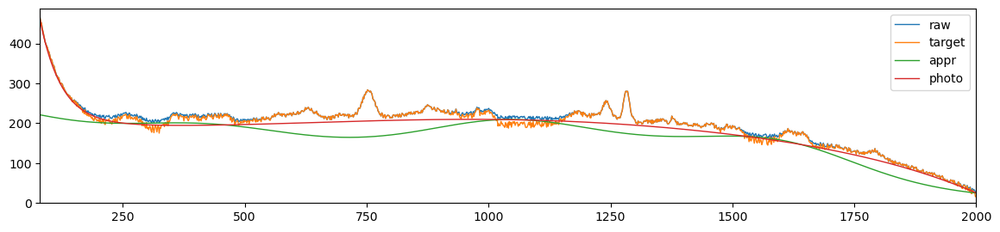

534.5273792572971 216.22214019859337 0.3499339979317641 0.2870671821314768
FWHM: 700,	 width: 0.6412702564408389,	 RBF shape: (1250, 5),	 error: 534.5273792572971, 	 smoothness: 0.3499339979317641


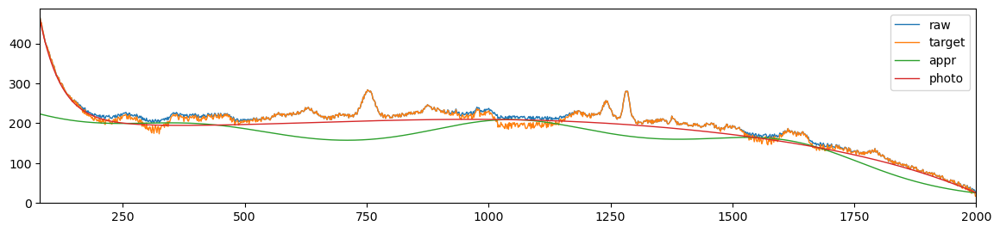

667.4861164386175 254.7206302918394 0.34976537696728827 0.2813817340180093
FWHM: 700,	 width: 0.5767757278350865,	 RBF shape: (1250, 5),	 error: 667.4861164386175, 	 smoothness: 0.34976537696728827


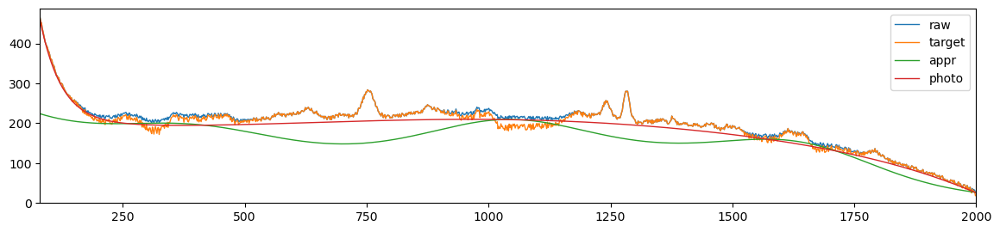

6866.637266263512 3625.112302786267 0.49253789088130345 0.3387977046536316
FWHM: 700,	 width: 0.5000013675960908,	 RBF shape: (1250, 4),	 error: 6866.637266263512, 	 smoothness: 0.49253789088130345


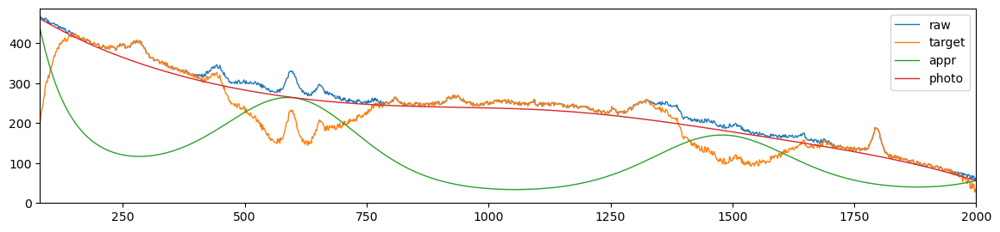

41.81566679756716 14.522378019894859 0.037029064566406505 0.046704588666279634
FWHM: 750,	 width: 0.99,	 RBF shape: (1250, 23),	 error: 41.81566679756716, 	 smoothness: 0.037029064566406505


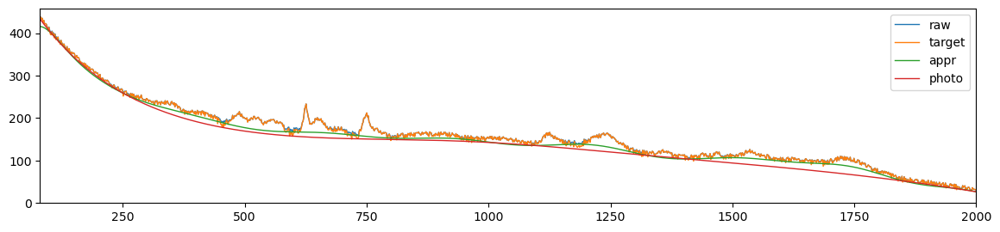

33.97929009615129 15.868417744599068 0.024211721356874872 0.027590067048295065
FWHM: 750,	 width: 0.98,	 RBF shape: (1250, 16),	 error: 33.97929009615129, 	 smoothness: 0.024211721356874872


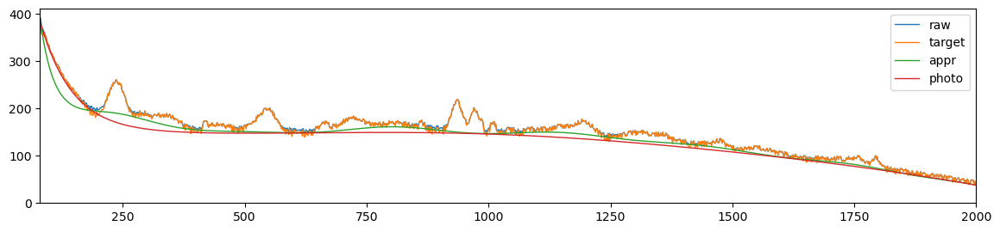

27.984529913702247 13.692220960774025 0.016180998151369797 0.023966128122210804
FWHM: 750,	 width: 0.97,	 RBF shape: (1250, 14),	 error: 27.984529913702247, 	 smoothness: 0.016180998151369797


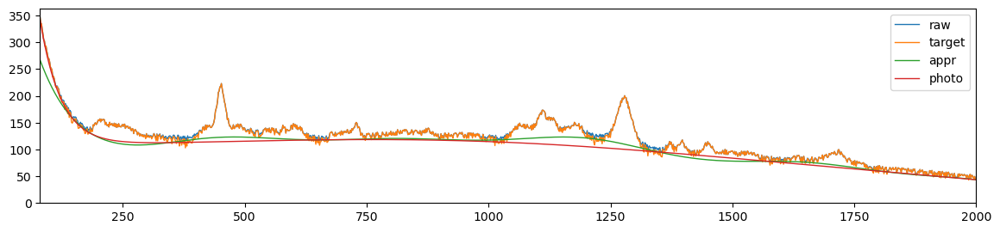

32.02187097880692 18.340946641109273 0.04605443965984212 0.0623568221619509
FWHM: 750,	 width: 0.96,	 RBF shape: (1250, 12),	 error: 32.02187097880692, 	 smoothness: 0.04605443965984212


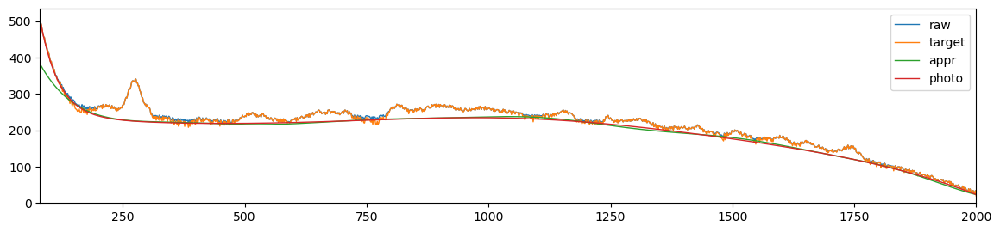

55.31873768021826 43.80903755943146 0.11504433681089492 0.1390345521184483
FWHM: 750,	 width: 0.95,	 RBF shape: (1250, 11),	 error: 55.31873768021826, 	 smoothness: 0.11504433681089492


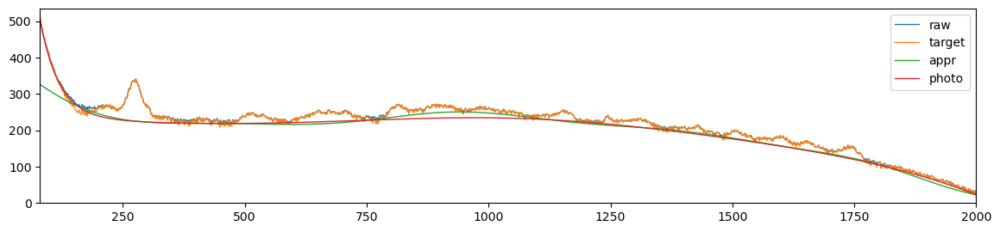

90.60599208628554 68.25998062455106 0.19156157154182654 0.1958309305128459
FWHM: 750,	 width: 0.94,	 RBF shape: (1250, 10),	 error: 90.60599208628554, 	 smoothness: 0.19156157154182654


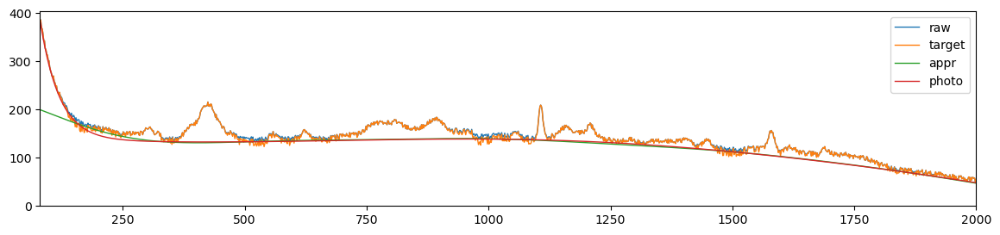

178.68202606311294 121.5089520743042 0.3169737065692139 0.27383357872903274
FWHM: 750,	 width: 0.93,	 RBF shape: (1250, 9),	 error: 178.68202606311294, 	 smoothness: 0.3169737065692139


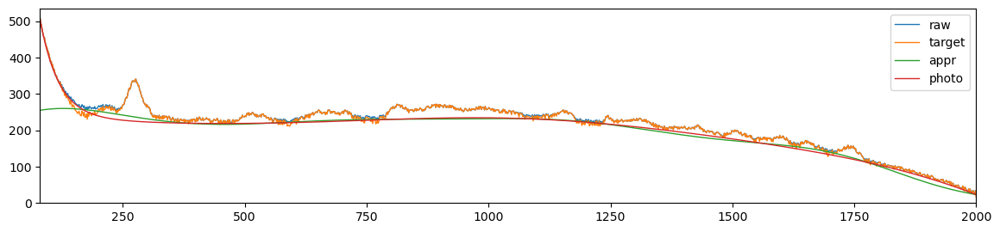

173.66873118873747 119.3309693157483 0.310300822328186 0.27089165081081645
FWHM: 750,	 width: 0.92,	 RBF shape: (1250, 9),	 error: 173.66873118873747, 	 smoothness: 0.310300822328186


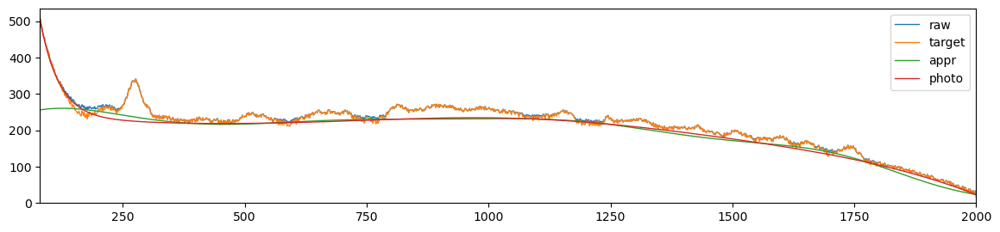

240.23339925213858 138.26587024567772 0.38364541891970744 0.2972684025042992
FWHM: 750,	 width: 0.91,	 RBF shape: (1250, 8),	 error: 240.23339925213858, 	 smoothness: 0.38364541891970744


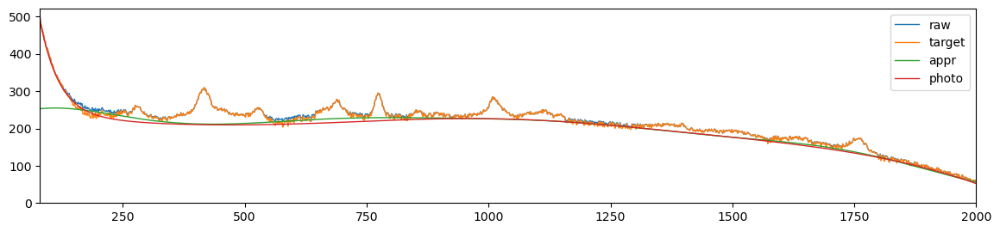

233.3995087764665 136.77745627885201 0.376276724774847 0.2954169823717503
FWHM: 750,	 width: 0.9,	 RBF shape: (1250, 8),	 error: 233.3995087764665, 	 smoothness: 0.376276724774847


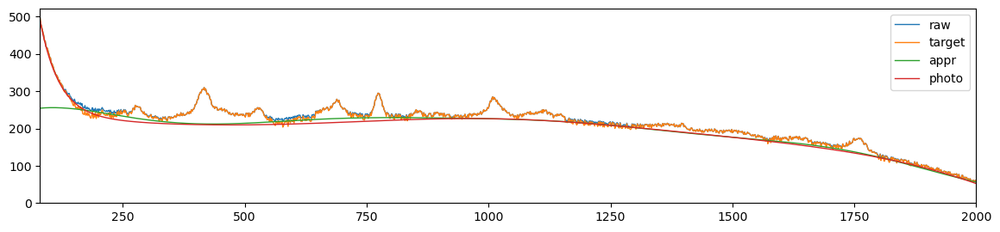

227.06539059199898 135.41876384696363 0.3693153145717454 0.29365507968296267
FWHM: 750,	 width: 0.89,	 RBF shape: (1250, 8),	 error: 227.06539059199898, 	 smoothness: 0.3693153145717454


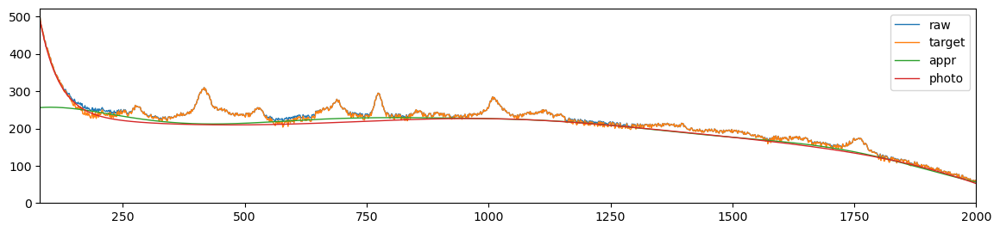

387.86746094919005 181.6944323120978 0.4785999946374904 0.3236382223868451
FWHM: 750,	 width: 0.88,	 RBF shape: (1250, 7),	 error: 387.86746094919005, 	 smoothness: 0.4785999946374904


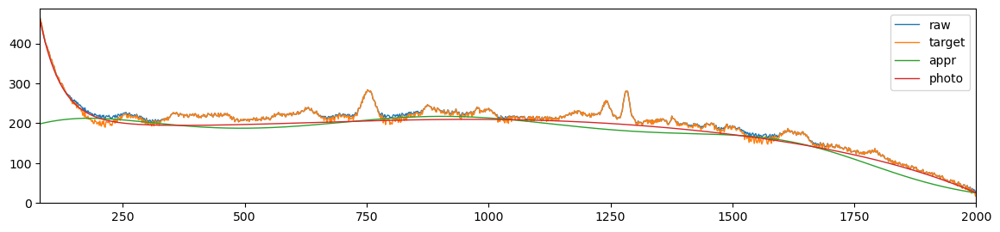

368.4545353050466 178.69257443765952 0.464615219078832 0.3217851638106776
FWHM: 750,	 width: 0.8609598862125055,	 RBF shape: (1250, 7),	 error: 368.4545353050466, 	 smoothness: 0.464615219078832


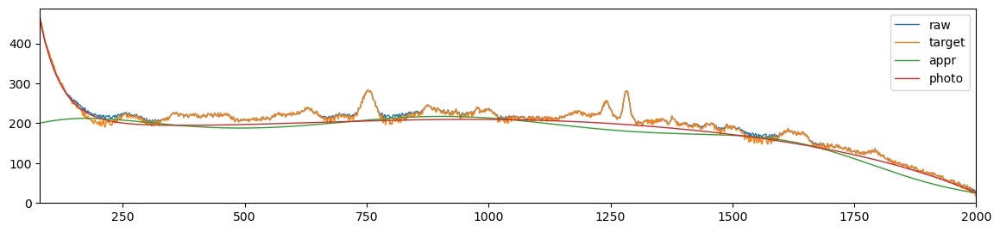

347.68833314857204 174.92642144206962 0.4492773900690037 0.31951323920610963
FWHM: 750,	 width: 0.8382945130946038,	 RBF shape: (1250, 7),	 error: 347.68833314857204, 	 smoothness: 0.4492773900690037


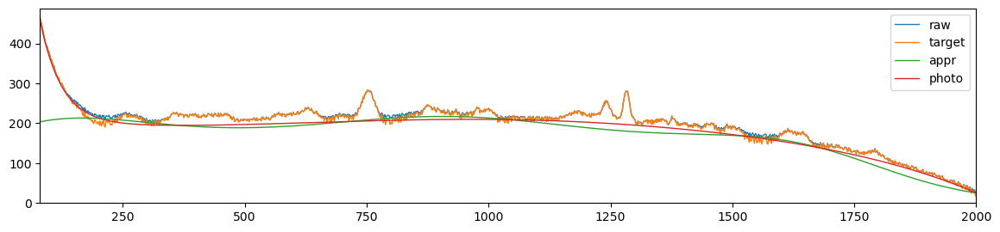

355.57573504093523 185.84637423835548 0.4438037791932667 0.32300379747679964
FWHM: 750,	 width: 0.8113136271446935,	 RBF shape: (1250, 6),	 error: 355.57573504093523, 	 smoothness: 0.4438037791932667


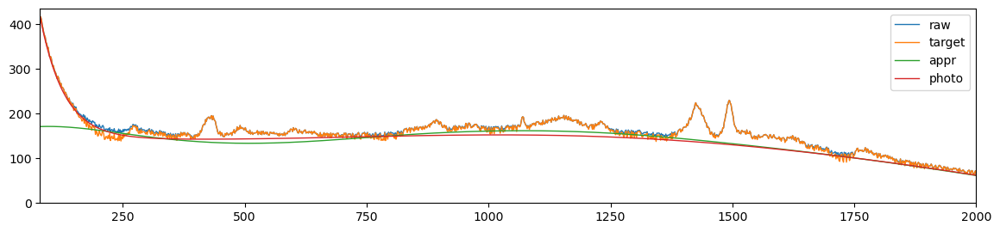

327.59513803686895 181.90658144951072 0.42295348288356815 0.32044550128468974
FWHM: 750,	 width: 0.7791955498090459,	 RBF shape: (1250, 6),	 error: 327.59513803686895, 	 smoothness: 0.42295348288356815


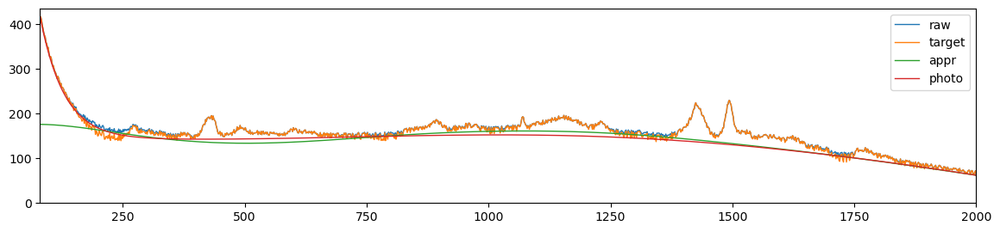

423.95600582708795 220.8967014023116 0.4129213771629863 0.31720175193010836
FWHM: 750,	 width: 0.7409621540023357,	 RBF shape: (1250, 5),	 error: 423.95600582708795, 	 smoothness: 0.4129213771629863


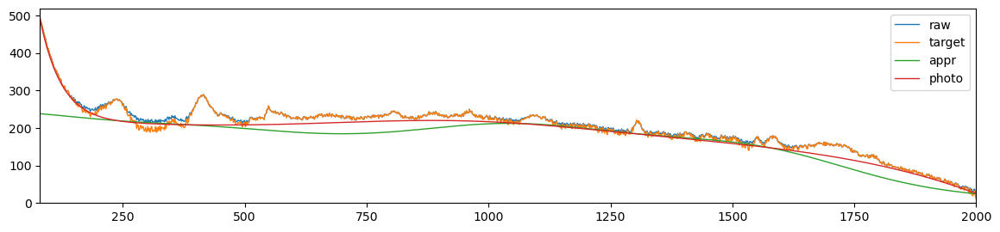

412.75330245801985 214.0252832145078 0.3937704184352402 0.31196070951034616
FWHM: 750,	 width: 0.6954490761292048,	 RBF shape: (1250, 5),	 error: 412.75330245801985, 	 smoothness: 0.3937704184352402


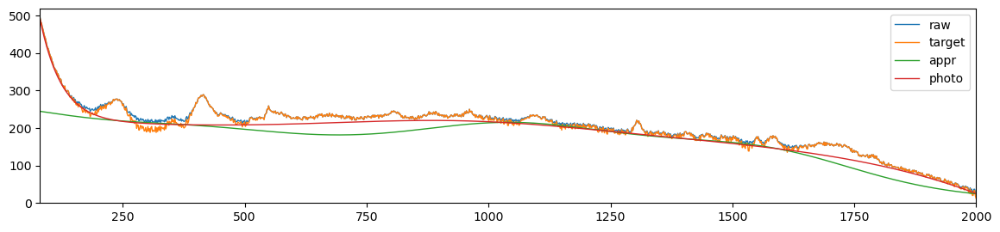

425.0278040593841 211.5536147649648 0.3792109168342057 0.30700856016056527
FWHM: 750,	 width: 0.6412702564408389,	 RBF shape: (1250, 5),	 error: 425.0278040593841, 	 smoothness: 0.3792109168342057


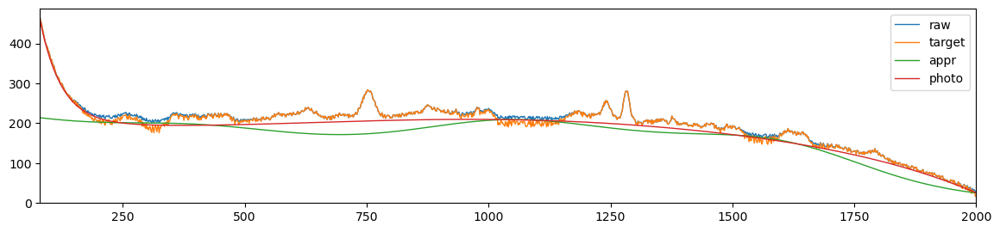

4486.915110047475 2363.7100690979773 0.30732084322131475 0.18651383561216264
FWHM: 750,	 width: 0.5767757278350865,	 RBF shape: (1250, 4),	 error: 4486.915110047475, 	 smoothness: 0.30732084322131475


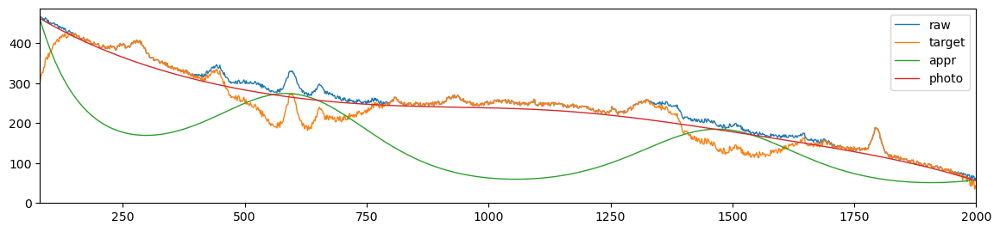

5226.700555928459 2678.6194191483874 0.3373654387459013 0.22209190999296988
FWHM: 750,	 width: 0.5000013675960908,	 RBF shape: (1250, 4),	 error: 5226.700555928459, 	 smoothness: 0.3373654387459013


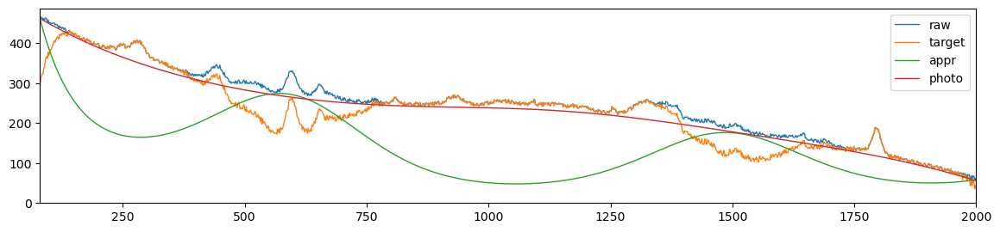

40.38480401654799 15.492839780538525 0.035643287339884984 0.05180063747367532
FWHM: 800,	 width: 0.99,	 RBF shape: (1250, 21),	 error: 40.38480401654799, 	 smoothness: 0.035643287339884984


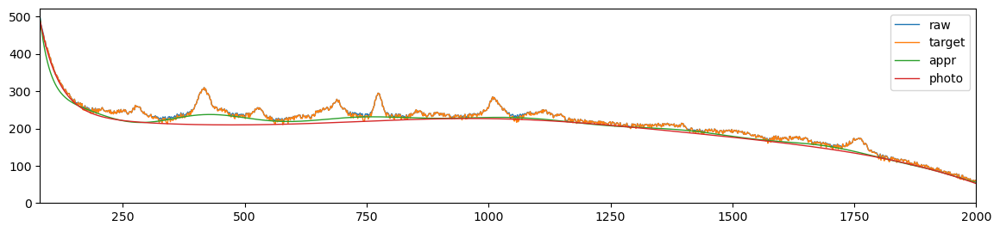

33.73188800040778 15.842480520862734 0.026202158620996188 0.031497654802103536
FWHM: 800,	 width: 0.98,	 RBF shape: (1250, 16),	 error: 33.73188800040778, 	 smoothness: 0.026202158620996188


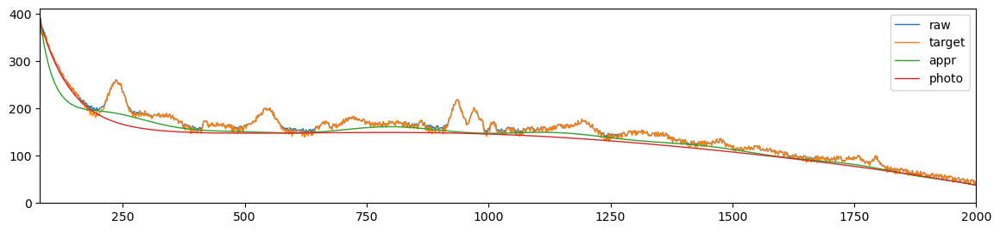

28.774344605974953 16.436604172968536 0.028072564119518015 0.05154320194182951
FWHM: 800,	 width: 0.97,	 RBF shape: (1250, 13),	 error: 28.774344605974953, 	 smoothness: 0.028072564119518015


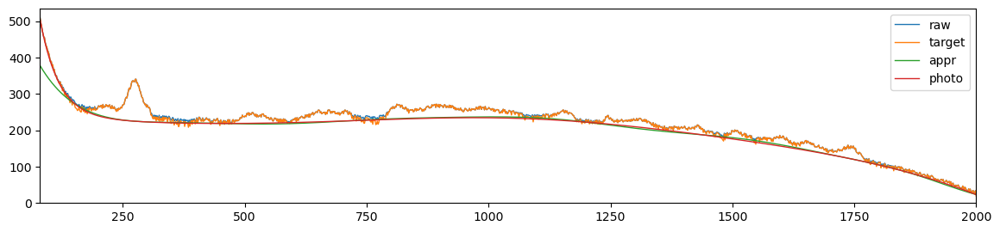

47.9349635759062 38.24000184518997 0.09601461749241691 0.12375204692744324
FWHM: 800,	 width: 0.96,	 RBF shape: (1250, 11),	 error: 47.9349635759062, 	 smoothness: 0.09601461749241691


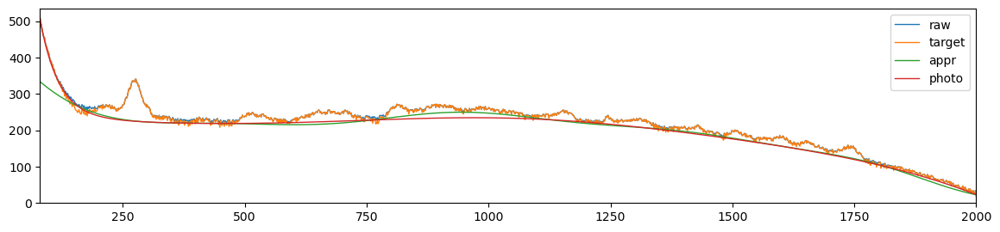

77.80771643891471 61.26092587422286 0.16534470736935242 0.17984053987525636
FWHM: 800,	 width: 0.95,	 RBF shape: (1250, 10),	 error: 77.80771643891471, 	 smoothness: 0.16534470736935242


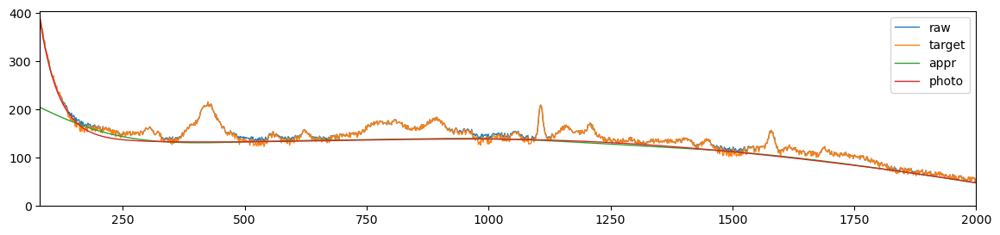

75.88950221137269 60.2633190457817 0.16147875668059933 0.17759414291653808
FWHM: 800,	 width: 0.94,	 RBF shape: (1250, 10),	 error: 75.88950221137269, 	 smoothness: 0.16147875668059933


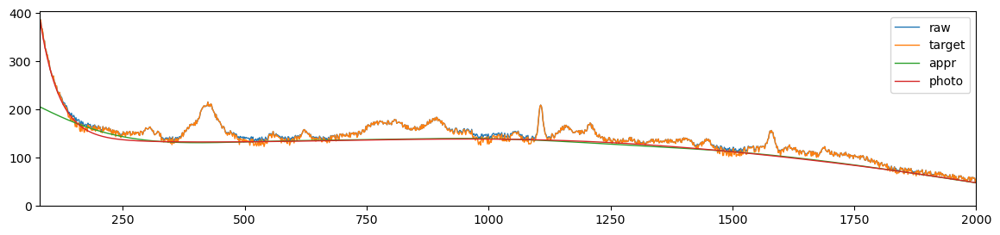

156.94183191563 113.57600841637547 0.28546692012098057 0.261268086553206
FWHM: 800,	 width: 0.93,	 RBF shape: (1250, 9),	 error: 156.94183191563, 	 smoothness: 0.28546692012098057


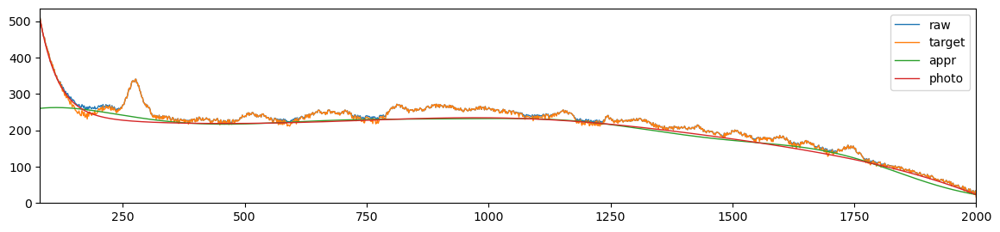

218.90226849527633 133.2042838158588 0.3577719007656856 0.28977773597728923
FWHM: 800,	 width: 0.92,	 RBF shape: (1250, 8),	 error: 218.90226849527633, 	 smoothness: 0.3577719007656856


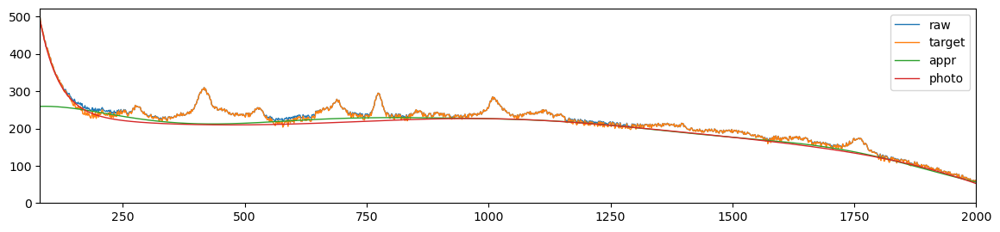

212.99921304321674 132.05287979078892 0.3511623647598435 0.28813676607183597
FWHM: 800,	 width: 0.91,	 RBF shape: (1250, 8),	 error: 212.99921304321674, 	 smoothness: 0.3511623647598435


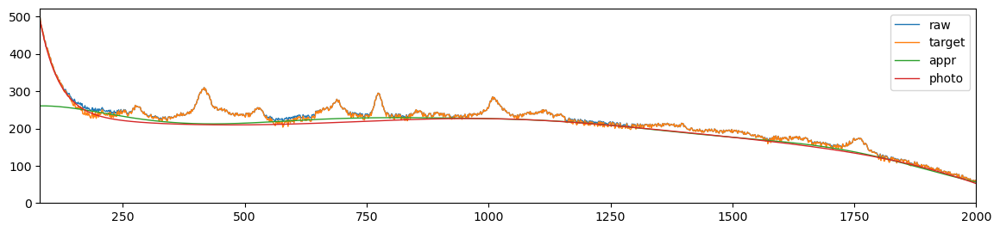

207.53952811016498 130.85948890810099 0.345029950735489 0.2866485762711651
FWHM: 800,	 width: 0.9,	 RBF shape: (1250, 8),	 error: 207.53952811016498, 	 smoothness: 0.345029950735489


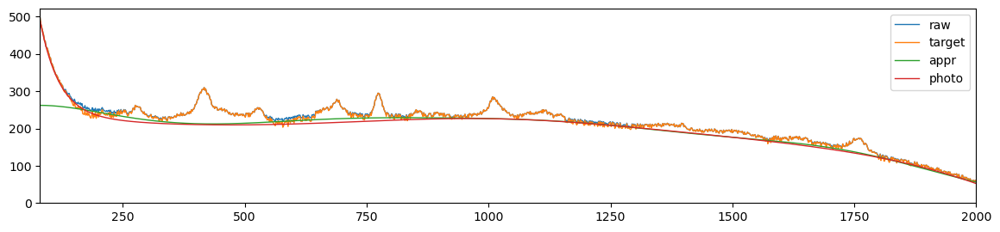

380.52737895055697 182.14151020392453 0.46801368452428704 0.32194956011343534
FWHM: 800,	 width: 0.89,	 RBF shape: (1250, 7),	 error: 380.52737895055697, 	 smoothness: 0.46801368452428704


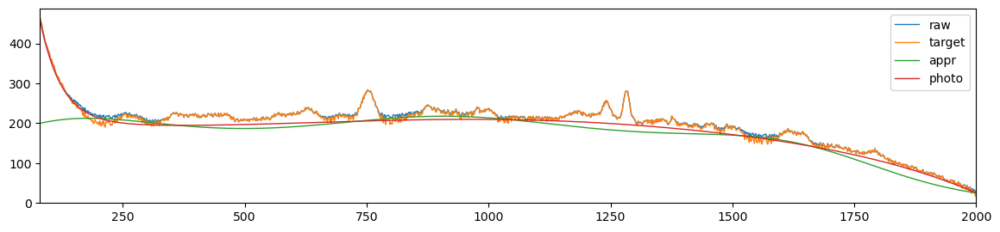

370.77723939523565 180.63866709466586 0.4613222776744726 0.32117042759577286
FWHM: 800,	 width: 0.88,	 RBF shape: (1250, 7),	 error: 370.77723939523565, 	 smoothness: 0.4613222776744726


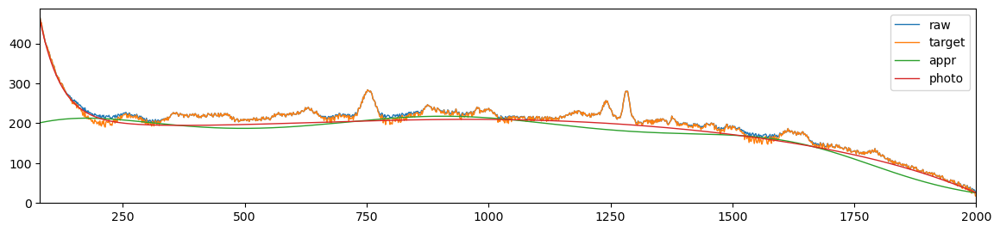

354.77554692938645 177.71653917378546 0.4492769723081468 0.3193316208758377
FWHM: 800,	 width: 0.8609598862125055,	 RBF shape: (1250, 7),	 error: 354.77554692938645, 	 smoothness: 0.4492769723081468


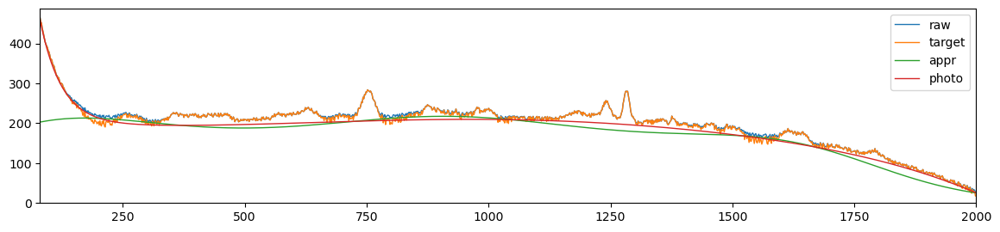

375.4971926571712 187.48733914622665 0.4541033871099219 0.3230880072885354
FWHM: 800,	 width: 0.8382945130946038,	 RBF shape: (1250, 6),	 error: 375.4971926571712, 	 smoothness: 0.4541033871099219


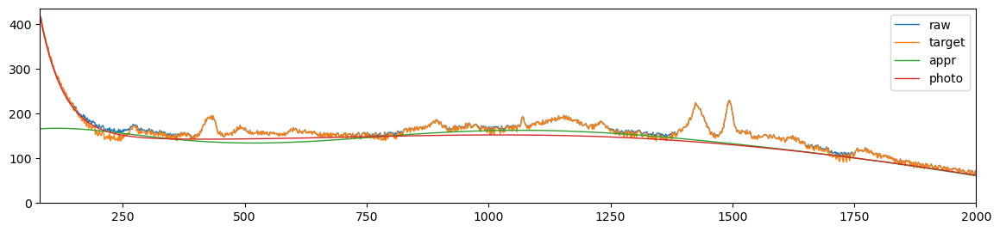

349.42998447915073 184.13306102089928 0.4359590522283849 0.32094089972179196
FWHM: 800,	 width: 0.8113136271446935,	 RBF shape: (1250, 6),	 error: 349.42998447915073, 	 smoothness: 0.4359590522283849


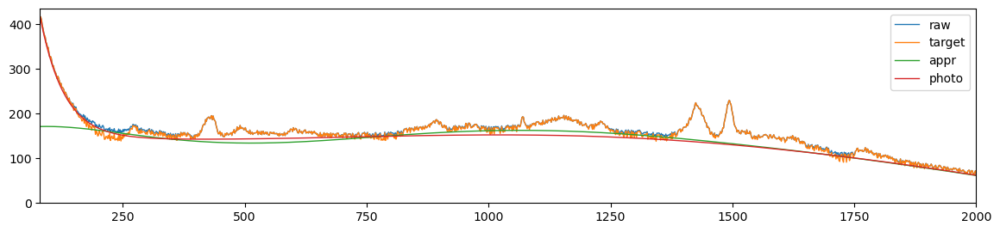

323.0586711486289 180.6196737687114 0.4166210936133439 0.3183775649202809
FWHM: 800,	 width: 0.7791955498090459,	 RBF shape: (1250, 6),	 error: 323.0586711486289, 	 smoothness: 0.4166210936133439


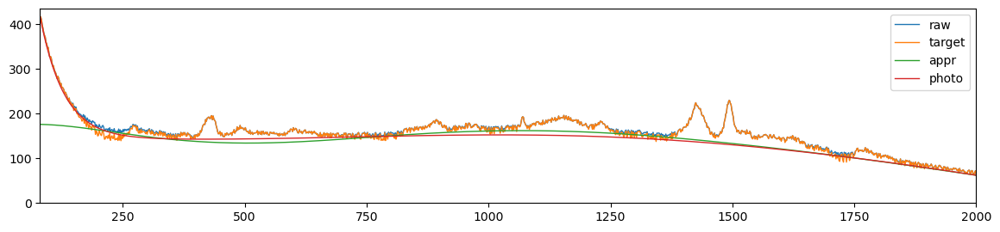

449.50973246662426 235.57060708573655 0.4381250275185116 0.32390857290735514
FWHM: 800,	 width: 0.7409621540023357,	 RBF shape: (1250, 5),	 error: 449.50973246662426, 	 smoothness: 0.4381250275185116


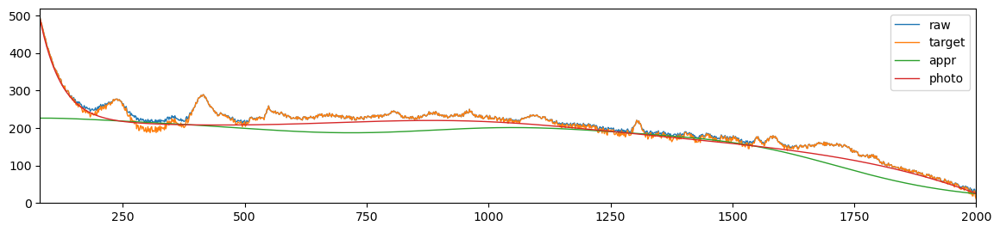

418.7217307611691 226.57430770668853 0.41792418317257324 0.3203275909629056
FWHM: 800,	 width: 0.6954490761292048,	 RBF shape: (1250, 5),	 error: 418.7217307611691, 	 smoothness: 0.41792418317257324


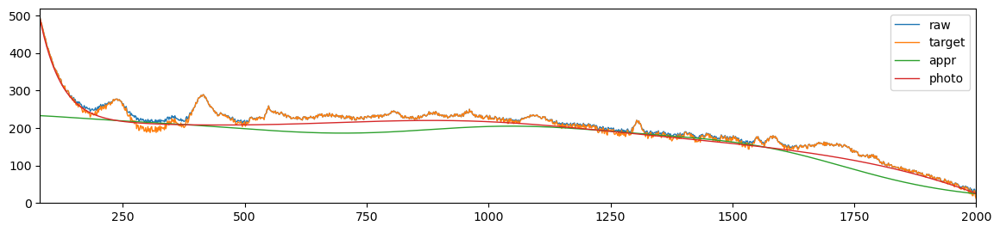

2697.4347502915443 1320.244867764291 0.25821883316162586 0.1442375386056342
FWHM: 800,	 width: 0.6412702564408389,	 RBF shape: (1250, 4),	 error: 2697.4347502915443, 	 smoothness: 0.25821883316162586


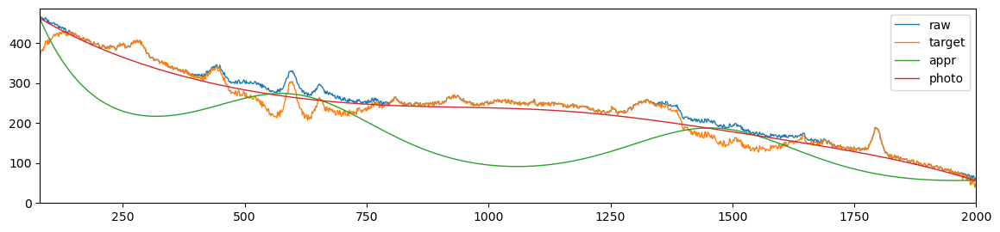

3284.897995825369 1601.8350275950872 0.2575304178495199 0.1360132376275552
FWHM: 800,	 width: 0.5767757278350865,	 RBF shape: (1250, 4),	 error: 3284.897995825369, 	 smoothness: 0.2575304178495199


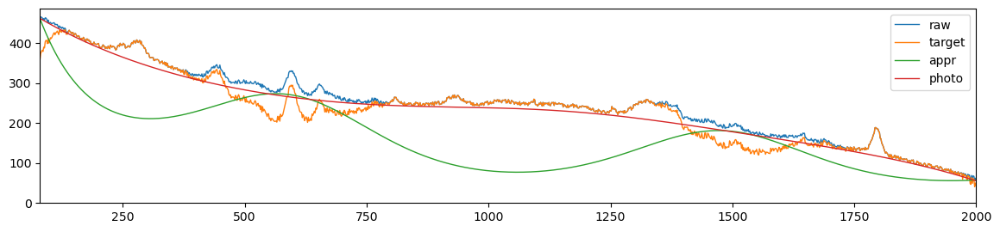

4022.4665689387107 1931.9367661292515 0.2651964800131517 0.14245689277718798
FWHM: 800,	 width: 0.5000013675960908,	 RBF shape: (1250, 4),	 error: 4022.4665689387107, 	 smoothness: 0.2651964800131517


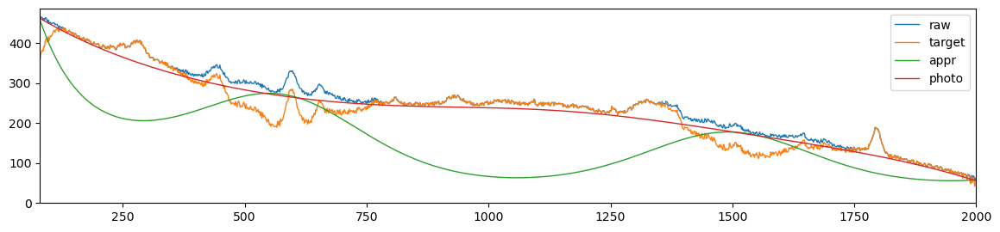

37.68638863665192 15.499471777294938 0.033577046347199255 0.055962578809458347
FWHM: 850,	 width: 0.99,	 RBF shape: (1250, 20),	 error: 37.68638863665192, 	 smoothness: 0.033577046347199255


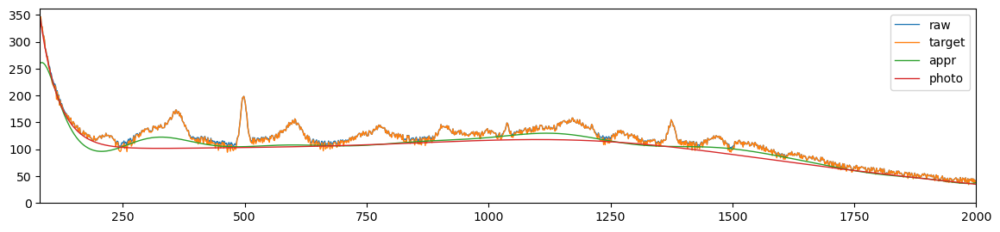

29.9103557436024 13.79214768280547 0.02073743918958184 0.02898000672883946
FWHM: 850,	 width: 0.98,	 RBF shape: (1250, 15),	 error: 29.9103557436024, 	 smoothness: 0.02073743918958184


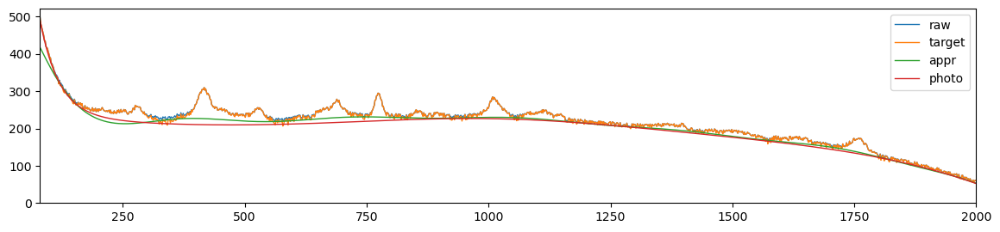

26.108920341662426 13.745242572092383 0.02648251124874683 0.04015446351788165
FWHM: 850,	 width: 0.97,	 RBF shape: (1250, 12),	 error: 26.108920341662426, 	 smoothness: 0.02648251124874683


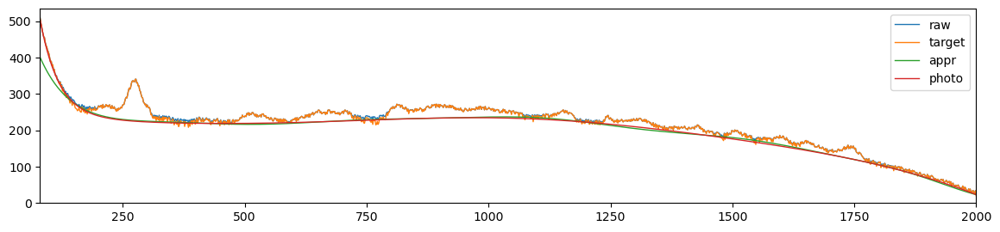

41.84352966733821 33.254422378107655 0.07928181500421105 0.10875982458512565
FWHM: 850,	 width: 0.96,	 RBF shape: (1250, 11),	 error: 41.84352966733821, 	 smoothness: 0.07928181500421105


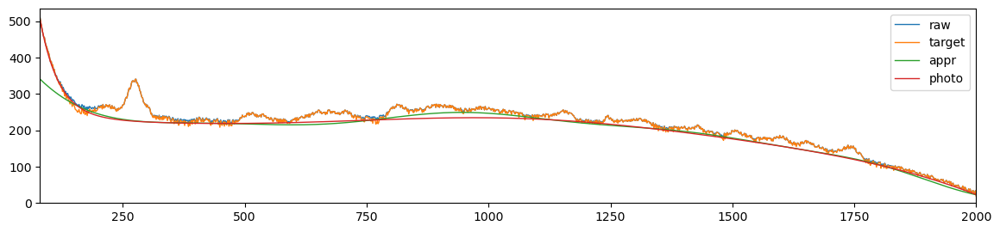

66.20759188615277 53.9363268692304 0.14036625144391335 0.1623830840627397
FWHM: 850,	 width: 0.95,	 RBF shape: (1250, 10),	 error: 66.20759188615277, 	 smoothness: 0.14036625144391335


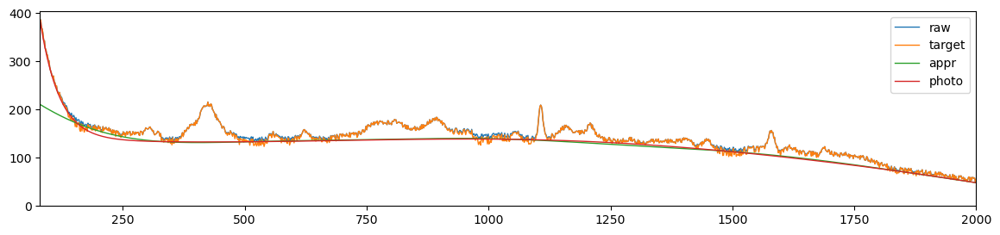

142.08241558518196 107.1793115852598 0.26283739073154566 0.2505176271341735
FWHM: 850,	 width: 0.94,	 RBF shape: (1250, 9),	 error: 142.08241558518196, 	 smoothness: 0.26283739073154566


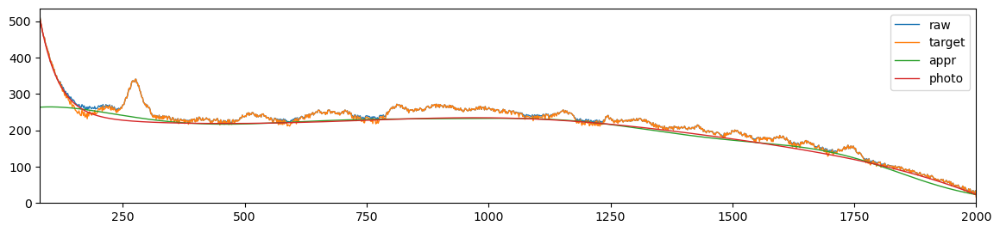

198.31290501251496 128.4051938818173 0.3325287872506387 0.28242246332419146
FWHM: 850,	 width: 0.93,	 RBF shape: (1250, 8),	 error: 198.31290501251496, 	 smoothness: 0.3325287872506387


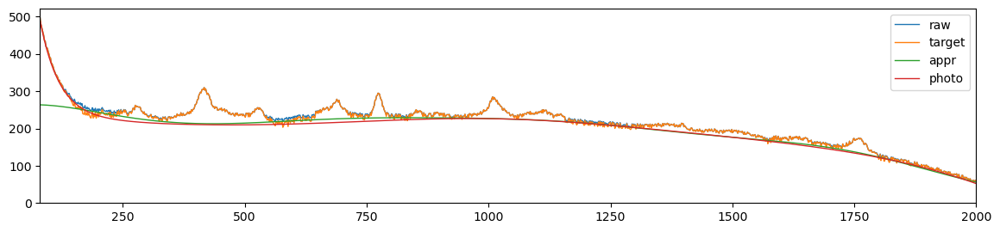

193.6762538733475 127.07643077357571 0.32712596239962927 0.28051138187496766
FWHM: 850,	 width: 0.92,	 RBF shape: (1250, 8),	 error: 193.6762538733475, 	 smoothness: 0.32712596239962927


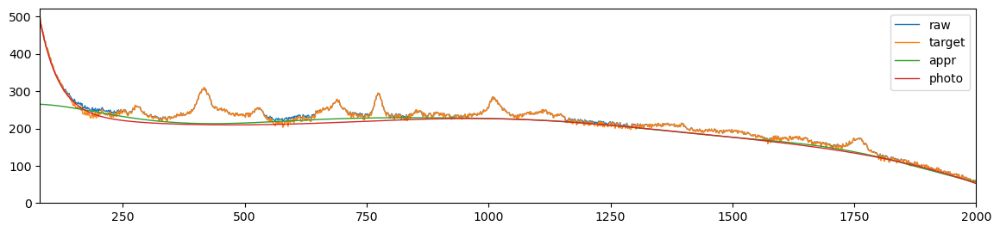

189.2063547187214 125.98970651441999 0.3218412837718083 0.27901048721791155
FWHM: 850,	 width: 0.91,	 RBF shape: (1250, 8),	 error: 189.2063547187214, 	 smoothness: 0.3218412837718083


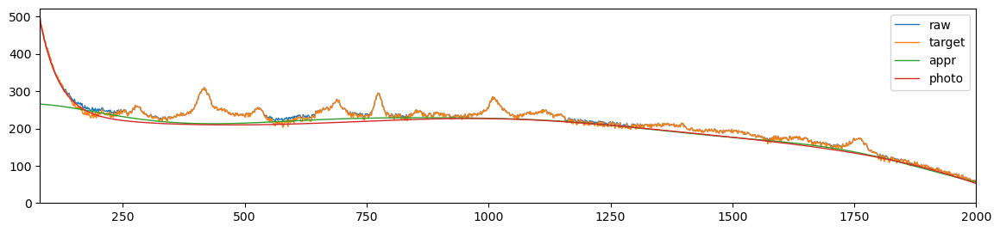

369.73947568942333 182.1809834536184 0.45607412780706386 0.32029852345459603
FWHM: 850,	 width: 0.9,	 RBF shape: (1250, 7),	 error: 369.73947568942333, 	 smoothness: 0.45607412780706386


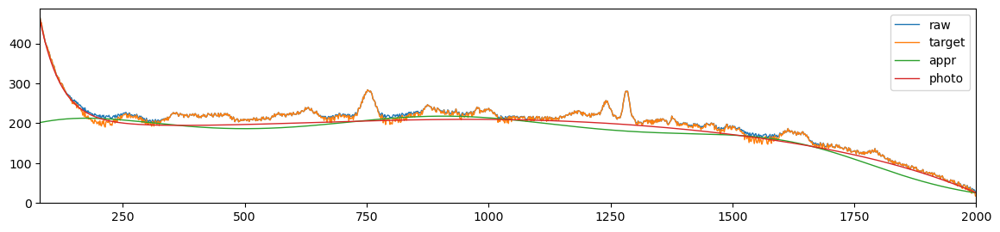

361.01769633537174 180.4808208000968 0.4498220082637816 0.31943753289563137
FWHM: 850,	 width: 0.89,	 RBF shape: (1250, 7),	 error: 361.01769633537174, 	 smoothness: 0.4498220082637816


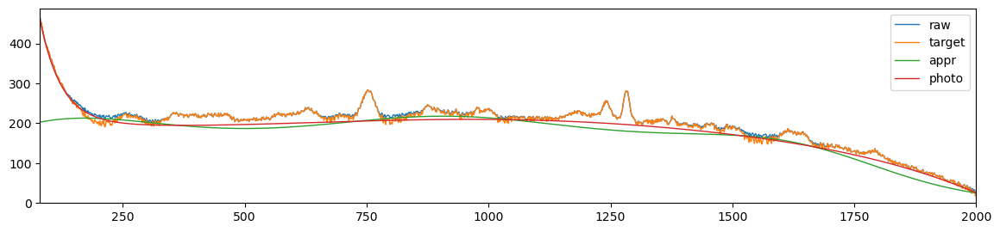

353.431838737892 179.10706427800673 0.44420269972690063 0.31849617917572903
FWHM: 850,	 width: 0.88,	 RBF shape: (1250, 7),	 error: 353.431838737892, 	 smoothness: 0.44420269972690063


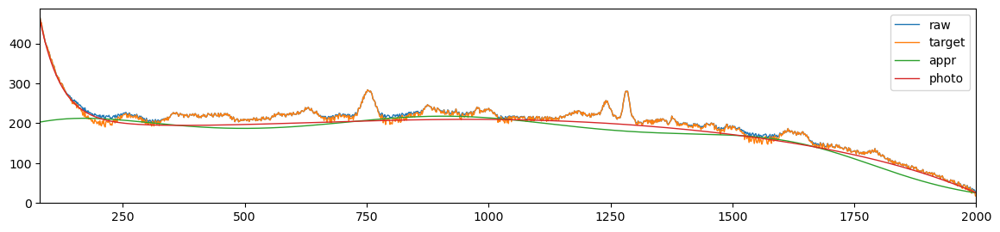

385.75785691837655 188.30118025343705 0.4573491007523872 0.3224306123902895
FWHM: 850,	 width: 0.8609598862125055,	 RBF shape: (1250, 6),	 error: 385.75785691837655, 	 smoothness: 0.4573491007523872


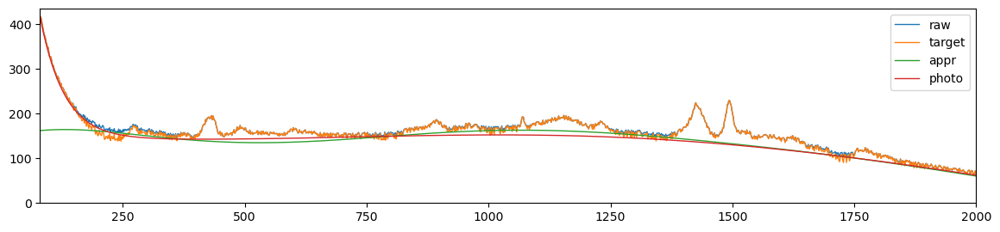

363.1057687290595 185.65747684750048 0.4422507519671499 0.32066137334443373
FWHM: 850,	 width: 0.8382945130946038,	 RBF shape: (1250, 6),	 error: 363.1057687290595, 	 smoothness: 0.4422507519671499


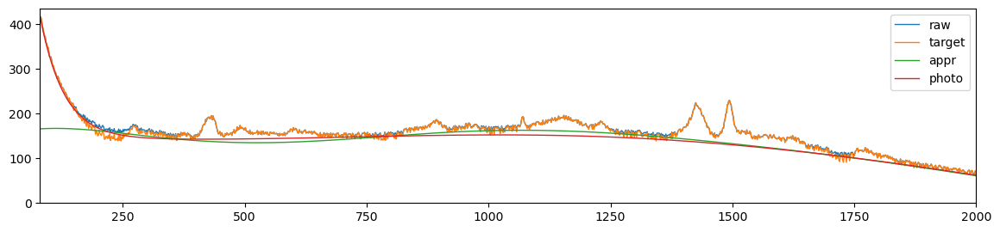

339.44058568150786 182.48191297475168 0.42571536598731313 0.31868498929961814
FWHM: 850,	 width: 0.8113136271446935,	 RBF shape: (1250, 6),	 error: 339.44058568150786, 	 smoothness: 0.42571536598731313


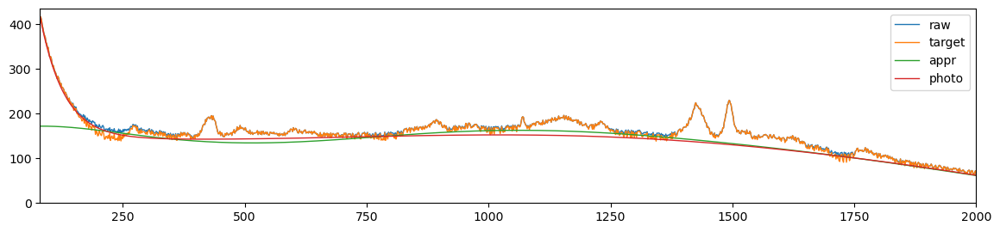

523.099409877726 257.3012392287233 0.47434344696701325 0.3291257336106422
FWHM: 850,	 width: 0.7791955498090459,	 RBF shape: (1250, 5),	 error: 523.099409877726, 	 smoothness: 0.47434344696701325


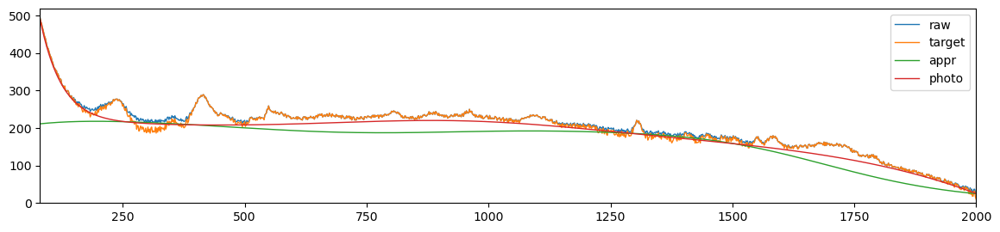

481.2338396729298 247.9543037520564 0.4544264334838517 0.327091467035544
FWHM: 850,	 width: 0.7409621540023357,	 RBF shape: (1250, 5),	 error: 481.2338396729298, 	 smoothness: 0.4544264334838517


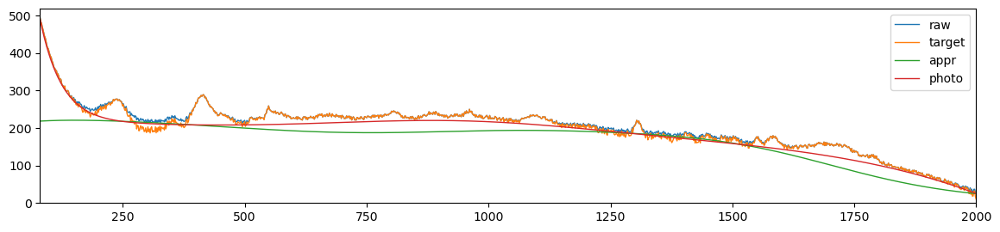

441.1944652988621 237.91290153557705 0.43424176831880534 0.3244737649080265
FWHM: 850,	 width: 0.6954490761292048,	 RBF shape: (1250, 5),	 error: 441.1944652988621, 	 smoothness: 0.43424176831880534


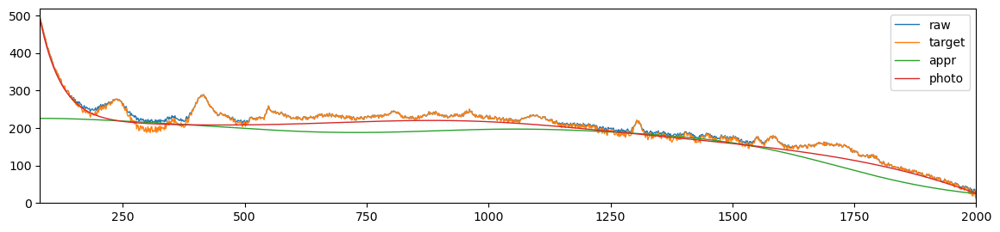

1975.0668961566855 816.9776389622645 0.2831504195380266 0.19089548398015493
FWHM: 850,	 width: 0.6412702564408389,	 RBF shape: (1250, 4),	 error: 1975.0668961566855, 	 smoothness: 0.2831504195380266


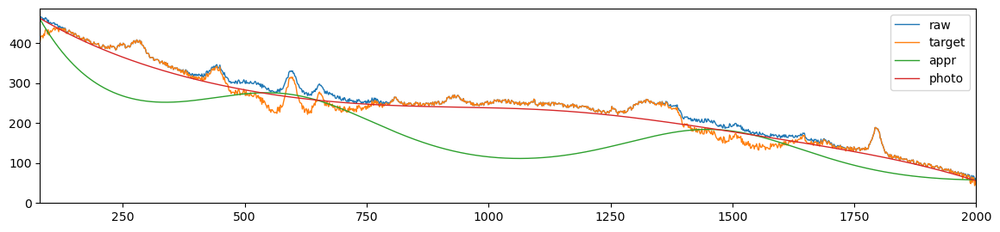

2496.6703298913035 1059.7518194957038 0.27501092013601214 0.1695354547833681
FWHM: 850,	 width: 0.5767757278350865,	 RBF shape: (1250, 4),	 error: 2496.6703298913035, 	 smoothness: 0.27501092013601214


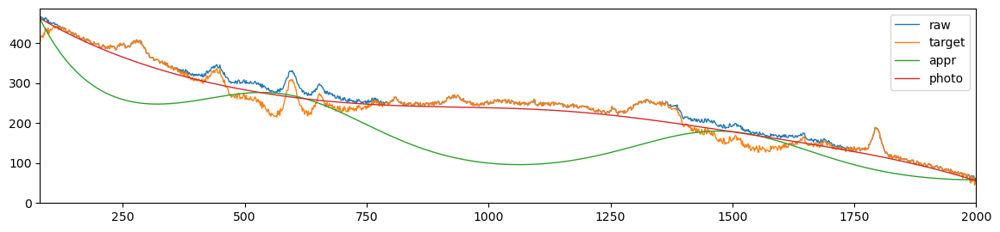

3203.6489417312137 1382.238408771631 0.27482864697584364 0.1526367350748044
FWHM: 850,	 width: 0.5000013675960908,	 RBF shape: (1250, 4),	 error: 3203.6489417312137, 	 smoothness: 0.27482864697584364


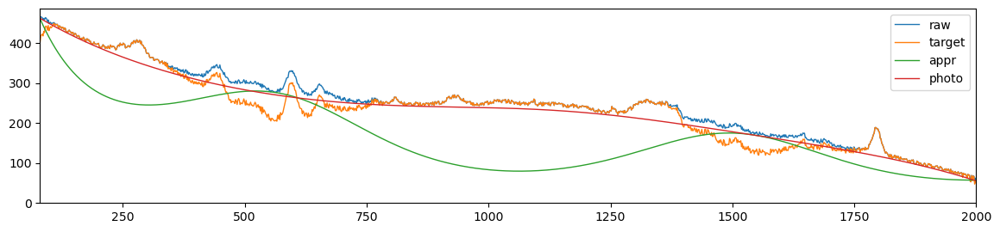

37.37364046538957 15.281273470144582 0.0346930767852985 0.05798385658171387
FWHM: 900,	 width: 0.99,	 RBF shape: (1250, 19),	 error: 37.37364046538957, 	 smoothness: 0.0346930767852985


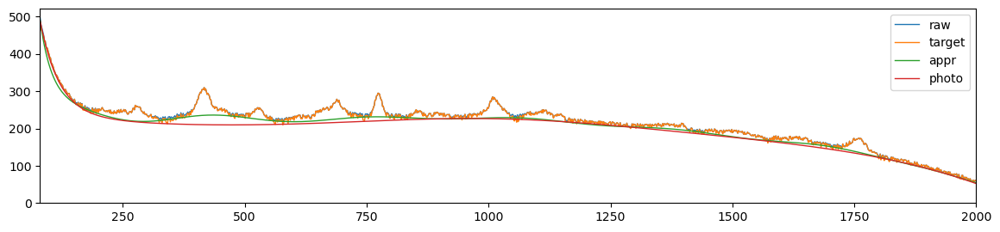

26.891802939299634 12.184407378248444 0.016438839425203612 0.01740767988300938
FWHM: 900,	 width: 0.98,	 RBF shape: (1250, 14),	 error: 26.891802939299634, 	 smoothness: 0.016438839425203612


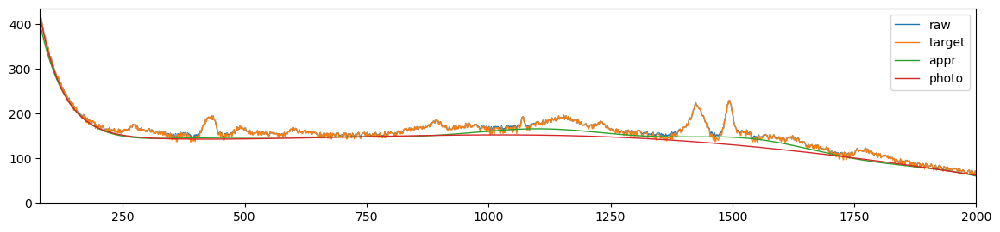

24.48349968737581 12.633675822076388 0.020793351059425418 0.032507193638202314
FWHM: 900,	 width: 0.97,	 RBF shape: (1250, 12),	 error: 24.48349968737581, 	 smoothness: 0.020793351059425418


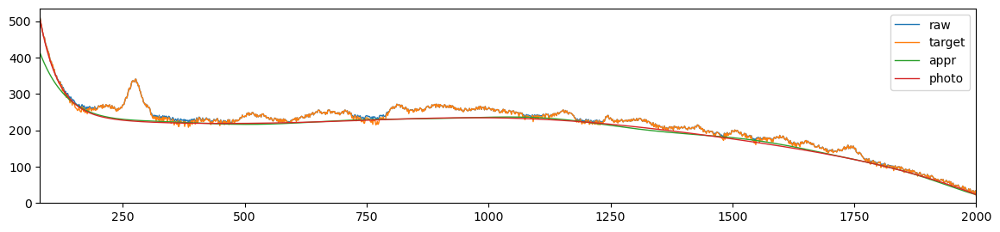

58.17898696564298 47.875877525696325 0.12226104400909836 0.1476836869415138
FWHM: 900,	 width: 0.96,	 RBF shape: (1250, 10),	 error: 58.17898696564298, 	 smoothness: 0.12226104400909836


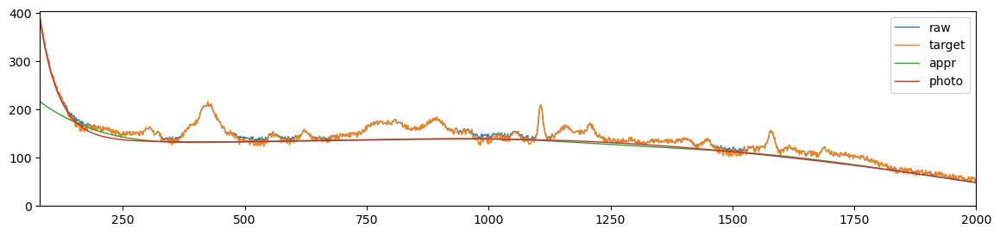

129.0175111776545 101.14491635217755 0.24276042824929053 0.24076625714648098
FWHM: 900,	 width: 0.95,	 RBF shape: (1250, 9),	 error: 129.0175111776545, 	 smoothness: 0.24276042824929053


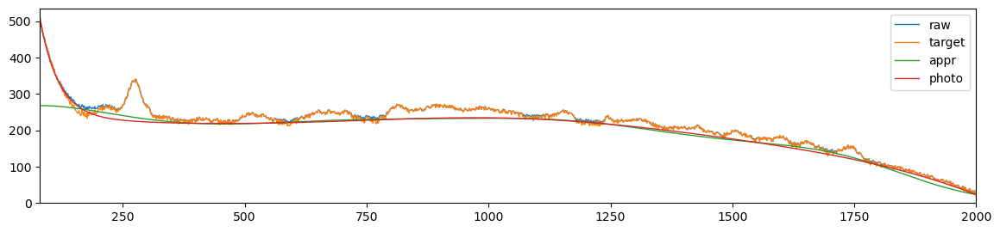

126.24159388502163 99.77786377998724 0.23860664770725634 0.23862157364389044
FWHM: 900,	 width: 0.94,	 RBF shape: (1250, 9),	 error: 126.24159388502163, 	 smoothness: 0.23860664770725634


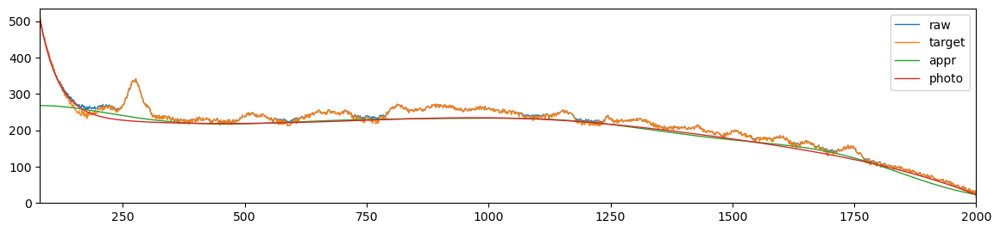

176.5084509836228 122.19635700034581 0.3051203621071817 0.27302605057473844
FWHM: 900,	 width: 0.93,	 RBF shape: (1250, 8),	 error: 176.5084509836228, 	 smoothness: 0.3051203621071817


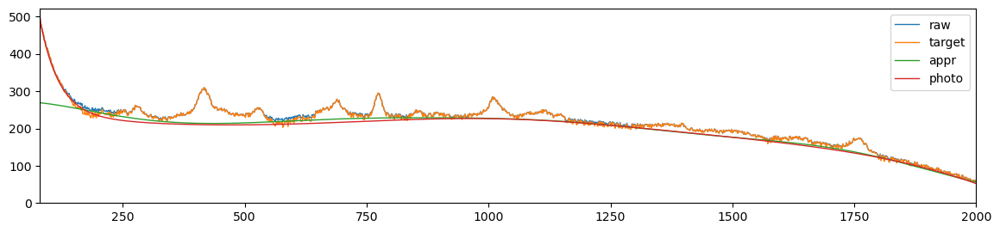

172.8216879085786 120.93498137002176 0.30070446519339156 0.27157297091444066
FWHM: 900,	 width: 0.92,	 RBF shape: (1250, 8),	 error: 172.8216879085786, 	 smoothness: 0.30070446519339156


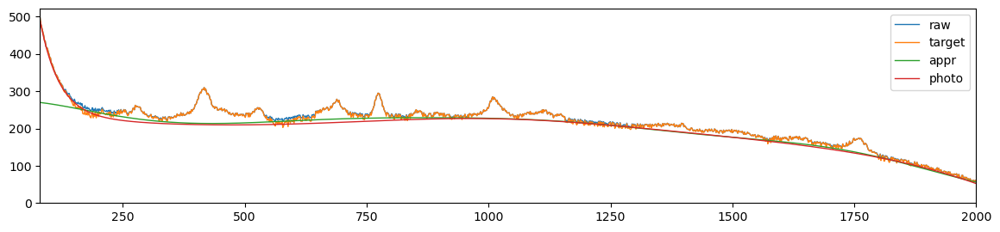

356.85847972796336 181.06263399709326 0.443535165070104 0.3185809866186052
FWHM: 900,	 width: 0.91,	 RBF shape: (1250, 7),	 error: 356.85847972796336, 	 smoothness: 0.443535165070104


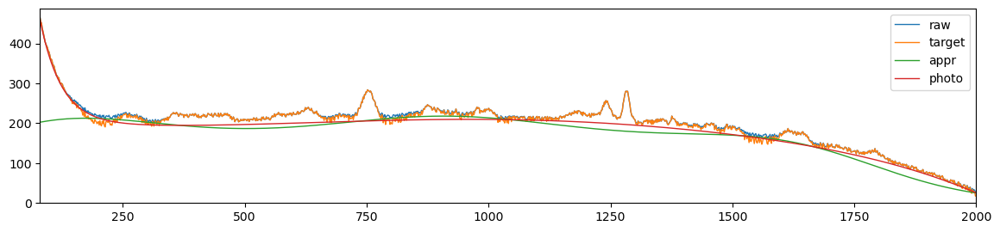

349.3154542096311 179.49092492822737 0.4380142203180075 0.3177261154770666
FWHM: 900,	 width: 0.9,	 RBF shape: (1250, 7),	 error: 349.3154542096311, 	 smoothness: 0.4380142203180075


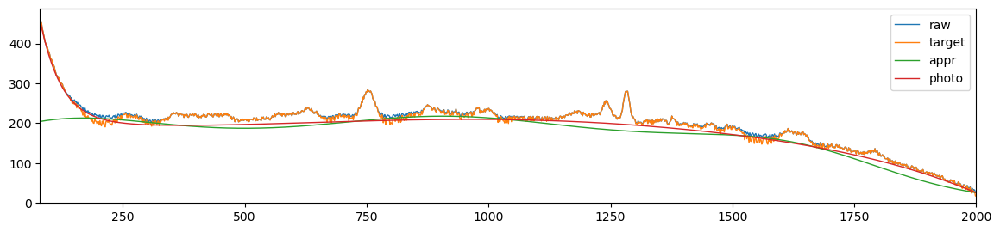

342.1359322010573 178.5418679792163 0.4328392819822533 0.31709409818921896
FWHM: 900,	 width: 0.89,	 RBF shape: (1250, 7),	 error: 342.1359322010573, 	 smoothness: 0.4328392819822533


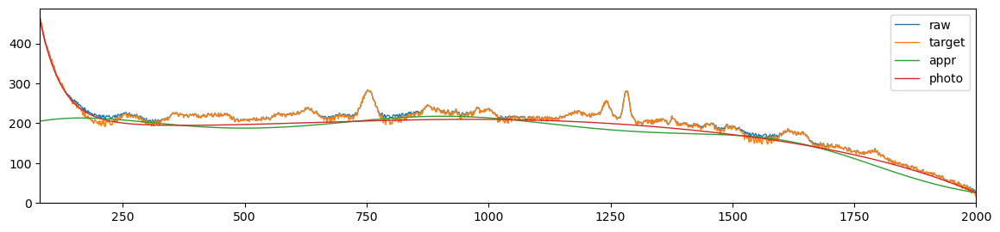

387.1983983040633 188.6115961873435 0.4547974451839309 0.3212689292692948
FWHM: 900,	 width: 0.88,	 RBF shape: (1250, 6),	 error: 387.1983983040633, 	 smoothness: 0.4547974451839309


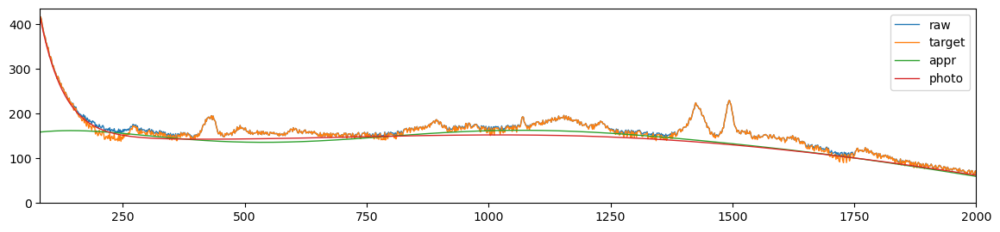

367.82364312009196 186.17452405240823 0.44230212872733204 0.31998568184452714
FWHM: 900,	 width: 0.8609598862125055,	 RBF shape: (1250, 6),	 error: 367.82364312009196, 	 smoothness: 0.44230212872733204


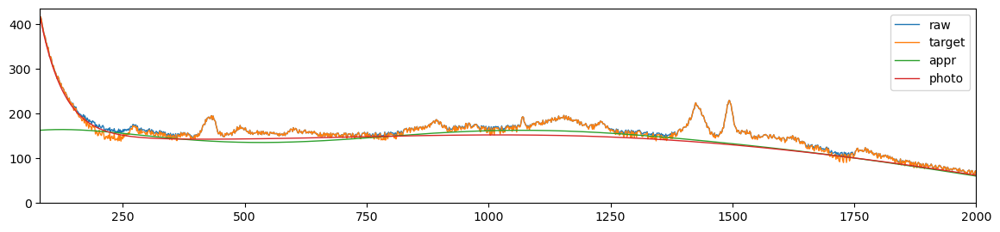

347.35192277296693 183.0377105433902 0.4285779979636899 0.31808172986322575
FWHM: 900,	 width: 0.8382945130946038,	 RBF shape: (1250, 6),	 error: 347.35192277296693, 	 smoothness: 0.4285779979636899


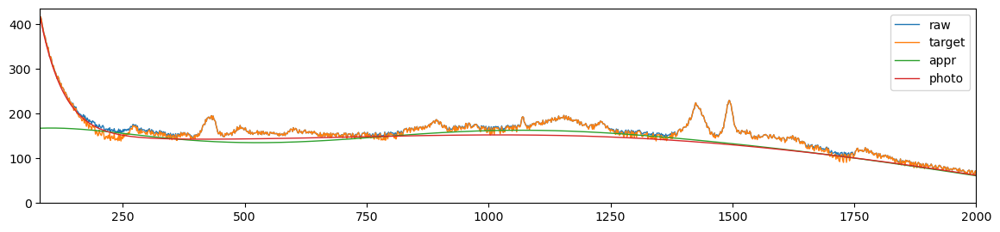

596.7612073314899 275.82338690629393 0.5011444353779075 0.3309324550268635
FWHM: 900,	 width: 0.8113136271446935,	 RBF shape: (1250, 5),	 error: 596.7612073314899, 	 smoothness: 0.5011444353779075


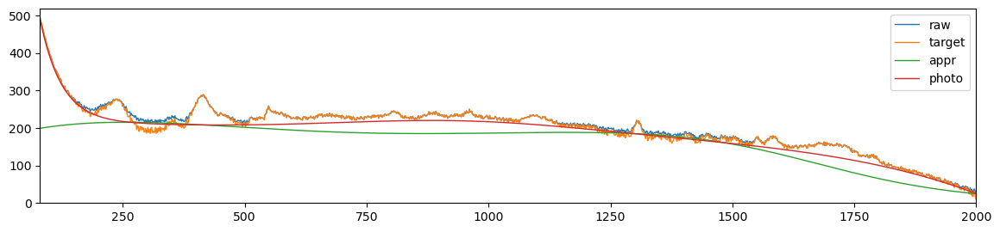

551.7707764097498 266.668104399942 0.4829592380482684 0.3299325433342384
FWHM: 900,	 width: 0.7791955498090459,	 RBF shape: (1250, 5),	 error: 551.7707764097498, 	 smoothness: 0.4829592380482684


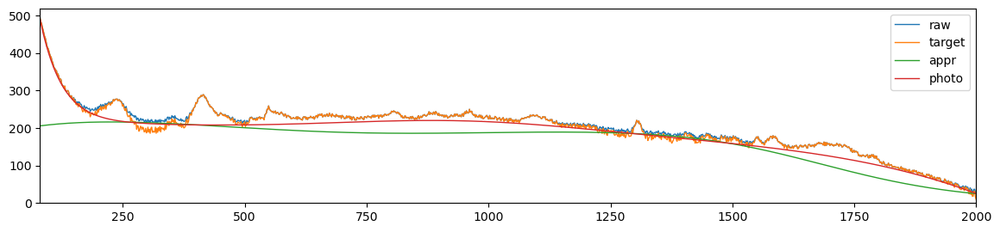

507.41181160058744 257.51795143773984 0.4641568222112938 0.32854841411339597
FWHM: 900,	 width: 0.7409621540023357,	 RBF shape: (1250, 5),	 error: 507.41181160058744, 	 smoothness: 0.4641568222112938


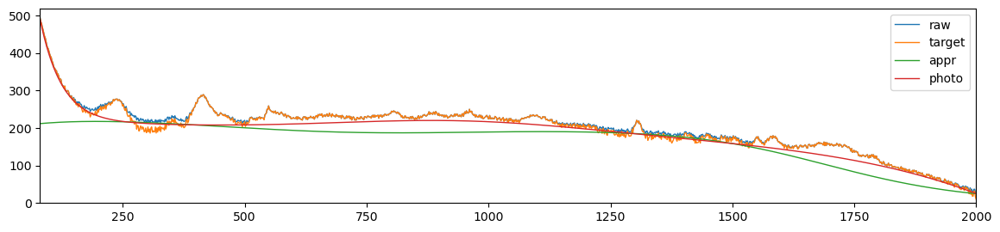

1224.2771087297656 385.2799772662983 0.3509308922722537 0.2546480275885957
FWHM: 900,	 width: 0.6954490761292048,	 RBF shape: (1250, 4),	 error: 1224.2771087297656, 	 smoothness: 0.3509308922722537


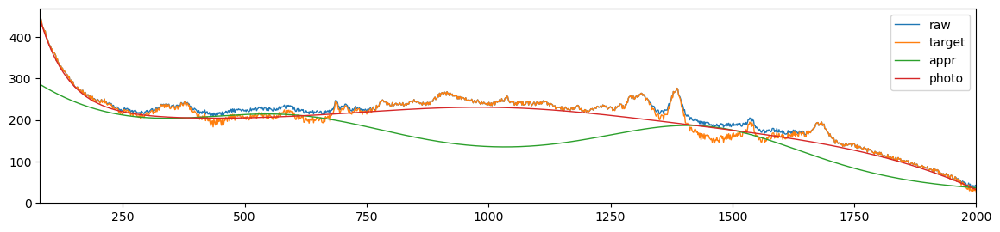

1531.1434006449638 512.7149920384047 0.33736158680455186 0.23885706231636888
FWHM: 900,	 width: 0.6412702564408389,	 RBF shape: (1250, 4),	 error: 1531.1434006449638, 	 smoothness: 0.33736158680455186


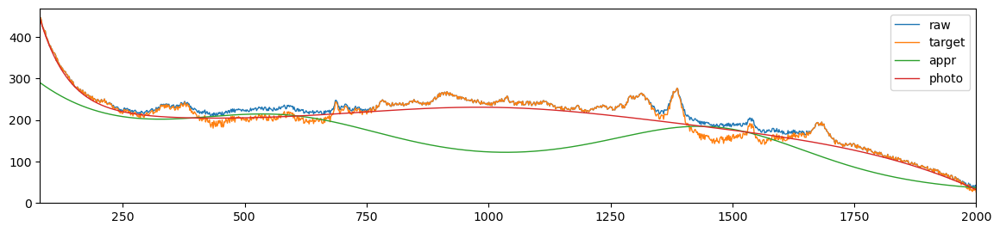

1982.459073009853 704.8251740372151 0.3300509902814589 0.22321468777658687
FWHM: 900,	 width: 0.5767757278350865,	 RBF shape: (1250, 4),	 error: 1982.459073009853, 	 smoothness: 0.3300509902814589


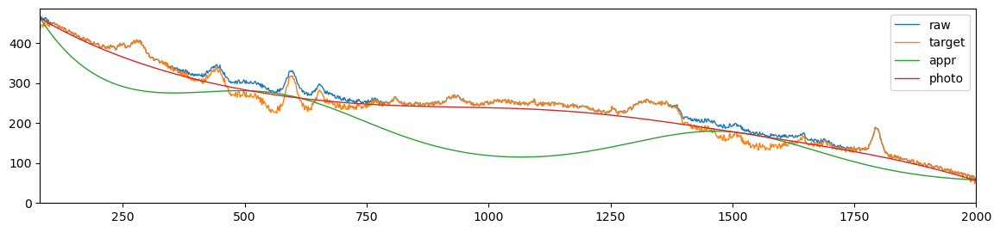

2644.431218447815 992.3865573131422 0.3326495780491008 0.21038509543552952
FWHM: 900,	 width: 0.5000013675960908,	 RBF shape: (1250, 4),	 error: 2644.431218447815, 	 smoothness: 0.3326495780491008


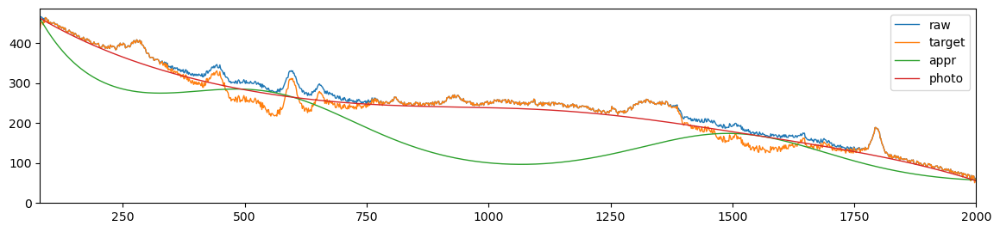

35.89370894399619 16.47878341318169 0.037530472221247974 0.04363372142652526
FWHM: 950,	 width: 0.99,	 RBF shape: (1250, 18),	 error: 35.89370894399619, 	 smoothness: 0.037530472221247974


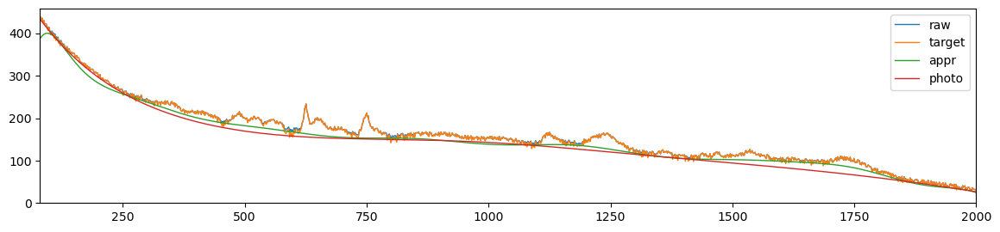

25.703948761831743 13.689606598358697 0.02072082066592917 0.03342878725595799
FWHM: 950,	 width: 0.98,	 RBF shape: (1250, 13),	 error: 25.703948761831743, 	 smoothness: 0.02072082066592917


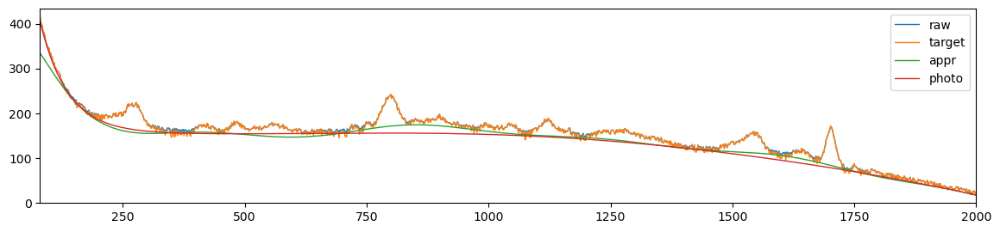

34.07312053052214 26.729938219807764 0.05788750592634169 0.08844198226332109
FWHM: 950,	 width: 0.97,	 RBF shape: (1250, 11),	 error: 34.07312053052214, 	 smoothness: 0.05788750592634169


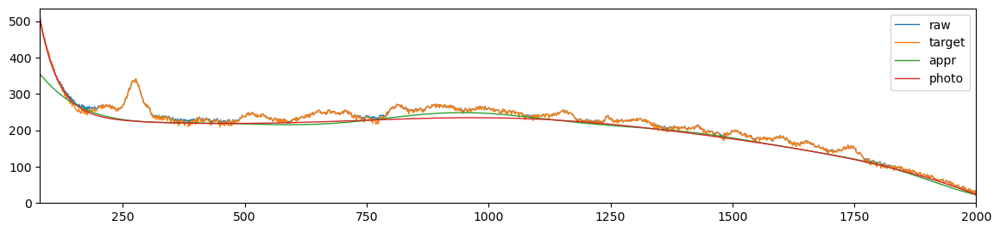

51.37811003890745 42.690793192412926 0.10615448989475064 0.1341140736725535
FWHM: 950,	 width: 0.96,	 RBF shape: (1250, 10),	 error: 51.37811003890745, 	 smoothness: 0.10615448989475064


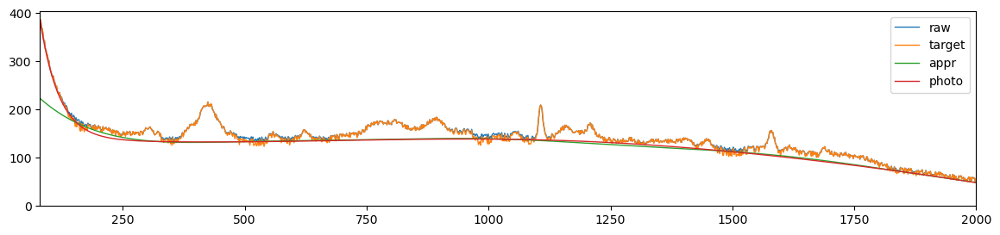

114.80158303992901 93.92581381427334 0.22052109308709156 0.22878316625603645
FWHM: 950,	 width: 0.95,	 RBF shape: (1250, 9),	 error: 114.80158303992901, 	 smoothness: 0.22052109308709156


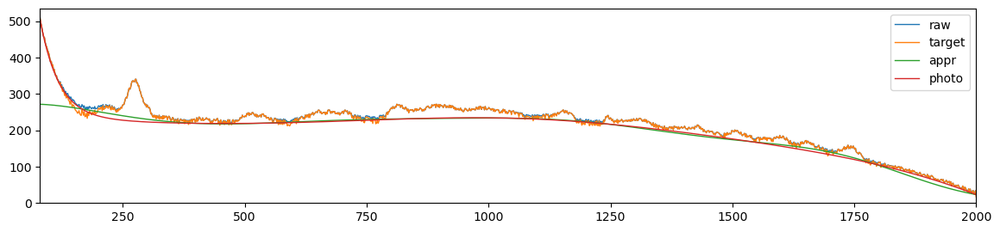

161.13116562885943 116.96283074314915 0.28479481699292286 0.26528635366537867
FWHM: 950,	 width: 0.94,	 RBF shape: (1250, 8),	 error: 161.13116562885943, 	 smoothness: 0.28479481699292286


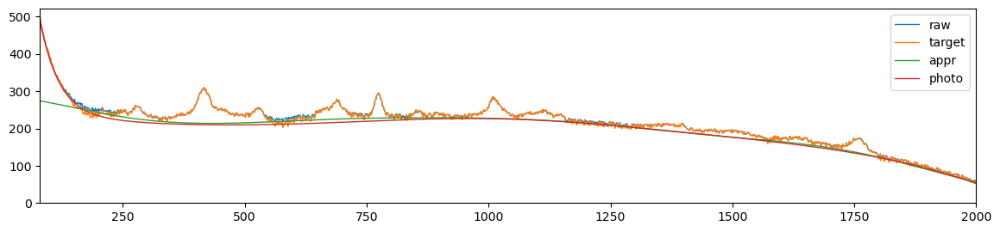

158.3055569352501 116.31047291975841 0.2810997986503311 0.264155443880344
FWHM: 950,	 width: 0.93,	 RBF shape: (1250, 8),	 error: 158.3055569352501, 	 smoothness: 0.2810997986503311


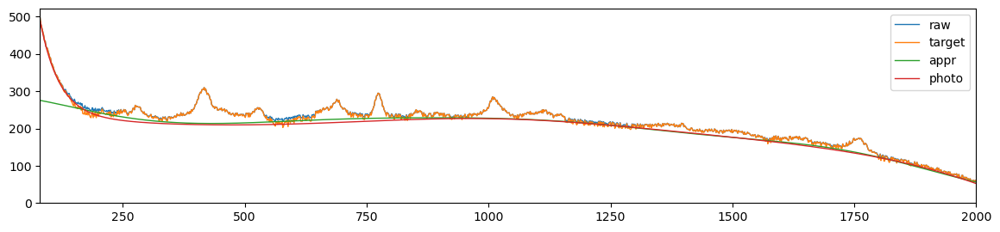

342.6672822420055 179.65168345857967 0.4306823474634043 0.3166050450964208
FWHM: 950,	 width: 0.92,	 RBF shape: (1250, 7),	 error: 342.6672822420055, 	 smoothness: 0.4306823474634043


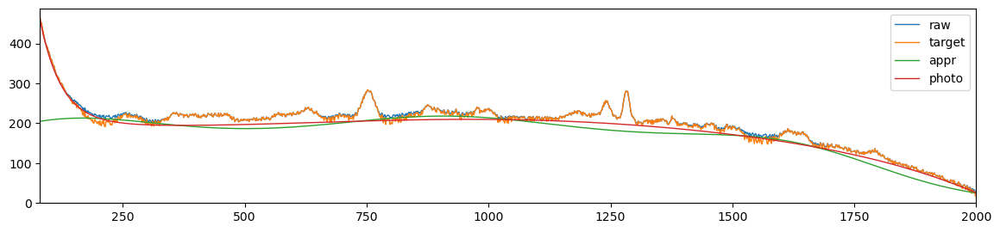

335.86430662087065 178.10442214080874 0.425725170448539 0.31558481017420326
FWHM: 950,	 width: 0.91,	 RBF shape: (1250, 7),	 error: 335.86430662087065, 	 smoothness: 0.425725170448539


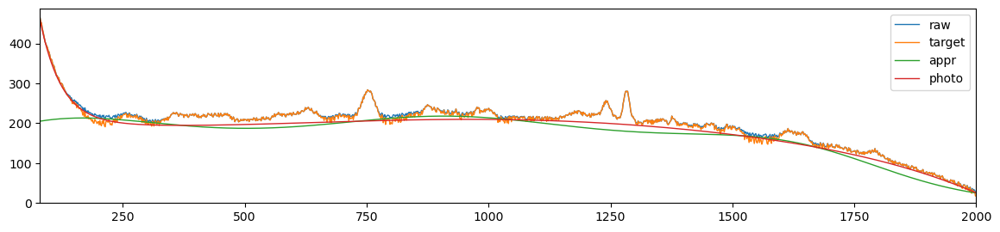

329.59619829900737 176.17392978697012 0.4211265863870242 0.31484077259337495
FWHM: 950,	 width: 0.9,	 RBF shape: (1250, 7),	 error: 329.59619829900737, 	 smoothness: 0.4211265863870242


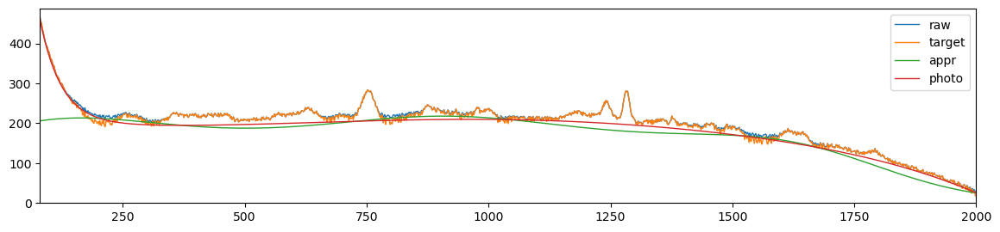

374.88878433058227 187.03449169664302 0.44416646614850885 0.31934034772989084
FWHM: 950,	 width: 0.89,	 RBF shape: (1250, 6),	 error: 374.88878433058227, 	 smoothness: 0.44416646614850885


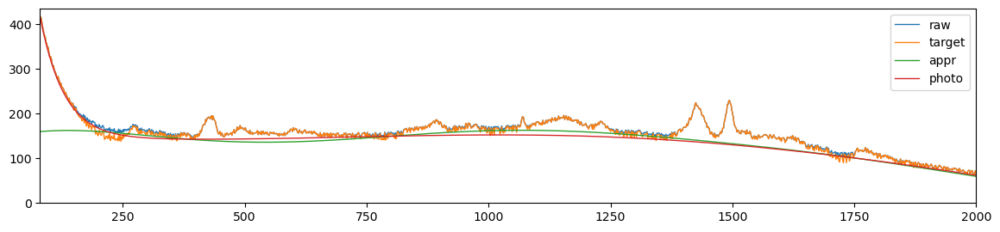

365.05616598976997 185.8459976418571 0.4378386530334763 0.31860000528978827
FWHM: 950,	 width: 0.88,	 RBF shape: (1250, 6),	 error: 365.05616598976997, 	 smoothness: 0.4378386530334763


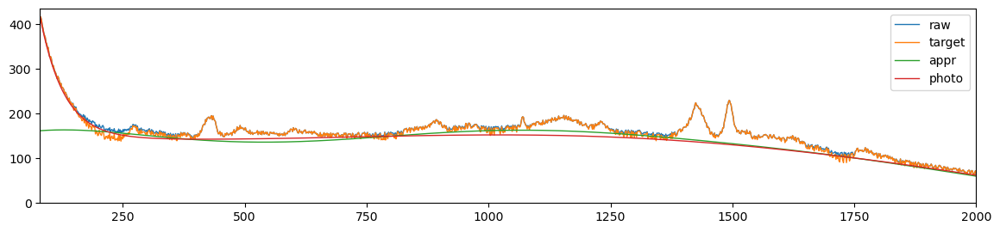

348.26373309641355 183.09625647688821 0.4266451136616476 0.3171875445031489
FWHM: 950,	 width: 0.8609598862125055,	 RBF shape: (1250, 6),	 error: 348.26373309641355, 	 smoothness: 0.4266451136616476


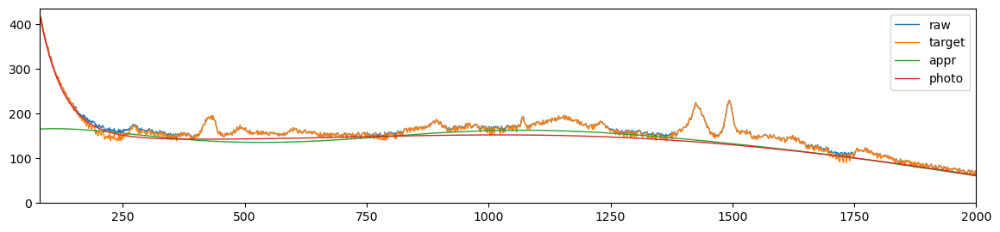

331.0463266433365 180.44482064989032 0.41447815058347764 0.31534150687884693
FWHM: 950,	 width: 0.8382945130946038,	 RBF shape: (1250, 6),	 error: 331.0463266433365, 	 smoothness: 0.41447815058347764


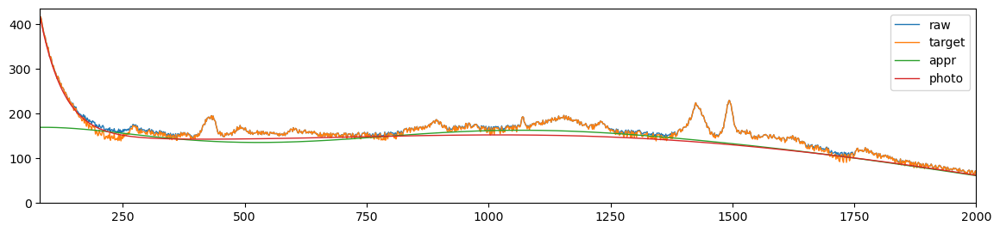

619.3763687051426 285.32887190245094 0.504972240194753 0.33102919489635335
FWHM: 950,	 width: 0.8113136271446935,	 RBF shape: (1250, 5),	 error: 619.3763687051426, 	 smoothness: 0.504972240194753


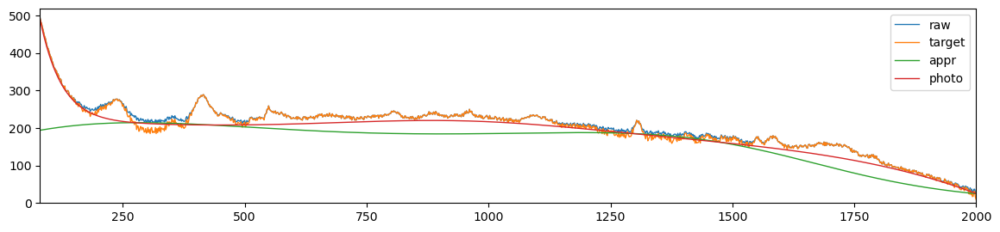

574.4356312723239 274.7468877819906 0.4878117083426314 0.3300144495978304
FWHM: 950,	 width: 0.7791955498090459,	 RBF shape: (1250, 5),	 error: 574.4356312723239, 	 smoothness: 0.4878117083426314


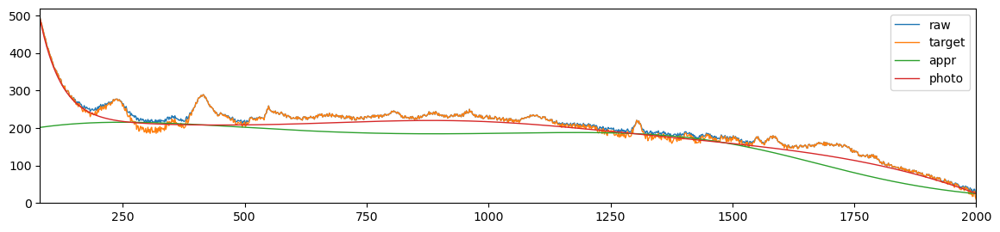

529.6545205098262 264.75552349518773 0.46995321466420414 0.32888394838914226
FWHM: 950,	 width: 0.7409621540023357,	 RBF shape: (1250, 5),	 error: 529.6545205098262, 	 smoothness: 0.46995321466420414


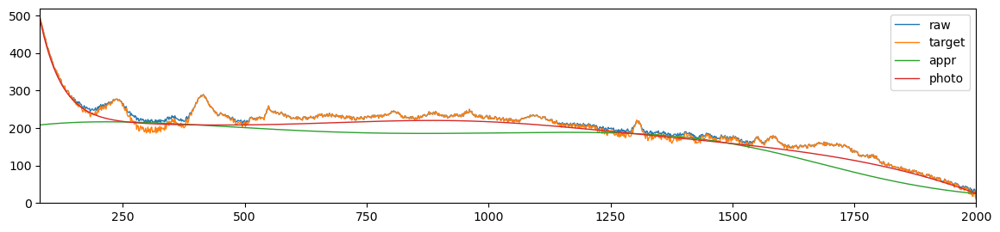

1015.286287329867 290.67178856769726 0.3978019067353148 0.28326748747369834
FWHM: 950,	 width: 0.6954490761292048,	 RBF shape: (1250, 4),	 error: 1015.286287329867, 	 smoothness: 0.3978019067353148


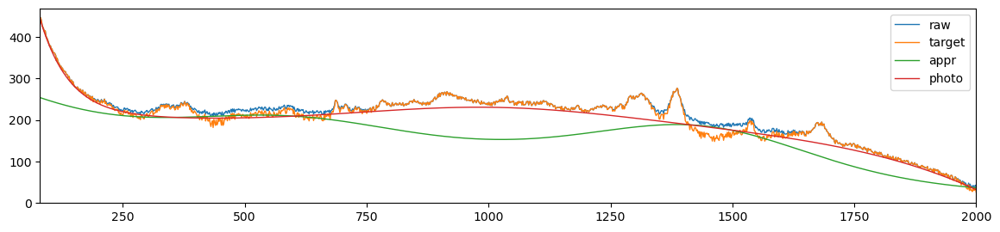

1245.6733003606082 358.6136800494395 0.38588262058408807 0.27325679441225925
FWHM: 950,	 width: 0.6412702564408389,	 RBF shape: (1250, 4),	 error: 1245.6733003606082, 	 smoothness: 0.38588262058408807


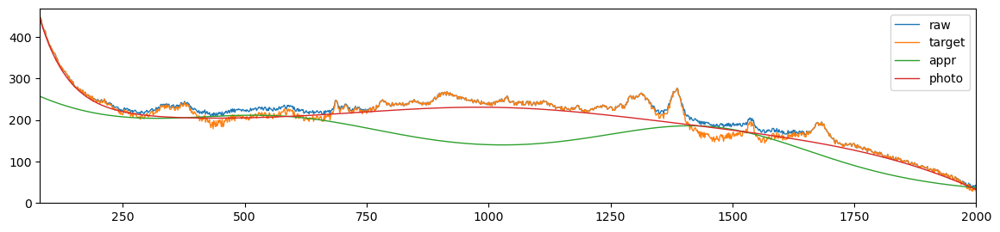

1619.0452794636738 490.7986971584749 0.38133705988136546 0.26304100393528074
FWHM: 950,	 width: 0.5767757278350865,	 RBF shape: (1250, 4),	 error: 1619.0452794636738, 	 smoothness: 0.38133705988136546


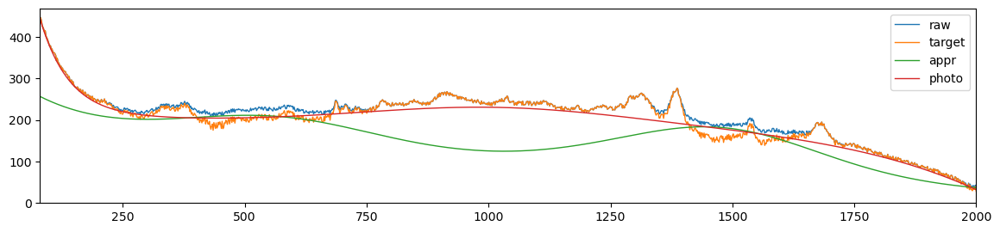

2212.042253206888 725.7660599875218 0.3870899450273901 0.25592350391439517
FWHM: 950,	 width: 0.5000013675960908,	 RBF shape: (1250, 4),	 error: 2212.042253206888, 	 smoothness: 0.3870899450273901


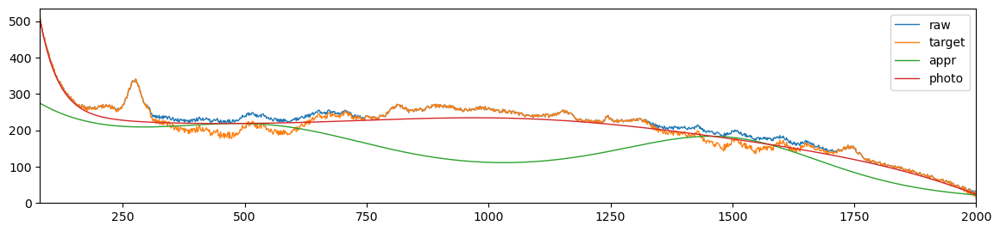

32.83552032810328 15.34859370437003 0.03067612591689303 0.03820999825915228
FWHM: 1000,	 width: 0.99,	 RBF shape: (1250, 17),	 error: 32.83552032810328, 	 smoothness: 0.03067612591689303


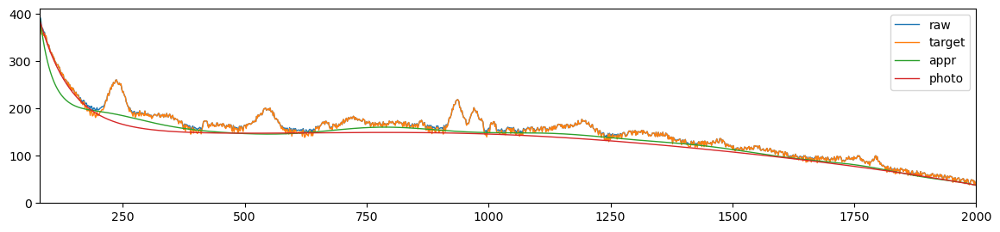

25.110016755703988 13.267324622199348 0.01965494127017274 0.029800311244564653
FWHM: 1000,	 width: 0.98,	 RBF shape: (1250, 13),	 error: 25.110016755703988, 	 smoothness: 0.01965494127017274


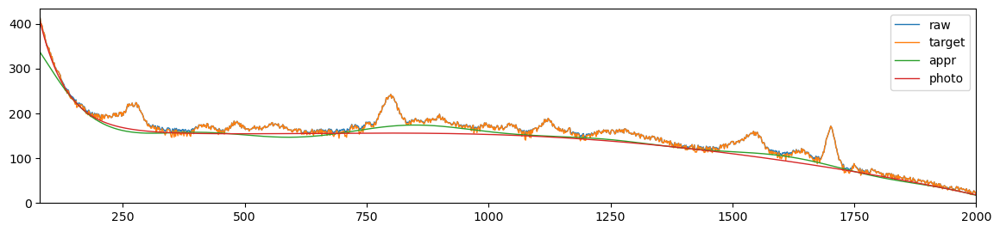

31.502510642941782 24.38590378659516 0.05033515534857653 0.08038541485158612
FWHM: 1000,	 width: 0.97,	 RBF shape: (1250, 11),	 error: 31.502510642941782, 	 smoothness: 0.05033515534857653


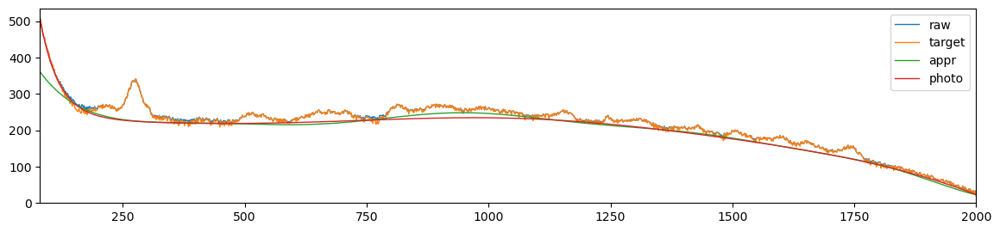

105.41982906517796 88.57350101984855 0.20484520748863777 0.21935491388150927
FWHM: 1000,	 width: 0.96,	 RBF shape: (1250, 9),	 error: 105.41982906517796, 	 smoothness: 0.20484520748863777


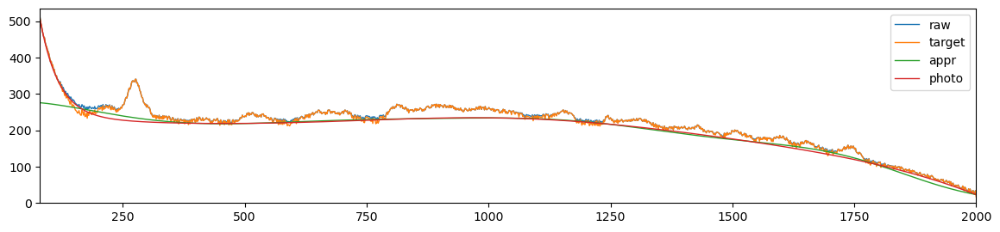

103.35472774508045 87.69522159106207 0.20158647956428818 0.217825967776242
FWHM: 1000,	 width: 0.95,	 RBF shape: (1250, 9),	 error: 103.35472774508045, 	 smoothness: 0.20158647956428818


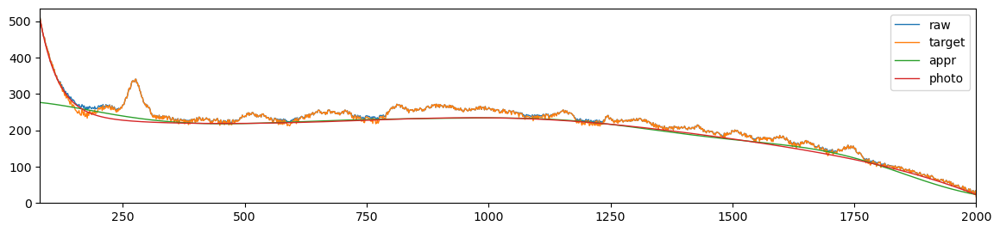

145.6034426670954 111.63142225556892 0.26353765609778995 0.2565555074457525
FWHM: 1000,	 width: 0.94,	 RBF shape: (1250, 8),	 error: 145.6034426670954, 	 smoothness: 0.26353765609778995


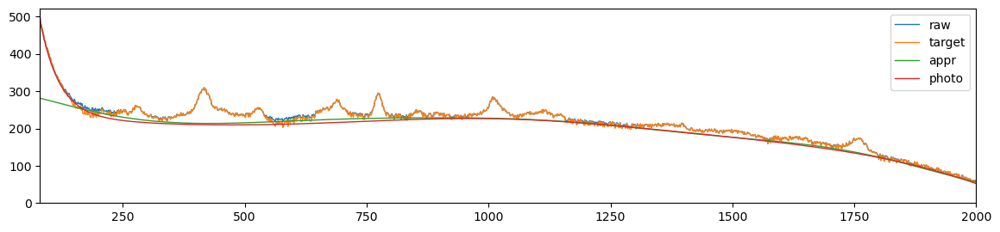

327.9054551211606 177.0488198535985 0.41806409897610647 0.31450781039439885
FWHM: 1000,	 width: 0.93,	 RBF shape: (1250, 7),	 error: 327.9054551211606, 	 smoothness: 0.41806409897610647


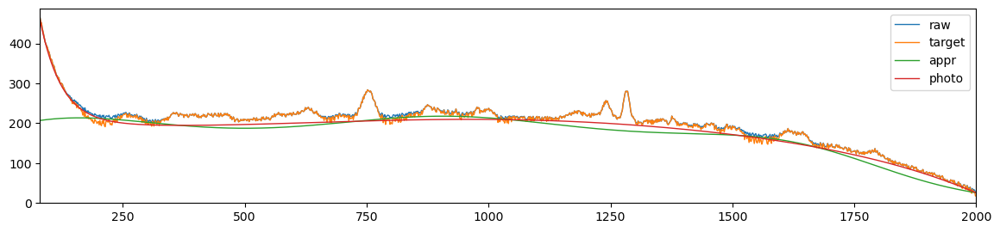

322.03213766496685 175.68231276028243 0.41364119879757644 0.31361419589098594
FWHM: 1000,	 width: 0.92,	 RBF shape: (1250, 7),	 error: 322.03213766496685, 	 smoothness: 0.41364119879757644


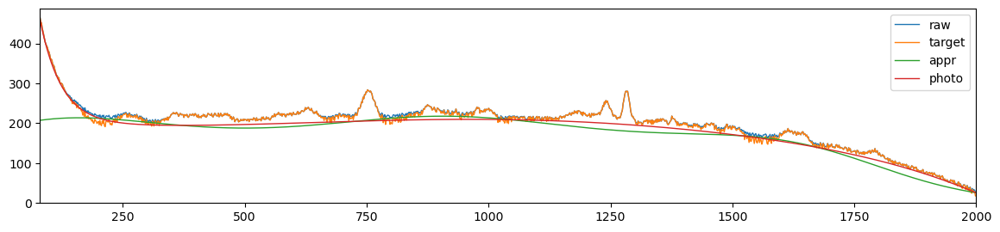

316.50713267281304 174.8538445068849 0.4095252670468576 0.3129154181406243
FWHM: 1000,	 width: 0.91,	 RBF shape: (1250, 7),	 error: 316.50713267281304, 	 smoothness: 0.4095252670468576


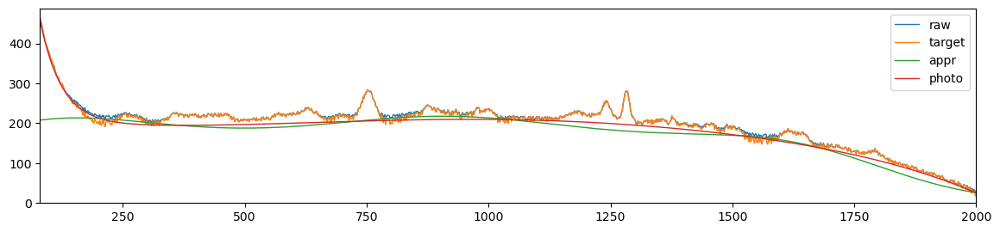

360.20210676964047 185.3740920730643 0.43242698767315946 0.31729676313293637
FWHM: 1000,	 width: 0.9,	 RBF shape: (1250, 6),	 error: 360.20210676964047, 	 smoothness: 0.43242698767315946


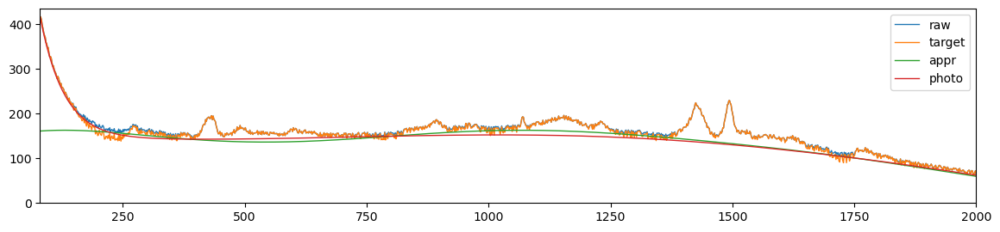

350.579637412974 183.69662297065136 0.4262224400643257 0.3164358437239706
FWHM: 1000,	 width: 0.89,	 RBF shape: (1250, 6),	 error: 350.579637412974, 	 smoothness: 0.4262224400643257


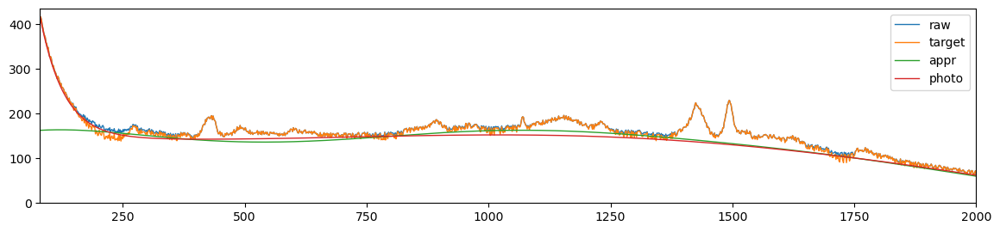

342.43096247445834 182.359804337629 0.420659584911412 0.31566043232743407
FWHM: 1000,	 width: 0.88,	 RBF shape: (1250, 6),	 error: 342.43096247445834, 	 smoothness: 0.420659584911412


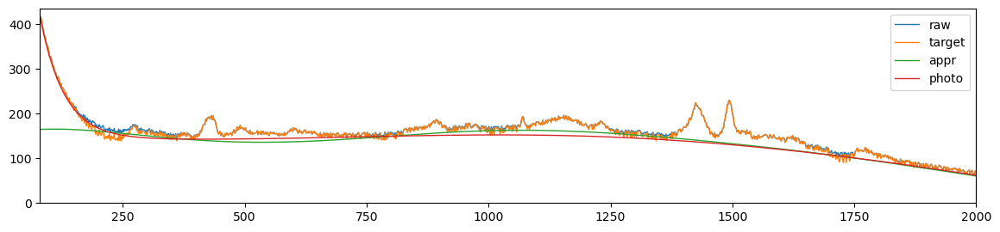

328.3471674257537 180.42960682846996 0.41077936349621974 0.31424589932146324
FWHM: 1000,	 width: 0.8609598862125055,	 RBF shape: (1250, 6),	 error: 328.3471674257537, 	 smoothness: 0.41077936349621974


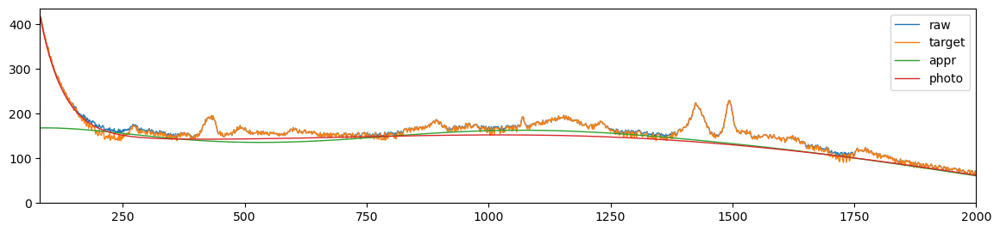

676.6466471847131 301.53516718900283 0.5206112493649678 0.3312784095218077
FWHM: 1000,	 width: 0.8382945130946038,	 RBF shape: (1250, 5),	 error: 676.6466471847131, 	 smoothness: 0.5206112493649678


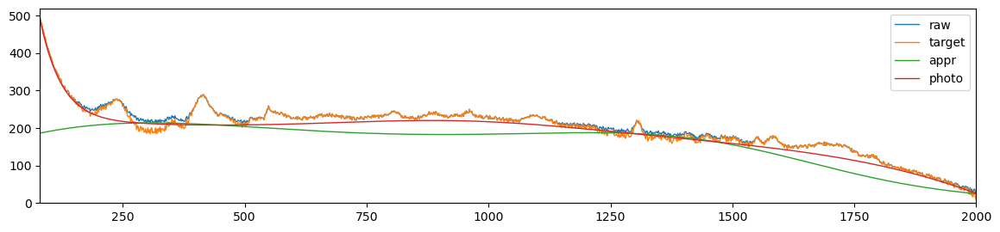

635.1547192911751 292.51469498367544 0.5060890926819043 0.33081028916528293
FWHM: 1000,	 width: 0.8113136271446935,	 RBF shape: (1250, 5),	 error: 635.1547192911751, 	 smoothness: 0.5060890926819043


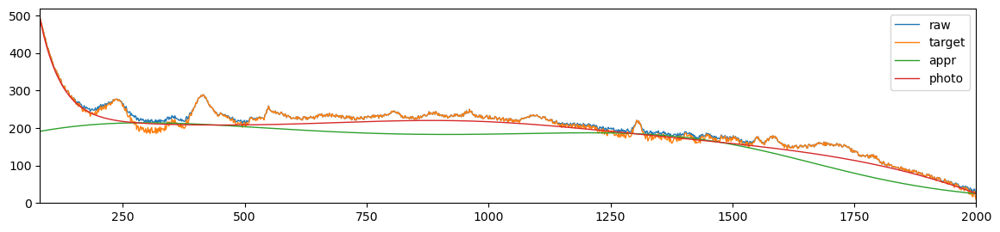

592.6501667959491 282.64876598482437 0.49041628618321453 0.329981672431235
FWHM: 1000,	 width: 0.7791955498090459,	 RBF shape: (1250, 5),	 error: 592.6501667959491, 	 smoothness: 0.49041628618321453


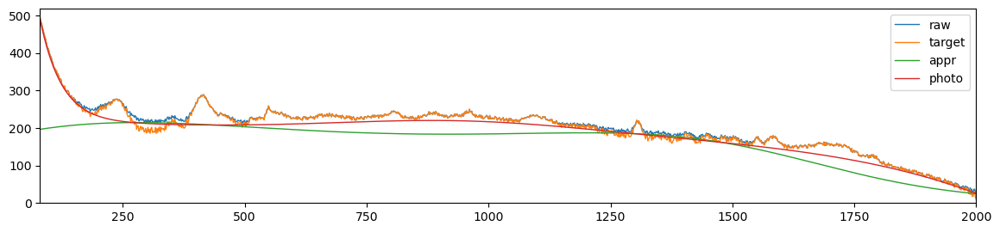

801.9537873035447 265.54894420085185 0.4442850670928188 0.3058065306740041
FWHM: 1000,	 width: 0.7409621540023357,	 RBF shape: (1250, 4),	 error: 801.9537873035447, 	 smoothness: 0.4442850670928188


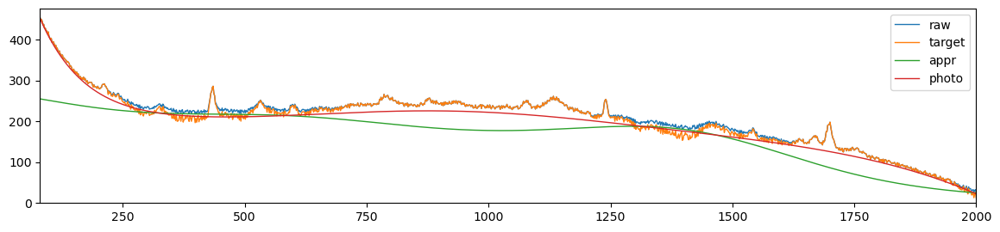

886.3970426226981 270.34267516764385 0.4304726806328023 0.30005777833209246
FWHM: 1000,	 width: 0.6954490761292048,	 RBF shape: (1250, 4),	 error: 886.3970426226981, 	 smoothness: 0.4304726806328023


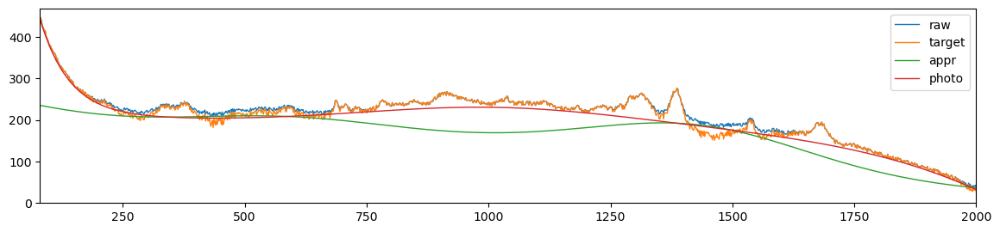

1049.6150594061362 296.2692529127654 0.4203698085744454 0.29362700245994267
FWHM: 1000,	 width: 0.6412702564408389,	 RBF shape: (1250, 4),	 error: 1049.6150594061362, 	 smoothness: 0.4203698085744454


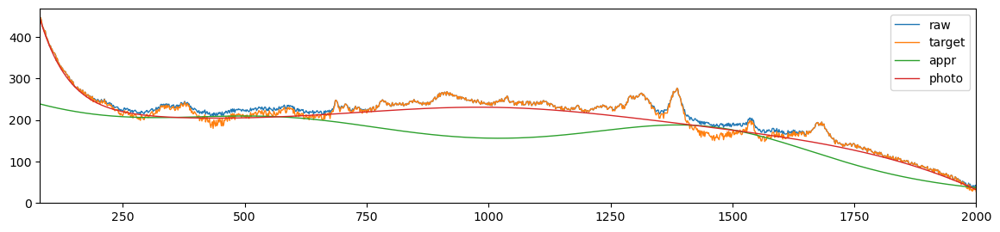

1342.1747489258153 370.0409790987601 0.4172541356990599 0.28719067641673934
FWHM: 1000,	 width: 0.5767757278350865,	 RBF shape: (1250, 4),	 error: 1342.1747489258153, 	 smoothness: 0.4172541356990599


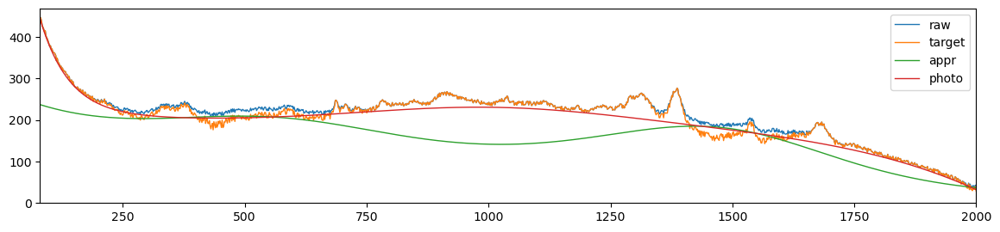

12412.927289122064 8613.052199254897 0.1865133989542488 0.08792664832410291
FWHM: 1000,	 width: 0.5000013675960908,	 RBF shape: (1250, 3),	 error: 12412.927289122064, 	 smoothness: 0.1865133989542488


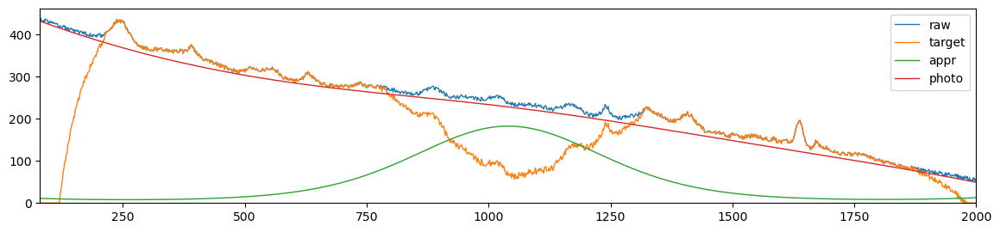

In [443]:
plt.rcParams['figure.figsize'] = (14.0, 3.0)
plt.rcParams['figure.dpi'] = 100
plt.rcParams['lines.linewidth'] = 1

error_lst = []
error_lst2 = []

FWHM_RBF_lst = range(50,1001,50)
width_lst = np.concatenate((np.linspace(0.99,0.89,11), .98 - np.logspace(-1,-0.31876,10)))
# width_lst = np.arange(0.1,1,0.05)
for FWHM_RBF in FWHM_RBF_lst:
    for width in width_lst:
        e = []
        e2 = []
        LS = LSQ.photo_approximation(x, -1, FWHM_RBF, len(x), width=width)
        for raw, real_photo in raw_lst:
            weights = np.ones(len(x))
            poly_max = copy.copy(raw).reshape(1,-1)
            photo_old = -1
            photo = poly_max
            i = 0
            while ((old:=error.MAPE(photo_old, photo)) > 1e-3 and i < 30) or i < 5:
                photo, photo_old = LS(poly_max, weights), photo
                to_high = photo > raw
                mean_error = np.mean(to_high, 0)
                weights += mean_error
                weights /= np.mean(weights)
                poly_max[to_high] += (raw-photo)[to_high]*0.25
                poly_max[poly_max <= 0] = 1e-3
                i += 1
                photo[photo < 1] = 1
            e += [error.MSE(photo[0], real_photo)]
            e2 += [error.TMSGE(photo[0], real_photo)]
#             print(error.MSE(photo[0], real_photo), error.TMSGE(photo[0], real_photo))
        print(np.mean(e),np.std(e), np.mean(e2),np.std(e2))
        i = np.argmax(e)
        e = np.mean(e) + 0*np.std(e)
        e2 = np.mean(e2) + 0*np.std(e2)
        error_lst.append(e)
        error_lst2.append(e2)
        print(f"FWHM: {FWHM_RBF},\t width: {width},\t RBF shape: {LS.RBF.shape},\t error: {e}, \t smoothness: {e2}")
#         plt.plot(x, raw, label="raw")
#         plt.plot(x, poly_max[0], label="target")
#         plt.plot(x, photo.reshape(-1), label="appr")
#         plt.plot(x, real_photo, label="photo")
#         plt.ylim(0)
#         plt.xlim(start, end)
#         plt.legend()
#         plt.show()

        raw, real_photo = raw_lst[i]
        weights = np.ones(len(x))
        poly_max = copy.copy(raw).reshape(1,-1)
        photo_old = -1
        photo = poly_max
        i = 0
        while ((old:=error.MAPE(photo_old, photo)) > 1e-3 and i < 30) or i < 5:
            photo, photo_old = LS(poly_max, weights), photo
            to_high = photo > raw
            mean_error = np.mean(to_high, 0)
            weights += mean_error
            weights /= np.mean(weights)
            poly_max[to_high] += (raw-photo)[to_high] *0.3
            poly_max[poly_max <= 0] = 1e-3
            i += 1
            photo[photo < 1] = 1
#         e = error.MSE(photo[0], real_photo)
#         e2 = error.TMSGE(photo[0], real_photo)
#         error_lst.append(e)
#         error_lst2.append(e2)
        plt.plot(x, raw, label="raw")
        plt.plot(x, poly_max[0], label="target")
        plt.plot(x, photo.reshape(-1), label="appr")
        plt.plot(x, real_photo, label="photo")
        plt.ylim(0)
        plt.xlim(start, end)
        plt.legend()
        plt.show()

error_lst = np.array(error_lst)
error_lst2 = np.array(error_lst2)

900 0.98
best avg width 0.97
best avg width FWHM 900 1.000149114903449
450 0.96
best avg width 0.98
best avg width FWHM 900 1.0000499545438843
900 0.98
best avg width 0.98
best avg width FWHM 900 1.0000249772719423


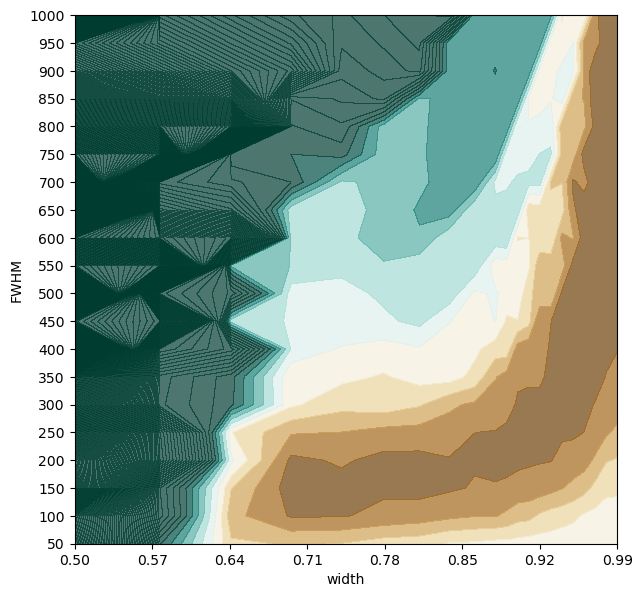

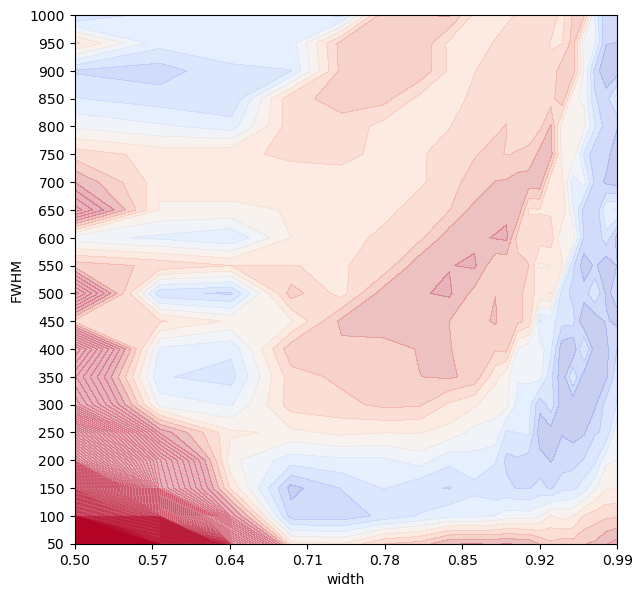

In [442]:
error_check1 = (norm(error_lst)).reshape(len(FWHM_RBF_lst), -1)
error_check2 = (norm(error_lst2)).reshape(len(FWHM_RBF_lst), -1)

error_check = error_check1
print(FWHM_RBF_lst[np.argmin(error_check)//l], width_lst[np.argmin(error_check)%l])

print("best avg width", width_lst[np.argmin(np.sum(error_check, 0))])

print("best avg width FWHM", FWHM_RBF_lst[np.argmin(error_check[:,np.argmin(np.sum(error_check, 0))])], np.min(error_check[:,np.argmin(np.sum(error_check, 0))]))

error_check = error_check2

print(FWHM_RBF_lst[np.argmin(error_check)//l], width_lst[np.argmin(error_check)%l])

print("best avg width", width_lst[np.argmin(np.sum(error_check, 0))])

print("best avg width FWHM", FWHM_RBF_lst[np.argmin(error_check[:,np.argmin(np.sum(error_check, 0))])], np.min(error_check[:,np.argmin(np.sum(error_check, 0))]))

error_check = ((norm(error_lst) + norm(error_lst2))/2).reshape(len(FWHM_RBF_lst), -1)

print(FWHM_RBF_lst[np.argmin(error_check)//l], width_lst[np.argmin(error_check)%l])

print("best avg width", width_lst[np.argmin(np.sum(error_check, 0))])

print("best avg width FWHM", FWHM_RBF_lst[np.argmin(error_check[:,np.argmin(np.sum(error_check, 0))])], np.min(error_check[:,np.argmin(np.sum(error_check, 0))]))


error_show = error_check
X, Y = np.meshgrid(width_lst, FWHM_RBF_lst)
# Z = np.log(error_show-np.min(error_show)+1)
# Z = np.log(error_show)
# Z = np.stack((norm(error_check), error_check1, error_check2),2)

plt.rcParams['figure.figsize'] = (7.0, 7.0)
plt.rcParams['figure.dpi'] = 100
plt.rcParams['lines.linewidth'] = 1

fig = plt.figure()
ax = plt.axes()

# cset = ax.contourf(X, Y, np.log(error_check), levels=500, cmap = 'Greens',alpha=1, vmax=.02)
# cset = ax.contourf(X, Y, np.log(error_check1), levels=500, cmap = 'Reds',alpha=0.7, vmax=.01)
# cset = ax.contourf(X, Y, np.log(error_check2), levels=500, cmap = 'Blues',alpha=0.3, vmax=.01)
# ax.set_xlabel('width')
# ax.set_xticks(np.linspace(0.5,0.99,8))
# ax.set_yticks(np.linspace(50,1000,20))
# ax.set_ylabel('FWHM')
# plt.show()
# fig = plt.figure()
# ax = plt.axes()

cset = ax.contourf(X, Y, error_check1-1, levels=500, cmap = 'BrBG',alpha=0.7, vmax=.02)
ax.set_xlabel('width')
ax.set_xticks(np.linspace(0.5,0.99,8))
ax.set_yticks(np.linspace(50,1000,20))
ax.set_ylabel('FWHM')
plt.show()

fig = plt.figure()
ax = plt.axes()
cset = ax.contourf(X, Y, error_check2-1, levels=500, cmap = 'coolwarm',alpha=0.3, vmax=.02)

ax.set_xlabel('width')
ax.set_xticks(np.linspace(0.5,0.99,8))
ax.set_yticks(np.linspace(50,1000,20))
ax.set_ylabel('FWHM')
# plt.legend()
plt.show()

# plt.plot(error_check2.T)
# plt.ylim(1,1.1)